<a href="https://colab.research.google.com/github/AndreiAf02/Transfer_Learning_Extension/blob/main/Bank_Marketing_Transductive_TL_Extension.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##STAT 561 Project Extension - Bank Marketing


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from time import perf_counter



from sklearn.preprocessing import StandardScaler, MinMaxScaler
from imblearn.over_sampling import SMOTE
from imblearn.combine import SMOTETomek
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import roc_curve, roc_auc_score, confusion_matrix, ConfusionMatrixDisplay, classification_report
import matplotlib.pyplot as plt
# !pip install pytorch-tabnet

# from pytorch_tabnet.tab_model import TabNetClassifier
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay



## Data taken from the UCI Machine Learning repository [here](https://doi.org/10.24432/C5K306):

In [2]:
pip install ucimlrepo

In [3]:
from ucimlrepo import fetch_ucirepo

# fetch dataset
bank_marketing = fetch_ucirepo(id=222)

# data (as pandas dataframes)
X = bank_marketing.data.features
y = bank_marketing.data.targets

# metadata
print(bank_marketing.metadata)

# variable information
print(bank_marketing.variables)



{'uci_id': 222, 'name': 'Bank Marketing', 'repository_url': 'https://archive.ics.uci.edu/dataset/222/bank+marketing', 'data_url': 'https://archive.ics.uci.edu/static/public/222/data.csv', 'abstract': 'The data is related with direct marketing campaigns (phone calls) of a Portuguese banking institution. The classification goal is to predict if the client will subscribe a term deposit (variable y).', 'area': 'Business', 'tasks': ['Classification'], 'characteristics': ['Multivariate'], 'num_instances': 45211, 'num_features': 16, 'feature_types': ['Categorical', 'Integer'], 'demographics': ['Age', 'Occupation', 'Marital Status', 'Education Level'], 'target_col': ['y'], 'index_col': None, 'has_missing_values': 'yes', 'missing_values_symbol': 'NaN', 'year_of_dataset_creation': 2014, 'last_updated': 'Fri Aug 18 2023', 'dataset_doi': '10.24432/C5K306', 'creators': ['S. Moro', 'P. Rita', 'P. Cortez'], 'intro_paper': {'ID': 277, 'type': 'NATIVE', 'title': 'A data-driven approach to predict the s

In [4]:
X

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome
0,58,management,married,tertiary,no,2143,yes,no,NaN,5,may,261,1,-1,0,NaN
1,44,technician,single,secondary,no,29,yes,no,NaN,5,may,151,1,-1,0,NaN
2,33,entrepreneur,married,secondary,no,2,yes,yes,NaN,5,may,76,1,-1,0,NaN
3,47,blue-collar,married,NaN,no,1506,yes,no,NaN,5,may,92,1,-1,0,NaN
4,33,NaN,single,NaN,no,1,no,no,NaN,5,may,198,1,-1,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45206,51,technician,married,tertiary,no,825,no,no,cellular,17,nov,977,3,-1,0,NaN
45207,71,retired,divorced,primary,no,1729,no,no,cellular,17,nov,456,2,-1,0,NaN
45208,72,retired,married,secondary,no,5715,no,no,cellular,17,nov,1127,5,184,3,success
45209,57,blue-collar,married,secondary,no,668,no,no,telephone,17,nov,508,4,-1,0,NaN


In [5]:
y

,y
0,no
1,no
2,no
3,no
4,no
...,...
45206,yes
45207,yes
45208,yes
45209,no


In [6]:
for i in range(len(X.columns)):
  print(X.columns[i])
  print(X.iloc[:, i].unique())
  print('------------------')

age
[58 44 33 47 35 28 42 43 41 29 53 57 51 45 60 56 32 25 40 39 52 46 36 49
 59 37 50 54 55 48 24 38 31 30 27 34 23 26 61 22 21 20 66 62 83 75 67 70
 65 68 64 69 72 71 19 76 85 63 90 82 73 74 78 80 94 79 77 86 95 81 18 89
 84 87 92 93 88]
------------------
job
['management' 'technician' 'entrepreneur' 'blue-collar' nan 'retired'
 'admin.' 'services' 'self-employed' 'unemployed' 'housemaid' 'student']
------------------
marital
['married' 'single' 'divorced']
------------------
education
['tertiary' 'secondary' nan 'primary']
------------------
default
['no' 'yes']
------------------
balance
[ 2143    29     2 ...  8205 14204 16353]
------------------
housing
['yes' 'no']
------------------
loan
['no' 'yes']
------------------
contact
[nan 'cellular' 'telephone']
------------------
day_of_week
[ 5  6  7  8  9 12 13 14 15 16 19 20 21 23 26 27 28 29 30  2  3  4 11 17
 18 24 25  1 10 22 31]
------------------
month
['may' 'jun' 'jul' 'aug' 'oct' 'nov' 'dec' 'jan' 'feb' 'mar' 'apr' 'sep']

In [7]:
y['y'].unique()

array(['no', 'yes'], dtype=object)

In [8]:
X_numeric = pd.DataFrame()

## Age:
X_numeric['age'] = X['age']

## Working class:
X_numeric['job'] = X['job']
X_numeric['job'].replace(['management', 'technician', 'entrepreneur', 'blue-collar', 'retired',
 'admin.', 'services', 'self-employed', 'unemployed', 'housemaid', 'student'],
                                [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10], inplace=True)


## Marital:
X_numeric['marital'] = X['marital']
X_numeric['marital'].replace(['single', 'married', 'divorced'],
                                    [0, 1, 2], inplace=True)

## Education:
X_numeric['education'] = X['education']
X_numeric['education'].replace(['primary', 'secondary', 'tertiary'],
                                    [0, 1, 2], inplace=True)


## Credit Default:
X_numeric['default'] = X['default']
X_numeric['default'].replace(['no', 'yes'],
                                    [0, 1], inplace=True)



## Balance:
X_numeric['balance'] = X['balance']


## Housing:
X_numeric['housing'] = X['housing']
X_numeric['housing'].replace(['no', 'yes'],
                                    [0, 1], inplace=True)


## Loan:
X_numeric['loan'] = X['loan']
X_numeric['loan'].replace(['no', 'yes'],
                                    [0, 1], inplace=True)



## Contact:
X_numeric['contact'] = X['contact']
X_numeric['contact'].replace([np.nan, 'cellular', 'telephone'],
                                    [0, 1, 2], inplace=True)


## Day of week:
X_numeric['day_of_week'] = X['day_of_week']


## Month:
X_numeric['month'] = X['month']
X_numeric['month'].replace(['jan', 'feb', 'mar', 'apr', 'may', 'jun', 'jul', 'aug', 'sep', 'oct', 'nov', 'dec'],
                                    [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11], inplace=True)


## Duration:
X_numeric['duration'] = X['duration']

## Campaign:
X_numeric['campaign'] = X['campaign']


## Pdays:
X_numeric['pdays'] = X['pdays']
# X_numeric['pdays'].replace([-1], [np.nan], inplace=True)

## Previous:
X_numeric['previous'] = X['previous']

## Poutcome:
X_numeric['poutcome'] = X['poutcome']
X_numeric['poutcome'].replace([np.nan, 'failure', 'success', 'other'],
                                    [0, 1, 2, 3], inplace=True)





## ---------------------- Response variable y: --------------------

## Income:
y_numeric = pd.DataFrame()
y_numeric['Y'] = y['y']
y_numeric['Y'].replace(['no', 'yes'],
                          [0, 1], inplace=True)

X_numeric





<ipython-input-8-ece2c1f564e2>:8: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  X_numeric['job'].replace(['management', 'technician', 'entrepreneur', 'blue-collar', 'retired',
<ipython-input-8-ece2c1f564e2>:8: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  X_numeric['job'].replace(['management', 'tec

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome
0,58,0.0,1,2.0,0,2143,1,0,0,5,4,261,1,-1,0,0
1,44,1.0,0,1.0,0,29,1,0,0,5,4,151,1,-1,0,0
2,33,2.0,1,1.0,0,2,1,1,0,5,4,76,1,-1,0,0
3,47,3.0,1,NaN,0,1506,1,0,0,5,4,92,1,-1,0,0
4,33,NaN,0,NaN,0,1,0,0,0,5,4,198,1,-1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45206,51,1.0,1,2.0,0,825,0,0,1,17,10,977,3,-1,0,0
45207,71,4.0,2,0.0,0,1729,0,0,1,17,10,456,2,-1,0,0
45208,72,4.0,1,1.0,0,5715,0,0,1,17,10,1127,5,184,3,2
45209,57,3.0,1,1.0,0,668,0,0,2,17,10,508,4,-1,0,0


In [9]:
y_numeric['Y']

,Y
0,0
1,0
2,0
3,0
4,0
...,...
45206,1
45207,1
45208,1
45209,0


In [10]:
y_numeric['Y'].value_counts()

,count
Y,
0,39922
1,5289


In [11]:
data_total = pd.concat([X_numeric, y_numeric], axis=1)

data_total = data_total.dropna().reset_index(drop=True)


data_total

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome,Y
0,58,0.0,1,2.0,0,2143,1,0,0,5,4,261,1,-1,0,0,0
1,44,1.0,0,1.0,0,29,1,0,0,5,4,151,1,-1,0,0,0
2,33,2.0,1,1.0,0,2,1,1,0,5,4,76,1,-1,0,0,0
3,35,0.0,1,2.0,0,231,1,0,0,5,4,139,1,-1,0,0,0
4,28,0.0,0,2.0,0,447,1,1,0,5,4,217,1,-1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43188,51,1.0,1,2.0,0,825,0,0,1,17,10,977,3,-1,0,0,1
43189,71,4.0,2,0.0,0,1729,0,0,1,17,10,456,2,-1,0,0,1
43190,72,4.0,1,1.0,0,5715,0,0,1,17,10,1127,5,184,3,2,1
43191,57,3.0,1,1.0,0,668,0,0,2,17,10,508,4,-1,0,0,0


In [12]:
X = data_total.iloc[:, :-1]
y = data_total.iloc[:,-1]
y

,Y
0,0
1,0
2,0
3,0
4,0
...,...
43188,1
43189,1
43190,1
43191,0


In [13]:
## Scaling the predictive data

scaler = MinMaxScaler()
scaler.fit(X)
X_scaled = scaler.transform(X)
X_scaled = pd.DataFrame(X_scaled)

In [14]:
data2 = pd.concat([X_scaled, y], axis=1)
data2

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,Y
0,0.519481,0.0,0.5,1.0,0.0,0.092259,1.0,0.0,0.0,0.133333,0.363636,0.053070,0.000000,0.000000,0.000000,0.000000,0
1,0.337662,0.1,0.0,0.5,0.0,0.073067,1.0,0.0,0.0,0.133333,0.363636,0.030704,0.000000,0.000000,0.000000,0.000000,0
2,0.194805,0.2,0.5,0.5,0.0,0.072822,1.0,1.0,0.0,0.133333,0.363636,0.015453,0.000000,0.000000,0.000000,0.000000,0
3,0.220779,0.0,0.5,1.0,0.0,0.074901,1.0,0.0,0.0,0.133333,0.363636,0.028264,0.000000,0.000000,0.000000,0.000000,0
4,0.129870,0.0,0.0,1.0,0.0,0.076862,1.0,1.0,0.0,0.133333,0.363636,0.044124,0.000000,0.000000,0.000000,0.000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43188,0.428571,0.1,0.5,1.0,0.0,0.080293,0.0,0.0,0.5,0.533333,0.909091,0.198658,0.035088,0.000000,0.000000,0.000000,1
43189,0.688312,0.4,1.0,0.0,0.0,0.088501,0.0,0.0,0.5,0.533333,0.909091,0.092721,0.017544,0.000000,0.000000,0.000000,1
43190,0.701299,0.4,0.5,0.5,0.0,0.124689,0.0,0.0,0.5,0.533333,0.909091,0.229158,0.070175,0.212156,0.010909,0.666667,1
43191,0.506494,0.3,0.5,0.5,0.0,0.078868,0.0,0.0,1.0,0.533333,0.909091,0.103294,0.052632,0.000000,0.000000,0.000000,0


In [15]:
y.value_counts()

,count
Y,
0,38172
1,5021


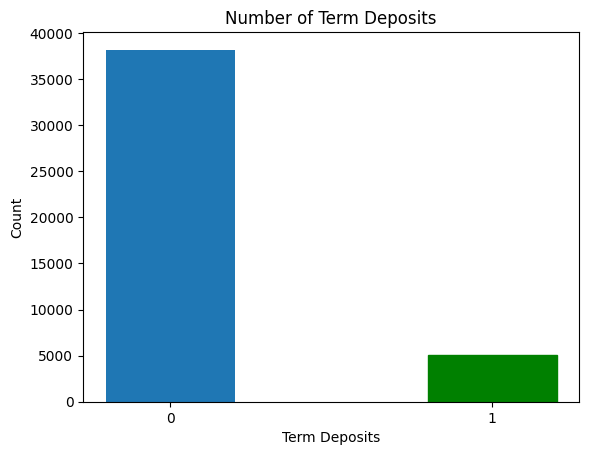

In [16]:
barlist = plt.bar([str(0),str(1)], y.value_counts(), width = 0.4)
barlist[1].set_color('g')

plt.xlabel("Term Deposits")
plt.ylabel("Count")
plt.title("Number of Term Deposits")
plt.show()

In [17]:
data_total

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome,Y
0,58,0.0,1,2.0,0,2143,1,0,0,5,4,261,1,-1,0,0,0
1,44,1.0,0,1.0,0,29,1,0,0,5,4,151,1,-1,0,0,0
2,33,2.0,1,1.0,0,2,1,1,0,5,4,76,1,-1,0,0,0
3,35,0.0,1,2.0,0,231,1,0,0,5,4,139,1,-1,0,0,0
4,28,0.0,0,2.0,0,447,1,1,0,5,4,217,1,-1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43188,51,1.0,1,2.0,0,825,0,0,1,17,10,977,3,-1,0,0,1
43189,71,4.0,2,0.0,0,1729,0,0,1,17,10,456,2,-1,0,0,1
43190,72,4.0,1,1.0,0,5715,0,0,1,17,10,1127,5,184,3,2,1
43191,57,3.0,1,1.0,0,668,0,0,2,17,10,508,4,-1,0,0,0


In [18]:
data_total.iloc[:, 3].value_counts()

,count
education,
1.0,23131
2.0,13262
0.0,6800


In [19]:
data2.iloc[:, 3].value_counts()

,count
3,
0.5,23131
1.0,13262
0.0,6800


# Splitting for Source and Target Domains:


# Full Dataset:

Grouping by 'International': domestic students are source data, international students are target data

In [20]:
data_S = data2[data2.iloc[:,3] > 0.4].reset_index(drop=True)  ## Source domain and classification - Secondary/Tertiary education
data_T = data2[data2.iloc[:,3] <= 0.4].reset_index(drop=True)  ## Target domain and classification - Primary education

In [21]:
data_S

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,Y
0,0.519481,0.0,0.5,1.0,0.0,0.092259,1.0,0.0,0.0,0.133333,0.363636,0.053070,0.000000,0.000000,0.000000,0.000000,0
1,0.337662,0.1,0.0,0.5,0.0,0.073067,1.0,0.0,0.0,0.133333,0.363636,0.030704,0.000000,0.000000,0.000000,0.000000,0
2,0.194805,0.2,0.5,0.5,0.0,0.072822,1.0,1.0,0.0,0.133333,0.363636,0.015453,0.000000,0.000000,0.000000,0.000000,0
3,0.220779,0.0,0.5,1.0,0.0,0.074901,1.0,0.0,0.0,0.133333,0.363636,0.028264,0.000000,0.000000,0.000000,0.000000,0
4,0.129870,0.0,0.0,1.0,0.0,0.076862,1.0,1.0,0.0,0.133333,0.363636,0.044124,0.000000,0.000000,0.000000,0.000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36388,0.090909,0.1,0.0,0.5,0.0,0.077388,0.0,1.0,0.5,0.533333,0.909091,0.078487,0.017544,0.000000,0.000000,0.000000,1
36389,0.428571,0.1,0.5,1.0,0.0,0.080293,0.0,0.0,0.5,0.533333,0.909091,0.198658,0.035088,0.000000,0.000000,0.000000,1
36390,0.701299,0.4,0.5,0.5,0.0,0.124689,0.0,0.0,0.5,0.533333,0.909091,0.229158,0.070175,0.212156,0.010909,0.666667,1
36391,0.506494,0.3,0.5,0.5,0.0,0.078868,0.0,0.0,1.0,0.533333,0.909091,0.103294,0.052632,0.000000,0.000000,0.000000,0


In [22]:
data_T

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,Y
0,0.519481,0.4,0.5,0.0,0.0,0.073902,1.0,0.0,0.0,0.133333,0.363636,0.010167,0.000000,0.000000,0.000000,0.000000,0
1,0.428571,0.4,0.5,0.0,0.0,0.074882,1.0,0.0,0.0,0.133333,0.363636,0.071777,0.000000,0.000000,0.000000,0.000000,0
2,0.506494,0.3,0.5,0.0,0.0,0.073275,1.0,0.0,0.0,0.133333,0.363636,0.007727,0.000000,0.000000,0.000000,0.000000,0
3,0.545455,0.4,0.5,0.0,0.0,0.073348,1.0,0.0,0.0,0.133333,0.363636,0.044530,0.000000,0.000000,0.000000,0.000000,0
4,0.181818,0.3,0.0,0.0,0.0,0.073012,1.0,1.0,0.0,0.133333,0.363636,0.032534,0.000000,0.000000,0.000000,0.000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6795,0.558442,0.9,0.5,0.0,0.0,0.074456,0.0,0.0,0.5,0.266667,0.909091,0.068117,0.000000,0.106651,0.047273,0.333333,0
6796,0.584416,0.4,0.5,0.0,0.0,0.106740,0.0,0.0,1.0,0.266667,0.909091,0.061204,0.000000,0.524083,0.014545,0.333333,0
6797,0.012987,1.0,0.0,0.0,0.0,0.075028,0.0,0.0,1.0,0.300000,0.909091,0.019927,0.017544,0.127294,0.007273,1.000000,0
6798,0.675325,0.4,0.5,0.0,0.0,0.075745,0.0,0.0,0.5,0.466667,0.909091,0.015860,0.000000,0.111239,0.025455,0.666667,0


## Source domain and task labels:

In [23]:
X_S_full = data_S.iloc[:, :-1]
X_S_full       ## Source domain


y_S_full = data_S.iloc[:, -1]
y_S_full       ## Source classification (response)

,Y
0,0
1,0
2,0
3,0
4,0
...,...
36388,1
36389,1
36390,1
36391,0


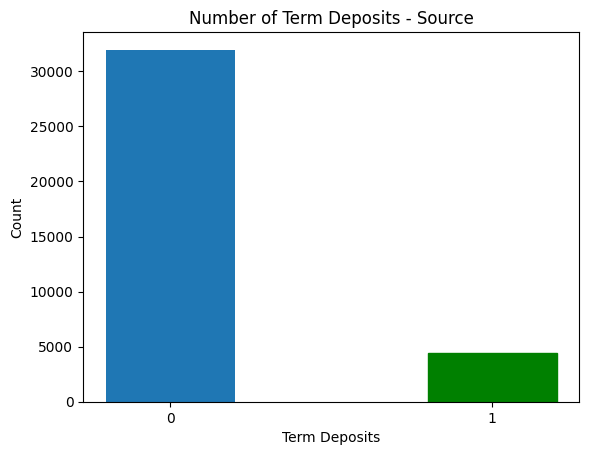

In [24]:
barlist_S = plt.bar([str(0),str(1)], y_S_full.value_counts(), width = 0.4)
barlist_S[1].set_color('g')

plt.xlabel("Term Deposits")
plt.ylabel("Count")
plt.title("Number of Term Deposits - Source")
plt.show()

## Target domain and task labels:

In [25]:
X_T_full = data_T.iloc[:, :-1]
X_T_full       ## Target domain


y_T_full = data_T.iloc[:, -1]
y_T_full       ## Target classification (response)

,Y
0,0
1,0
2,0
3,0
4,0
...,...
6795,0
6796,0
6797,0
6798,0


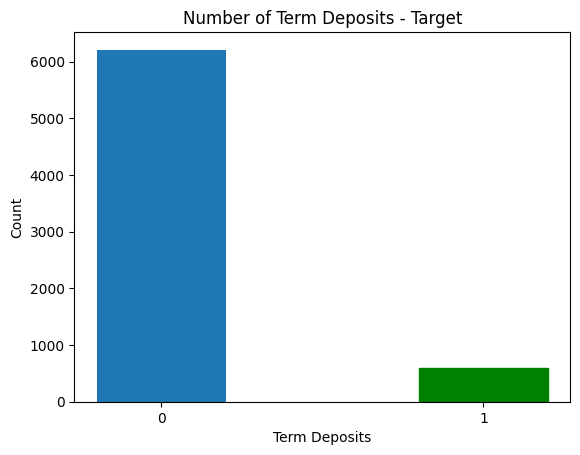

In [26]:
barlist_T = plt.bar([str(0),str(1)], y_T_full.value_counts(), width = 0.4)
barlist_T[1].set_color('g')

plt.xlabel("Term Deposits")
plt.ylabel("Count")
plt.title("Number of Term Deposits - Target")
plt.show()

## Updated Code (Modified from Shreya's code):

In [27]:
def create_dnn_model(input_shape):
  model = models.Sequential([layers.Dense(64, activation='relu', input_dim=input_shape),
        layers.Dense(32, activation='relu'),
        layers.Dense(1, activation='sigmoid')  # For binary classification (yes/no diabetes)
    ])

  model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['AUC'])

  return model



def train_and_evaluate(model, X_train, X_test, y_train, y_test, domain):

    time_start = perf_counter()

    # Training and validation
    model.fit(X_train, y_train, epochs=10, batch_size=32, validation_split=0.2)

    # Predict probabilities and calculate AUC
    y_pred_prob = model.predict(X_test).ravel()
    auc = roc_auc_score(y_test, y_pred_prob)
    print(f"AUC-ROC: {auc}")

    # Compute ROC curve
    fpr, tpr, _ = roc_curve(y_test, y_pred_prob)

    # Convert probabilities to binary predictions for confusion matrix
    y_pred_class = (y_pred_prob >= 0.5).astype(int)

    # Compute and print classification report
    class_report = classification_report(y_test, y_pred_class)
    print("Classification Report:")
    print(class_report)

    # Compute confusion matrix
    conf_matrix = confusion_matrix(y_test, y_pred_class)
    # conf_disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)

    # Plot ROC curve and Confusion Matrix side by side
    # fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # # ROC Curve
    # ax1.plot(fpr, tpr, color='blue', label=f'AUC-ROC = {auc:.2f}')
    # ax1.plot([0, 1], [0, 1], color='gray', linestyle='--')
    # ax1.set_xlabel('False Positive Rate')
    # ax1.set_ylabel('True Positive Rate')
    # ax1.set_title('Receiver Operating Characteristic (ROC) Curve')
    # ax1.legend(loc='lower right')
    # ax1.grid()

    # # Confusion Matrix
    # conf_disp.plot(ax=ax2, cmap='Blues')
    # ax2.set_title('Confusion Matrix')
    # plt.tight_layout()
    # plt.show()

    # Calculate precision and recall for different thresholds
    precision, recall, thresholds = precision_recall_curve(y_test, y_pred_prob)

    # Find the threshold where precision and recall are balanced
    f1_scores = 2 * (precision * recall) / (precision + recall)
    best_threshold = thresholds[f1_scores.argmax()]

    print(f"Best threshold based on F1-score: {best_threshold}")

    time_stop = perf_counter()

    time_elapsed = time_stop-time_start

    print('Time elapsed (performance):', time_elapsed)
    return time_elapsed


In [28]:
def Transductive_TL(model, X_test, y_test, domain):

    time_start = perf_counter()

    # Predict probabilities and calculate AUC
    y_pred_prob = model.predict(X_test).ravel()
    auc = roc_auc_score(y_test, y_pred_prob)
    print(f"AUC-ROC: {auc}")

    # Compute ROC curve
    fpr, tpr, _ = roc_curve(y_test, y_pred_prob)

    # Convert probabilities to binary predictions for confusion matrix
    y_pred_class = (y_pred_prob >= 0.5).astype(int)

    # Compute and print classification report
    class_report = classification_report(y_test, y_pred_class)
    print("Classification Report:")
    print(class_report)

    # Compute confusion matrix
    conf_matrix = confusion_matrix(y_test, y_pred_class)
    conf_disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)

    # Plot ROC curve and Confusion Matrix side by side
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # ROC Curve
    ax1.plot(fpr, tpr, color='blue', label=f'AUC-ROC = {auc:.2f}')
    ax1.plot([0, 1], [0, 1], color='gray', linestyle='--')
    ax1.set_xlabel('False Positive Rate')
    ax1.set_ylabel('True Positive Rate')
    ax1.set_title('Receiver Operating Characteristic (ROC) Curve')
    ax1.legend(loc='lower right')
    ax1.grid()

    # Confusion Matrix
    # print('Confusion matrix:', conf_matrix)
    fpr = conf_matrix[0][1]/(conf_matrix[0][0]+conf_matrix[0][1])
    tnr = 1-fpr

    fnr = conf_matrix[1][0]/(conf_matrix[1][0] + conf_matrix[1][1])
    tpr = 1 - fnr
    print('FPR', fpr, 'TPR:', tpr, 'FNR:', fnr, 'TNR:', tnr)
    conf_disp.plot(ax=ax2, cmap='Blues')
    ax2.set_title('Confusion Matrix')
    plt.tight_layout()
    plt.show()

    # Calculate precision and recall for different thresholds
    precision, recall, thresholds = precision_recall_curve(y_test, y_pred_prob)

    # Find the threshold where precision and recall are balanced
    f1_scores = 2 * (precision * recall) / (precision + recall)
    best_threshold = thresholds[f1_scores.argmax()]

    print(f"Best threshold based on F1-score: {best_threshold}")
    print('False Negative Rate:', fnr)

    time_stop = perf_counter()

    time_elapsed = time_stop-time_start

    print('Time elapsed (performance):', time_elapsed)

    return fpr, tnr, fnr, tpr, time_elapsed

In [29]:
X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_full, y_S_full, test_size=0.20, random_state=0)

In [30]:
print('X_S_train:',np.shape(X_S_train))
print('y_S_train:',np.shape(y_S_train))
print('X_S_test:',np.shape(X_S_test))
print('y_S_test:',np.shape(y_S_test))

X_S_train: (29114, 16)
y_S_train: (29114,)
X_S_test: (7279, 16)
y_S_test: (7279,)


In [ ]:
model_source = create_dnn_model(X_S_train.shape[1])

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6621 - loss: 0.3635 - val_AUC: 0.8654 - val_loss: 0.2782
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8646 - loss: 0.2668 - val_AUC: 0.8793 - val_loss: 0.2638
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8768 - loss: 0.2569 - val_AUC: 0.8822 - val_loss: 0.2610
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8767 - loss: 0.2532 - val_AUC: 0.8833 - val_loss: 0.2575
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8829 - loss: 0.2495 - val_AUC: 0.8872 - val_loss: 0.2553
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8885 - loss: 0.2433 - val_AUC: 0.8906 - val_loss: 0.2504
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8869 - loss: 0.2429 - val_AUC: 0.8930 - val_loss: 0.2485
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8940 - loss: 0.2384 - val_AUC: 0.8941 - val_loss: 0.2493
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AU

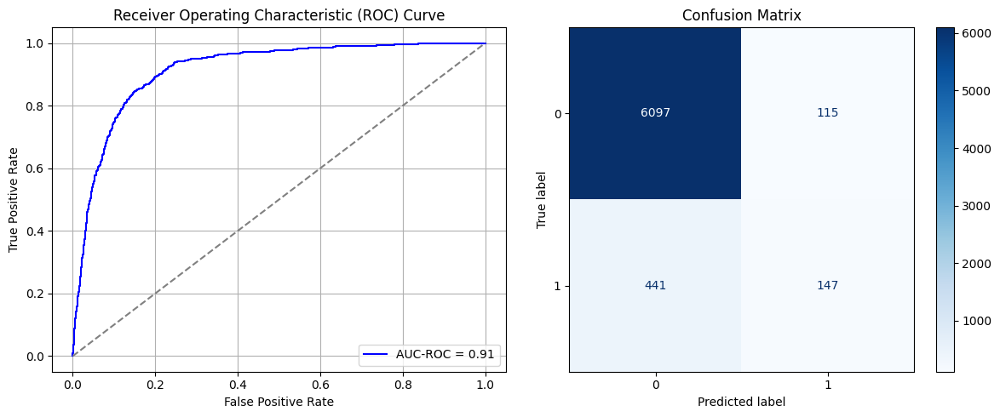

Best threshold based on F1-score: 0.16565173864364624
False Negative Rate: 0.75
Time elapsed (performance): 1.0317387399999802
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.6582 - loss: 0.3635 - val_AUC: 0.8629 - val_loss: 0.2817
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8697 - loss: 0.2654 - val_AUC: 0.8797 - val_loss: 0.2622
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8799 - loss: 0.2509 - val_AUC: 0.8837 - val_loss: 0.2574
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8832 - loss: 0.2509 - val_AUC: 0.8838 - val_loss: 0.2579
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8864 - loss: 0.2466 - val_AUC: 0.8892 - val_loss: 0.2529
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8874 - loss: 0.2473 - val_AUC: 0.8880 - val_loss: 0.2524
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - AUC: 0.8934 - loss: 0.2388 - val_AUC: 0.8933 - val_loss: 0.2509
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8951 - loss: 0.2392 - val_AUC: 0.8926 - val_loss: 0.2490
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8950 -

<ipython-input-29-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9148723558966406
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.97      0.96      6212
           1       0.55      0.38      0.45       588

    accuracy                           0.92      6800
   macro avg       0.75      0.67      0.70      6800
weighted avg       0.91      0.92      0.91      6800

FPR 0.029298132646490664 TPR: 0.37925170068027214 FNR: 0.6207482993197279 TNR: 0.9707018673535094


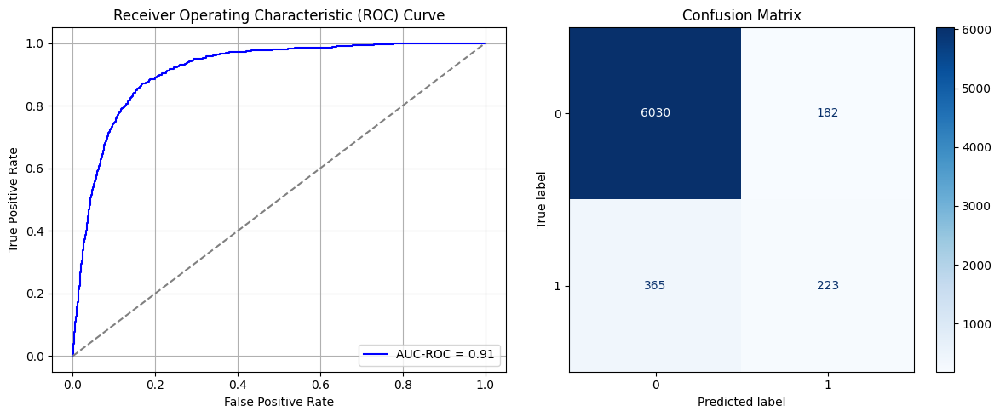

Best threshold based on F1-score: 0.2765471637248993
False Negative Rate: 0.6207482993197279
Time elapsed (performance): 0.7208422679999558
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.6420 - loss: 0.3926 - val_AUC: 0.8642 - val_loss: 0.2839
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8666 - loss: 0.2706 - val_AUC: 0.8774 - val_loss: 0.2778
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8766 - loss: 0.2551 - val_AUC: 0.8813 - val_loss: 0.2634
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8790 - loss: 0.2565 - val_AUC: 0.8844 - val_loss: 0.2679
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - AUC: 0.8794 - loss: 0.2516 - val_AUC: 0.8843 - val_loss: 0.2594
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8811 - loss: 0.2534 - val_AUC: 0.8857 - val_loss: 0.2565
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8812 - loss: 0.2511 - val_AUC: 0.8866 - val_loss: 0.2543
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8824 - loss: 0.2447 - val_AUC: 0.8869 - val_loss: 0.2541
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8890 -

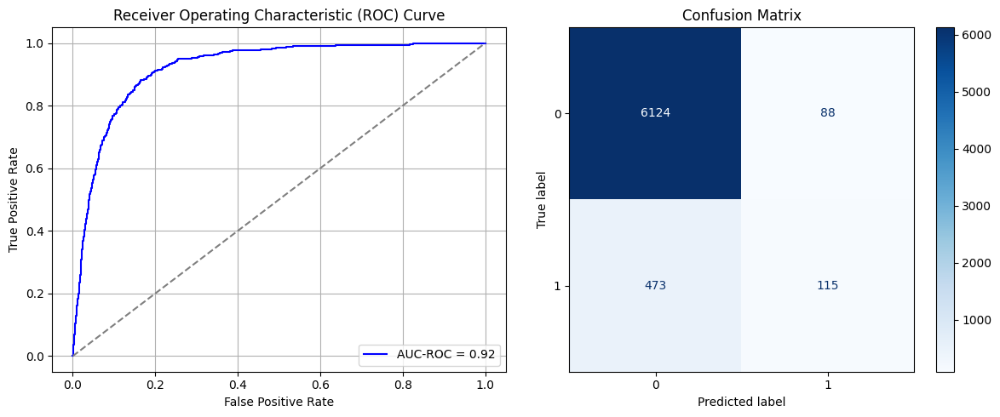

Best threshold based on F1-score: 0.8042197823524475
False Negative Rate: 0.8044217687074829
Time elapsed (performance): 0.7788296499999774
Epoch 1/10


<ipython-input-30-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.6574 - loss: 0.3650 - val_AUC: 0.8667 - val_loss: 0.2812
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8680 - loss: 0.2635 - val_AUC: 0.8788 - val_loss: 0.2670
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8810 - loss: 0.2534 - val_AUC: 0.8840 - val_loss: 0.2585
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8839 - loss: 0.2494 - val_AUC: 0.8840 - val_loss: 0.2595
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8897 - loss: 0.2398 - val_AUC: 0.8860 - val_loss: 0.2582
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8909 - loss: 0.2395 - val_AUC: 0.8865 - val_loss: 0.2593
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8918 - loss: 0.2427 - val_AUC: 0.8910 - val_loss: 0.2528
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8935 - loss: 0.2344 - val_AUC: 0.8899 - val_loss: 0.2595
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8922 -

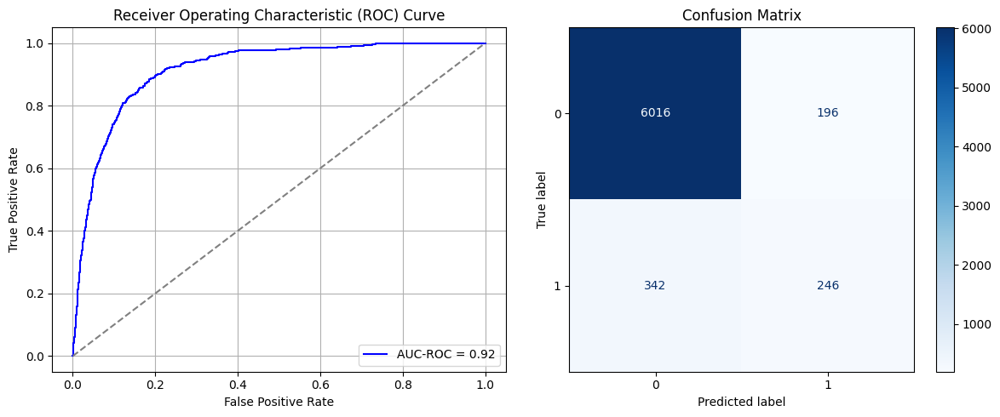

Best threshold based on F1-score: 0.3603358864784241
False Negative Rate: 0.5816326530612245
Time elapsed (performance): 1.1948640979999823
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6448 - loss: 0.3777 - val_AUC: 0.8580 - val_loss: 0.2866
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8607 - loss: 0.2602 - val_AUC: 0.8800 - val_loss: 0.2723
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8788 - loss: 0.2552 - val_AUC: 0.8826 - val_loss: 0.2583
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8855 - loss: 0.2495 - val_AUC: 0.8843 - val_loss: 0.2556
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8864 - loss: 0.2426 - val_AUC: 0.8838 - val_loss: 0.2585
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - AUC: 0.8898 - loss: 0.2427 - val_AUC: 0.8888 - val_loss: 0.2613
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8963 - loss: 0.2360 - val_AUC: 0.8850 - val_loss: 0.2573
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8937 - loss: 0.2341 - val_AUC: 0.8912 - val_loss: 0.2509
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8896 -

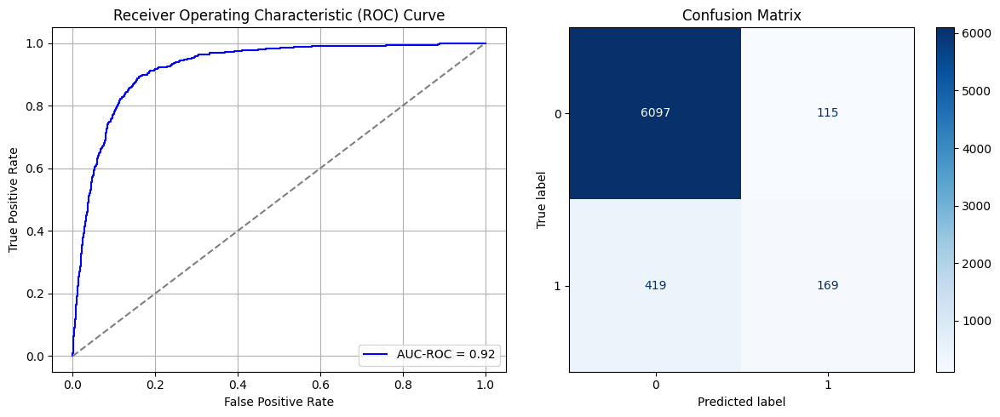

Best threshold based on F1-score: 0.1940212845802307
False Negative Rate: 0.7125850340136054
Time elapsed (performance): 0.7589045670000019
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6727 - loss: 0.3633 - val_AUC: 0.8729 - val_loss: 0.2757
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8760 - loss: 0.2608 - val_AUC: 0.8808 - val_loss: 0.2740
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8845 - loss: 0.2522 - val_AUC: 0.8816 - val_loss: 0.2607
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8900 - loss: 0.2435 - val_AUC: 0.8850 - val_loss: 0.2576
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8857 - loss: 0.2509 - val_AUC: 0.8856 - val_loss: 0.2630
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - AUC: 0.8820 - loss: 0.2452 - val_AUC: 0.8864 - val_loss: 0.2545
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8875 - loss: 0.2454 - val_AUC: 0.8903 - val_loss: 0.2513
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8912 - loss: 0.2402 - val_AUC: 0.8914 - val_loss: 0.2534
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8944 -

<ipython-input-29-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9218021078360515
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.98      0.96      6212
           1       0.59      0.29      0.38       588

    accuracy                           0.92      6800
   macro avg       0.76      0.63      0.67      6800
weighted avg       0.91      0.92      0.91      6800

FPR 0.019156471345782355 TPR: 0.2857142857142857 FNR: 0.7142857142857143 TNR: 0.9808435286542176


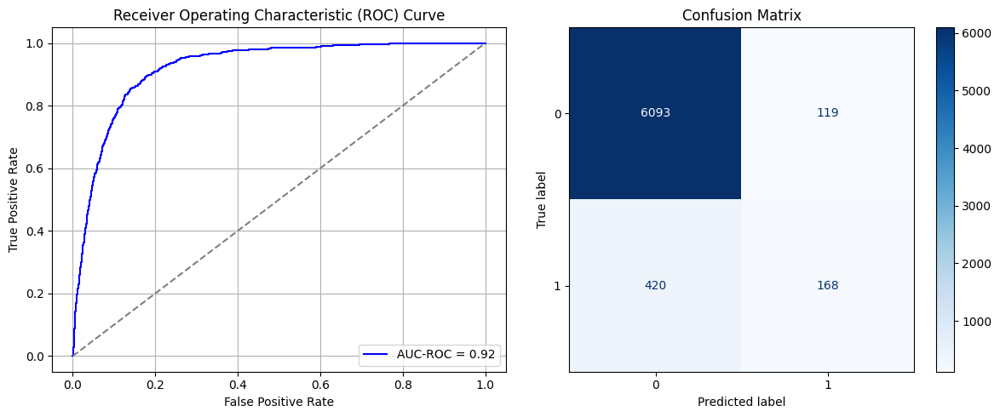

Best threshold based on F1-score: 0.787860095500946
False Negative Rate: 0.7142857142857143
Time elapsed (performance): 0.7440261600000326
Epoch 1/10


<ipython-input-30-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.6524 - loss: 0.3769 - val_AUC: 0.8650 - val_loss: 0.2798
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8672 - loss: 0.2644 - val_AUC: 0.8804 - val_loss: 0.2649
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8816 - loss: 0.2514 - val_AUC: 0.8839 - val_loss: 0.2573
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8768 - loss: 0.2557 - val_AUC: 0.8864 - val_loss: 0.2552
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8856 - loss: 0.2459 - val_AUC: 0.8896 - val_loss: 0.2518
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8876 - loss: 0.2493 - val_AUC: 0.8921 - val_loss: 0.2517
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8937 - loss: 0.2414 - val_AUC: 0.8905 - val_loss: 0.2579
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8964 - loss: 0.2364 - val_AUC: 0.8957 - val_loss: 0.2463
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8950 -

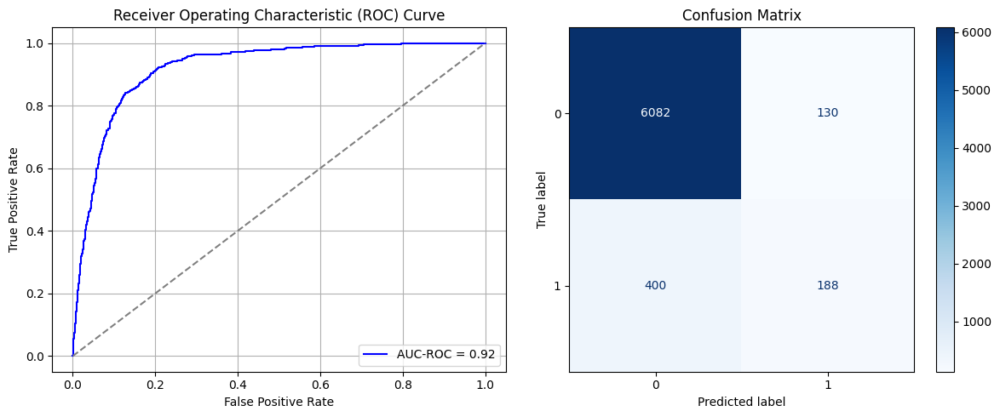

Best threshold based on F1-score: 0.20897316932678223
False Negative Rate: 0.6802721088435374
Time elapsed (performance): 0.7490924569999606
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6470 - loss: 0.3781 - val_AUC: 0.8666 - val_loss: 0.2774
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8689 - loss: 0.2648 - val_AUC: 0.8810 - val_loss: 0.2623
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8802 - loss: 0.2525 - val_AUC: 0.8834 - val_loss: 0.2599
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8816 - loss: 0.2468 - val_AUC: 0.8850 - val_loss: 0.2559
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8818 - loss: 0.2481 - val_AUC: 0.8845 - val_loss: 0.2571
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8882 - loss: 0.2458 - val_AUC: 0.8865 - val_loss: 0.2545
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8863 - loss: 0.2477 - val_AUC: 0.8867 - val_loss: 0.2540
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8914 - loss: 0.2407 - val_AUC: 0.8888 - val_loss: 0.2527
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8951 -

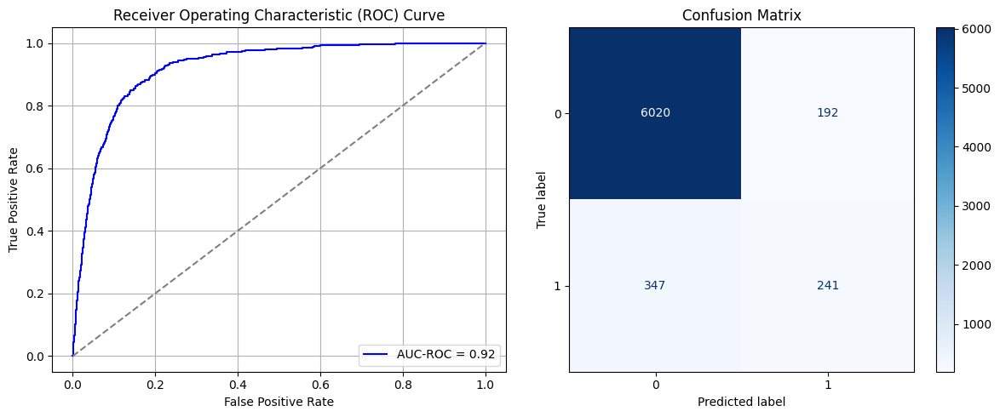

Best threshold based on F1-score: 0.8105908632278442
False Negative Rate: 0.5901360544217688
Time elapsed (performance): 0.7847304389999863
Epoch 1/10


<ipython-input-30-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.6705 - loss: 0.3610 - val_AUC: 0.8741 - val_loss: 0.2723
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8664 - loss: 0.2638 - val_AUC: 0.8776 - val_loss: 0.2740
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8793 - loss: 0.2478 - val_AUC: 0.8797 - val_loss: 0.2612
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8775 - loss: 0.2547 - val_AUC: 0.8840 - val_loss: 0.2629
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8799 - loss: 0.2494 - val_AUC: 0.8852 - val_loss: 0.2648
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - AUC: 0.8824 - loss: 0.2490 - val_AUC: 0.8866 - val_loss: 0.2555
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8890 - loss: 0.2416 - val_AUC: 0.8891 - val_loss: 0.2517
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8953 - loss: 0.2403 - val_AUC: 0.8912 - val_loss: 0.2554
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8864 -

<ipython-input-29-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9175772369475802
Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.98      0.96      6212
           1       0.60      0.25      0.35       588

    accuracy                           0.92      6800
   macro avg       0.77      0.62      0.66      6800
weighted avg       0.90      0.92      0.91      6800

FPR 0.015453960077269801 TPR: 0.25 FNR: 0.75 TNR: 0.9845460399227302


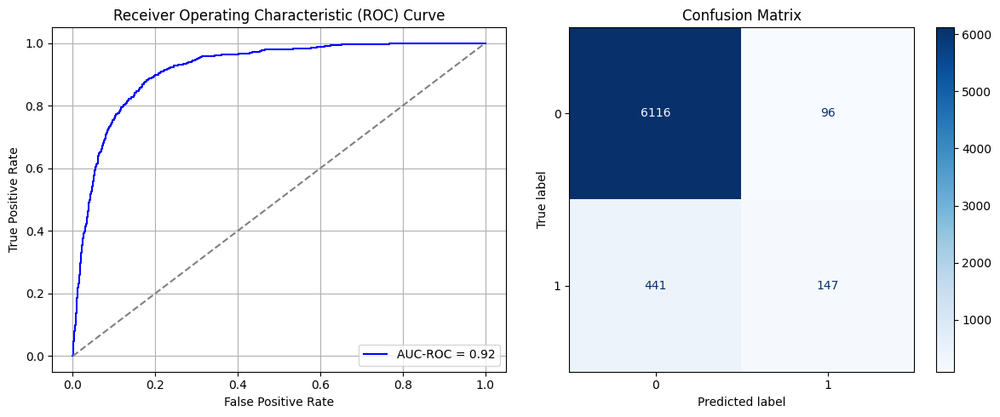

Best threshold based on F1-score: 0.7237189412117004
False Negative Rate: 0.75
Time elapsed (performance): 0.7725597169999219
Epoch 1/10


<ipython-input-30-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6773 - loss: 0.3527 - val_AUC: 0.8716 - val_loss: 0.2807
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8753 - loss: 0.2543 - val_AUC: 0.8800 - val_loss: 0.2619
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8810 - loss: 0.2522 - val_AUC: 0.8832 - val_loss: 0.2611
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8781 - loss: 0.2489 - val_AUC: 0.8863 - val_loss: 0.2548
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8821 - loss: 0.2497 - val_AUC: 0.8861 - val_loss: 0.2550
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8822 - loss: 0.2550 - val_AUC: 0.8888 - val_loss: 0.2526
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8872 - loss: 0.2446 - val_AUC: 0.8889 - val_loss: 0.2596
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8925 - loss: 0.2409 - val_AUC: 0.8923 - val_loss: 0.2494
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8886 -

<ipython-input-29-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9193822248796493
Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.99      0.96      6212
           1       0.60      0.17      0.27       588

    accuracy                           0.92      6800
   macro avg       0.77      0.58      0.61      6800
weighted avg       0.90      0.92      0.90      6800

FPR 0.010624597553122988 TPR: 0.17176870748299322 FNR: 0.8282312925170068 TNR: 0.989375402446877


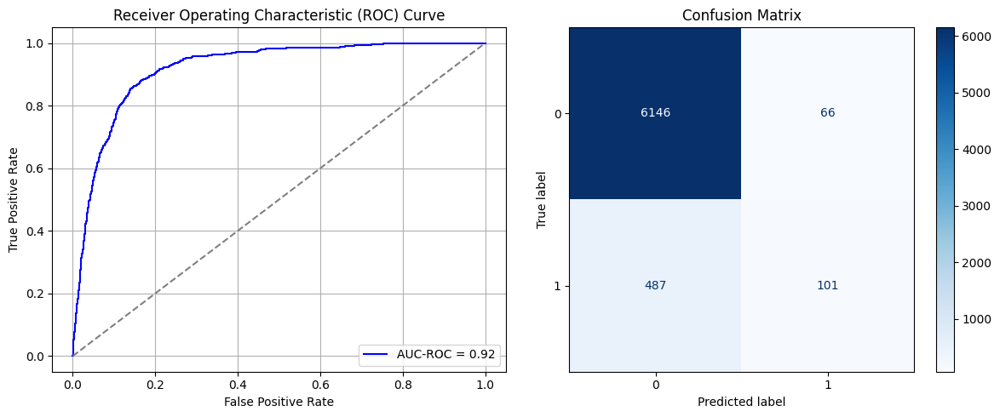

Best threshold based on F1-score: 0.7306824326515198
False Negative Rate: 0.8282312925170068
Time elapsed (performance): 0.7568912169999749


<ipython-input-30-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


In [ ]:
times = 10

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_full, y_S_full, test_size=0.20, random_state=0)
    model_source = create_dnn_model(X_S_train.shape[1])
    result_imbalanced = train_and_evaluate(model_source, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_imbalanced = Transductive_TL(model_source, X_T_full, y_T_full, "Target")

    Training_time.append(result_imbalanced)
    FPR.append(result_TL_imbalanced[0])
    TNR.append(result_TL_imbalanced[1])
    FNR.append(result_TL_imbalanced[2])
    TPR.append(result_TL_imbalanced[3])
    TL_time.append(result_TL_imbalanced[4])

ParamFit = pd.DataFrame([Training_time, FPR, TPR, FNR, TNR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TPR', 'FNR', 'TNR', 'Target time']
# print(ParamFit)

In [ ]:
print(ParamFit)
ParamFit.to_csv('Imbalanced.csv')

## Remember that TPR is actually TNR and TNR is actually TPR!!!

   Source time       FPR       TPR       FNR       TNR  Target time
0    25.734774  0.018513  0.250000  0.750000  0.981487     1.031739
1    24.956974  0.029298  0.379252  0.620748  0.970702     0.720842
2    25.711288  0.014166  0.195578  0.804422  0.985834     0.778830
3    27.777824  0.031552  0.418367  0.581633  0.968448     1.194864
4    29.705885  0.018513  0.287415  0.712585  0.981487     0.758905
5    28.758704  0.019156  0.285714  0.714286  0.980844     0.744026
6    32.446221  0.020927  0.319728  0.680272  0.979073     0.749092
7    29.316765  0.030908  0.409864  0.590136  0.969092     0.784730
8    32.206434  0.015454  0.250000  0.750000  0.984546     0.772560
9    25.652454  0.010625  0.171769  0.828231  0.989375     0.756891


# Random Undersampling (RUS) to balance Dataset:

## SRS Sample without Replacement:

In [31]:
data_S

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,Y
0,0.519481,0.0,0.5,1.0,0.0,0.092259,1.0,0.0,0.0,0.133333,0.363636,0.053070,0.000000,0.000000,0.000000,0.000000,0
1,0.337662,0.1,0.0,0.5,0.0,0.073067,1.0,0.0,0.0,0.133333,0.363636,0.030704,0.000000,0.000000,0.000000,0.000000,0
2,0.194805,0.2,0.5,0.5,0.0,0.072822,1.0,1.0,0.0,0.133333,0.363636,0.015453,0.000000,0.000000,0.000000,0.000000,0
3,0.220779,0.0,0.5,1.0,0.0,0.074901,1.0,0.0,0.0,0.133333,0.363636,0.028264,0.000000,0.000000,0.000000,0.000000,0
4,0.129870,0.0,0.0,1.0,0.0,0.076862,1.0,1.0,0.0,0.133333,0.363636,0.044124,0.000000,0.000000,0.000000,0.000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36388,0.090909,0.1,0.0,0.5,0.0,0.077388,0.0,1.0,0.5,0.533333,0.909091,0.078487,0.017544,0.000000,0.000000,0.000000,1
36389,0.428571,0.1,0.5,1.0,0.0,0.080293,0.0,0.0,0.5,0.533333,0.909091,0.198658,0.035088,0.000000,0.000000,0.000000,1
36390,0.701299,0.4,0.5,0.5,0.0,0.124689,0.0,0.0,0.5,0.533333,0.909091,0.229158,0.070175,0.212156,0.010909,0.666667,1
36391,0.506494,0.3,0.5,0.5,0.0,0.078868,0.0,0.0,1.0,0.533333,0.909091,0.103294,0.052632,0.000000,0.000000,0.000000,0


In [32]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

4433
31960


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6619 - loss: 0.6551 - val_AUC: 0.7752 - val_loss: 0.5795
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7918 - loss: 0.5609 - val_AUC: 0.8443 - val_loss: 0.5029
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8616 - loss: 0.4746 - val_AUC: 0.8726 - val_loss: 0.4552
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8724 - loss: 0.4550 - val_AUC: 0.8758 - val_loss: 0.4452
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8812 - loss: 0.4384 - val_AUC: 0.8796 - val_loss: 0.4361
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8855 - loss: 0.4281 - val_AUC: 0.8789 - val_loss: 0.4710
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8748 - loss: 0.4446 - val_AUC: 0.8812 - val_loss: 0.4338
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8784 - loss: 0.4383 - val_AUC: 0.8827 - val_loss: 0.4311
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8856 -

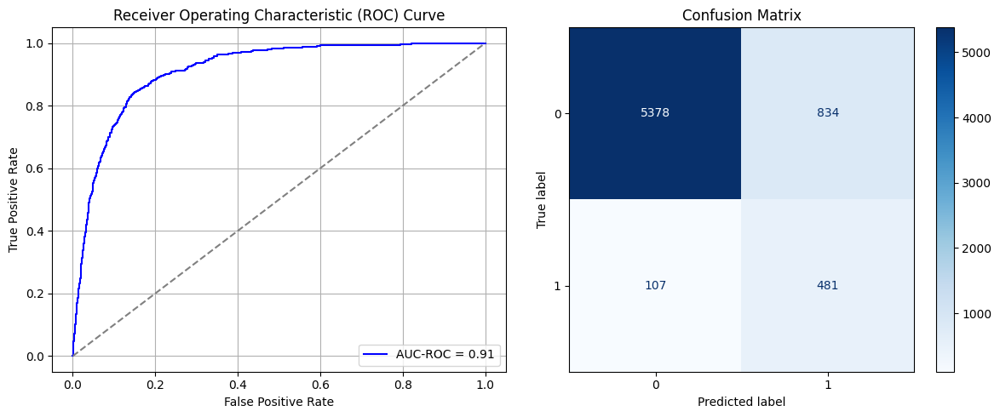

Best threshold based on F1-score: 0.9868438839912415
False Negative Rate: 0.18197278911564627
Time elapsed (performance): 0.7779289959999005
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6914 - loss: 0.6447 - val_AUC: 0.7805 - val_loss: 0.5729
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8025 - loss: 0.5474 - val_AUC: 0.8599 - val_loss: 0.4945
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8576 - loss: 0.4854 - val_AUC: 0.8782 - val_loss: 0.4502
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8724 - loss: 0.4544 - val_AUC: 0.8807 - val_loss: 0.4433
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8784 - loss: 0.4413 - val_AUC: 0.8846 - val_loss: 0.4328
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8760 - loss: 0.4419 - val_AUC: 0.8846 - val_loss: 0.4320
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8806 - loss: 0.4384 - val_AUC: 0.8867 - val_loss: 0.4518
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8826 - loss: 0.4317 - val_AUC: 0.8856 - val_loss: 0.4304
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8844 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9161883845618093
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.81      0.89      6212
           1       0.31      0.87      0.45       588

    accuracy                           0.82      6800
   macro avg       0.65      0.84      0.67      6800
weighted avg       0.93      0.82      0.85      6800

FPR 0.18641339343206698 TPR: 0.8741496598639455 FNR: 0.12585034013605442 TNR: 0.813586606567933


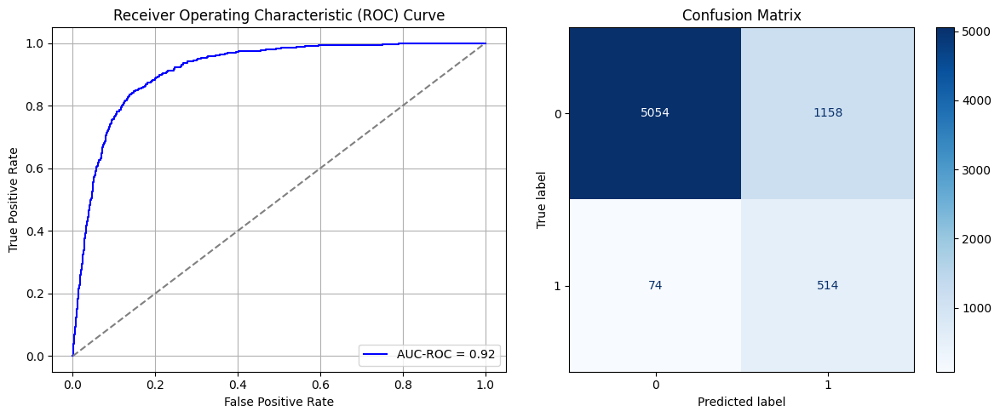

Best threshold based on F1-score: 0.9977043271064758
False Negative Rate: 0.12585034013605442
Time elapsed (performance): 0.7849933200000123
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6425 - loss: 0.6656 - val_AUC: 0.7592 - val_loss: 0.5908
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7847 - loss: 0.5686 - val_AUC: 0.8427 - val_loss: 0.5100
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8472 - loss: 0.4982 - val_AUC: 0.8664 - val_loss: 0.4677
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8680 - loss: 0.4641 - val_AUC: 0.8649 - val_loss: 0.4757
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8713 - loss: 0.4535 - val_AUC: 0.8675 - val_loss: 0.4625
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8739 - loss: 0.4498 - val_AUC: 0.8728 - val_loss: 0.4503
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8895 - loss: 0.4216 - val_AUC: 0.8693 - val_loss: 0.4654
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8794 - loss: 0.4376 - val_AUC: 0.8727 - val_loss: 0.4480
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8893 -

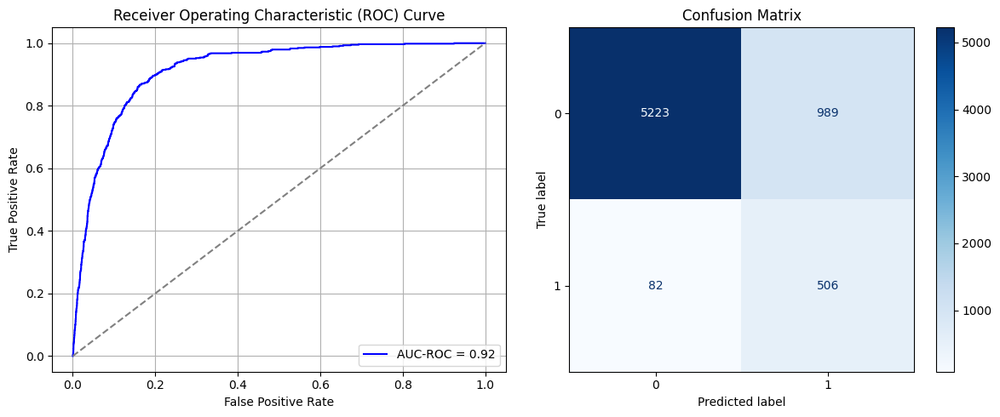

Best threshold based on F1-score: 0.7498011589050293
False Negative Rate: 0.13945578231292516
Time elapsed (performance): 1.0693814169999314
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6775 - loss: 0.6506 - val_AUC: 0.7740 - val_loss: 0.5805
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7812 - loss: 0.5710 - val_AUC: 0.8637 - val_loss: 0.4982
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8439 - loss: 0.5057 - val_AUC: 0.8847 - val_loss: 0.4516
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8622 - loss: 0.4727 - val_AUC: 0.8835 - val_loss: 0.4401
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8684 - loss: 0.4612 - val_AUC: 0.8868 - val_loss: 0.4451
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8764 - loss: 0.4551 - val_AUC: 0.8867 - val_loss: 0.4470
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8886 - loss: 0.4318 - val_AUC: 0.8889 - val_loss: 0.4285
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8834 - loss: 0.4379 - val_AUC: 0.8907 - val_loss: 0.4229
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8902 -

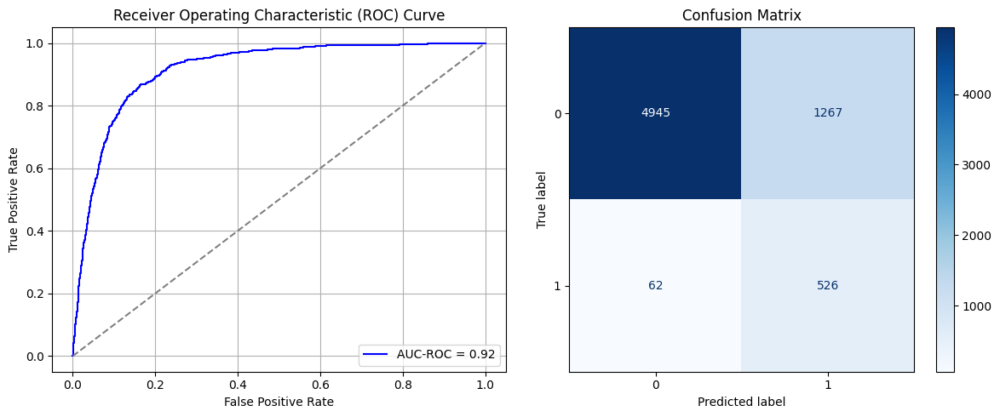

Best threshold based on F1-score: 0.9975916147232056
False Negative Rate: 0.1054421768707483
Time elapsed (performance): 1.0366303420000804
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6495 - loss: 0.6635 - val_AUC: 0.7588 - val_loss: 0.5924
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7854 - loss: 0.5662 - val_AUC: 0.8399 - val_loss: 0.5457
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8477 - loss: 0.5007 - val_AUC: 0.8647 - val_loss: 0.4786
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8793 - loss: 0.4475 - val_AUC: 0.8686 - val_loss: 0.4841
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8718 - loss: 0.4532 - val_AUC: 0.8710 - val_loss: 0.4633
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8819 - loss: 0.4399 - val_AUC: 0.8714 - val_loss: 0.4590
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8849 - loss: 0.4322 - val_AUC: 0.8705 - val_loss: 0.4619
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8934 - loss: 0.4167 - val_AUC: 0.8731 - val_loss: 0.4557
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8844 -

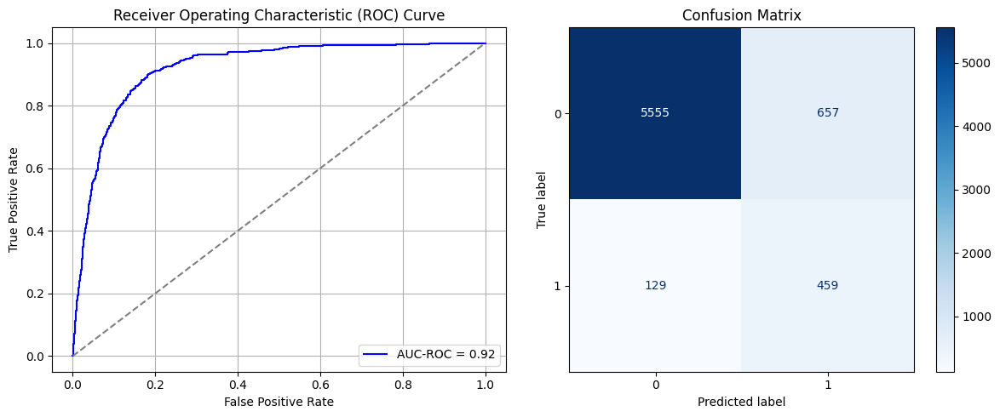

Best threshold based on F1-score: 0.9995564222335815
False Negative Rate: 0.2193877551020408
Time elapsed (performance): 0.7579278140001406
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.6534 - loss: 0.6559 - val_AUC: 0.7781 - val_loss: 0.5949
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7935 - loss: 0.5606 - val_AUC: 0.8514 - val_loss: 0.5047
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8622 - loss: 0.4812 - val_AUC: 0.8672 - val_loss: 0.4678
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8802 - loss: 0.4432 - val_AUC: 0.8693 - val_loss: 0.4642
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8780 - loss: 0.4462 - val_AUC: 0.8730 - val_loss: 0.4534
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8812 - loss: 0.4365 - val_AUC: 0.8710 - val_loss: 0.4535
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8793 - loss: 0.4382 - val_AUC: 0.8725 - val_loss: 0.4552
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8845 - loss: 0.4306 - val_AUC: 0.8755 - val_loss: 0.4445
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8875 -

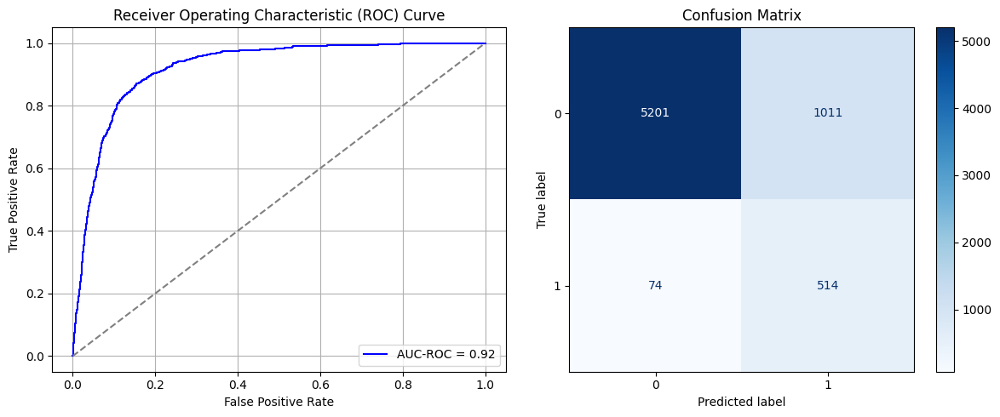

Best threshold based on F1-score: 0.9986458420753479
False Negative Rate: 0.12585034013605442
Time elapsed (performance): 0.7797325350002211
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6402 - loss: 0.6663 - val_AUC: 0.7867 - val_loss: 0.5820
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7981 - loss: 0.5574 - val_AUC: 0.8660 - val_loss: 0.4846
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8675 - loss: 0.4738 - val_AUC: 0.8755 - val_loss: 0.4551
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8690 - loss: 0.4613 - val_AUC: 0.8782 - val_loss: 0.4688
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8818 - loss: 0.4436 - val_AUC: 0.8814 - val_loss: 0.4464
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8793 - loss: 0.4441 - val_AUC: 0.8819 - val_loss: 0.4564
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8842 - loss: 0.4352 - val_AUC: 0.8831 - val_loss: 0.4409
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8924 - loss: 0.4210 - val_AUC: 0.8837 - val_loss: 0.4357
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8811 -

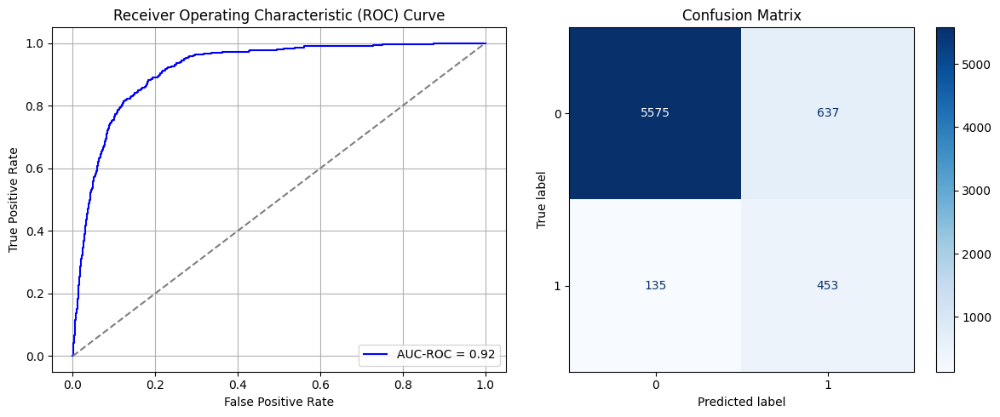

Best threshold based on F1-score: 0.999355137348175
False Negative Rate: 0.22959183673469388
Time elapsed (performance): 1.0378669420001643
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6484 - loss: 0.6629 - val_AUC: 0.7635 - val_loss: 0.5894
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7900 - loss: 0.5638 - val_AUC: 0.8531 - val_loss: 0.5088
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8684 - loss: 0.4712 - val_AUC: 0.8660 - val_loss: 0.4686
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8801 - loss: 0.4440 - val_AUC: 0.8737 - val_loss: 0.4596
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8974 - loss: 0.4116 - val_AUC: 0.8744 - val_loss: 0.4489
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8962 - loss: 0.4113 - val_AUC: 0.8758 - val_loss: 0.4531
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8814 - loss: 0.4393 - val_AUC: 0.8761 - val_loss: 0.4489
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9037 - loss: 0.3964 - val_AUC: 0.8752 - val_loss: 0.4490
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8945 -

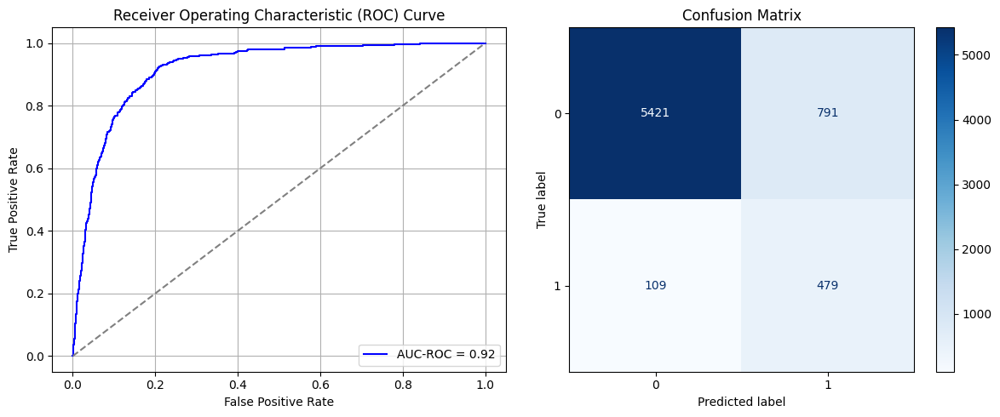

Best threshold based on F1-score: 0.9990766644477844
False Negative Rate: 0.18537414965986396
Time elapsed (performance): 0.782543368000006
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6381 - loss: 0.6614 - val_AUC: 0.7635 - val_loss: 0.5907
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7927 - loss: 0.5597 - val_AUC: 0.8397 - val_loss: 0.5153
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8535 - loss: 0.4916 - val_AUC: 0.8594 - val_loss: 0.4754
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8732 - loss: 0.4528 - val_AUC: 0.8648 - val_loss: 0.4644
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8737 - loss: 0.4495 - val_AUC: 0.8652 - val_loss: 0.4638
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8806 - loss: 0.4356 - val_AUC: 0.8692 - val_loss: 0.4539
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8731 - loss: 0.4501 - val_AUC: 0.8698 - val_loss: 0.4517
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8849 - loss: 0.4268 - val_AUC: 0.8702 - val_loss: 0.4550
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8752 -

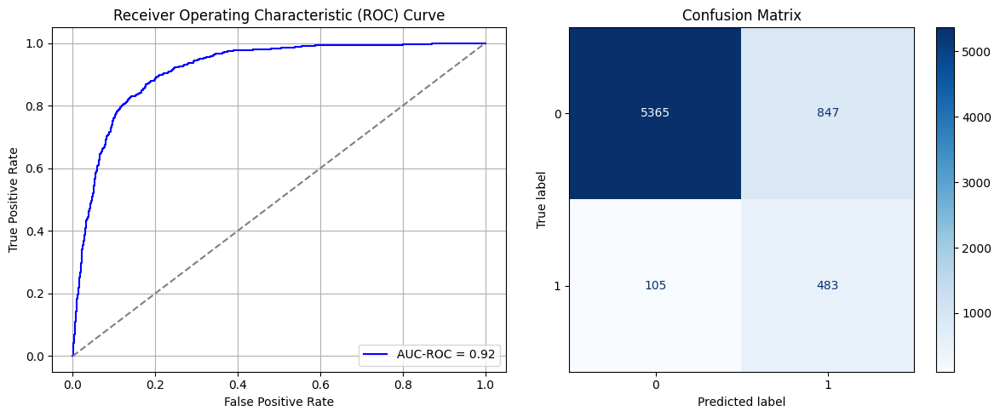

Best threshold based on F1-score: 0.9959094524383545
False Negative Rate: 0.17857142857142858
Time elapsed (performance): 0.767580315000032
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6656 - loss: 0.6543 - val_AUC: 0.7667 - val_loss: 0.5881
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7888 - loss: 0.5657 - val_AUC: 0.8494 - val_loss: 0.5018
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8482 - loss: 0.4952 - val_AUC: 0.8701 - val_loss: 0.4605
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8695 - loss: 0.4614 - val_AUC: 0.8740 - val_loss: 0.4510
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8759 - loss: 0.4517 - val_AUC: 0.8760 - val_loss: 0.4464
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8890 - loss: 0.4239 - val_AUC: 0.8778 - val_loss: 0.4415
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8932 - loss: 0.4173 - val_AUC: 0.8792 - val_loss: 0.4385
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8853 - loss: 0.4288 - val_AUC: 0.8800 - val_loss: 0.4436
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8996 -

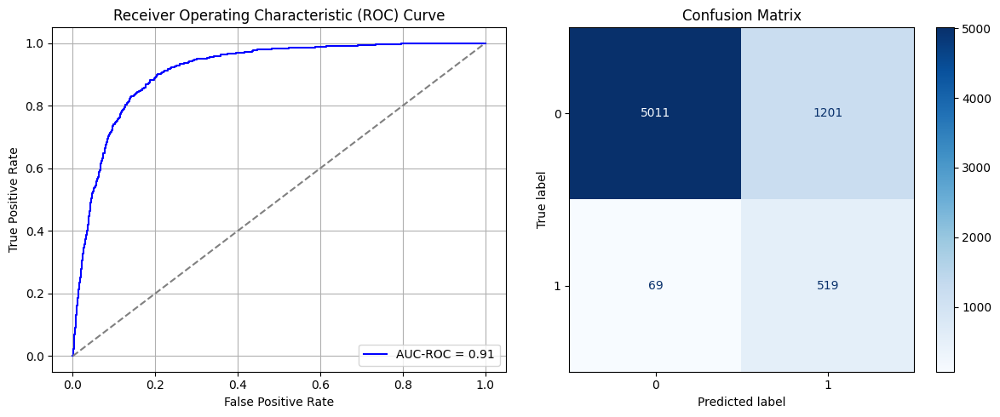

Best threshold based on F1-score: 0.9988345503807068
False Negative Rate: 0.11734693877551021
Time elapsed (performance): 1.20303735699963
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6701 - loss: 0.6590 - val_AUC: 0.7744 - val_loss: 0.5810
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7845 - loss: 0.5659 - val_AUC: 0.8618 - val_loss: 0.4874
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8547 - loss: 0.4897 - val_AUC: 0.8810 - val_loss: 0.4618
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8637 - loss: 0.4756 - val_AUC: 0.8852 - val_loss: 0.4340
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8767 - loss: 0.4497 - val_AUC: 0.8855 - val_loss: 0.4295
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8801 - loss: 0.4410 - val_AUC: 0.8869 - val_loss: 0.4290
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8779 - loss: 0.4464 - val_AUC: 0.8884 - val_loss: 0.4203
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8859 - loss: 0.4312 - val_AUC: 0.8898 - val_loss: 0.4175
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8822 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9206194068097296
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.82      0.90      6212
           1       0.32      0.88      0.47       588

    accuracy                           0.83      6800
   macro avg       0.65      0.85      0.69      6800
weighted avg       0.93      0.83      0.86      6800

FPR 0.1753058596265293 TPR: 0.8809523809523809 FNR: 0.11904761904761904 TNR: 0.8246941403734707


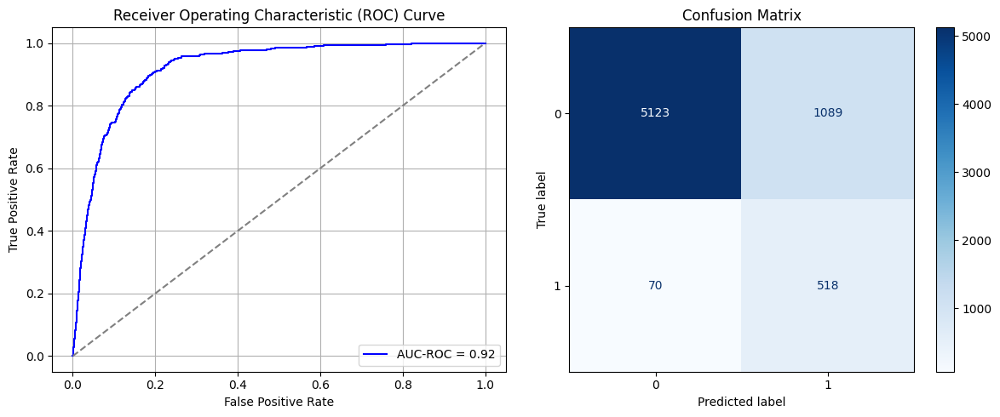

Best threshold based on F1-score: 0.9953060150146484
False Negative Rate: 0.11904761904761904
Time elapsed (performance): 1.0350455120001243
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6826 - loss: 0.6566 - val_AUC: 0.7786 - val_loss: 0.5767
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8001 - loss: 0.5512 - val_AUC: 0.8638 - val_loss: 0.4853
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8672 - loss: 0.4738 - val_AUC: 0.8779 - val_loss: 0.4543
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8769 - loss: 0.4525 - val_AUC: 0.8839 - val_loss: 0.4508
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8647 - loss: 0.4693 - val_AUC: 0.8812 - val_loss: 0.4530
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8835 - loss: 0.4419 - val_AUC: 0.8841 - val_loss: 0.4398
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8836 - loss: 0.4388 - val_AUC: 0.8833 - val_loss: 0.4502
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8851 - loss: 0.4358 - val_AUC: 0.8841 - val_loss: 0.4345
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8787 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9179016584096612
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.84      0.91      6212
           1       0.34      0.87      0.48       588

    accuracy                           0.84      6800
   macro avg       0.66      0.85      0.70      6800
weighted avg       0.93      0.84      0.87      6800

FPR 0.1624275595621378 TPR: 0.8690476190476191 FNR: 0.13095238095238096 TNR: 0.8375724404378622


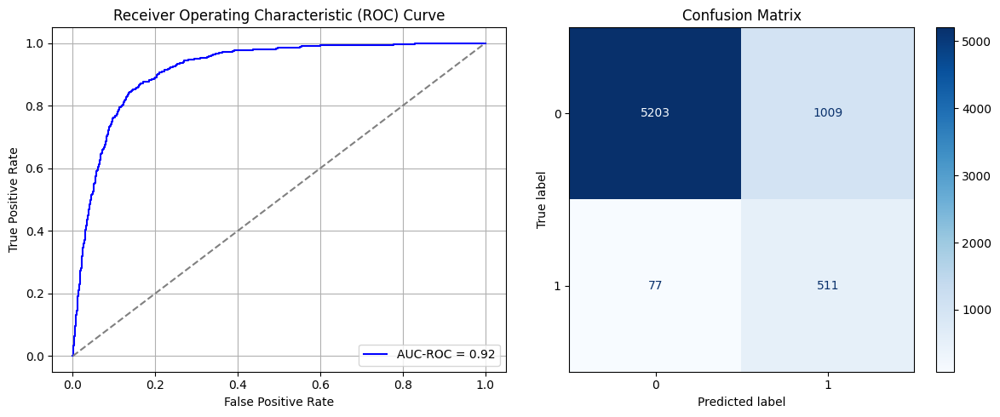

Best threshold based on F1-score: 0.6568942070007324
False Negative Rate: 0.13095238095238096
Time elapsed (performance): 0.7987088549998589
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6715 - loss: 0.6546 - val_AUC: 0.7658 - val_loss: 0.5865
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.7921 - loss: 0.5571 - val_AUC: 0.8382 - val_loss: 0.5114
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8518 - loss: 0.4941 - val_AUC: 0.8644 - val_loss: 0.4722
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8750 - loss: 0.4534 - val_AUC: 0.8725 - val_loss: 0.4616
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8875 - loss: 0.4287 - val_AUC: 0.8748 - val_loss: 0.4513
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8862 - loss: 0.4291 - val_AUC: 0.8751 - val_loss: 0.4483
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8817 - loss: 0.4336 - val_AUC: 0.8763 - val_loss: 0.4803
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8819 - loss: 0.4334 - val_AUC: 0.8778 - val_loss: 0.4495
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8864 -

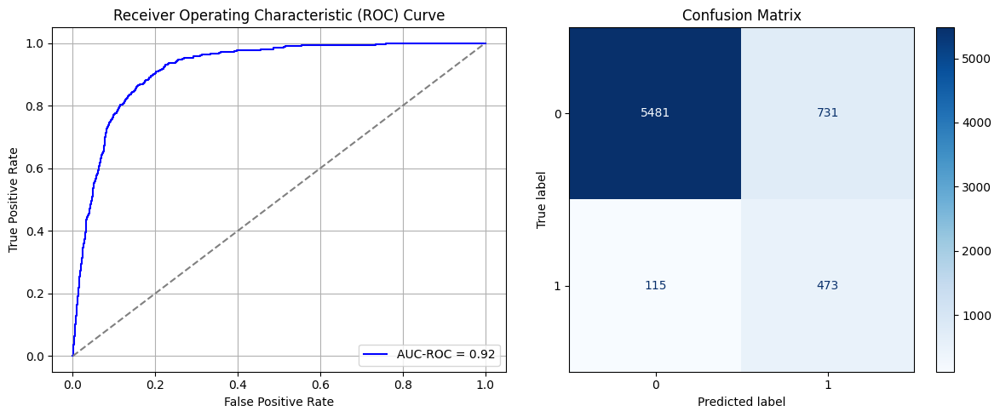

Best threshold based on F1-score: 0.6120967864990234
False Negative Rate: 0.195578231292517
Time elapsed (performance): 1.2244802410000375
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6761 - loss: 0.6525 - val_AUC: 0.7543 - val_loss: 0.5972
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7841 - loss: 0.5665 - val_AUC: 0.8408 - val_loss: 0.5098
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8436 - loss: 0.5023 - val_AUC: 0.8627 - val_loss: 0.4838
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8669 - loss: 0.4697 - val_AUC: 0.8625 - val_loss: 0.4669
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8754 - loss: 0.4472 - val_AUC: 0.8676 - val_loss: 0.4600
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8761 - loss: 0.4483 - val_AUC: 0.8675 - val_loss: 0.4600
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8786 - loss: 0.4427 - val_AUC: 0.8674 - val_loss: 0.4594
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8907 - loss: 0.4187 - val_AUC: 0.8701 - val_loss: 0.4522
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8853 -

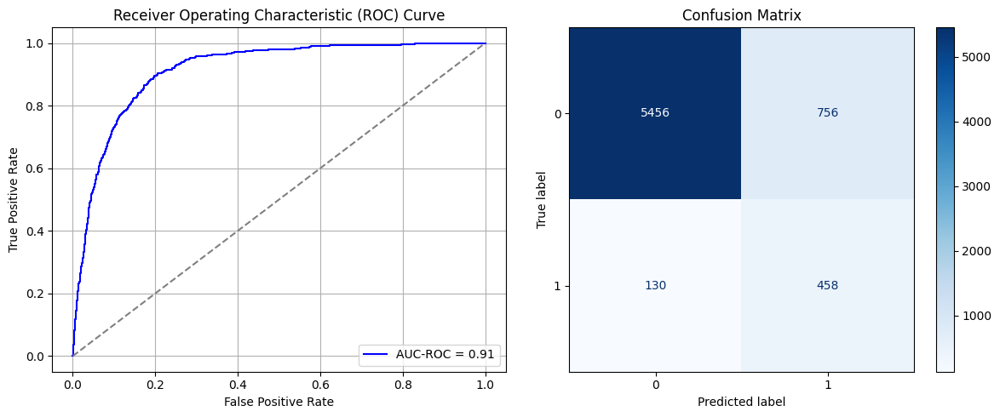

Best threshold based on F1-score: 0.9906743168830872
False Negative Rate: 0.22108843537414966
Time elapsed (performance): 1.0970220150002206
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6443 - loss: 0.6570 - val_AUC: 0.7581 - val_loss: 0.5988
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7945 - loss: 0.5567 - val_AUC: 0.8327 - val_loss: 0.5188
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8537 - loss: 0.4883 - val_AUC: 0.8503 - val_loss: 0.4866
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8779 - loss: 0.4456 - val_AUC: 0.8545 - val_loss: 0.4853
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8781 - loss: 0.4416 - val_AUC: 0.8564 - val_loss: 0.4841
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8801 - loss: 0.4349 - val_AUC: 0.8584 - val_loss: 0.4747
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8769 - loss: 0.4414 - val_AUC: 0.8573 - val_loss: 0.4791
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8903 - loss: 0.4177 - val_AUC: 0.8585 - val_loss: 0.4732
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8835 -

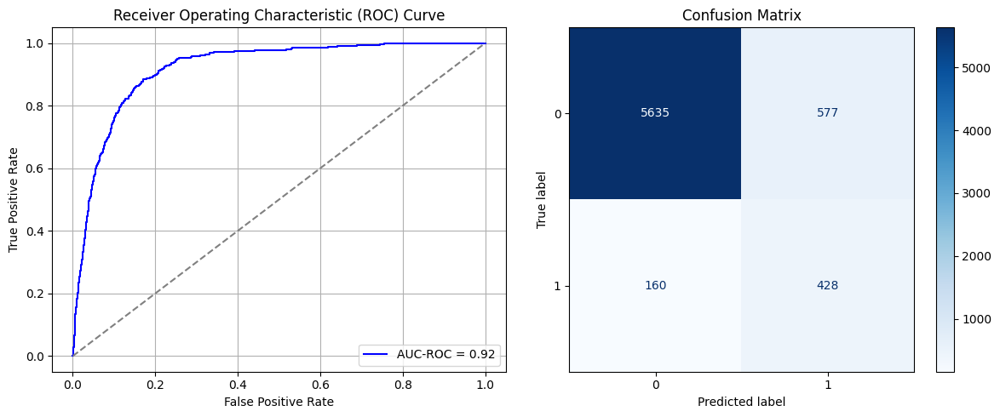

Best threshold based on F1-score: 0.6517535448074341
False Negative Rate: 0.272108843537415
Time elapsed (performance): 1.1406207700001687
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.6747 - loss: 0.6512 - val_AUC: 0.7865 - val_loss: 0.5714
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8006 - loss: 0.5552 - val_AUC: 0.8604 - val_loss: 0.4833
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8685 - loss: 0.4700 - val_AUC: 0.8818 - val_loss: 0.4442
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8756 - loss: 0.4529 - val_AUC: 0.8821 - val_loss: 0.4395
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8816 - loss: 0.4423 - val_AUC: 0.8841 - val_loss: 0.4388
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8792 - loss: 0.4443 - val_AUC: 0.8837 - val_loss: 0.4404
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8877 - loss: 0.4287 - val_AUC: 0.8847 - val_loss: 0.4411
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8893 - loss: 0.4246 - val_AUC: 0.8870 - val_loss: 0.4268
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8914 -

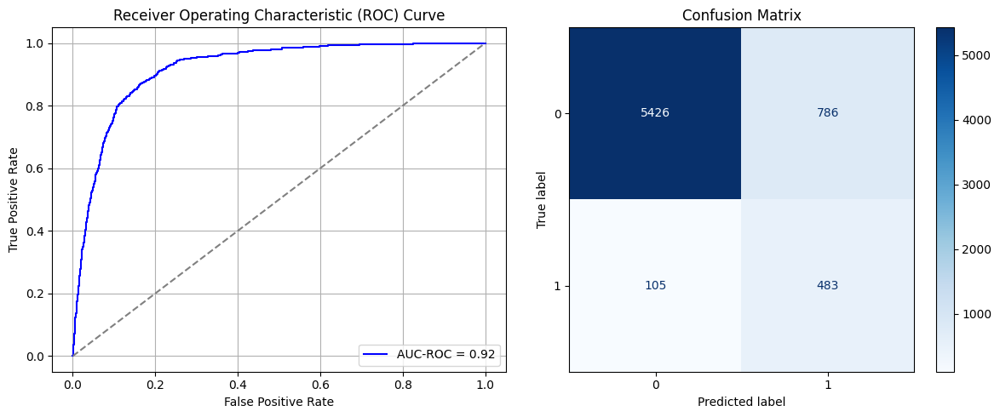

Best threshold based on F1-score: 0.9972822070121765
False Negative Rate: 0.17857142857142858
Time elapsed (performance): 1.0554190200000448
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.5990 - loss: 0.6734 - val_AUC: 0.7498 - val_loss: 0.5945
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7778 - loss: 0.5715 - val_AUC: 0.8402 - val_loss: 0.5029
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8512 - loss: 0.4884 - val_AUC: 0.8670 - val_loss: 0.4672
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8742 - loss: 0.4527 - val_AUC: 0.8721 - val_loss: 0.4528
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8703 - loss: 0.4550 - val_AUC: 0.8737 - val_loss: 0.4609
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8764 - loss: 0.4448 - val_AUC: 0.8745 - val_loss: 0.4432
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8810 - loss: 0.4349 - val_AUC: 0.8745 - val_loss: 0.4564
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8718 - loss: 0.4516 - val_AUC: 0.8760 - val_loss: 0.4397
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8862 -

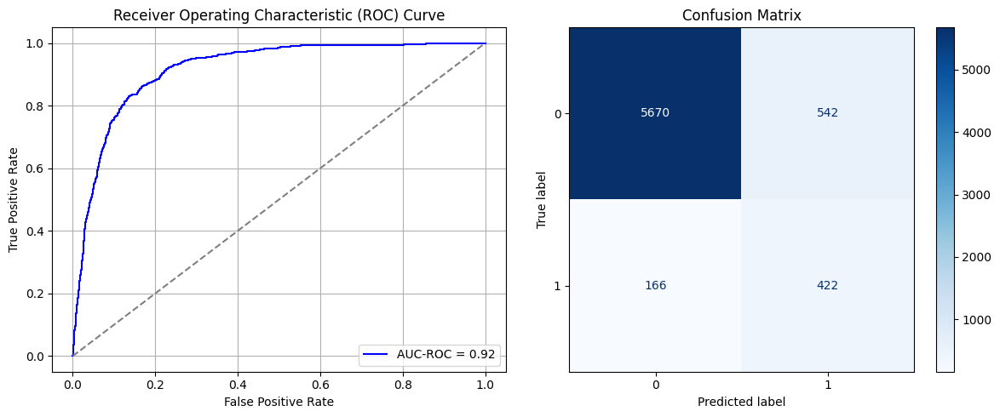

Best threshold based on F1-score: 0.994979977607727
False Negative Rate: 0.282312925170068
Time elapsed (performance): 1.0542576190000545
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6506 - loss: 0.6575 - val_AUC: 0.7659 - val_loss: 0.5886
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7792 - loss: 0.5734 - val_AUC: 0.8537 - val_loss: 0.5040
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8556 - loss: 0.4896 - val_AUC: 0.8848 - val_loss: 0.4447
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8673 - loss: 0.4627 - val_AUC: 0.8876 - val_loss: 0.4306
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8760 - loss: 0.4462 - val_AUC: 0.8911 - val_loss: 0.4252
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8850 - loss: 0.4307 - val_AUC: 0.8930 - val_loss: 0.4370
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8815 - loss: 0.4335 - val_AUC: 0.8927 - val_loss: 0.4212
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8790 - loss: 0.4359 - val_AUC: 0.8935 - val_loss: 0.4125
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8834 -

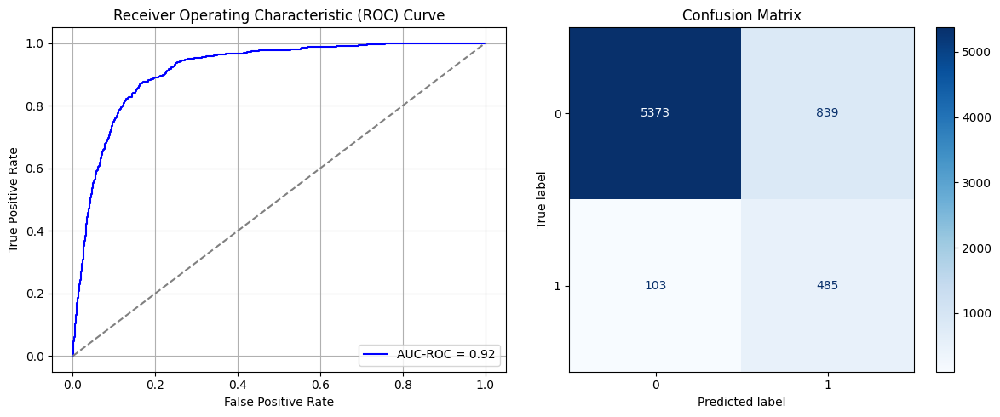

Best threshold based on F1-score: 0.6420295834541321
False Negative Rate: 0.17517006802721088
Time elapsed (performance): 0.8764994909997768
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6767 - loss: 0.6559 - val_AUC: 0.7865 - val_loss: 0.5749
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7846 - loss: 0.5685 - val_AUC: 0.8681 - val_loss: 0.5037
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8462 - loss: 0.5007 - val_AUC: 0.8814 - val_loss: 0.4409
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8592 - loss: 0.4736 - val_AUC: 0.8864 - val_loss: 0.4367
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8712 - loss: 0.4560 - val_AUC: 0.8884 - val_loss: 0.4483
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8770 - loss: 0.4469 - val_AUC: 0.8898 - val_loss: 0.4314
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8773 - loss: 0.4418 - val_AUC: 0.8890 - val_loss: 0.4233
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8815 - loss: 0.4346 - val_AUC: 0.8898 - val_loss: 0.4470
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8862 -

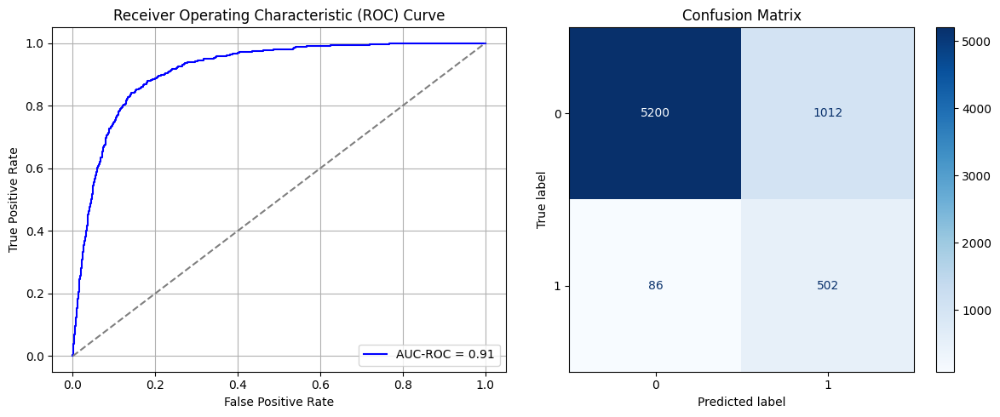

Best threshold based on F1-score: 0.6828229427337646
False Negative Rate: 0.14625850340136054
Time elapsed (performance): 0.8402171779998753
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6850 - loss: 0.6481 - val_AUC: 0.7832 - val_loss: 0.5692
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7923 - loss: 0.5592 - val_AUC: 0.8593 - val_loss: 0.4859
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8615 - loss: 0.4767 - val_AUC: 0.8751 - val_loss: 0.4605
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8795 - loss: 0.4453 - val_AUC: 0.8776 - val_loss: 0.4480
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8764 - loss: 0.4448 - val_AUC: 0.8799 - val_loss: 0.4435
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8817 - loss: 0.4352 - val_AUC: 0.8804 - val_loss: 0.4392
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8899 - loss: 0.4211 - val_AUC: 0.8808 - val_loss: 0.4497
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8838 - loss: 0.4318 - val_AUC: 0.8821 - val_loss: 0.4424
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8842 -

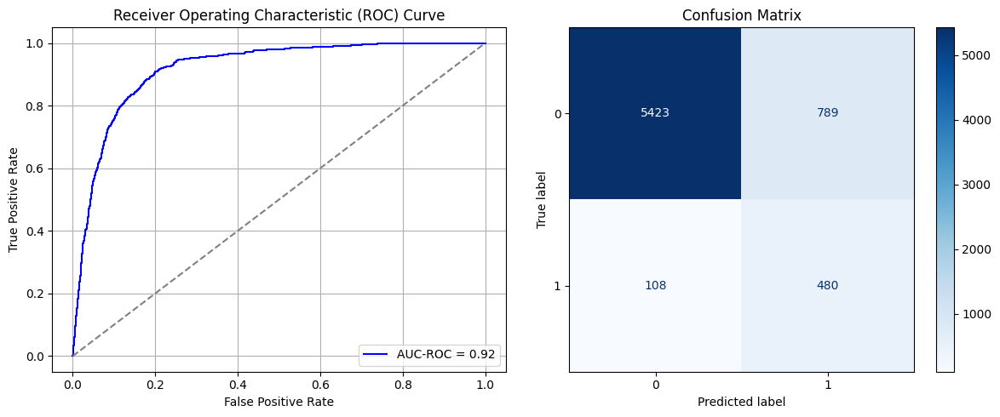

Best threshold based on F1-score: 0.9957213997840881
False Negative Rate: 0.1836734693877551
Time elapsed (performance): 1.0567235960002108
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6778 - loss: 0.6527 - val_AUC: 0.7603 - val_loss: 0.5872
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.7806 - loss: 0.5690 - val_AUC: 0.8490 - val_loss: 0.5038
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8495 - loss: 0.4934 - val_AUC: 0.8736 - val_loss: 0.4554
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8742 - loss: 0.4556 - val_AUC: 0.8771 - val_loss: 0.4429
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8710 - loss: 0.4544 - val_AUC: 0.8783 - val_loss: 0.4387
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8738 - loss: 0.4495 - val_AUC: 0.8816 - val_loss: 0.4358
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8702 - loss: 0.4534 - val_AUC: 0.8816 - val_loss: 0.4336
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8812 - loss: 0.4369 - val_AUC: 0.8833 - val_loss: 0.4288
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8761 -

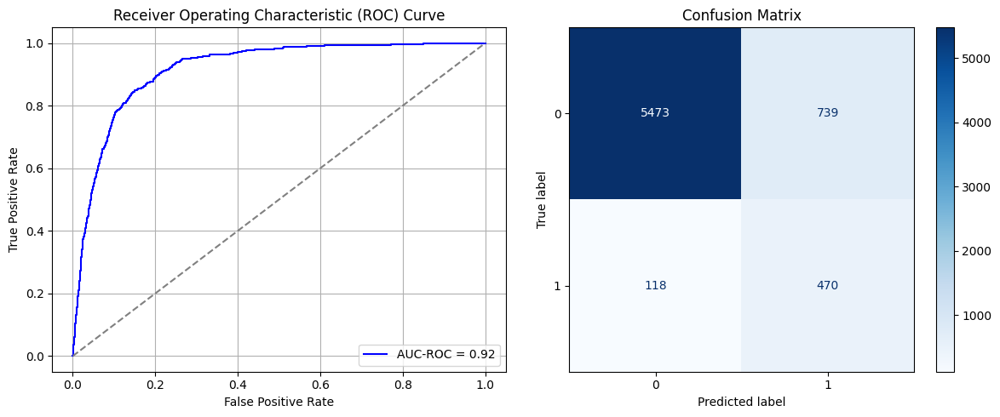

Best threshold based on F1-score: 0.9972113370895386
False Negative Rate: 0.20068027210884354
Time elapsed (performance): 1.172649810999701
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6729 - loss: 0.6505 - val_AUC: 0.7831 - val_loss: 0.5688
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7947 - loss: 0.5565 - val_AUC: 0.8641 - val_loss: 0.5027
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8507 - loss: 0.4934 - val_AUC: 0.8764 - val_loss: 0.4543
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8588 - loss: 0.4736 - val_AUC: 0.8857 - val_loss: 0.4340
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8846 - loss: 0.4325 - val_AUC: 0.8849 - val_loss: 0.4353
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8863 - loss: 0.4279 - val_AUC: 0.8862 - val_loss: 0.4306
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8844 - loss: 0.4308 - val_AUC: 0.8889 - val_loss: 0.4450
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8757 - loss: 0.4440 - val_AUC: 0.8901 - val_loss: 0.4283
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8849 -

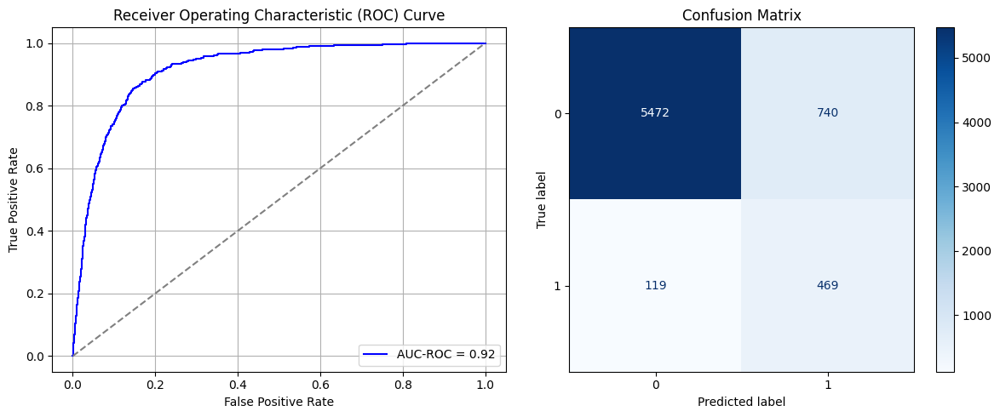

Best threshold based on F1-score: 0.624043881893158
False Negative Rate: 0.20238095238095238
Time elapsed (performance): 1.0748577679996743
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6508 - loss: 0.6620 - val_AUC: 0.7820 - val_loss: 0.5770
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7851 - loss: 0.5655 - val_AUC: 0.8650 - val_loss: 0.4852
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8575 - loss: 0.4810 - val_AUC: 0.8834 - val_loss: 0.4405
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8743 - loss: 0.4490 - val_AUC: 0.8852 - val_loss: 0.4311
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8787 - loss: 0.4411 - val_AUC: 0.8884 - val_loss: 0.4286
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8813 - loss: 0.4366 - val_AUC: 0.8891 - val_loss: 0.4293
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8874 - loss: 0.4247 - val_AUC: 0.8913 - val_loss: 0.4194
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8866 - loss: 0.4232 - val_AUC: 0.8913 - val_loss: 0.4192
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8858 -

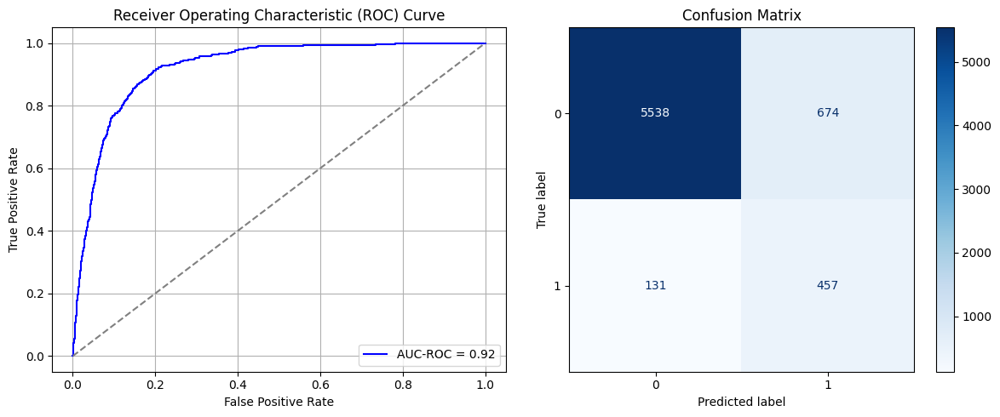

Best threshold based on F1-score: 0.9978864192962646
False Negative Rate: 0.2227891156462585
Time elapsed (performance): 1.091132326999741
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6458 - loss: 0.6649 - val_AUC: 0.7719 - val_loss: 0.5819
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7906 - loss: 0.5578 - val_AUC: 0.8618 - val_loss: 0.4871
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8514 - loss: 0.4884 - val_AUC: 0.8862 - val_loss: 0.4411
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8764 - loss: 0.4479 - val_AUC: 0.8910 - val_loss: 0.4231
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8731 - loss: 0.4490 - val_AUC: 0.8906 - val_loss: 0.4204
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8882 - loss: 0.4223 - val_AUC: 0.8955 - val_loss: 0.4151
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8802 - loss: 0.4362 - val_AUC: 0.8945 - val_loss: 0.4266
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8854 - loss: 0.4272 - val_AUC: 0.8952 - val_loss: 0.4152
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8932 -

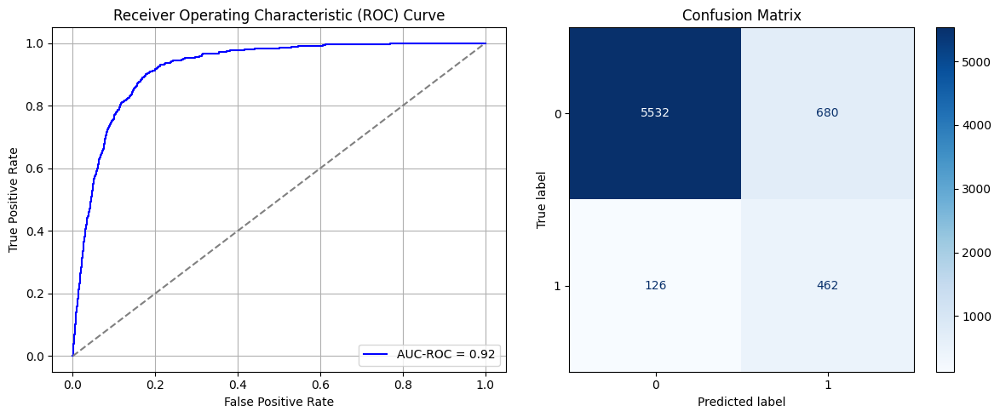

Best threshold based on F1-score: 0.575028121471405
False Negative Rate: 0.21428571428571427
Time elapsed (performance): 0.8323181830000976
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6736 - loss: 0.6545 - val_AUC: 0.7574 - val_loss: 0.5887
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7988 - loss: 0.5538 - val_AUC: 0.8468 - val_loss: 0.4989
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8511 - loss: 0.4891 - val_AUC: 0.8739 - val_loss: 0.4567
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8667 - loss: 0.4624 - val_AUC: 0.8750 - val_loss: 0.4933
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8788 - loss: 0.4436 - val_AUC: 0.8760 - val_loss: 0.4532
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8782 - loss: 0.4427 - val_AUC: 0.8811 - val_loss: 0.4384
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8824 - loss: 0.4331 - val_AUC: 0.8817 - val_loss: 0.4323
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8842 - loss: 0.4295 - val_AUC: 0.8801 - val_loss: 0.4349
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8868 -

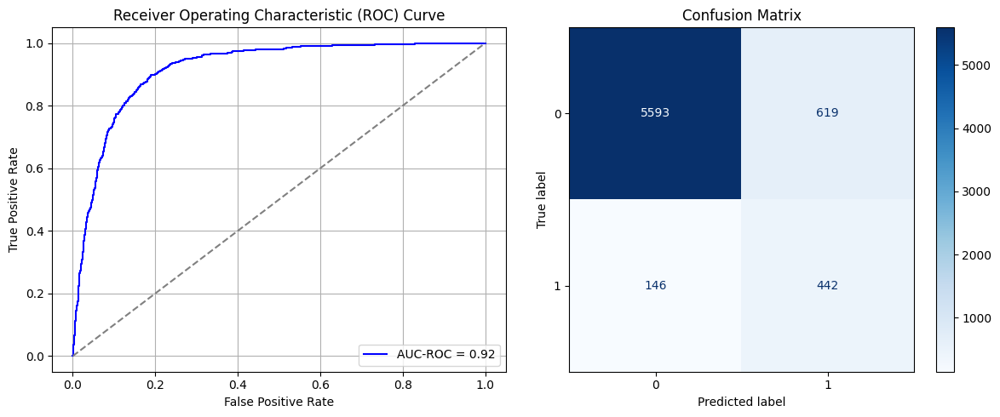

Best threshold based on F1-score: 0.9930956363677979
False Negative Rate: 0.24829931972789115
Time elapsed (performance): 0.8402061289998528
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6433 - loss: 0.6624 - val_AUC: 0.7917 - val_loss: 0.5640
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7789 - loss: 0.5706 - val_AUC: 0.8691 - val_loss: 0.4914
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8554 - loss: 0.4910 - val_AUC: 0.8882 - val_loss: 0.4385
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8636 - loss: 0.4705 - val_AUC: 0.8917 - val_loss: 0.4268
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8682 - loss: 0.4585 - val_AUC: 0.8925 - val_loss: 0.4238
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8777 - loss: 0.4417 - val_AUC: 0.8926 - val_loss: 0.4219
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8830 - loss: 0.4338 - val_AUC: 0.8929 - val_loss: 0.4311
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8861 - loss: 0.4284 - val_AUC: 0.8923 - val_loss: 0.4195
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8854 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9180683864015666
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.37      0.81      0.51       588

    accuracy                           0.87      6800
   macro avg       0.68      0.84      0.72      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.12797810688989053 TPR: 0.8095238095238095 FNR: 0.19047619047619047 TNR: 0.8720218931101095


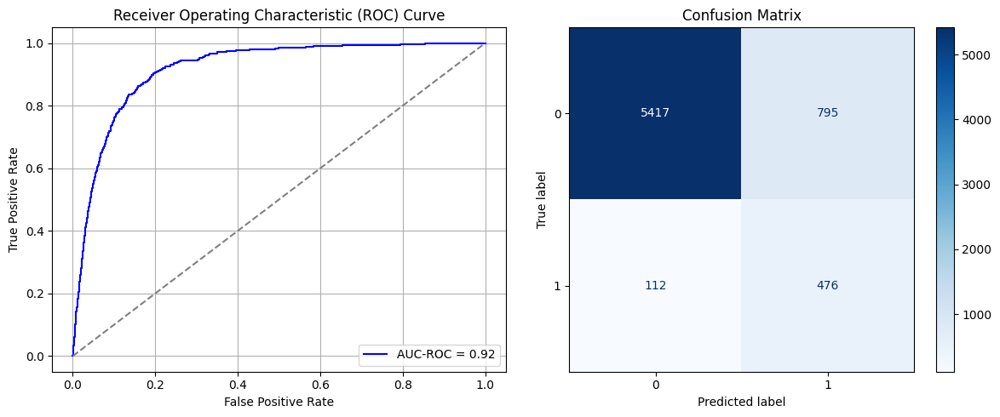

Best threshold based on F1-score: 0.6665540933609009
False Negative Rate: 0.19047619047619047
Time elapsed (performance): 1.0428466449998268
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6849 - loss: 0.6541 - val_AUC: 0.7778 - val_loss: 0.5809
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7917 - loss: 0.5622 - val_AUC: 0.8566 - val_loss: 0.5035
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8634 - loss: 0.4875 - val_AUC: 0.8670 - val_loss: 0.4964
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8701 - loss: 0.4641 - val_AUC: 0.8707 - val_loss: 0.4735
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8785 - loss: 0.4456 - val_AUC: 0.8719 - val_loss: 0.4647
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8840 - loss: 0.4356 - val_AUC: 0.8721 - val_loss: 0.4586
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8811 - loss: 0.4413 - val_AUC: 0.8735 - val_loss: 0.4588
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8804 - loss: 0.4382 - val_AUC: 0.8736 - val_loss: 0.4515
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8815 -

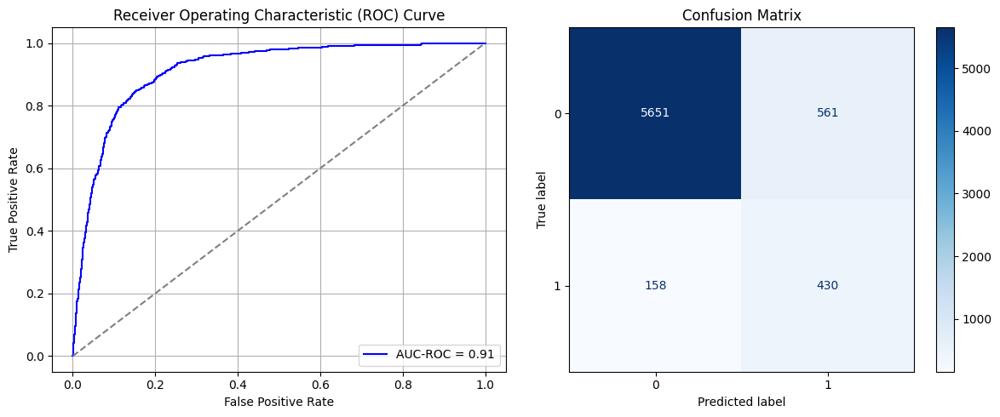

Best threshold based on F1-score: 0.9982932209968567
False Negative Rate: 0.2687074829931973
Time elapsed (performance): 1.0404003910002757
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6616 - loss: 0.6574 - val_AUC: 0.7851 - val_loss: 0.5721
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7847 - loss: 0.5669 - val_AUC: 0.8490 - val_loss: 0.5008
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8468 - loss: 0.4972 - val_AUC: 0.8759 - val_loss: 0.4662
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8764 - loss: 0.4518 - val_AUC: 0.8785 - val_loss: 0.4480
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8791 - loss: 0.4435 - val_AUC: 0.8806 - val_loss: 0.4471
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8826 - loss: 0.4360 - val_AUC: 0.8802 - val_loss: 0.4433
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8942 - loss: 0.4163 - val_AUC: 0.8842 - val_loss: 0.4343
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8921 - loss: 0.4206 - val_AUC: 0.8815 - val_loss: 0.4345
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8958 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9213725573938526
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.37      0.83      0.52       588

    accuracy                           0.87      6800
   macro avg       0.68      0.85      0.72      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.1313586606567933 TPR: 0.8316326530612245 FNR: 0.1683673469387755 TNR: 0.8686413393432066


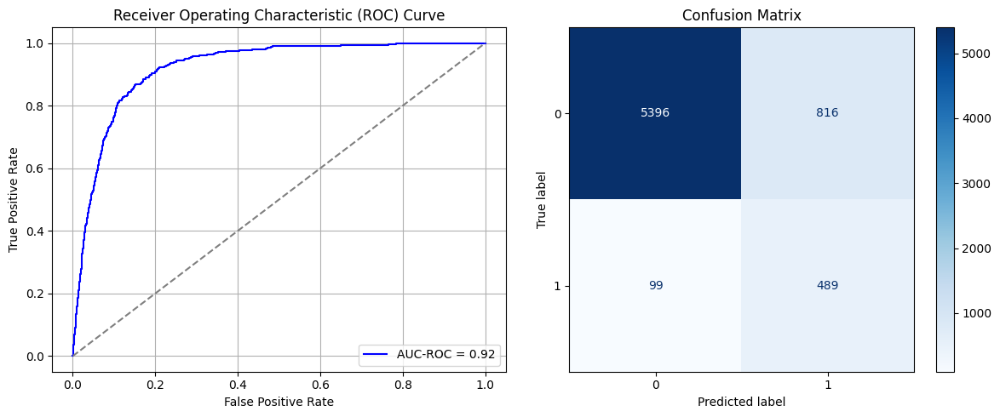

Best threshold based on F1-score: 0.9978483319282532
False Negative Rate: 0.1683673469387755
Time elapsed (performance): 1.290222490999895
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6387 - loss: 0.6643 - val_AUC: 0.7497 - val_loss: 0.5984
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7584 - loss: 0.5884 - val_AUC: 0.8516 - val_loss: 0.5144
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8359 - loss: 0.5145 - val_AUC: 0.8714 - val_loss: 0.4620
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8575 - loss: 0.4763 - val_AUC: 0.8762 - val_loss: 0.4493
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8706 - loss: 0.4563 - val_AUC: 0.8807 - val_loss: 0.4441
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8715 - loss: 0.4509 - val_AUC: 0.8838 - val_loss: 0.4345
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8788 - loss: 0.4404 - val_AUC: 0.8849 - val_loss: 0.4337
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8718 - loss: 0.4493 - val_AUC: 0.8844 - val_loss: 0.4323
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8846 -

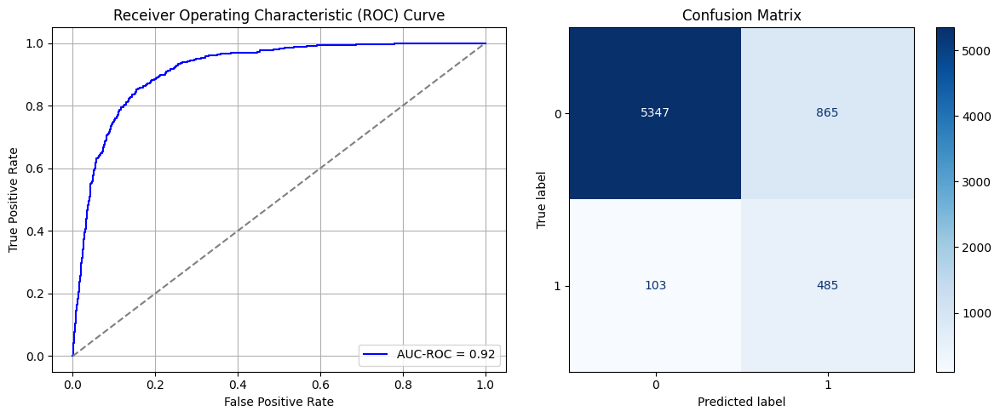

Best threshold based on F1-score: 0.997529149055481
False Negative Rate: 0.17517006802721088
Time elapsed (performance): 0.8780284900003608
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6541 - loss: 0.6621 - val_AUC: 0.7748 - val_loss: 0.5799
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7897 - loss: 0.5625 - val_AUC: 0.8597 - val_loss: 0.5002
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8510 - loss: 0.4961 - val_AUC: 0.8755 - val_loss: 0.4708
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8738 - loss: 0.4571 - val_AUC: 0.8849 - val_loss: 0.4412
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8755 - loss: 0.4489 - val_AUC: 0.8860 - val_loss: 0.4359
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8793 - loss: 0.4413 - val_AUC: 0.8868 - val_loss: 0.4340
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8876 - loss: 0.4278 - val_AUC: 0.8877 - val_loss: 0.4329
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8822 - loss: 0.4337 - val_AUC: 0.8882 - val_loss: 0.4272
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8876 -

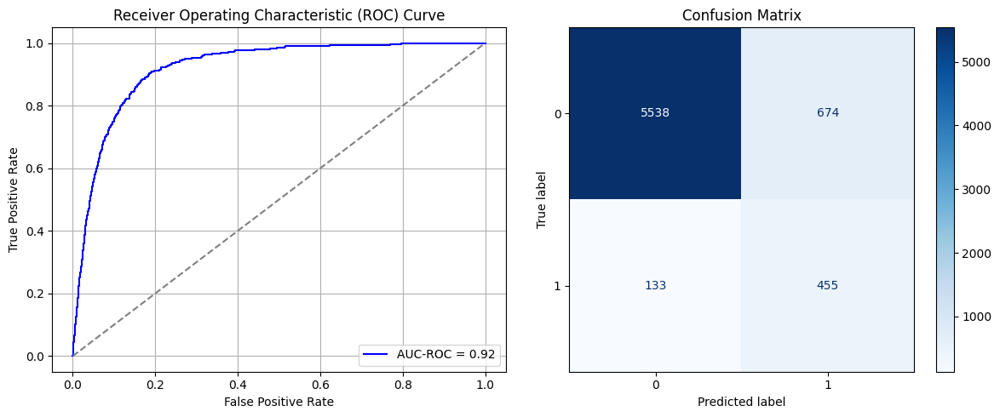

Best threshold based on F1-score: 0.996957540512085
False Negative Rate: 0.2261904761904762
Time elapsed (performance): 0.8273808489998373
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6738 - loss: 0.6515 - val_AUC: 0.7585 - val_loss: 0.5971
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7857 - loss: 0.5634 - val_AUC: 0.8463 - val_loss: 0.5162
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8502 - loss: 0.4955 - val_AUC: 0.8664 - val_loss: 0.4830
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8818 - loss: 0.4447 - val_AUC: 0.8709 - val_loss: 0.4674
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8795 - loss: 0.4445 - val_AUC: 0.8734 - val_loss: 0.4602
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8807 - loss: 0.4424 - val_AUC: 0.8721 - val_loss: 0.4635
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8797 - loss: 0.4415 - val_AUC: 0.8754 - val_loss: 0.4554
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8865 - loss: 0.4293 - val_AUC: 0.8771 - val_loss: 0.4585
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8826 -

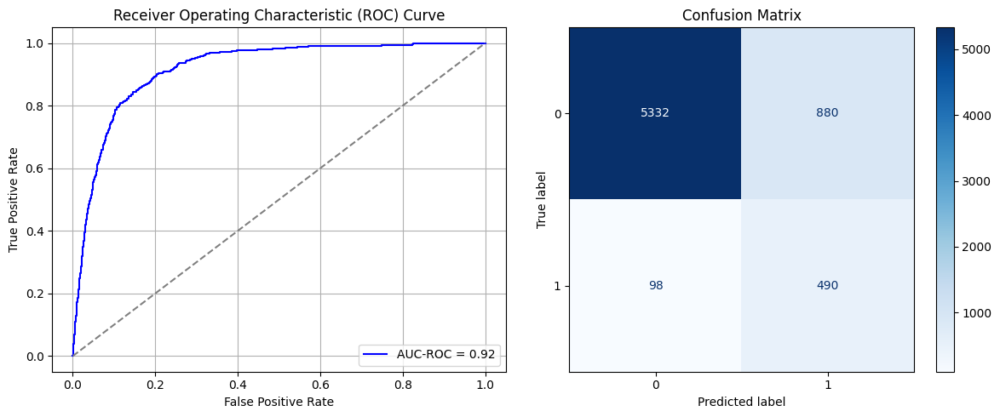

Best threshold based on F1-score: 0.6624642610549927
False Negative Rate: 0.16666666666666666
Time elapsed (performance): 1.0718268149998949
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6360 - loss: 0.6633 - val_AUC: 0.7652 - val_loss: 0.5856
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7843 - loss: 0.5667 - val_AUC: 0.8578 - val_loss: 0.5084
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8569 - loss: 0.4884 - val_AUC: 0.8877 - val_loss: 0.4454
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8726 - loss: 0.4555 - val_AUC: 0.8888 - val_loss: 0.4410
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8795 - loss: 0.4429 - val_AUC: 0.8929 - val_loss: 0.4283
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8735 - loss: 0.4503 - val_AUC: 0.8930 - val_loss: 0.4205
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8824 - loss: 0.4360 - val_AUC: 0.8944 - val_loss: 0.4198
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8828 - loss: 0.4355 - val_AUC: 0.8935 - val_loss: 0.4186
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8854 -

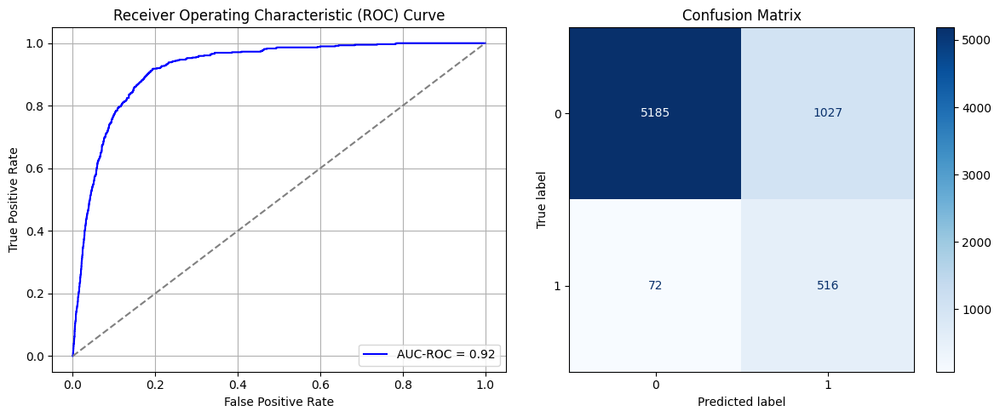

Best threshold based on F1-score: 0.9993487596511841
False Negative Rate: 0.12244897959183673
Time elapsed (performance): 1.062287478000144
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6791 - loss: 0.6505 - val_AUC: 0.7685 - val_loss: 0.5804
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7932 - loss: 0.5605 - val_AUC: 0.8494 - val_loss: 0.4964
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8573 - loss: 0.4831 - val_AUC: 0.8787 - val_loss: 0.4622
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8685 - loss: 0.4626 - val_AUC: 0.8791 - val_loss: 0.4505
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8738 - loss: 0.4545 - val_AUC: 0.8829 - val_loss: 0.4428
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8792 - loss: 0.4415 - val_AUC: 0.8837 - val_loss: 0.4408
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8795 - loss: 0.4451 - val_AUC: 0.8838 - val_loss: 0.4400
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8794 - loss: 0.4392 - val_AUC: 0.8874 - val_loss: 0.4347
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8839 -

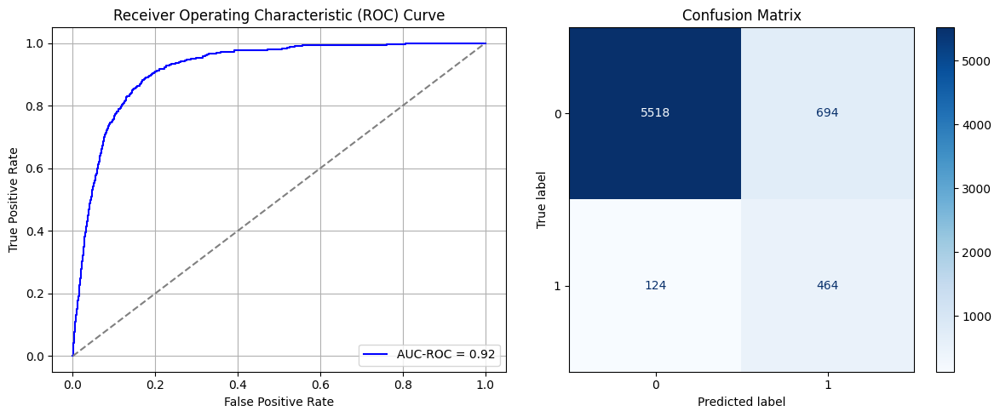

Best threshold based on F1-score: 0.6074552536010742
False Negative Rate: 0.2108843537414966
Time elapsed (performance): 0.8875696360000802
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6531 - loss: 0.6565 - val_AUC: 0.7709 - val_loss: 0.5815
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7744 - loss: 0.5742 - val_AUC: 0.8694 - val_loss: 0.4872
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8454 - loss: 0.5006 - val_AUC: 0.8911 - val_loss: 0.4433
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8756 - loss: 0.4542 - val_AUC: 0.8973 - val_loss: 0.4255
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8797 - loss: 0.4432 - val_AUC: 0.8968 - val_loss: 0.4222
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8775 - loss: 0.4426 - val_AUC: 0.9021 - val_loss: 0.4116
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8815 - loss: 0.4364 - val_AUC: 0.9033 - val_loss: 0.4086
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8777 - loss: 0.4437 - val_AUC: 0.9040 - val_loss: 0.4079
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8920 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9203387890893641
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.86      0.92      6212
           1       0.37      0.83      0.51       588

    accuracy                           0.86      6800
   macro avg       0.67      0.85      0.71      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.13602704443013522 TPR: 0.8333333333333334 FNR: 0.16666666666666666 TNR: 0.8639729555698648


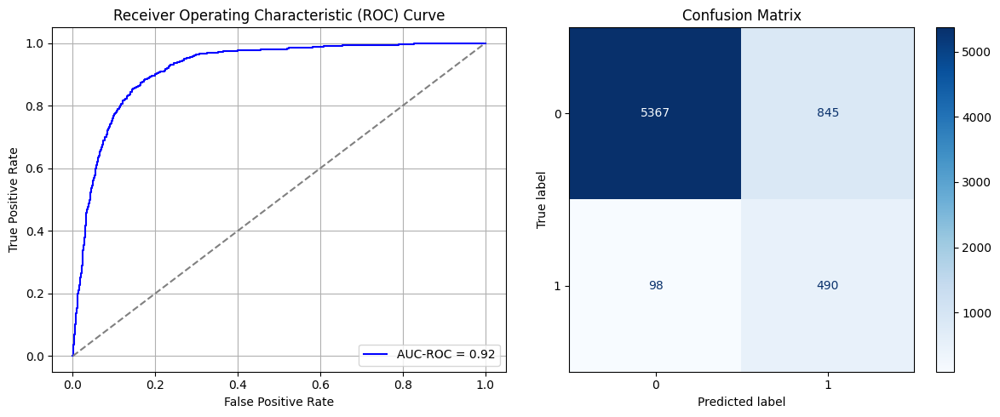

Best threshold based on F1-score: 0.9991300106048584
False Negative Rate: 0.16666666666666666
Time elapsed (performance): 1.0630161829999452
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6703 - loss: 0.6550 - val_AUC: 0.7692 - val_loss: 0.5866
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7950 - loss: 0.5549 - val_AUC: 0.8578 - val_loss: 0.4928
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8602 - loss: 0.4772 - val_AUC: 0.8765 - val_loss: 0.4510
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8791 - loss: 0.4461 - val_AUC: 0.8789 - val_loss: 0.4435
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8842 - loss: 0.4324 - val_AUC: 0.8851 - val_loss: 0.4601
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8915 - loss: 0.4194 - val_AUC: 0.8817 - val_loss: 0.4348
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8906 - loss: 0.4227 - val_AUC: 0.8831 - val_loss: 0.4280
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8846 - loss: 0.4282 - val_AUC: 0.8846 - val_loss: 0.4327
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8912 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9167334673727832
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.81      0.89      6212
           1       0.30      0.89      0.45       588

    accuracy                           0.81      6800
   macro avg       0.64      0.85      0.67      6800
weighted avg       0.93      0.81      0.85      6800

FPR 0.19414037347070187 TPR: 0.8860544217687075 FNR: 0.11394557823129252 TNR: 0.8058596265292981


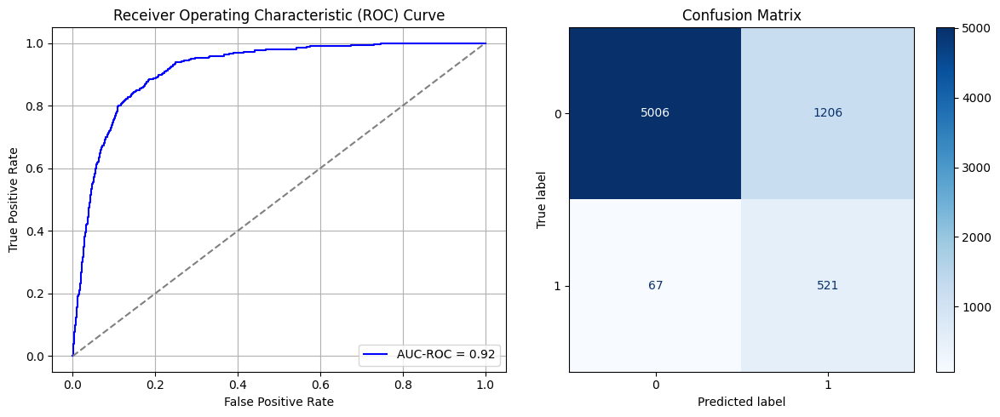

Best threshold based on F1-score: 0.9975942969322205
False Negative Rate: 0.11394557823129252
Time elapsed (performance): 0.917584720999912
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6619 - loss: 0.6547 - val_AUC: 0.7650 - val_loss: 0.5880
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7883 - loss: 0.5630 - val_AUC: 0.8517 - val_loss: 0.5048
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8539 - loss: 0.4903 - val_AUC: 0.8738 - val_loss: 0.4667
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8804 - loss: 0.4441 - val_AUC: 0.8775 - val_loss: 0.4465
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8837 - loss: 0.4328 - val_AUC: 0.8799 - val_loss: 0.4478
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8884 - loss: 0.4238 - val_AUC: 0.8822 - val_loss: 0.4353
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8928 - loss: 0.4153 - val_AUC: 0.8819 - val_loss: 0.4337
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8963 - loss: 0.4076 - val_AUC: 0.8832 - val_loss: 0.4302
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8958 -

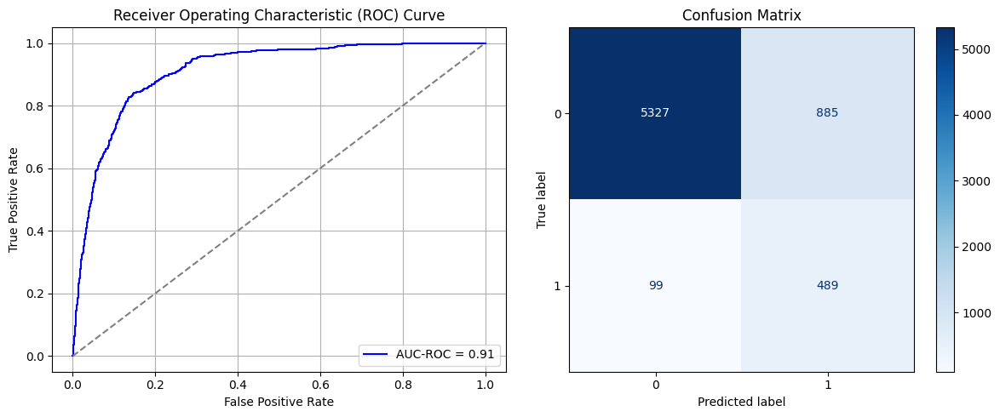

Best threshold based on F1-score: 0.7499988079071045
False Negative Rate: 0.1683673469387755
Time elapsed (performance): 0.8966147289997934
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6438 - loss: 0.6581 - val_AUC: 0.7676 - val_loss: 0.5866
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8000 - loss: 0.5556 - val_AUC: 0.8444 - val_loss: 0.5152
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8369 - loss: 0.5078 - val_AUC: 0.8636 - val_loss: 0.4781
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8700 - loss: 0.4604 - val_AUC: 0.8728 - val_loss: 0.4531
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8745 - loss: 0.4530 - val_AUC: 0.8741 - val_loss: 0.4478
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8793 - loss: 0.4429 - val_AUC: 0.8751 - val_loss: 0.4466
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8741 - loss: 0.4469 - val_AUC: 0.8756 - val_loss: 0.4416
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8695 - loss: 0.4564 - val_AUC: 0.8773 - val_loss: 0.4383
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8771 -

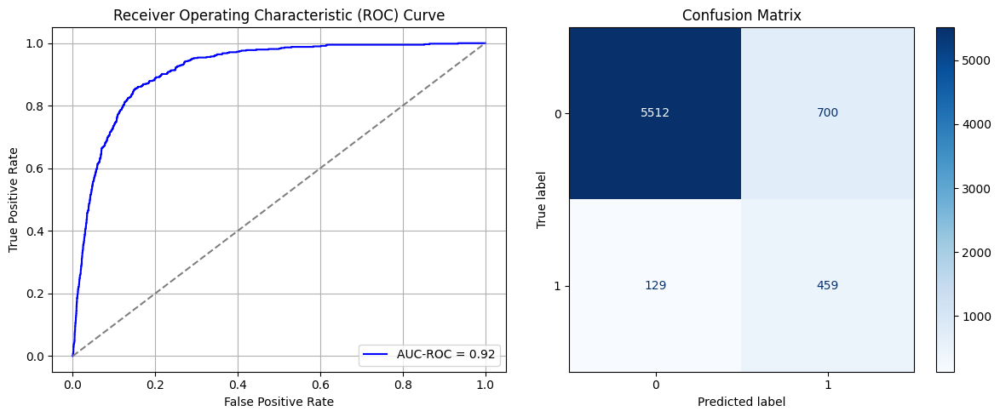

Best threshold based on F1-score: 0.997582733631134
False Negative Rate: 0.2193877551020408
Time elapsed (performance): 0.9952420480003639
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6671 - loss: 0.6522 - val_AUC: 0.7947 - val_loss: 0.5660
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8103 - loss: 0.5457 - val_AUC: 0.8664 - val_loss: 0.4852
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8650 - loss: 0.4735 - val_AUC: 0.8731 - val_loss: 0.4665
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8798 - loss: 0.4437 - val_AUC: 0.8742 - val_loss: 0.4567
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8797 - loss: 0.4440 - val_AUC: 0.8724 - val_loss: 0.4596
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8870 - loss: 0.4299 - val_AUC: 0.8754 - val_loss: 0.4468
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8864 - loss: 0.4283 - val_AUC: 0.8764 - val_loss: 0.4487
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8902 - loss: 0.4227 - val_AUC: 0.8770 - val_loss: 0.4439
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8941 -

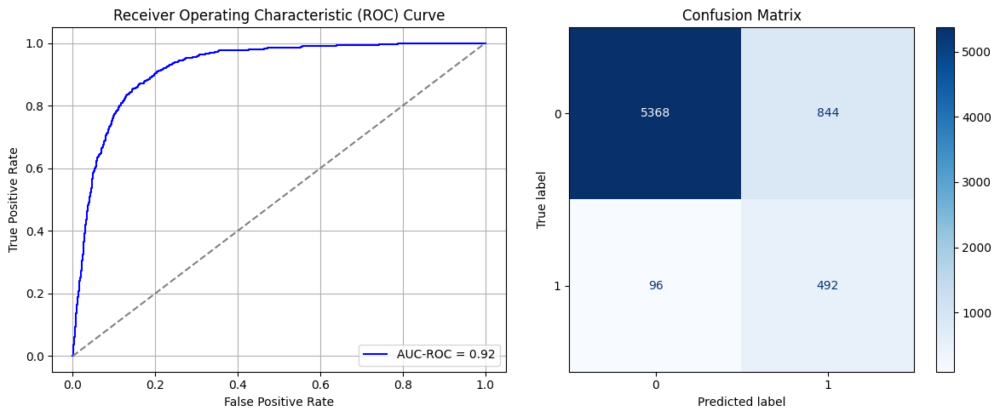

Best threshold based on F1-score: 0.9982188940048218
False Negative Rate: 0.16326530612244897
Time elapsed (performance): 1.7451832589999867
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.6894 - loss: 0.6448 - val_AUC: 0.7968 - val_loss: 0.5642
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7909 - loss: 0.5638 - val_AUC: 0.8589 - val_loss: 0.4894
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8485 - loss: 0.4972 - val_AUC: 0.8728 - val_loss: 0.4715
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8707 - loss: 0.4628 - val_AUC: 0.8777 - val_loss: 0.4639
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8751 - loss: 0.4525 - val_AUC: 0.8802 - val_loss: 0.4462
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8780 - loss: 0.4448 - val_AUC: 0.8773 - val_loss: 0.4476
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8770 - loss: 0.4461 - val_AUC: 0.8777 - val_loss: 0.4432
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8821 - loss: 0.4360 - val_AUC: 0.8804 - val_loss: 0.4505
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8767 -

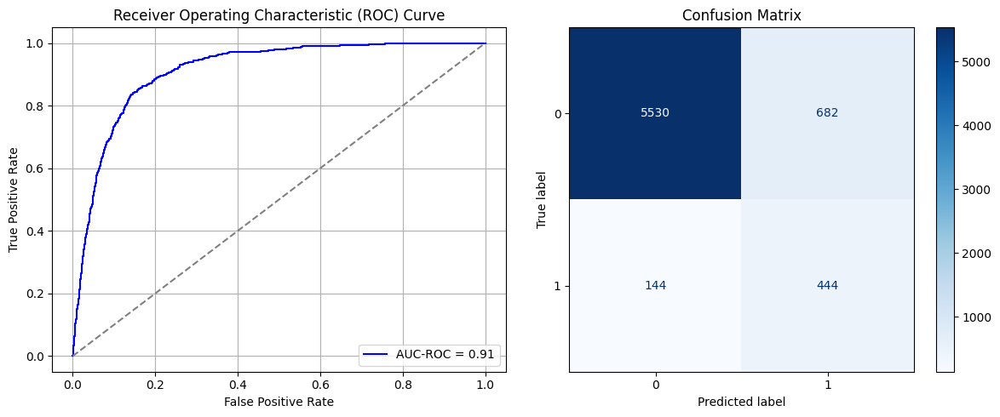

Best threshold based on F1-score: 0.596075713634491
False Negative Rate: 0.24489795918367346
Time elapsed (performance): 1.0803021179999632
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6450 - loss: 0.6599 - val_AUC: 0.7722 - val_loss: 0.5918
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7812 - loss: 0.5690 - val_AUC: 0.8553 - val_loss: 0.4999
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8617 - loss: 0.4853 - val_AUC: 0.8818 - val_loss: 0.4534
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8705 - loss: 0.4624 - val_AUC: 0.8871 - val_loss: 0.4384
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8857 - loss: 0.4326 - val_AUC: 0.8879 - val_loss: 0.4454
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8825 - loss: 0.4425 - val_AUC: 0.8893 - val_loss: 0.4223
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8837 - loss: 0.4338 - val_AUC: 0.8901 - val_loss: 0.4222
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8849 - loss: 0.4301 - val_AUC: 0.8908 - val_loss: 0.4171
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8862 -

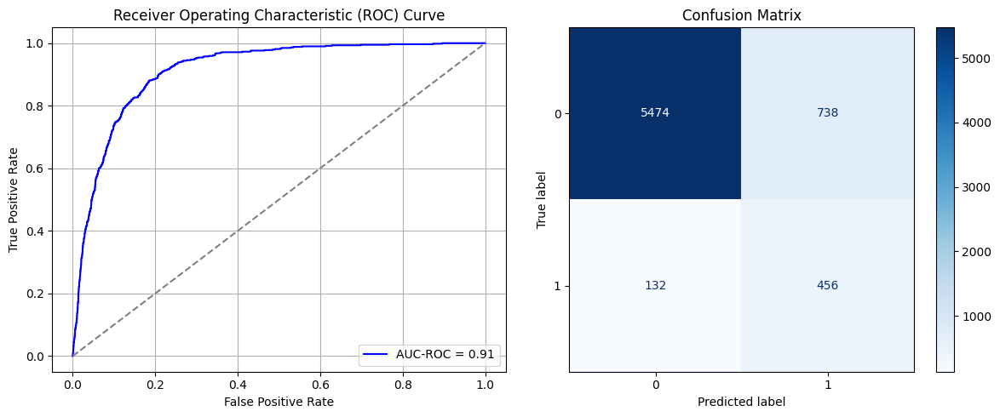

Best threshold based on F1-score: 0.9941244721412659
False Negative Rate: 0.22448979591836735
Time elapsed (performance): 0.9087065970002186
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6456 - loss: 0.6572 - val_AUC: 0.7606 - val_loss: 0.5865
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7796 - loss: 0.5698 - val_AUC: 0.8449 - val_loss: 0.5061
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8515 - loss: 0.4936 - val_AUC: 0.8713 - val_loss: 0.4643
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8785 - loss: 0.4474 - val_AUC: 0.8723 - val_loss: 0.4584
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8837 - loss: 0.4349 - val_AUC: 0.8699 - val_loss: 0.4679
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8777 - loss: 0.4431 - val_AUC: 0.8720 - val_loss: 0.4569
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8878 - loss: 0.4253 - val_AUC: 0.8739 - val_loss: 0.4510
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8819 - loss: 0.4349 - val_AUC: 0.8753 - val_loss: 0.4503
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8869 -

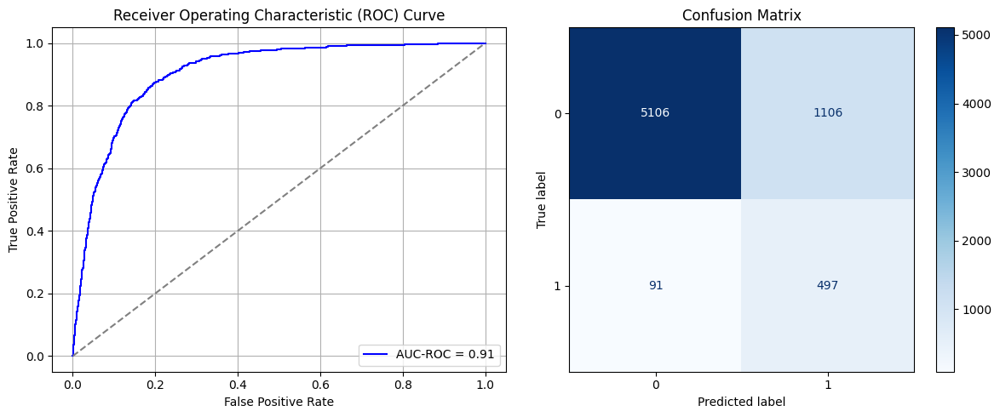

Best threshold based on F1-score: 0.9966222643852234
False Negative Rate: 0.15476190476190477
Time elapsed (performance): 0.8927111689999947
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6495 - loss: 0.6602 - val_AUC: 0.7580 - val_loss: 0.5867
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7912 - loss: 0.5588 - val_AUC: 0.8549 - val_loss: 0.5011
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8549 - loss: 0.4922 - val_AUC: 0.8770 - val_loss: 0.4558
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8673 - loss: 0.4646 - val_AUC: 0.8814 - val_loss: 0.4377
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8753 - loss: 0.4456 - val_AUC: 0.8862 - val_loss: 0.4321
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8778 - loss: 0.4401 - val_AUC: 0.8873 - val_loss: 0.4288
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8867 - loss: 0.4278 - val_AUC: 0.8876 - val_loss: 0.4259
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8834 - loss: 0.4297 - val_AUC: 0.8854 - val_loss: 0.4294
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8839 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9143702555072254
Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.90      0.93      6212
           1       0.41      0.76      0.53       588

    accuracy                           0.88      6800
   macro avg       0.69      0.83      0.73      6800
weighted avg       0.93      0.88      0.90      6800

FPR 0.10431423052157116 TPR: 0.7551020408163265 FNR: 0.24489795918367346 TNR: 0.8956857694784288


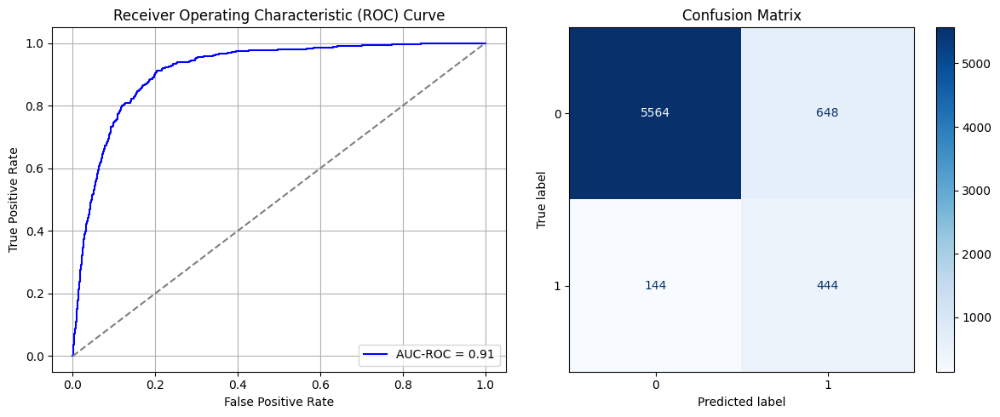

Best threshold based on F1-score: 0.9928047060966492
False Negative Rate: 0.24489795918367346
Time elapsed (performance): 1.0022851879998598
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - AUC: 0.6784 - loss: 0.6475 - val_AUC: 0.7794 - val_loss: 0.5683
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.7867 - loss: 0.5611 - val_AUC: 0.8562 - val_loss: 0.4977
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8510 - loss: 0.4926 - val_AUC: 0.8725 - val_loss: 0.4641
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8627 - loss: 0.4656 - val_AUC: 0.8754 - val_loss: 0.4499
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8745 - loss: 0.4458 - val_AUC: 0.8751 - val_loss: 0.4483
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8722 - loss: 0.4500 - val_AUC: 0.8744 - val_loss: 0.4471
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8672 - loss: 0.4567 - val_AUC: 0.8781 - val_loss: 0.4603
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8766 - loss: 0.4424 - val_AUC: 0.8779 - val_loss: 0.4408
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8827 -

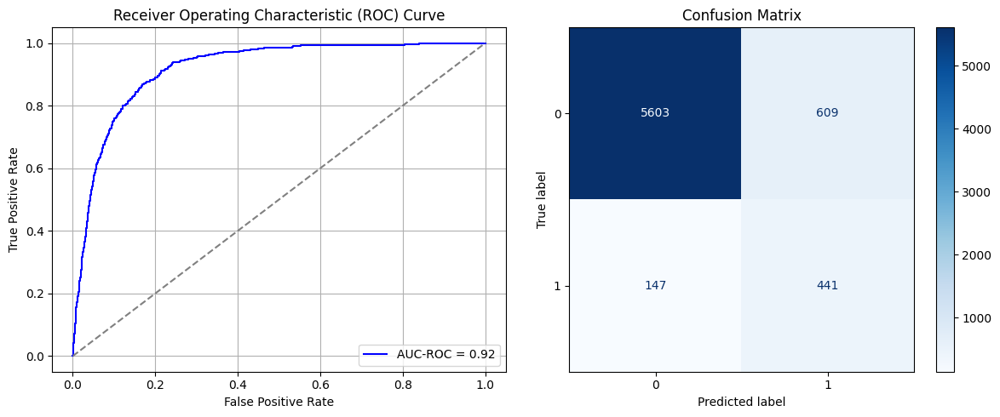

Best threshold based on F1-score: 0.6366197466850281
False Negative Rate: 0.25
Time elapsed (performance): 1.0208066539998981
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6942 - loss: 0.6444 - val_AUC: 0.7946 - val_loss: 0.5618
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7971 - loss: 0.5574 - val_AUC: 0.8698 - val_loss: 0.4801
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8548 - loss: 0.4888 - val_AUC: 0.8894 - val_loss: 0.4332
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8726 - loss: 0.4544 - val_AUC: 0.8949 - val_loss: 0.4201
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8806 - loss: 0.4371 - val_AUC: 0.8983 - val_loss: 0.4111
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8866 - loss: 0.4283 - val_AUC: 0.8995 - val_loss: 0.4084
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8864 - loss: 0.4274 - val_AUC: 0.9010 - val_loss: 0.4014
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8819 - loss: 0.4319 - val_AUC: 0.9029 - val_loss: 0.4060
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8874 -

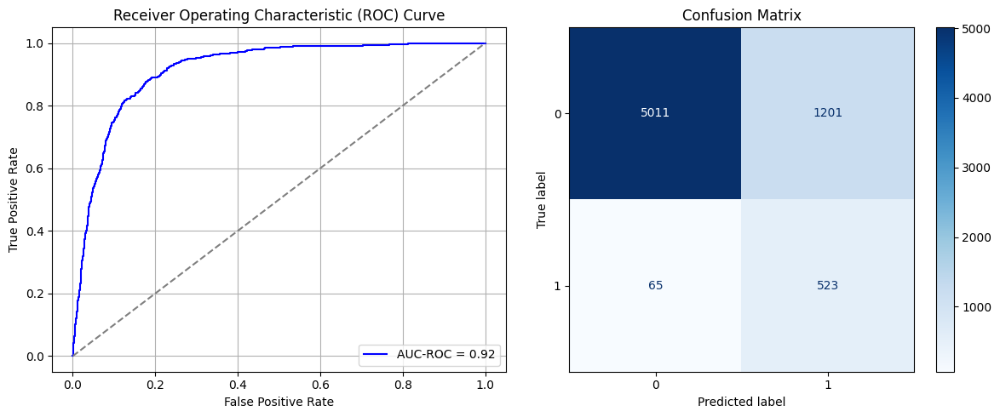

Best threshold based on F1-score: 0.9978852272033691
False Negative Rate: 0.11054421768707483
Time elapsed (performance): 1.090723141000126
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6619 - loss: 0.6562 - val_AUC: 0.7833 - val_loss: 0.5651
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7939 - loss: 0.5550 - val_AUC: 0.8624 - val_loss: 0.4920
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8490 - loss: 0.4970 - val_AUC: 0.8815 - val_loss: 0.4495
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8656 - loss: 0.4660 - val_AUC: 0.8858 - val_loss: 0.4339
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8778 - loss: 0.4459 - val_AUC: 0.8879 - val_loss: 0.4289
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8844 - loss: 0.4333 - val_AUC: 0.8874 - val_loss: 0.4410
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8770 - loss: 0.4423 - val_AUC: 0.8894 - val_loss: 0.4379
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8849 - loss: 0.4308 - val_AUC: 0.8898 - val_loss: 0.4341
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8882 -

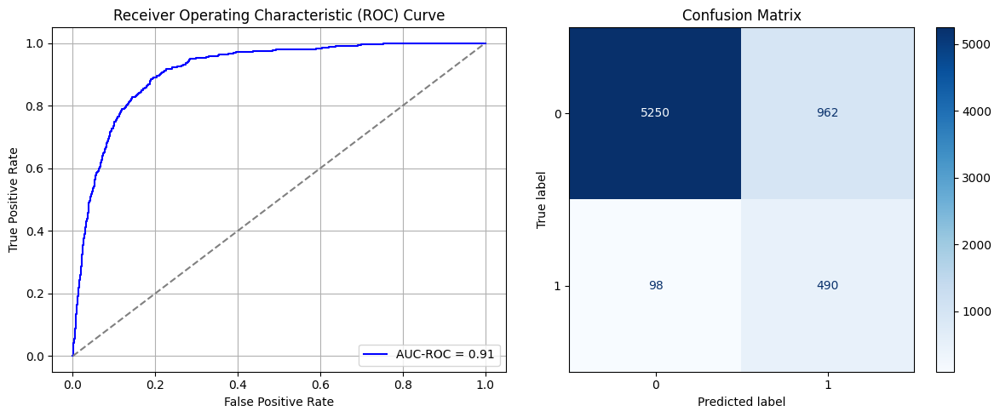

Best threshold based on F1-score: 0.9948567748069763
False Negative Rate: 0.16666666666666666
Time elapsed (performance): 0.9807465049998427
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6623 - loss: 0.6574 - val_AUC: 0.7626 - val_loss: 0.5882
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7822 - loss: 0.5700 - val_AUC: 0.8458 - val_loss: 0.5015
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8541 - loss: 0.4904 - val_AUC: 0.8688 - val_loss: 0.4764
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8624 - loss: 0.4707 - val_AUC: 0.8729 - val_loss: 0.4518
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8764 - loss: 0.4462 - val_AUC: 0.8741 - val_loss: 0.4524
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8856 - loss: 0.4302 - val_AUC: 0.8742 - val_loss: 0.4481
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8836 - loss: 0.4313 - val_AUC: 0.8729 - val_loss: 0.4493
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8797 - loss: 0.4391 - val_AUC: 0.8739 - val_loss: 0.4542
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8820 -

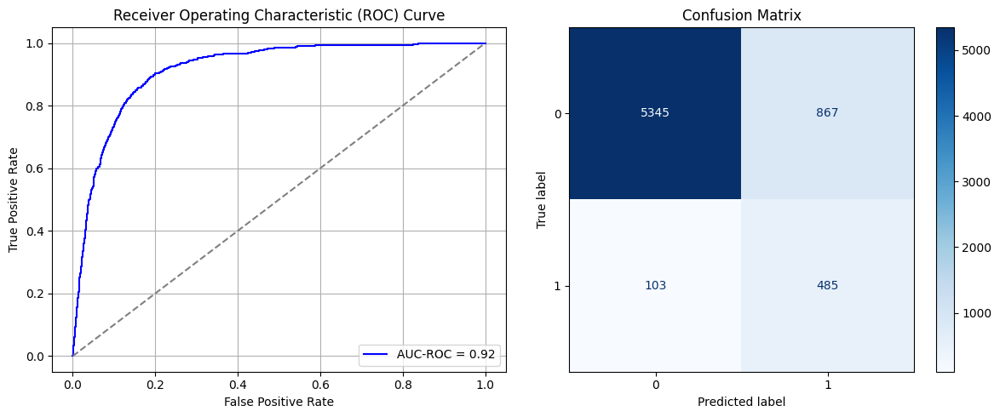

Best threshold based on F1-score: 0.6756920218467712
False Negative Rate: 0.17517006802721088
Time elapsed (performance): 1.0725139880000825
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6448 - loss: 0.6595 - val_AUC: 0.7900 - val_loss: 0.5782
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7858 - loss: 0.5675 - val_AUC: 0.8683 - val_loss: 0.4893
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8507 - loss: 0.4905 - val_AUC: 0.8785 - val_loss: 0.4480
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8729 - loss: 0.4520 - val_AUC: 0.8818 - val_loss: 0.4412
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8815 - loss: 0.4351 - val_AUC: 0.8821 - val_loss: 0.4376
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8770 - loss: 0.4420 - val_AUC: 0.8834 - val_loss: 0.4354
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8774 - loss: 0.4399 - val_AUC: 0.8816 - val_loss: 0.4412
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8841 - loss: 0.4305 - val_AUC: 0.8845 - val_loss: 0.4303
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8865 -

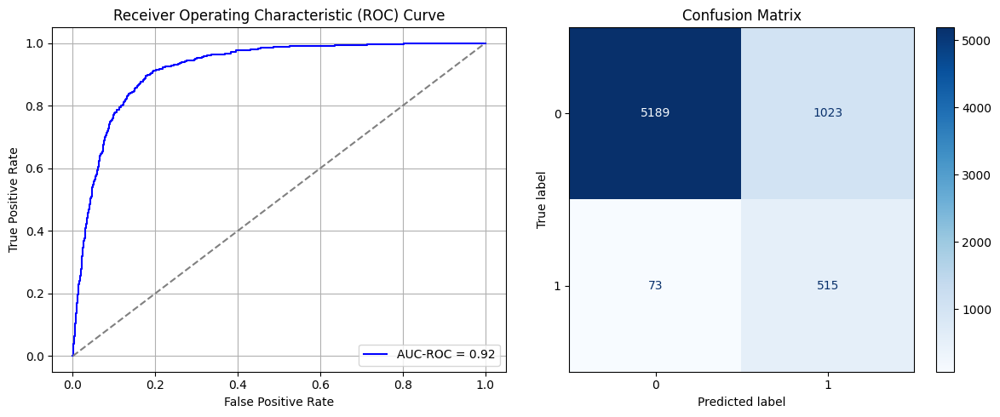

Best threshold based on F1-score: 0.9992247223854065
False Negative Rate: 0.12414965986394558
Time elapsed (performance): 1.0930891670000165
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6722 - loss: 0.6574 - val_AUC: 0.7666 - val_loss: 0.5879
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7781 - loss: 0.5733 - val_AUC: 0.8506 - val_loss: 0.5075
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8464 - loss: 0.5010 - val_AUC: 0.8707 - val_loss: 0.4692
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8715 - loss: 0.4588 - val_AUC: 0.8740 - val_loss: 0.4574
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8667 - loss: 0.4627 - val_AUC: 0.8761 - val_loss: 0.4498
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8736 - loss: 0.4518 - val_AUC: 0.8765 - val_loss: 0.4499
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8838 - loss: 0.4335 - val_AUC: 0.8742 - val_loss: 0.4523
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8856 - loss: 0.4292 - val_AUC: 0.8755 - val_loss: 0.4487
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8787 -

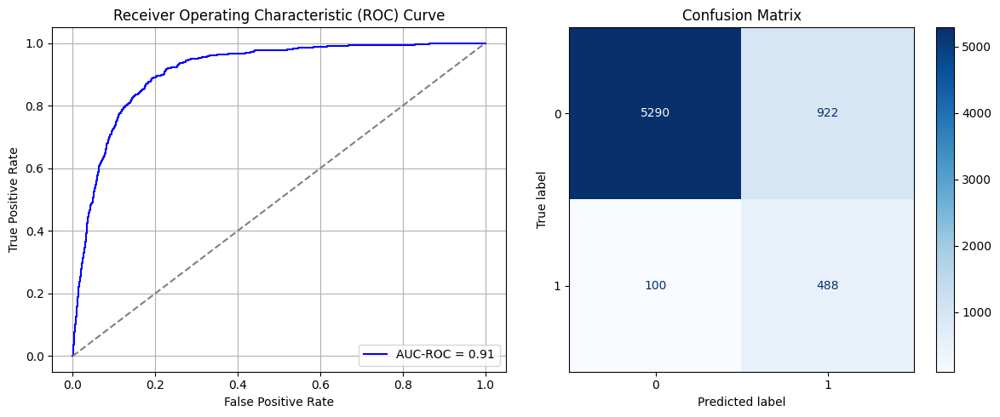

Best threshold based on F1-score: 0.997711181640625
False Negative Rate: 0.17006802721088435
Time elapsed (performance): 1.0602481109999644
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6744 - loss: 0.6471 - val_AUC: 0.7540 - val_loss: 0.5942
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.7883 - loss: 0.5592 - val_AUC: 0.8494 - val_loss: 0.5100
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8602 - loss: 0.4819 - val_AUC: 0.8727 - val_loss: 0.4578
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8768 - loss: 0.4521 - val_AUC: 0.8786 - val_loss: 0.4471
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8760 - loss: 0.4518 - val_AUC: 0.8796 - val_loss: 0.4475
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8845 - loss: 0.4352 - val_AUC: 0.8792 - val_loss: 0.4365
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8825 - loss: 0.4348 - val_AUC: 0.8842 - val_loss: 0.4324
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8909 - loss: 0.4218 - val_AUC: 0.8807 - val_loss: 0.4370
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8900 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9186194922270261
Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.90      0.94      6212
           1       0.42      0.75      0.54       588

    accuracy                           0.89      6800
   macro avg       0.70      0.83      0.74      6800
weighted avg       0.93      0.89      0.90      6800

FPR 0.09916291049581455 TPR: 0.7534013605442177 FNR: 0.2465986394557823 TNR: 0.9008370895041855


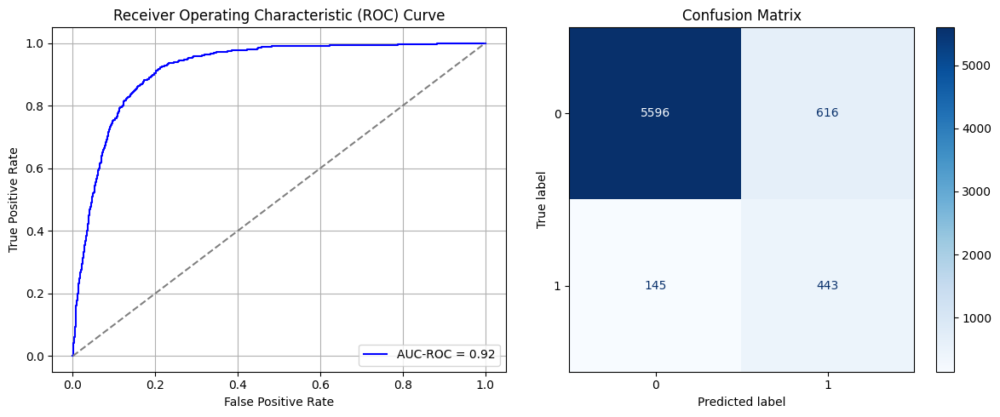

Best threshold based on F1-score: 0.9978713989257812
False Negative Rate: 0.2465986394557823
Time elapsed (performance): 1.296453964000193
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6379 - loss: 0.6611 - val_AUC: 0.7614 - val_loss: 0.5899
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7943 - loss: 0.5560 - val_AUC: 0.8453 - val_loss: 0.5069
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8533 - loss: 0.4899 - val_AUC: 0.8694 - val_loss: 0.4643
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8703 - loss: 0.4603 - val_AUC: 0.8769 - val_loss: 0.4479
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8759 - loss: 0.4465 - val_AUC: 0.8781 - val_loss: 0.4440
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8853 - loss: 0.4299 - val_AUC: 0.8788 - val_loss: 0.4431
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8870 - loss: 0.4303 - val_AUC: 0.8789 - val_loss: 0.4422
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8862 - loss: 0.4288 - val_AUC: 0.8795 - val_loss: 0.4424
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8919 -

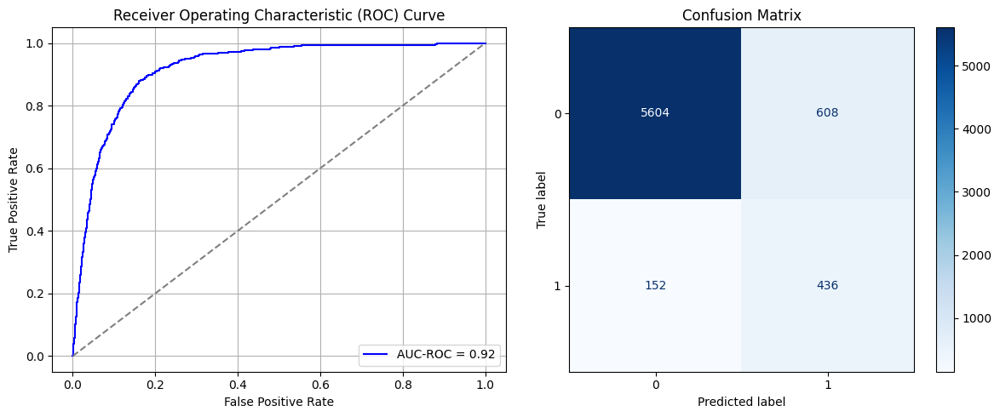

Best threshold based on F1-score: 0.6018850803375244
False Negative Rate: 0.2585034013605442
Time elapsed (performance): 0.9882032170003185


In [53]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    data_S_maj_rus = data_S_majority.sample(n=undersample_size, replace=False)
    data_S_SRS_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_SRS = data_S_SRS_RUS.iloc[:, :-1]
    y_S_SRS = data_S_SRS_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_SRS, y_S_SRS, test_size=0.20, random_state=0)
    model_SRS = create_dnn_model(X_S_train.shape[1])
    result_SRS = train_and_evaluate(model_SRS, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_SRS = Transductive_TL(model_SRS, X_T_full, y_T_full, "Target")

    Training_time.append(result_SRS)
    FPR.append(result_TL_SRS[0])
    TNR.append(result_TL_SRS[1])
    FNR.append(result_TL_SRS[2])
    TPR.append(result_TL_SRS[3])
    TL_time.append(result_TL_SRS[4])

ParamFit = pd.DataFrame([Training_time, FPR, TPR, FNR, TNR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TPR', 'FNR', 'TNR', 'Target time']
# print(ParamFit)

In [54]:
print(ParamFit)
ParamFit.to_csv('SRS_RUS.csv')

    Source time       FPR       TPR       FNR       TNR  Target time
0      9.934139  0.134256  0.818027  0.181973  0.865744     0.777929
1     10.018839  0.186413  0.874150  0.125850  0.813587     0.784993
2      8.886081  0.159208  0.860544  0.139456  0.840792     1.069381
3      8.623693  0.203960  0.894558  0.105442  0.796040     1.036630
4      9.021823  0.105763  0.780612  0.219388  0.894237     0.757928
5      9.311681  0.162750  0.874150  0.125850  0.837250     0.779733
6     10.846118  0.102543  0.770408  0.229592  0.897457     1.037867
7     10.163712  0.127334  0.814626  0.185374  0.872666     0.782543
8      9.984827  0.136349  0.821429  0.178571  0.863651     0.767580
9      8.922286  0.193335  0.882653  0.117347  0.806665     1.203037
10    10.883738  0.175306  0.880952  0.119048  0.824694     1.035046
11    10.191416  0.162428  0.869048  0.130952  0.837572     0.798709
12    13.582553  0.117675  0.804422  0.195578  0.882325     1.224480
13    13.019327  0.121700  0.77891

In [55]:
ParamFit['FNR'].mean()

np.float64(0.18666666666666668)

In [56]:
ParamFit['Source time'].mean()

np.float64(12.960947324540003)

## Simple Random Sampling with Replacement:

In [57]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

4433
31960


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6255 - loss: 0.6661 - val_AUC: 0.7431 - val_loss: 0.6096
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7639 - loss: 0.5853 - val_AUC: 0.8281 - val_loss: 0.5298
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8430 - loss: 0.5099 - val_AUC: 0.8717 - val_loss: 0.4708
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8637 - loss: 0.4710 - val_AUC: 0.8738 - val_loss: 0.4590
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8836 - loss: 0.4379 - val_AUC: 0.8794 - val_loss: 0.4488
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8711 - loss: 0.4569 - val_AUC: 0.8800 - val_loss: 0.4477
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8816 - loss: 0.4365 - val_AUC: 0.8830 - val_loss: 0.4422
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8743 - loss: 0.4491 - val_AUC: 0.8801 - val_loss: 0.4461
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8869 -

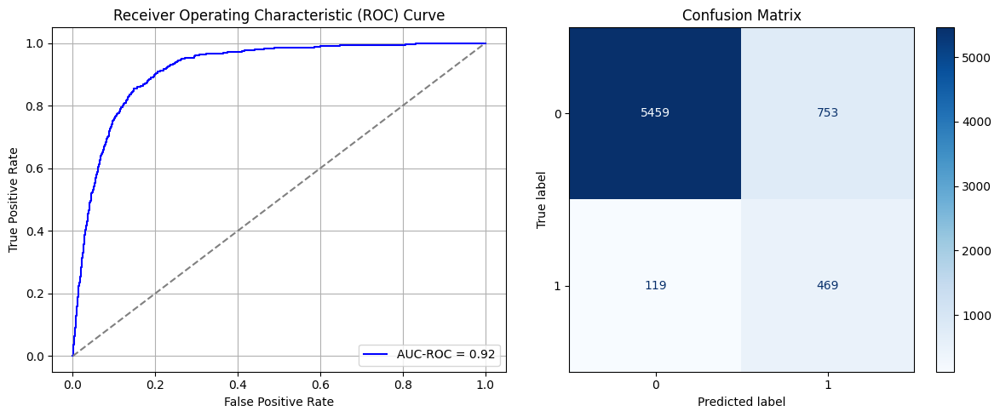

Best threshold based on F1-score: 0.9975739121437073
False Negative Rate: 0.20238095238095238
Time elapsed (performance): 0.765717685999789
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.6851 - loss: 0.6560 - val_AUC: 0.7966 - val_loss: 0.5626
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8050 - loss: 0.5488 - val_AUC: 0.8657 - val_loss: 0.4955
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8717 - loss: 0.4647 - val_AUC: 0.8763 - val_loss: 0.4582
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8862 - loss: 0.4346 - val_AUC: 0.8754 - val_loss: 0.4565
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8893 - loss: 0.4290 - val_AUC: 0.8733 - val_loss: 0.4660
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8827 - loss: 0.4407 - val_AUC: 0.8766 - val_loss: 0.4512
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8837 - loss: 0.4343 - val_AUC: 0.8796 - val_loss: 0.4441
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8967 - loss: 0.4092 - val_AUC: 0.8786 - val_loss: 0.4498
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8917 -

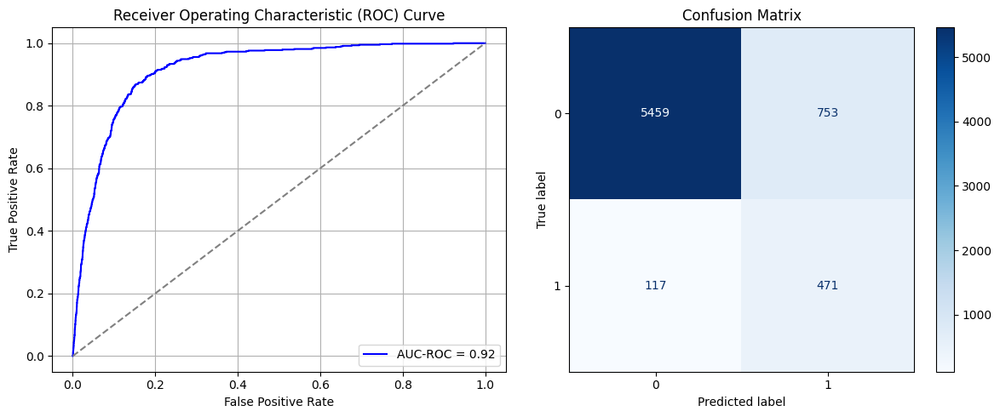

Best threshold based on F1-score: 0.9987697005271912
False Negative Rate: 0.1989795918367347
Time elapsed (performance): 0.7612986959998125
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6341 - loss: 0.6630 - val_AUC: 0.7470 - val_loss: 0.6054
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7799 - loss: 0.5694 - val_AUC: 0.8357 - val_loss: 0.5218
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8451 - loss: 0.5016 - val_AUC: 0.8712 - val_loss: 0.4750
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8681 - loss: 0.4649 - val_AUC: 0.8755 - val_loss: 0.4551
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8719 - loss: 0.4551 - val_AUC: 0.8778 - val_loss: 0.4520
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8823 - loss: 0.4376 - val_AUC: 0.8785 - val_loss: 0.4512
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8841 - loss: 0.4354 - val_AUC: 0.8790 - val_loss: 0.4493
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8888 - loss: 0.4261 - val_AUC: 0.8792 - val_loss: 0.4471
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8911 -

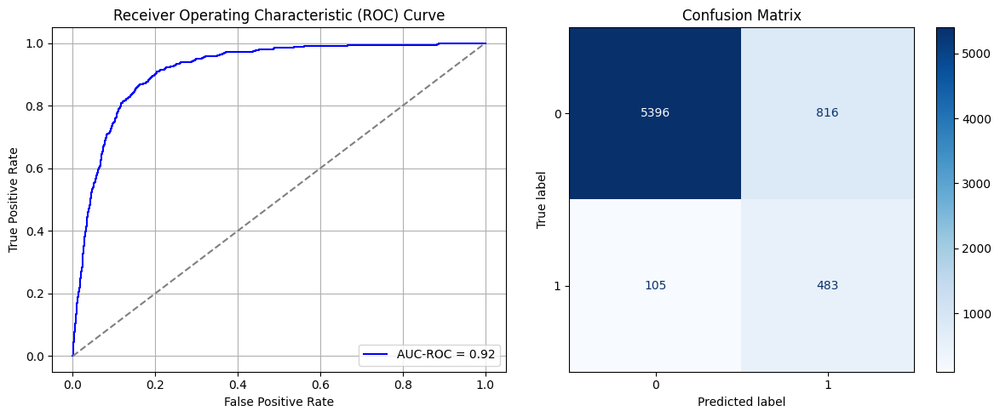

Best threshold based on F1-score: 0.9998019337654114
False Negative Rate: 0.17857142857142858
Time elapsed (performance): 0.7596159600002466
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6113 - loss: 0.6716 - val_AUC: 0.7470 - val_loss: 0.5977
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7807 - loss: 0.5711 - val_AUC: 0.8351 - val_loss: 0.5208
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8491 - loss: 0.4972 - val_AUC: 0.8726 - val_loss: 0.4720
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8671 - loss: 0.4665 - val_AUC: 0.8740 - val_loss: 0.4608
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8756 - loss: 0.4477 - val_AUC: 0.8792 - val_loss: 0.4425
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8853 - loss: 0.4307 - val_AUC: 0.8799 - val_loss: 0.4378
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8853 - loss: 0.4300 - val_AUC: 0.8832 - val_loss: 0.4374
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8821 - loss: 0.4354 - val_AUC: 0.8836 - val_loss: 0.4293
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8782 -

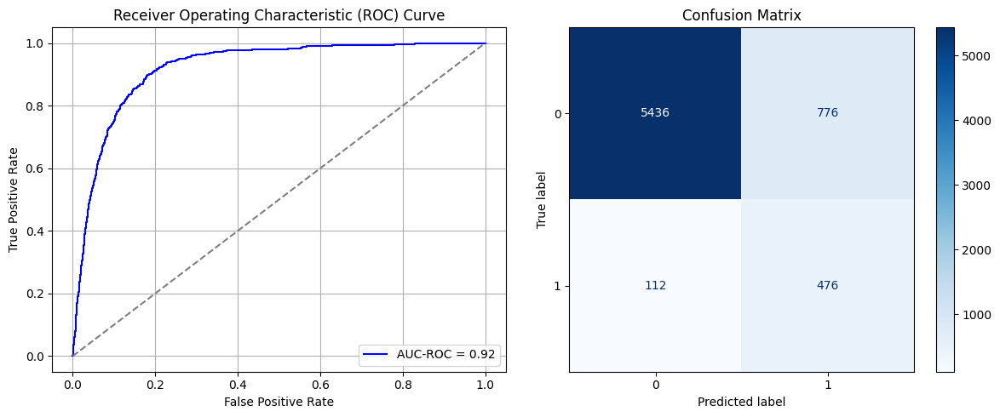

Best threshold based on F1-score: 0.996970534324646
False Negative Rate: 0.19047619047619047
Time elapsed (performance): 5.17959048900002
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6793 - loss: 0.6522 - val_AUC: 0.7642 - val_loss: 0.5855
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7927 - loss: 0.5592 - val_AUC: 0.8572 - val_loss: 0.5127
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8558 - loss: 0.4884 - val_AUC: 0.8764 - val_loss: 0.4529
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8710 - loss: 0.4573 - val_AUC: 0.8808 - val_loss: 0.4404
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8839 - loss: 0.4350 - val_AUC: 0.8831 - val_loss: 0.4410
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8877 - loss: 0.4268 - val_AUC: 0.8835 - val_loss: 0.4342
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8851 - loss: 0.4293 - val_AUC: 0.8868 - val_loss: 0.4350
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8832 - loss: 0.4332 - val_AUC: 0.8874 - val_loss: 0.4234
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8889 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9172404956831413
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.89      0.93      6212
           1       0.40      0.78      0.53       588

    accuracy                           0.88      6800
   macro avg       0.69      0.83      0.73      6800
weighted avg       0.93      0.88      0.90      6800

FPR 0.11188023180940115 TPR: 0.7806122448979592 FNR: 0.2193877551020408 TNR: 0.8881197681905988


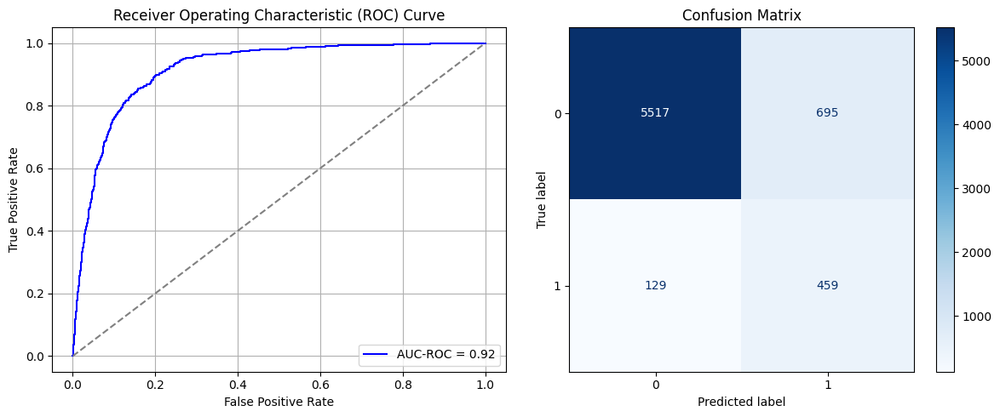

Best threshold based on F1-score: 0.6362574696540833
False Negative Rate: 0.2193877551020408
Time elapsed (performance): 1.0590508989998852
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6194 - loss: 0.6671 - val_AUC: 0.7623 - val_loss: 0.5879
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7924 - loss: 0.5571 - val_AUC: 0.8415 - val_loss: 0.5057
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8556 - loss: 0.4848 - val_AUC: 0.8637 - val_loss: 0.4719
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8764 - loss: 0.4500 - val_AUC: 0.8704 - val_loss: 0.4652
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8822 - loss: 0.4377 - val_AUC: 0.8716 - val_loss: 0.4627
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8896 - loss: 0.4234 - val_AUC: 0.8747 - val_loss: 0.4442
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8934 - loss: 0.4153 - val_AUC: 0.8720 - val_loss: 0.4564
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8923 - loss: 0.4167 - val_AUC: 0.8790 - val_loss: 0.4369
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8872 -

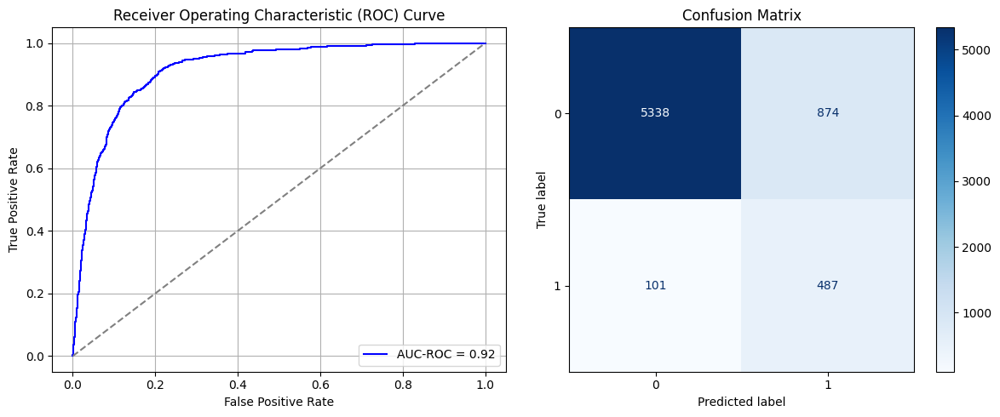

Best threshold based on F1-score: 0.7446246147155762
False Negative Rate: 0.1717687074829932
Time elapsed (performance): 0.7926975090003907
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6726 - loss: 0.6506 - val_AUC: 0.7625 - val_loss: 0.5893
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7838 - loss: 0.5676 - val_AUC: 0.8410 - val_loss: 0.5125
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8670 - loss: 0.4745 - val_AUC: 0.8690 - val_loss: 0.4765
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8698 - loss: 0.4594 - val_AUC: 0.8723 - val_loss: 0.4622
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8792 - loss: 0.4435 - val_AUC: 0.8703 - val_loss: 0.4786
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8777 - loss: 0.4464 - val_AUC: 0.8758 - val_loss: 0.4530
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8765 - loss: 0.4492 - val_AUC: 0.8730 - val_loss: 0.4613
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8801 - loss: 0.4403 - val_AUC: 0.8756 - val_loss: 0.4671
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8917 -

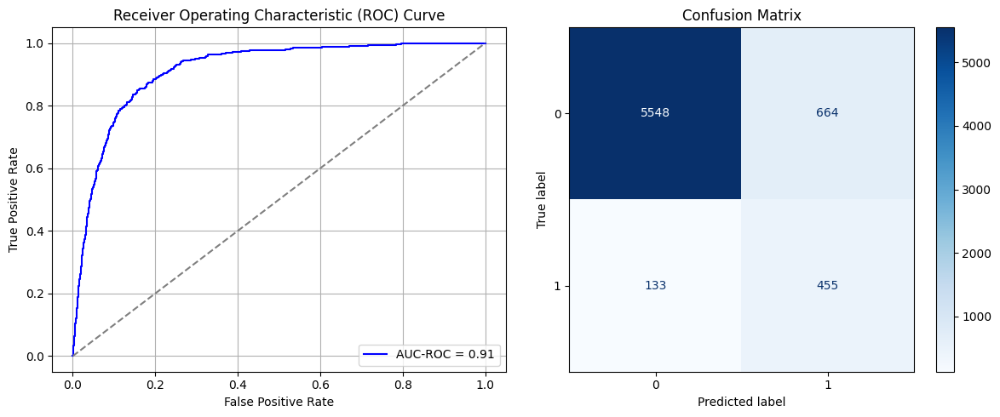

Best threshold based on F1-score: 0.5576603412628174
False Negative Rate: 0.2261904761904762
Time elapsed (performance): 1.076499846000388
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6610 - loss: 0.6583 - val_AUC: 0.7720 - val_loss: 0.5835
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7744 - loss: 0.5728 - val_AUC: 0.8589 - val_loss: 0.4945
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8542 - loss: 0.4876 - val_AUC: 0.8765 - val_loss: 0.4532
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8748 - loss: 0.4508 - val_AUC: 0.8738 - val_loss: 0.4534
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8790 - loss: 0.4413 - val_AUC: 0.8757 - val_loss: 0.4481
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8784 - loss: 0.4413 - val_AUC: 0.8785 - val_loss: 0.4583
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8791 - loss: 0.4383 - val_AUC: 0.8795 - val_loss: 0.4492
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8785 - loss: 0.4401 - val_AUC: 0.8801 - val_loss: 0.4346
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8839 -

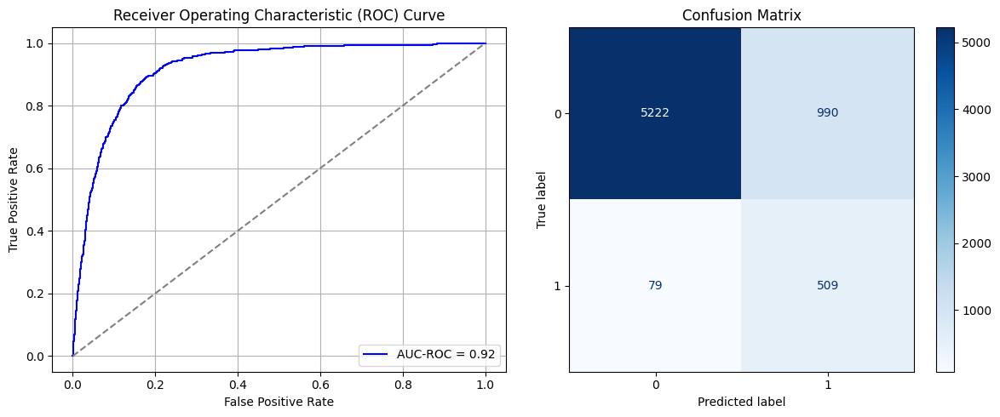

Best threshold based on F1-score: 0.9962411522865295
False Negative Rate: 0.13435374149659865
Time elapsed (performance): 0.786054477000107
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6427 - loss: 0.6607 - val_AUC: 0.7830 - val_loss: 0.5732
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7859 - loss: 0.5640 - val_AUC: 0.8612 - val_loss: 0.5009
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8559 - loss: 0.4888 - val_AUC: 0.8821 - val_loss: 0.4567
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8739 - loss: 0.4515 - val_AUC: 0.8812 - val_loss: 0.4700
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8772 - loss: 0.4441 - val_AUC: 0.8846 - val_loss: 0.4333
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8745 - loss: 0.4473 - val_AUC: 0.8862 - val_loss: 0.4297
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8769 - loss: 0.4409 - val_AUC: 0.8844 - val_loss: 0.4312
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8739 - loss: 0.4455 - val_AUC: 0.8862 - val_loss: 0.4281
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8833 -

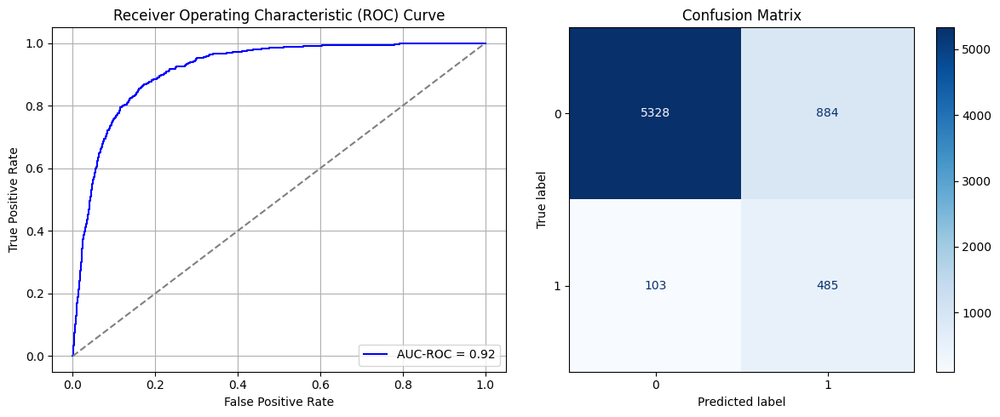

Best threshold based on F1-score: 0.9944571852684021
False Negative Rate: 0.17517006802721088
Time elapsed (performance): 0.816689096999653
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6564 - loss: 0.6548 - val_AUC: 0.7679 - val_loss: 0.5880
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7734 - loss: 0.5746 - val_AUC: 0.8607 - val_loss: 0.4916
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8439 - loss: 0.4997 - val_AUC: 0.8815 - val_loss: 0.4430
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8626 - loss: 0.4690 - val_AUC: 0.8876 - val_loss: 0.4336
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8776 - loss: 0.4449 - val_AUC: 0.8886 - val_loss: 0.4433
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8803 - loss: 0.4429 - val_AUC: 0.8898 - val_loss: 0.4469
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8804 - loss: 0.4392 - val_AUC: 0.8881 - val_loss: 0.4276
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8804 - loss: 0.4381 - val_AUC: 0.8906 - val_loss: 0.4175
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8833 -

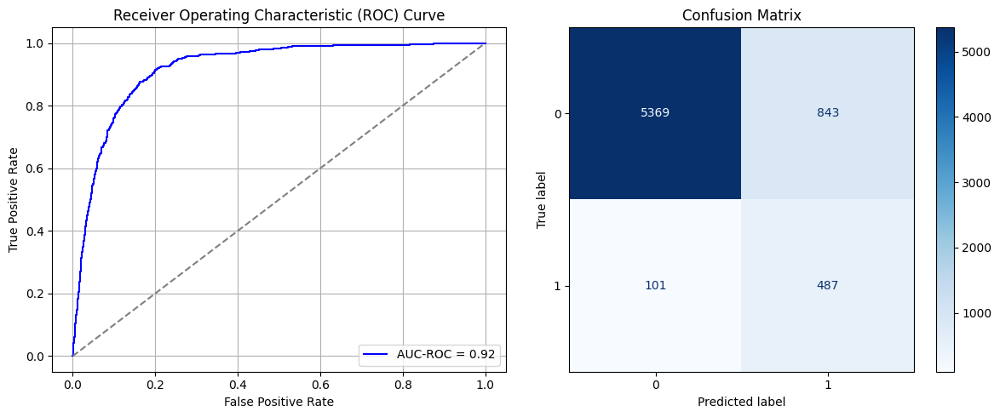

Best threshold based on F1-score: 0.9990096688270569
False Negative Rate: 0.1717687074829932
Time elapsed (performance): 0.7998915940002007
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.5895 - loss: 0.6780 - val_AUC: 0.7614 - val_loss: 0.5933
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7791 - loss: 0.5718 - val_AUC: 0.8614 - val_loss: 0.5012
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8609 - loss: 0.4845 - val_AUC: 0.8771 - val_loss: 0.4598
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8649 - loss: 0.4694 - val_AUC: 0.8820 - val_loss: 0.4425
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8732 - loss: 0.4536 - val_AUC: 0.8870 - val_loss: 0.4359
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8820 - loss: 0.4384 - val_AUC: 0.8833 - val_loss: 0.4531
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8745 - loss: 0.4527 - val_AUC: 0.8865 - val_loss: 0.4293
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8847 - loss: 0.4337 - val_AUC: 0.8866 - val_loss: 0.4350
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8881 -

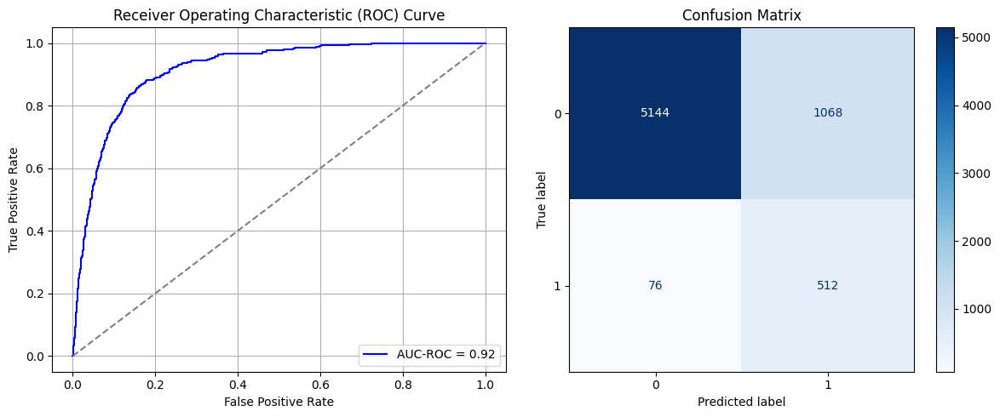

Best threshold based on F1-score: 0.7270883321762085
False Negative Rate: 0.1292517006802721
Time elapsed (performance): 0.8177312129996608
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6046 - loss: 0.6739 - val_AUC: 0.7655 - val_loss: 0.5849
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7751 - loss: 0.5714 - val_AUC: 0.8516 - val_loss: 0.5000
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8533 - loss: 0.4867 - val_AUC: 0.8780 - val_loss: 0.4573
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8787 - loss: 0.4449 - val_AUC: 0.8847 - val_loss: 0.4398
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8860 - loss: 0.4306 - val_AUC: 0.8883 - val_loss: 0.4339
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8762 - loss: 0.4445 - val_AUC: 0.8867 - val_loss: 0.4307
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8853 - loss: 0.4303 - val_AUC: 0.8870 - val_loss: 0.4288
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8848 - loss: 0.4283 - val_AUC: 0.8879 - val_loss: 0.4327
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8806 -

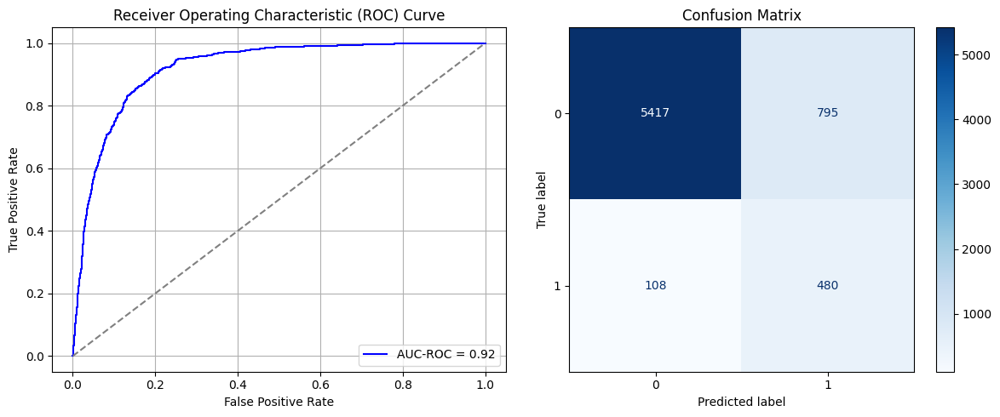

Best threshold based on F1-score: 0.9988158345222473
False Negative Rate: 0.1836734693877551
Time elapsed (performance): 1.1187773729998298
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6619 - loss: 0.6550 - val_AUC: 0.7615 - val_loss: 0.5890
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7848 - loss: 0.5652 - val_AUC: 0.8436 - val_loss: 0.5191
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8571 - loss: 0.4863 - val_AUC: 0.8711 - val_loss: 0.4688
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8739 - loss: 0.4547 - val_AUC: 0.8770 - val_loss: 0.4498
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8885 - loss: 0.4288 - val_AUC: 0.8788 - val_loss: 0.4472
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8904 - loss: 0.4236 - val_AUC: 0.8771 - val_loss: 0.4462
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8928 - loss: 0.4177 - val_AUC: 0.8794 - val_loss: 0.4381
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8806 - loss: 0.4361 - val_AUC: 0.8809 - val_loss: 0.4362
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8862 -

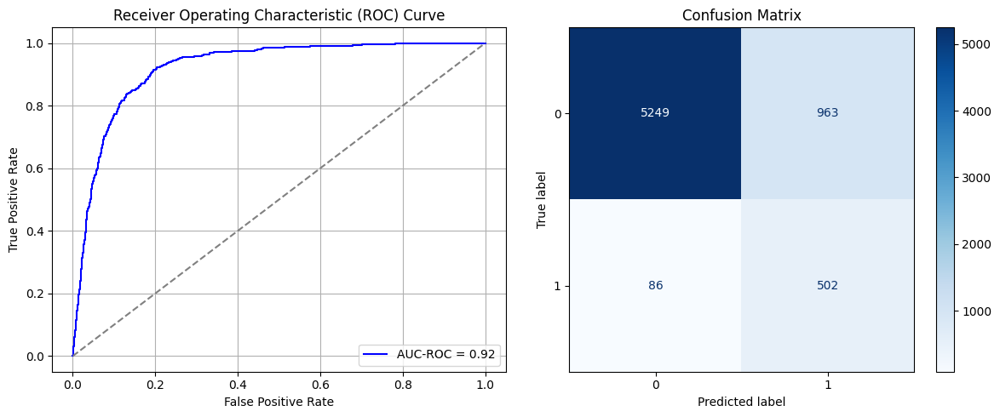

Best threshold based on F1-score: 0.7174893617630005
False Negative Rate: 0.14625850340136054
Time elapsed (performance): 0.8224003570003333
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6627 - loss: 0.6568 - val_AUC: 0.7684 - val_loss: 0.5848
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7859 - loss: 0.5637 - val_AUC: 0.8527 - val_loss: 0.5011
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8593 - loss: 0.4815 - val_AUC: 0.8701 - val_loss: 0.4638
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8819 - loss: 0.4424 - val_AUC: 0.8704 - val_loss: 0.4601
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8800 - loss: 0.4412 - val_AUC: 0.8726 - val_loss: 0.4565
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8832 - loss: 0.4342 - val_AUC: 0.8744 - val_loss: 0.4523
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8780 - loss: 0.4418 - val_AUC: 0.8743 - val_loss: 0.4553
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8914 - loss: 0.4203 - val_AUC: 0.8743 - val_loss: 0.4482
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8967 -

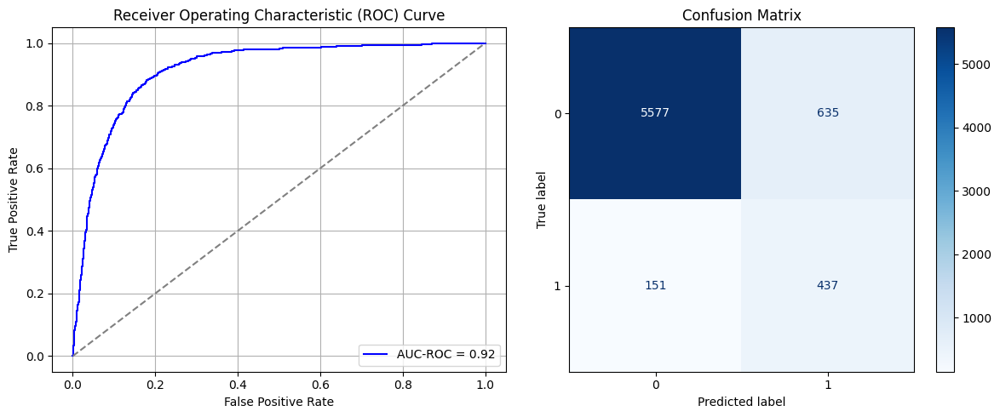

Best threshold based on F1-score: 0.9973206520080566
False Negative Rate: 0.2568027210884354
Time elapsed (performance): 0.8237355169999319
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6162 - loss: 0.6646 - val_AUC: 0.7667 - val_loss: 0.5902
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7764 - loss: 0.5772 - val_AUC: 0.8436 - val_loss: 0.5103
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8509 - loss: 0.4920 - val_AUC: 0.8771 - val_loss: 0.4520
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8742 - loss: 0.4539 - val_AUC: 0.8812 - val_loss: 0.4396
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8856 - loss: 0.4294 - val_AUC: 0.8859 - val_loss: 0.4289
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8866 - loss: 0.4266 - val_AUC: 0.8843 - val_loss: 0.4300
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8920 - loss: 0.4162 - val_AUC: 0.8830 - val_loss: 0.4439
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8884 - loss: 0.4239 - val_AUC: 0.8875 - val_loss: 0.4235
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8942 -

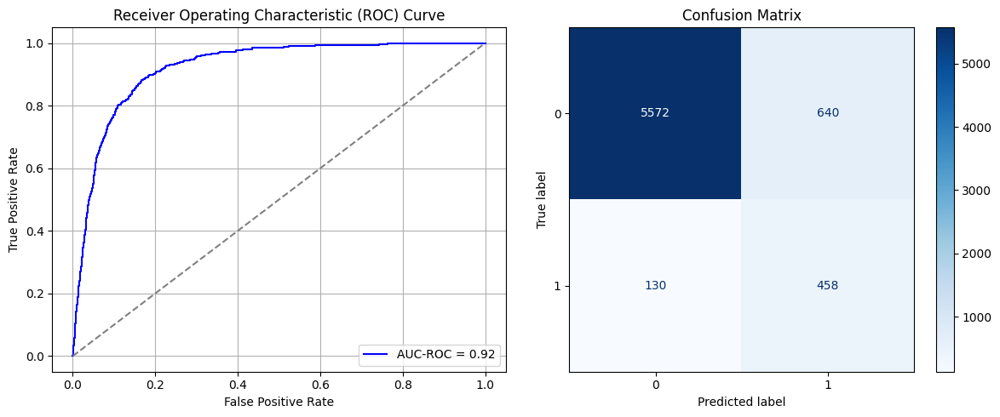

Best threshold based on F1-score: 0.9964162111282349
False Negative Rate: 0.22108843537414966
Time elapsed (performance): 1.0701188339999135
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.7029 - loss: 0.6399 - val_AUC: 0.7712 - val_loss: 0.5765
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7925 - loss: 0.5592 - val_AUC: 0.8553 - val_loss: 0.5003
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8571 - loss: 0.4851 - val_AUC: 0.8753 - val_loss: 0.4529
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8608 - loss: 0.4737 - val_AUC: 0.8778 - val_loss: 0.4838
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8697 - loss: 0.4584 - val_AUC: 0.8790 - val_loss: 0.4451
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8743 - loss: 0.4496 - val_AUC: 0.8795 - val_loss: 0.4378
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8841 - loss: 0.4331 - val_AUC: 0.8789 - val_loss: 0.4682
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8779 - loss: 0.4403 - val_AUC: 0.8810 - val_loss: 0.4508
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8786 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9191820965346861
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.79      0.88      6212
           1       0.29      0.91      0.44       588

    accuracy                           0.80      6800
   macro avg       0.64      0.85      0.66      6800
weighted avg       0.93      0.80      0.84      6800

FPR 0.20669671603348358 TPR: 0.9081632653061225 FNR: 0.09183673469387756 TNR: 0.7933032839665164


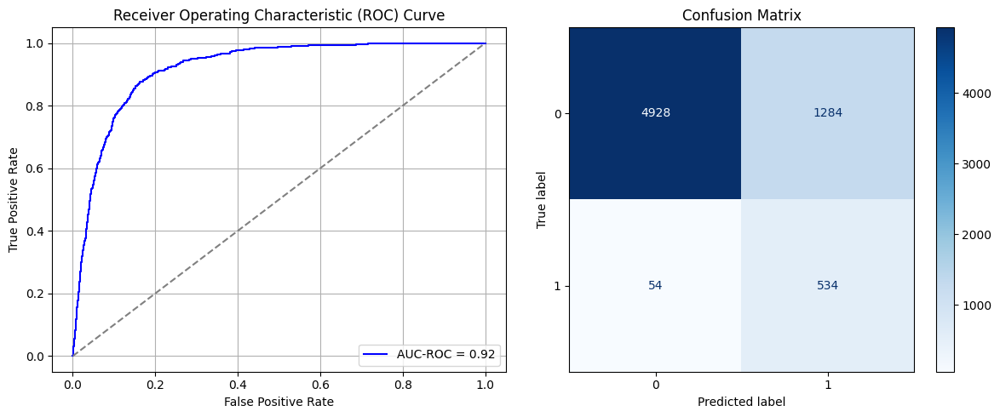

Best threshold based on F1-score: 0.7696920037269592
False Negative Rate: 0.09183673469387756
Time elapsed (performance): 1.0331936759998825
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6991 - loss: 0.6424 - val_AUC: 0.7555 - val_loss: 0.5946
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7851 - loss: 0.5637 - val_AUC: 0.8413 - val_loss: 0.5093
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8390 - loss: 0.5071 - val_AUC: 0.8585 - val_loss: 0.4813
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8696 - loss: 0.4589 - val_AUC: 0.8690 - val_loss: 0.4604
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8771 - loss: 0.4452 - val_AUC: 0.8683 - val_loss: 0.4638
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8768 - loss: 0.4431 - val_AUC: 0.8705 - val_loss: 0.4498
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8778 - loss: 0.4419 - val_AUC: 0.8698 - val_loss: 0.4543
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8770 - loss: 0.4412 - val_AUC: 0.8711 - val_loss: 0.4471
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8845 -

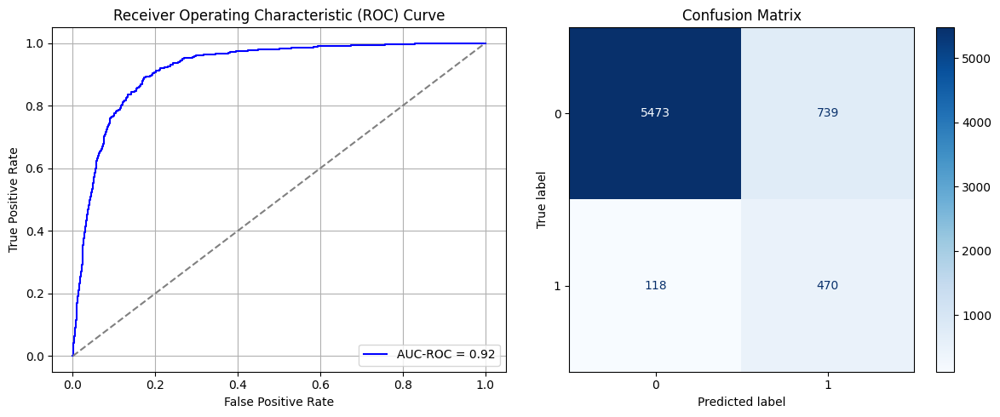

Best threshold based on F1-score: 0.9956347942352295
False Negative Rate: 0.20068027210884354
Time elapsed (performance): 0.8037631890001649
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6745 - loss: 0.6577 - val_AUC: 0.7591 - val_loss: 0.5866
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7935 - loss: 0.5592 - val_AUC: 0.8420 - val_loss: 0.5213
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8651 - loss: 0.4799 - val_AUC: 0.8656 - val_loss: 0.4739
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8701 - loss: 0.4596 - val_AUC: 0.8730 - val_loss: 0.4674
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8865 - loss: 0.4317 - val_AUC: 0.8728 - val_loss: 0.4581
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8884 - loss: 0.4269 - val_AUC: 0.8736 - val_loss: 0.4792
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8758 - loss: 0.4485 - val_AUC: 0.8763 - val_loss: 0.4481
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8929 - loss: 0.4179 - val_AUC: 0.8784 - val_loss: 0.4462
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8968 -

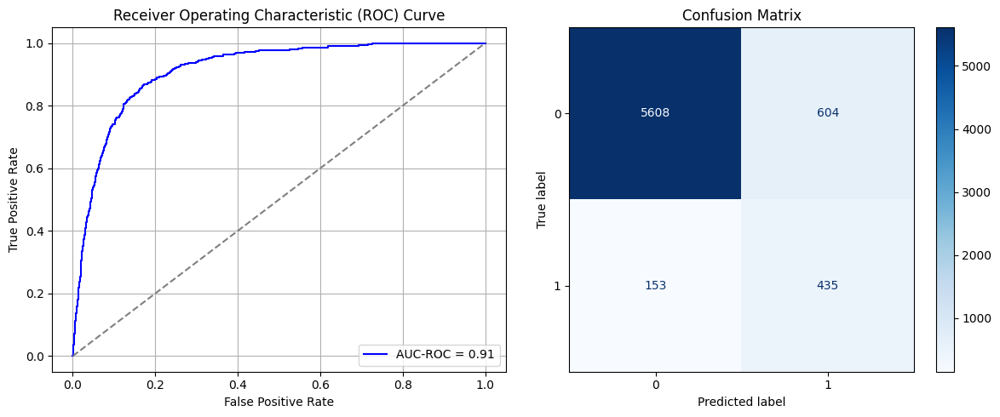

Best threshold based on F1-score: 0.9988896250724792
False Negative Rate: 0.2602040816326531
Time elapsed (performance): 1.0454565000000002
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6563 - loss: 0.6607 - val_AUC: 0.7655 - val_loss: 0.5813
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7851 - loss: 0.5640 - val_AUC: 0.8617 - val_loss: 0.4929
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8465 - loss: 0.4986 - val_AUC: 0.8770 - val_loss: 0.4582
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8681 - loss: 0.4649 - val_AUC: 0.8807 - val_loss: 0.4617
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8712 - loss: 0.4550 - val_AUC: 0.8852 - val_loss: 0.4508
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8737 - loss: 0.4536 - val_AUC: 0.8824 - val_loss: 0.4391
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8798 - loss: 0.4395 - val_AUC: 0.8853 - val_loss: 0.4400
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8855 - loss: 0.4302 - val_AUC: 0.8846 - val_loss: 0.4388
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8736 -

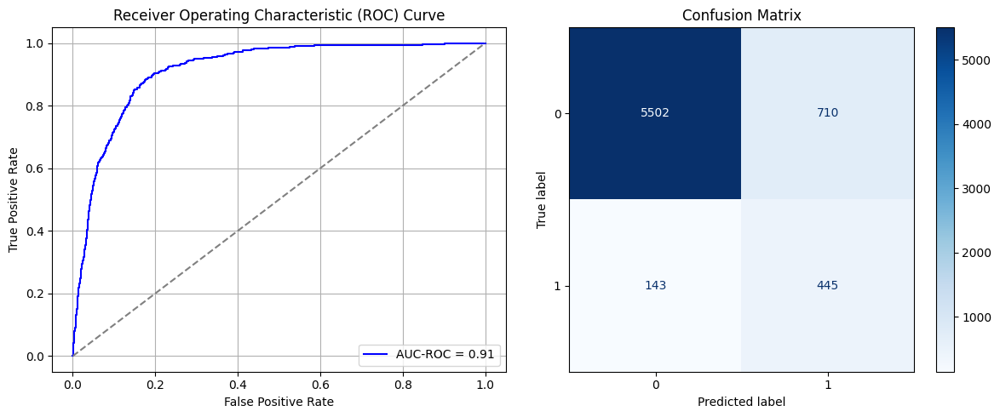

Best threshold based on F1-score: 0.999374270439148
False Negative Rate: 0.24319727891156462
Time elapsed (performance): 1.0704992020000645
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6364 - loss: 0.6609 - val_AUC: 0.7459 - val_loss: 0.5947
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8033 - loss: 0.5483 - val_AUC: 0.8380 - val_loss: 0.5101
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8550 - loss: 0.4891 - val_AUC: 0.8710 - val_loss: 0.4634
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8683 - loss: 0.4622 - val_AUC: 0.8760 - val_loss: 0.4461
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8815 - loss: 0.4406 - val_AUC: 0.8803 - val_loss: 0.4401
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8748 - loss: 0.4511 - val_AUC: 0.8809 - val_loss: 0.4354
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8849 - loss: 0.4343 - val_AUC: 0.8820 - val_loss: 0.4338
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8844 - loss: 0.4341 - val_AUC: 0.8843 - val_loss: 0.4303
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8811 -

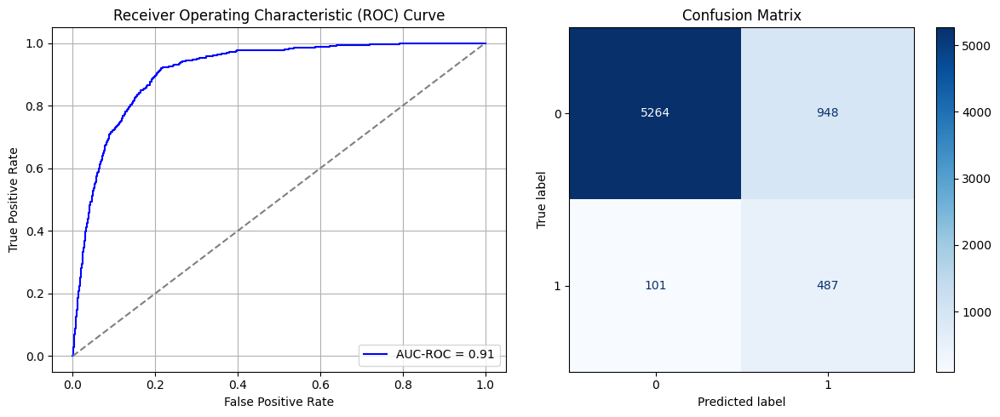

Best threshold based on F1-score: 0.9983084201812744
False Negative Rate: 0.1717687074829932
Time elapsed (performance): 1.051394669000274
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6748 - loss: 0.6555 - val_AUC: 0.7800 - val_loss: 0.5814
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.7725 - loss: 0.5820 - val_AUC: 0.8459 - val_loss: 0.5169
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8433 - loss: 0.5047 - val_AUC: 0.8775 - val_loss: 0.4593
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8724 - loss: 0.4639 - val_AUC: 0.8813 - val_loss: 0.4505
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8774 - loss: 0.4493 - val_AUC: 0.8822 - val_loss: 0.4420
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8776 - loss: 0.4522 - val_AUC: 0.8850 - val_loss: 0.4382
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8858 - loss: 0.4348 - val_AUC: 0.8846 - val_loss: 0.4372
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8857 - loss: 0.4319 - val_AUC: 0.8870 - val_loss: 0.4326
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8783 -

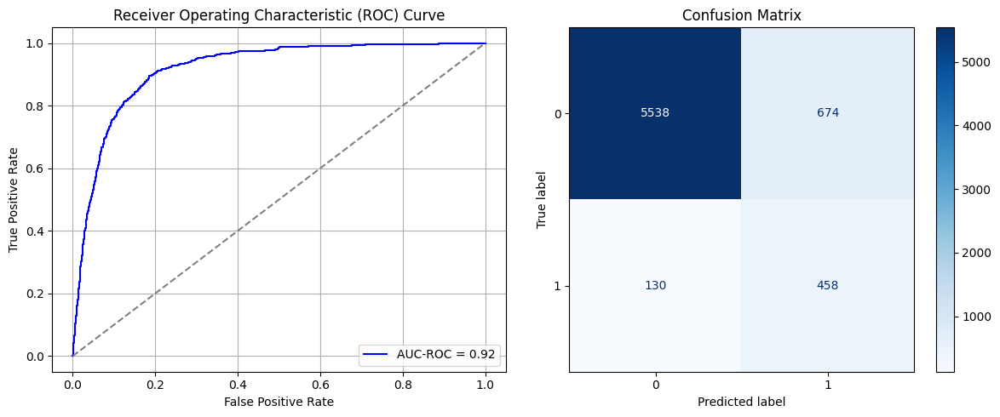

Best threshold based on F1-score: 0.9989591240882874
False Negative Rate: 0.22108843537414966
Time elapsed (performance): 1.7133611610001935
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6768 - loss: 0.6495 - val_AUC: 0.7598 - val_loss: 0.5964
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7851 - loss: 0.5683 - val_AUC: 0.8524 - val_loss: 0.4971
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8556 - loss: 0.4852 - val_AUC: 0.8817 - val_loss: 0.4567
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8696 - loss: 0.4604 - val_AUC: 0.8829 - val_loss: 0.4506
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8782 - loss: 0.4413 - val_AUC: 0.8849 - val_loss: 0.4337
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8829 - loss: 0.4325 - val_AUC: 0.8868 - val_loss: 0.4274
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8852 - loss: 0.4283 - val_AUC: 0.8871 - val_loss: 0.4295
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8858 - loss: 0.4301 - val_AUC: 0.8856 - val_loss: 0.4271
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8916 -

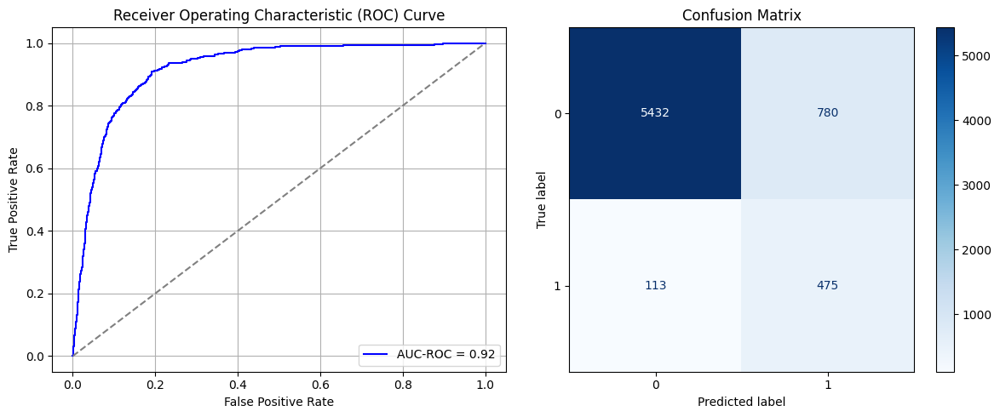

Best threshold based on F1-score: 0.9936074018478394
False Negative Rate: 0.1921768707482993
Time elapsed (performance): 1.0564146890001211
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6689 - loss: 0.6528 - val_AUC: 0.7713 - val_loss: 0.5818
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7646 - loss: 0.5851 - val_AUC: 0.8480 - val_loss: 0.5101
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8392 - loss: 0.5127 - val_AUC: 0.8757 - val_loss: 0.4748
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8673 - loss: 0.4685 - val_AUC: 0.8801 - val_loss: 0.4546
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8745 - loss: 0.4538 - val_AUC: 0.8798 - val_loss: 0.4513
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8744 - loss: 0.4506 - val_AUC: 0.8816 - val_loss: 0.4504
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8734 - loss: 0.4517 - val_AUC: 0.8808 - val_loss: 0.4388
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8909 - loss: 0.4209 - val_AUC: 0.8814 - val_loss: 0.4391
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8803 -

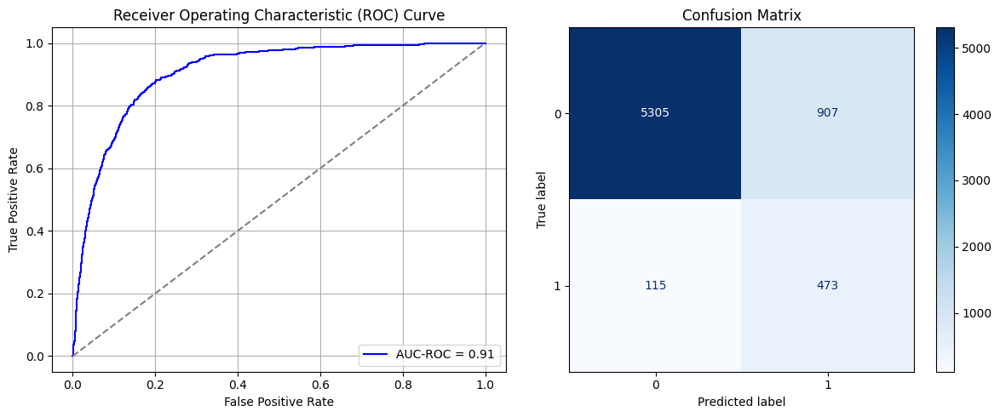

Best threshold based on F1-score: 0.6777608394622803
False Negative Rate: 0.195578231292517
Time elapsed (performance): 0.8281765440001436
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6891 - loss: 0.6532 - val_AUC: 0.7698 - val_loss: 0.5796
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8053 - loss: 0.5449 - val_AUC: 0.8564 - val_loss: 0.4962
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8611 - loss: 0.4809 - val_AUC: 0.8753 - val_loss: 0.4707
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8652 - loss: 0.4614 - val_AUC: 0.8805 - val_loss: 0.4453
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8782 - loss: 0.4443 - val_AUC: 0.8832 - val_loss: 0.4363
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8829 - loss: 0.4332 - val_AUC: 0.8836 - val_loss: 0.4595
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8829 - loss: 0.4336 - val_AUC: 0.8840 - val_loss: 0.4341
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8848 - loss: 0.4282 - val_AUC: 0.8828 - val_loss: 0.4432
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8866 -

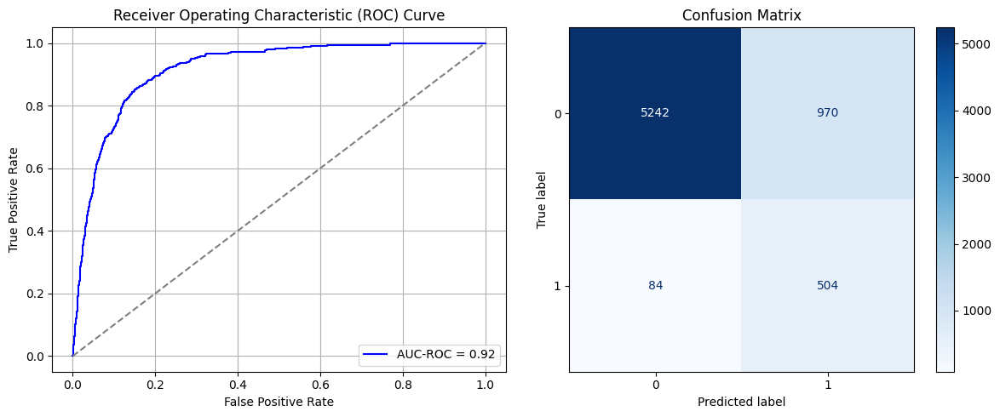

Best threshold based on F1-score: 0.9956238865852356
False Negative Rate: 0.14285714285714285
Time elapsed (performance): 0.8333207030000267
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6768 - loss: 0.6526 - val_AUC: 0.7623 - val_loss: 0.5902
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7850 - loss: 0.5656 - val_AUC: 0.8439 - val_loss: 0.5079
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8464 - loss: 0.4957 - val_AUC: 0.8633 - val_loss: 0.4780
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8712 - loss: 0.4558 - val_AUC: 0.8690 - val_loss: 0.4585
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8728 - loss: 0.4494 - val_AUC: 0.8718 - val_loss: 0.4510
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8716 - loss: 0.4489 - val_AUC: 0.8741 - val_loss: 0.4454
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8823 - loss: 0.4322 - val_AUC: 0.8763 - val_loss: 0.4435
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8833 - loss: 0.4319 - val_AUC: 0.8761 - val_loss: 0.4411
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8827 -

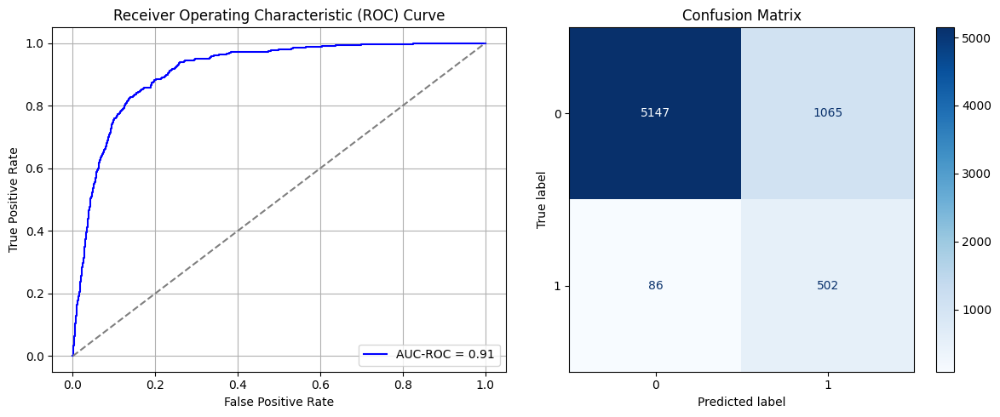

Best threshold based on F1-score: 0.7301133275032043
False Negative Rate: 0.14625850340136054
Time elapsed (performance): 1.0405274609997832
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6512 - loss: 0.6588 - val_AUC: 0.7436 - val_loss: 0.6074
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7726 - loss: 0.5772 - val_AUC: 0.8270 - val_loss: 0.5333
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8426 - loss: 0.5027 - val_AUC: 0.8631 - val_loss: 0.4735
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8714 - loss: 0.4581 - val_AUC: 0.8717 - val_loss: 0.4627
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8774 - loss: 0.4462 - val_AUC: 0.8755 - val_loss: 0.4513
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8814 - loss: 0.4363 - val_AUC: 0.8765 - val_loss: 0.4661
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8816 - loss: 0.4374 - val_AUC: 0.8757 - val_loss: 0.4569
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8841 - loss: 0.4316 - val_AUC: 0.8794 - val_loss: 0.4464
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8812 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9188546635653618
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.86      0.92      6212
           1       0.37      0.84      0.51       588

    accuracy                           0.86      6800
   macro avg       0.68      0.85      0.72      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.13618802318094012 TPR: 0.8367346938775511 FNR: 0.16326530612244897 TNR: 0.8638119768190599


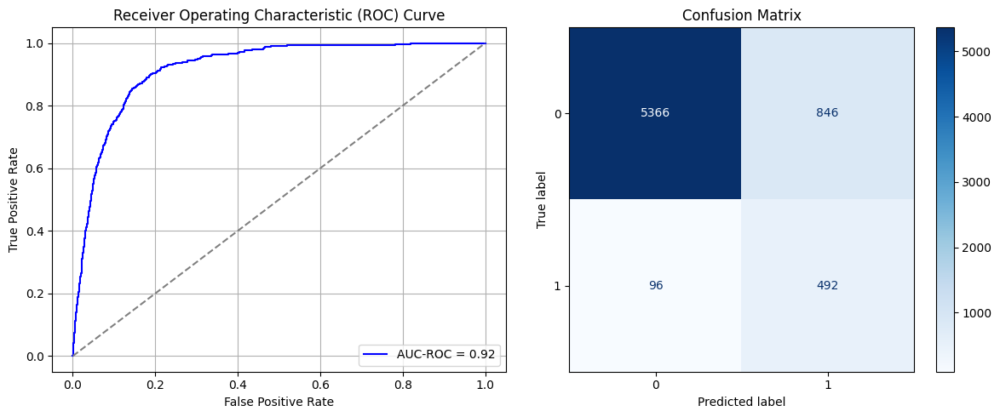

Best threshold based on F1-score: 0.7048047184944153
False Negative Rate: 0.16326530612244897
Time elapsed (performance): 0.8503365619999386
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6264 - loss: 0.6691 - val_AUC: 0.7566 - val_loss: 0.5945
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7597 - loss: 0.5854 - val_AUC: 0.8353 - val_loss: 0.5193
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8358 - loss: 0.5106 - val_AUC: 0.8691 - val_loss: 0.4661
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8662 - loss: 0.4630 - val_AUC: 0.8753 - val_loss: 0.4463
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8686 - loss: 0.4558 - val_AUC: 0.8773 - val_loss: 0.4411
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8752 - loss: 0.4453 - val_AUC: 0.8790 - val_loss: 0.4385
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8786 - loss: 0.4389 - val_AUC: 0.8792 - val_loss: 0.4463
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8838 - loss: 0.4296 - val_AUC: 0.8784 - val_loss: 0.4358
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8816 -

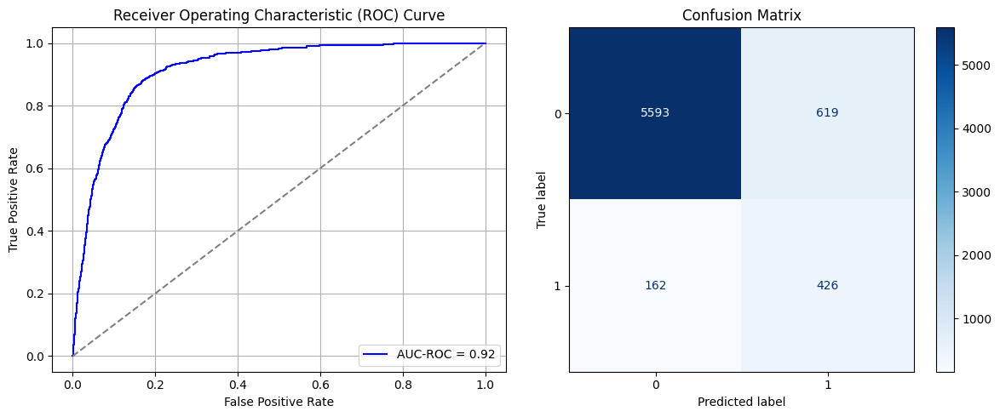

Best threshold based on F1-score: 0.5836461782455444
False Negative Rate: 0.2755102040816326
Time elapsed (performance): 0.8693002680001882
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6631 - loss: 0.6521 - val_AUC: 0.7761 - val_loss: 0.5796
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7798 - loss: 0.5704 - val_AUC: 0.8432 - val_loss: 0.5066
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8471 - loss: 0.4934 - val_AUC: 0.8691 - val_loss: 0.4655
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8665 - loss: 0.4618 - val_AUC: 0.8781 - val_loss: 0.4490
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8768 - loss: 0.4451 - val_AUC: 0.8758 - val_loss: 0.4691
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8672 - loss: 0.4601 - val_AUC: 0.8775 - val_loss: 0.4525
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8873 - loss: 0.4285 - val_AUC: 0.8820 - val_loss: 0.4391
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8775 - loss: 0.4404 - val_AUC: 0.8825 - val_loss: 0.4406
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8883 -

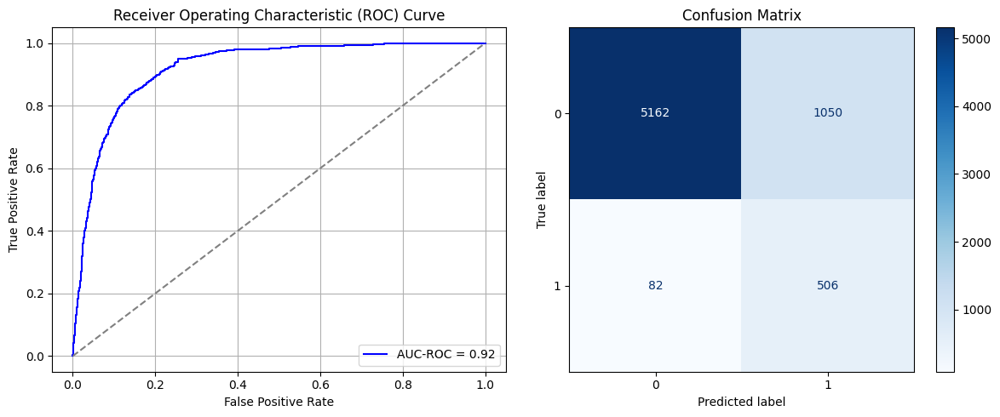

Best threshold based on F1-score: 0.7492382526397705
False Negative Rate: 0.13945578231292516
Time elapsed (performance): 1.0723686830001498
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6162 - loss: 0.6722 - val_AUC: 0.7607 - val_loss: 0.5930
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7781 - loss: 0.5739 - val_AUC: 0.8427 - val_loss: 0.5091
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8551 - loss: 0.4868 - val_AUC: 0.8688 - val_loss: 0.4670
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8685 - loss: 0.4607 - val_AUC: 0.8742 - val_loss: 0.4554
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8695 - loss: 0.4621 - val_AUC: 0.8751 - val_loss: 0.4577
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8661 - loss: 0.4637 - val_AUC: 0.8745 - val_loss: 0.4735
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8733 - loss: 0.4508 - val_AUC: 0.8784 - val_loss: 0.4420
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8796 - loss: 0.4402 - val_AUC: 0.8807 - val_loss: 0.4399
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8811 -

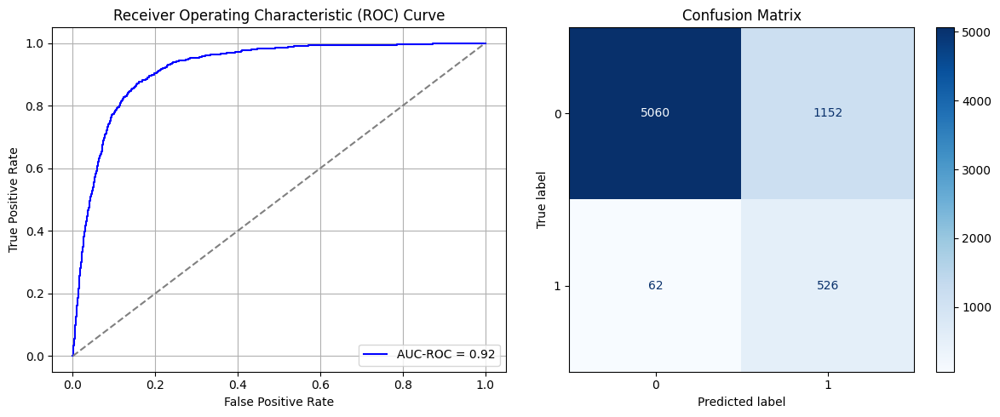

Best threshold based on F1-score: 0.9966598749160767
False Negative Rate: 0.1054421768707483
Time elapsed (performance): 1.0719198400001915
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6588 - loss: 0.6562 - val_AUC: 0.7798 - val_loss: 0.5791
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7976 - loss: 0.5537 - val_AUC: 0.8480 - val_loss: 0.4977
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8608 - loss: 0.4766 - val_AUC: 0.8701 - val_loss: 0.4737
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8743 - loss: 0.4513 - val_AUC: 0.8761 - val_loss: 0.4442
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8843 - loss: 0.4328 - val_AUC: 0.8771 - val_loss: 0.4428
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8835 - loss: 0.4298 - val_AUC: 0.8769 - val_loss: 0.4392
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8850 - loss: 0.4269 - val_AUC: 0.8757 - val_loss: 0.4438
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8824 - loss: 0.4315 - val_AUC: 0.8789 - val_loss: 0.4352
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8868 -

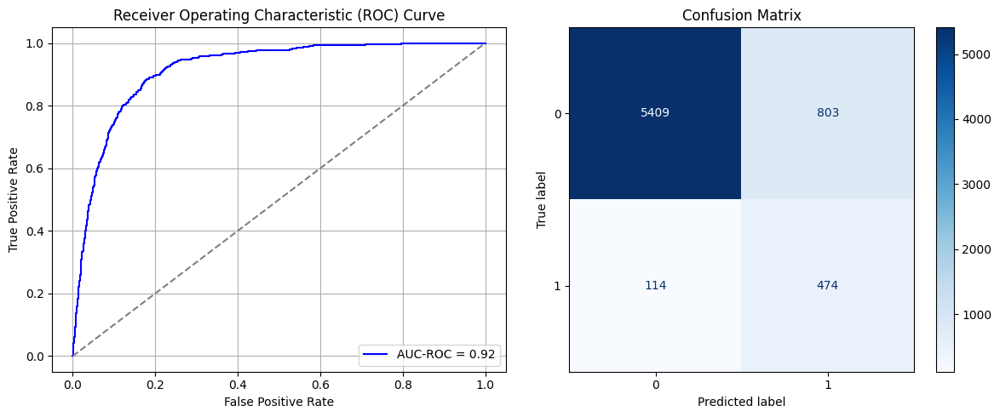

Best threshold based on F1-score: 0.9969893097877502
False Negative Rate: 0.19387755102040816
Time elapsed (performance): 1.0479162950005048
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6626 - loss: 0.6525 - val_AUC: 0.7818 - val_loss: 0.5704
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7906 - loss: 0.5574 - val_AUC: 0.8500 - val_loss: 0.4972
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8535 - loss: 0.4912 - val_AUC: 0.8751 - val_loss: 0.4606
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8733 - loss: 0.4545 - val_AUC: 0.8738 - val_loss: 0.4488
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8864 - loss: 0.4308 - val_AUC: 0.8804 - val_loss: 0.4415
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8844 - loss: 0.4323 - val_AUC: 0.8819 - val_loss: 0.4363
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8854 - loss: 0.4305 - val_AUC: 0.8838 - val_loss: 0.4446
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8868 - loss: 0.4288 - val_AUC: 0.8835 - val_loss: 0.4309
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8881 -

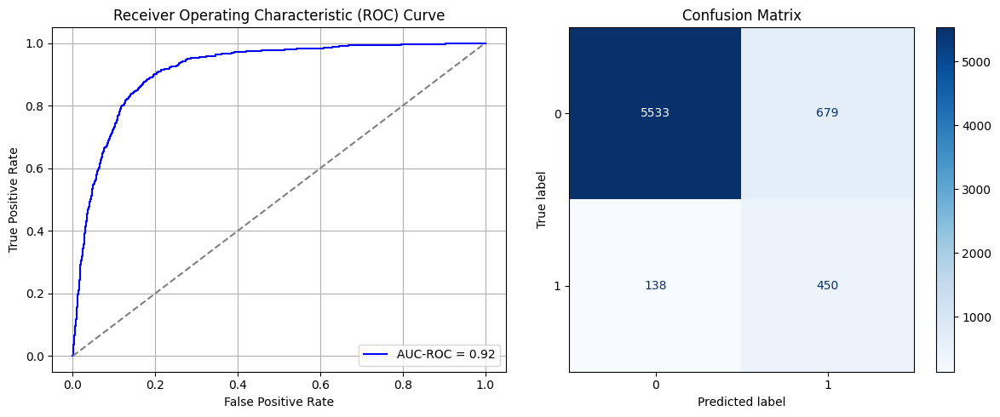

Best threshold based on F1-score: 0.9965728521347046
False Negative Rate: 0.23469387755102042
Time elapsed (performance): 1.2026895099998
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6619 - loss: 0.6559 - val_AUC: 0.7727 - val_loss: 0.5810
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7911 - loss: 0.5591 - val_AUC: 0.8516 - val_loss: 0.4978
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8648 - loss: 0.4765 - val_AUC: 0.8705 - val_loss: 0.4612
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8737 - loss: 0.4522 - val_AUC: 0.8748 - val_loss: 0.4595
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8743 - loss: 0.4536 - val_AUC: 0.8773 - val_loss: 0.4551
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8769 - loss: 0.4454 - val_AUC: 0.8788 - val_loss: 0.4442
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8782 - loss: 0.4436 - val_AUC: 0.8788 - val_loss: 0.4423
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8885 - loss: 0.4244 - val_AUC: 0.8795 - val_loss: 0.4429
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8862 -

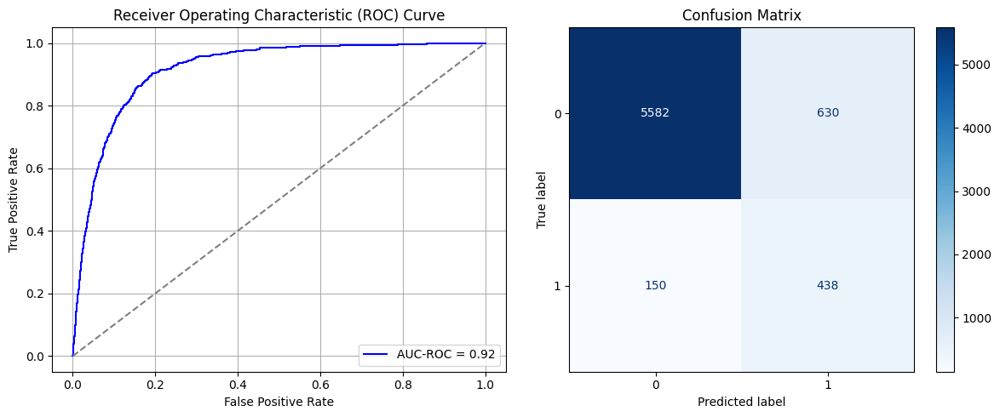

Best threshold based on F1-score: 0.9993858933448792
False Negative Rate: 0.25510204081632654
Time elapsed (performance): 1.0688672520000182
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 6s 26ms/step - AUC: 0.6257 - loss: 0.6658 - val_AUC: 0.7790 - val_loss: 0.5780
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7906 - loss: 0.5617 - val_AUC: 0.8595 - val_loss: 0.5057
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8510 - loss: 0.4898 - val_AUC: 0.8757 - val_loss: 0.4618
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8742 - loss: 0.4530 - val_AUC: 0.8801 - val_loss: 0.4452
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8754 - loss: 0.4467 - val_AUC: 0.8801 - val_loss: 0.4430
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8703 - loss: 0.4550 - val_AUC: 0.8804 - val_loss: 0.4546
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8804 - loss: 0.4367 - val_AUC: 0.8805 - val_loss: 0.4373
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8864 - loss: 0.4264 - val_AUC: 0.8805 - val_loss: 0.4352
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8887 

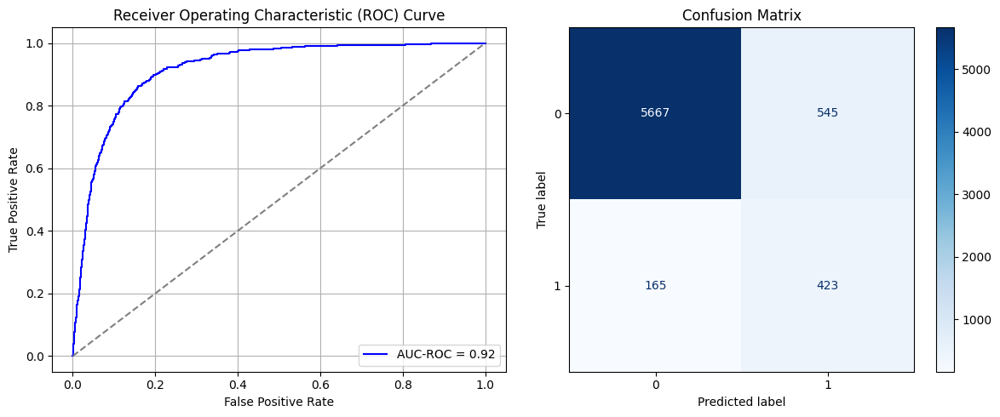

Best threshold based on F1-score: 0.9993093609809875
False Negative Rate: 0.28061224489795916
Time elapsed (performance): 0.910072191000836
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6707 - loss: 0.6549 - val_AUC: 0.7754 - val_loss: 0.5775
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7946 - loss: 0.5601 - val_AUC: 0.8607 - val_loss: 0.5009
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8521 - loss: 0.4956 - val_AUC: 0.8766 - val_loss: 0.4517
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8632 - loss: 0.4708 - val_AUC: 0.8856 - val_loss: 0.4387
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8721 - loss: 0.4527 - val_AUC: 0.8865 - val_loss: 0.4300
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8803 - loss: 0.4395 - val_AUC: 0.8882 - val_loss: 0.4258
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8853 - loss: 0.4288 - val_AUC: 0.8886 - val_loss: 0.4325
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8792 - loss: 0.4391 - val_AUC: 0.8889 - val_loss: 0.4278
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8755 -

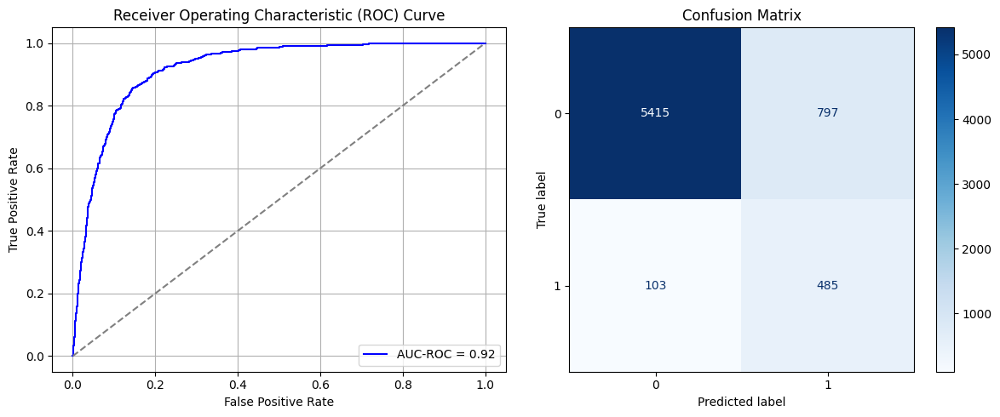

Best threshold based on F1-score: 0.9859245419502258
False Negative Rate: 0.17517006802721088
Time elapsed (performance): 0.9036991980001403
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6396 - loss: 0.6620 - val_AUC: 0.7826 - val_loss: 0.5736
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7862 - loss: 0.5671 - val_AUC: 0.8639 - val_loss: 0.4884
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8448 - loss: 0.5008 - val_AUC: 0.8783 - val_loss: 0.4621
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8700 - loss: 0.4616 - val_AUC: 0.8883 - val_loss: 0.4369
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8783 - loss: 0.4450 - val_AUC: 0.8906 - val_loss: 0.4295
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8689 - loss: 0.4594 - val_AUC: 0.8887 - val_loss: 0.4319
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8762 - loss: 0.4460 - val_AUC: 0.8913 - val_loss: 0.4314
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8814 - loss: 0.4347 - val_AUC: 0.8916 - val_loss: 0.4313
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8837 -

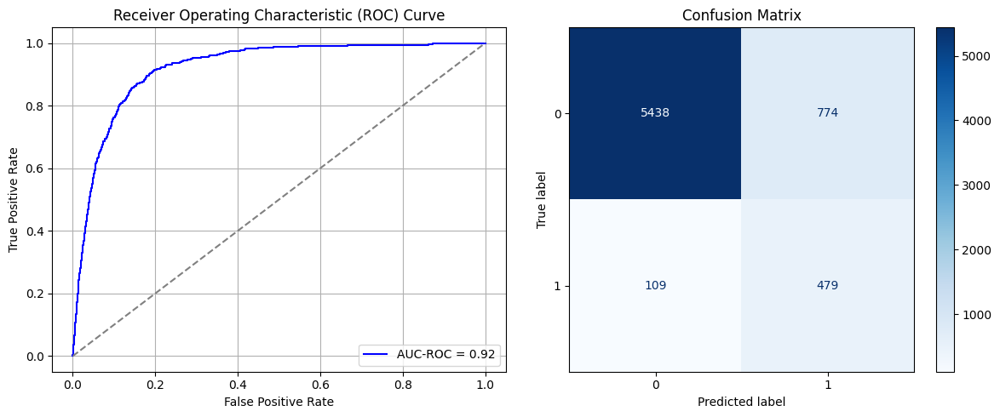

Best threshold based on F1-score: 0.7101573944091797
False Negative Rate: 0.18537414965986396
Time elapsed (performance): 0.9235894169996754
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6264 - loss: 0.6665 - val_AUC: 0.7857 - val_loss: 0.5711
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8019 - loss: 0.5512 - val_AUC: 0.8588 - val_loss: 0.4919
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8615 - loss: 0.4766 - val_AUC: 0.8772 - val_loss: 0.4575
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8788 - loss: 0.4438 - val_AUC: 0.8834 - val_loss: 0.4383
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8903 - loss: 0.4229 - val_AUC: 0.8838 - val_loss: 0.4409
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8886 - loss: 0.4250 - val_AUC: 0.8844 - val_loss: 0.4333
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8892 - loss: 0.4218 - val_AUC: 0.8851 - val_loss: 0.4288
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8900 - loss: 0.4190 - val_AUC: 0.8860 - val_loss: 0.4325
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8890 -

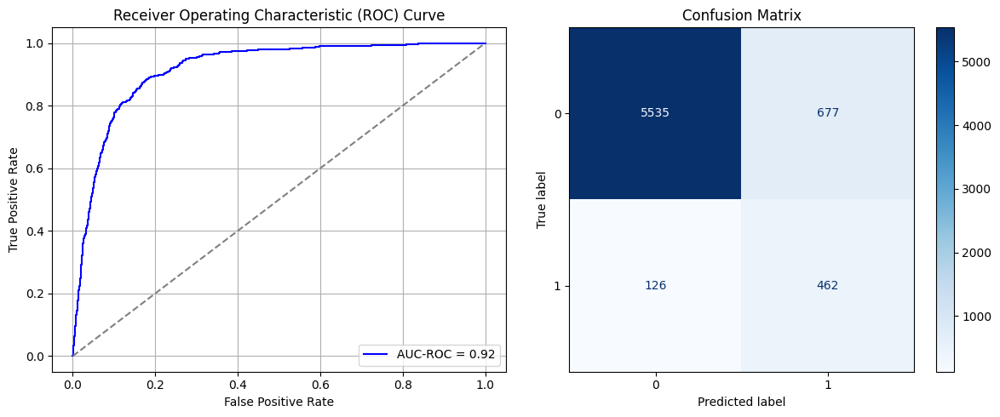

Best threshold based on F1-score: 0.9989480972290039
False Negative Rate: 0.21428571428571427
Time elapsed (performance): 1.3741452179992848
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6230 - loss: 0.6690 - val_AUC: 0.7520 - val_loss: 0.5982
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7829 - loss: 0.5707 - val_AUC: 0.8407 - val_loss: 0.5192
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8468 - loss: 0.4979 - val_AUC: 0.8651 - val_loss: 0.4743
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8765 - loss: 0.4496 - val_AUC: 0.8788 - val_loss: 0.4533
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8778 - loss: 0.4464 - val_AUC: 0.8798 - val_loss: 0.4512
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8793 - loss: 0.4433 - val_AUC: 0.8797 - val_loss: 0.4453
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8861 - loss: 0.4329 - val_AUC: 0.8834 - val_loss: 0.4393
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8801 - loss: 0.4414 - val_AUC: 0.8839 - val_loss: 0.4390
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8840 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9126350797885155
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.37      0.79      0.51       588

    accuracy                           0.87      6800
   macro avg       0.67      0.83      0.71      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.12717321313586608 TPR: 0.7925170068027211 FNR: 0.20748299319727892 TNR: 0.872826786864134


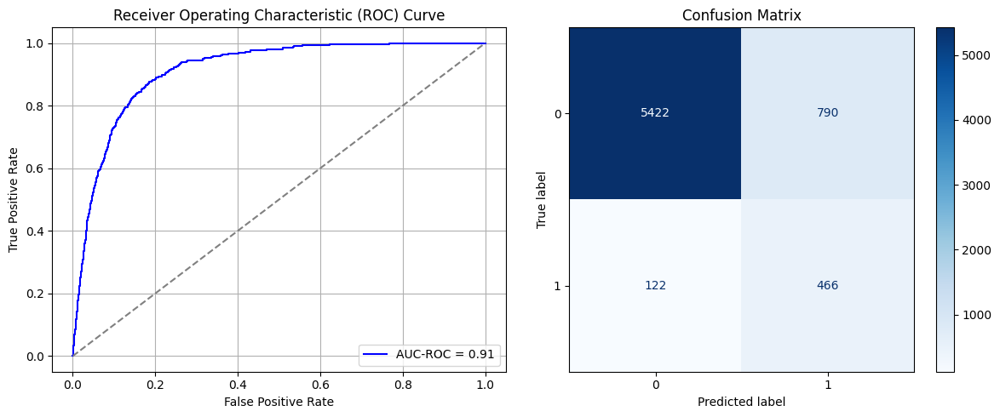

Best threshold based on F1-score: 0.9996322989463806
False Negative Rate: 0.20748299319727892
Time elapsed (performance): 1.0925419369996234
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6585 - loss: 0.6555 - val_AUC: 0.7756 - val_loss: 0.5780
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7898 - loss: 0.5620 - val_AUC: 0.8579 - val_loss: 0.4996
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8552 - loss: 0.4843 - val_AUC: 0.8778 - val_loss: 0.4587
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8604 - loss: 0.4708 - val_AUC: 0.8835 - val_loss: 0.4461
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8745 - loss: 0.4475 - val_AUC: 0.8869 - val_loss: 0.4360
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8809 - loss: 0.4353 - val_AUC: 0.8882 - val_loss: 0.4354
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8930 - loss: 0.4149 - val_AUC: 0.8852 - val_loss: 0.4536
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8918 - loss: 0.4170 - val_AUC: 0.8880 - val_loss: 0.4273
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8892 -

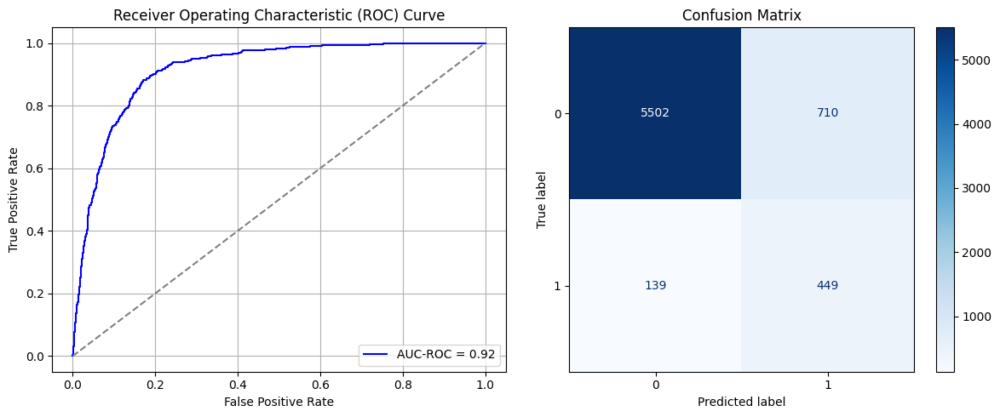

Best threshold based on F1-score: 0.5698277950286865
False Negative Rate: 0.23639455782312926
Time elapsed (performance): 0.9525866329995551
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6205 - loss: 0.6679 - val_AUC: 0.7566 - val_loss: 0.5969
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7762 - loss: 0.5756 - val_AUC: 0.8569 - val_loss: 0.4992
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8449 - loss: 0.5016 - val_AUC: 0.8782 - val_loss: 0.4543
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8662 - loss: 0.4656 - val_AUC: 0.8826 - val_loss: 0.4431
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8634 - loss: 0.4645 - val_AUC: 0.8818 - val_loss: 0.4360
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8712 - loss: 0.4542 - val_AUC: 0.8843 - val_loss: 0.4338
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8815 - loss: 0.4350 - val_AUC: 0.8834 - val_loss: 0.4334
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8839 - loss: 0.4310 - val_AUC: 0.8864 - val_loss: 0.4298
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8765 -

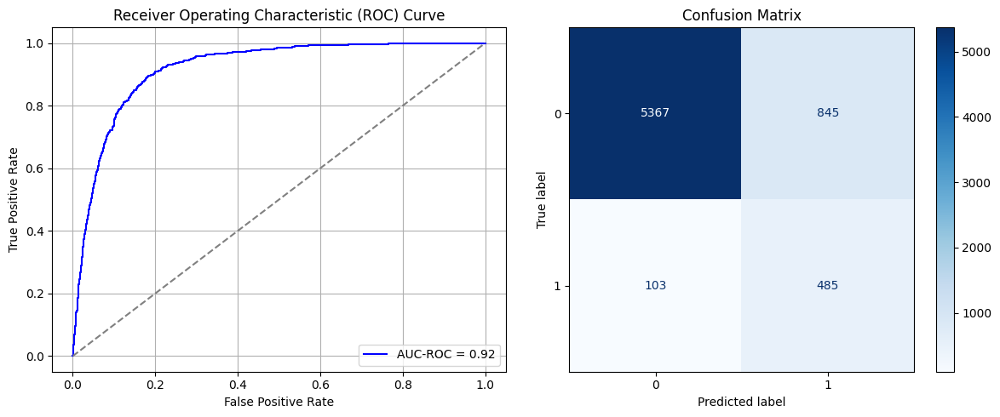

Best threshold based on F1-score: 0.9968245625495911
False Negative Rate: 0.17517006802721088
Time elapsed (performance): 1.0697113910000553
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6940 - loss: 0.6460 - val_AUC: 0.7901 - val_loss: 0.5767
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8004 - loss: 0.5559 - val_AUC: 0.8638 - val_loss: 0.4986
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8523 - loss: 0.4922 - val_AUC: 0.8801 - val_loss: 0.4417
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8758 - loss: 0.4474 - val_AUC: 0.8876 - val_loss: 0.4312
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8714 - loss: 0.4518 - val_AUC: 0.8883 - val_loss: 0.4259
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8802 - loss: 0.4380 - val_AUC: 0.8897 - val_loss: 0.4240
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8779 - loss: 0.4405 - val_AUC: 0.8905 - val_loss: 0.4191
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8770 - loss: 0.4394 - val_AUC: 0.8904 - val_loss: 0.4172
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8888 -

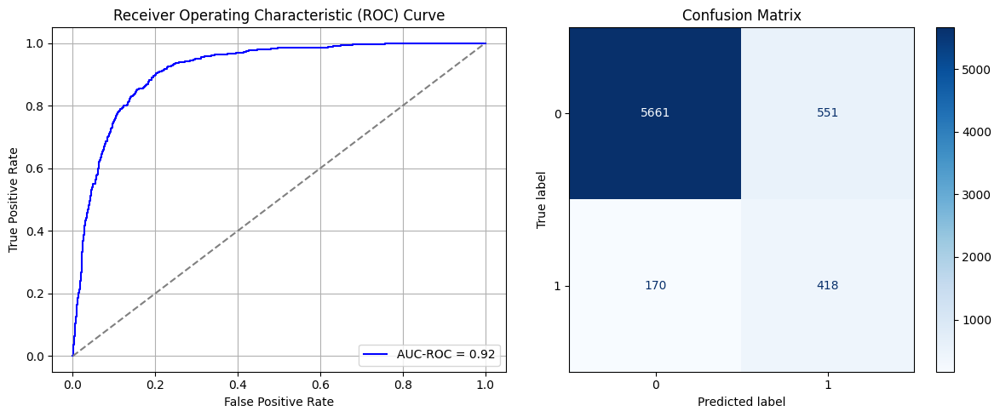

Best threshold based on F1-score: 0.9969433546066284
False Negative Rate: 0.2891156462585034
Time elapsed (performance): 1.075936554000691
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6746 - loss: 0.6572 - val_AUC: 0.7714 - val_loss: 0.5854
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7747 - loss: 0.5733 - val_AUC: 0.8437 - val_loss: 0.5253
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8422 - loss: 0.5041 - val_AUC: 0.8689 - val_loss: 0.4666
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8654 - loss: 0.4643 - val_AUC: 0.8716 - val_loss: 0.4575
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8723 - loss: 0.4509 - val_AUC: 0.8729 - val_loss: 0.4595
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8809 - loss: 0.4372 - val_AUC: 0.8738 - val_loss: 0.4508
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8753 - loss: 0.4450 - val_AUC: 0.8735 - val_loss: 0.4488
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8832 - loss: 0.4307 - val_AUC: 0.8750 - val_loss: 0.4492
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8841 -

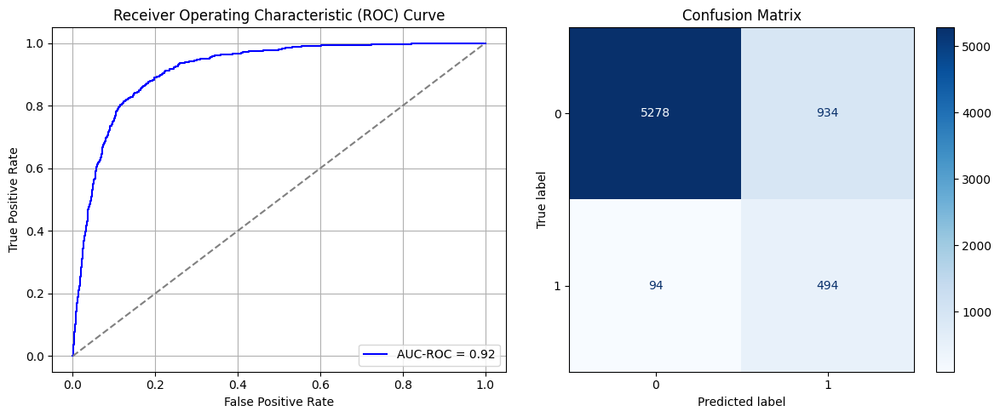

Best threshold based on F1-score: 0.9951578378677368
False Negative Rate: 0.1598639455782313
Time elapsed (performance): 1.0764119630002824
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6605 - loss: 0.6553 - val_AUC: 0.7730 - val_loss: 0.5980
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7706 - loss: 0.5801 - val_AUC: 0.8561 - val_loss: 0.4973
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8366 - loss: 0.5111 - val_AUC: 0.8862 - val_loss: 0.4420
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8773 - loss: 0.4469 - val_AUC: 0.8939 - val_loss: 0.4247
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8797 - loss: 0.4399 - val_AUC: 0.8945 - val_loss: 0.4152
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8810 - loss: 0.4350 - val_AUC: 0.8964 - val_loss: 0.4128
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8778 - loss: 0.4399 - val_AUC: 0.8948 - val_loss: 0.4109
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8852 - loss: 0.4246 - val_AUC: 0.8968 - val_loss: 0.4073
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8900 -

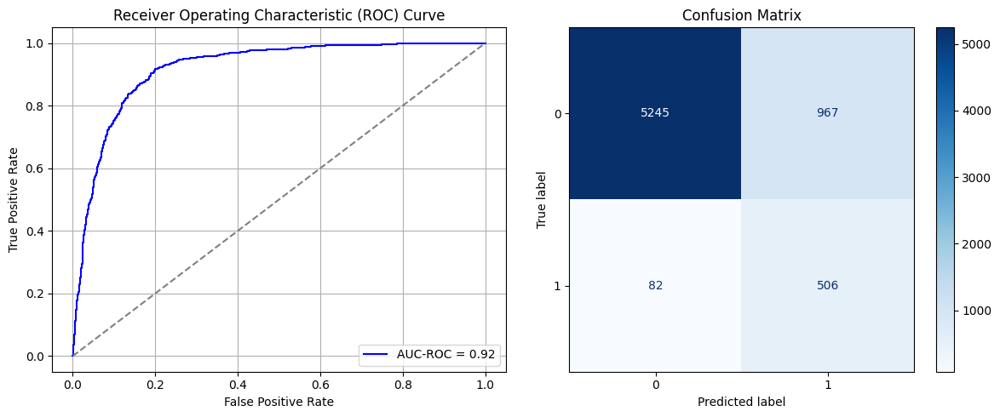

Best threshold based on F1-score: 0.6890967488288879
False Negative Rate: 0.13945578231292516
Time elapsed (performance): 1.0845124469997245
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6731 - loss: 0.6518 - val_AUC: 0.8054 - val_loss: 0.5594
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8065 - loss: 0.5443 - val_AUC: 0.8690 - val_loss: 0.4764
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8696 - loss: 0.4638 - val_AUC: 0.8805 - val_loss: 0.4596
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8834 - loss: 0.4359 - val_AUC: 0.8833 - val_loss: 0.4382
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8832 - loss: 0.4351 - val_AUC: 0.8860 - val_loss: 0.4534
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8876 - loss: 0.4247 - val_AUC: 0.8830 - val_loss: 0.4625
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8904 - loss: 0.4210 - val_AUC: 0.8843 - val_loss: 0.4345
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8967 - loss: 0.4094 - val_AUC: 0.8864 - val_loss: 0.4269
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8937 -

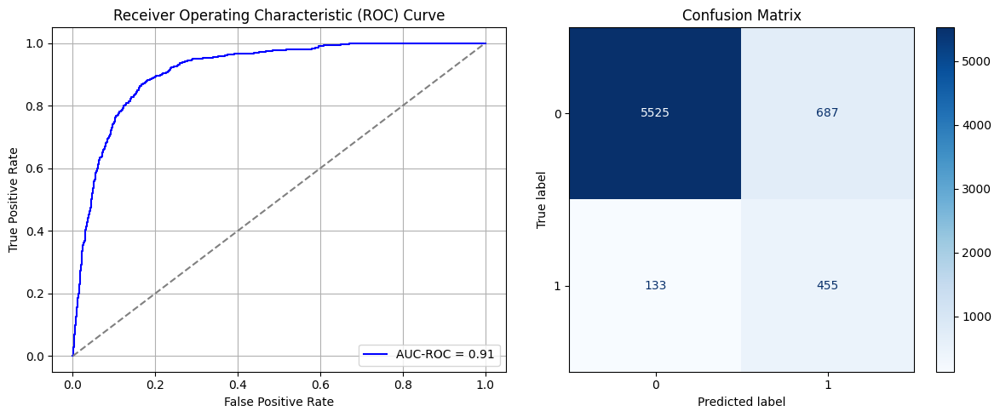

Best threshold based on F1-score: 0.9961795806884766
False Negative Rate: 0.2261904761904762
Time elapsed (performance): 0.9213868529996034
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6424 - loss: 0.6617 - val_AUC: 0.7525 - val_loss: 0.5955
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7837 - loss: 0.5671 - val_AUC: 0.8580 - val_loss: 0.5154
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8607 - loss: 0.4820 - val_AUC: 0.8725 - val_loss: 0.4586
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8745 - loss: 0.4516 - val_AUC: 0.8775 - val_loss: 0.4526
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8757 - loss: 0.4457 - val_AUC: 0.8761 - val_loss: 0.4544
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8802 - loss: 0.4382 - val_AUC: 0.8782 - val_loss: 0.4425
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8858 - loss: 0.4292 - val_AUC: 0.8791 - val_loss: 0.4397
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8800 - loss: 0.4406 - val_AUC: 0.8804 - val_loss: 0.4386
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8768 -

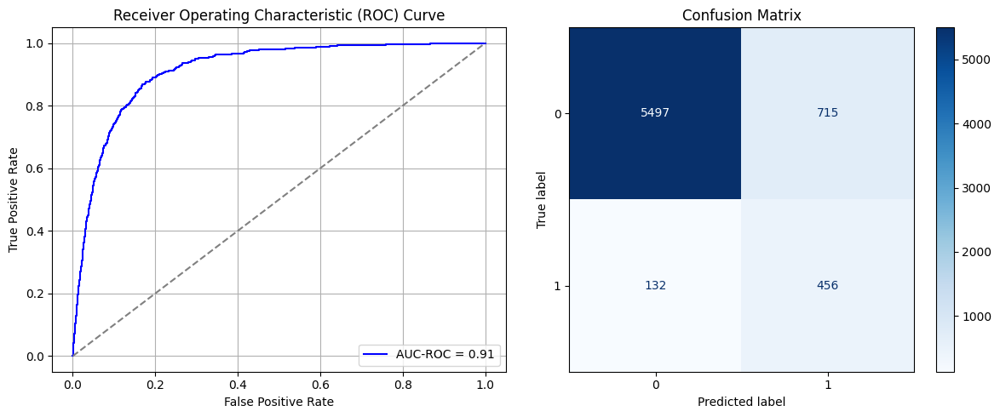

Best threshold based on F1-score: 0.9973429441452026
False Negative Rate: 0.22448979591836735
Time elapsed (performance): 1.202562145000229
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6666 - loss: 0.6529 - val_AUC: 0.7877 - val_loss: 0.5810
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7951 - loss: 0.5600 - val_AUC: 0.8678 - val_loss: 0.4877
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8574 - loss: 0.4828 - val_AUC: 0.8795 - val_loss: 0.4482
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8678 - loss: 0.4636 - val_AUC: 0.8846 - val_loss: 0.4515
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8805 - loss: 0.4397 - val_AUC: 0.8853 - val_loss: 0.4511
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8749 - loss: 0.4453 - val_AUC: 0.8863 - val_loss: 0.4343
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8859 - loss: 0.4294 - val_AUC: 0.8882 - val_loss: 0.4284
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8860 - loss: 0.4257 - val_AUC: 0.8896 - val_loss: 0.4236
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8817 -

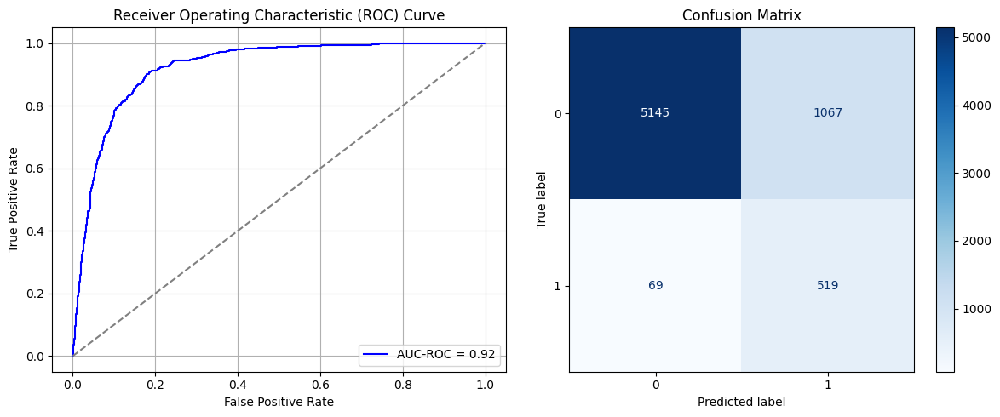

Best threshold based on F1-score: 0.6899352669715881
False Negative Rate: 0.11734693877551021
Time elapsed (performance): 1.325377756999842
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6305 - loss: 0.6670 - val_AUC: 0.7703 - val_loss: 0.5831
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7762 - loss: 0.5753 - val_AUC: 0.8505 - val_loss: 0.5111
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8319 - loss: 0.5170 - val_AUC: 0.8728 - val_loss: 0.4683
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8619 - loss: 0.4764 - val_AUC: 0.8782 - val_loss: 0.4505
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8776 - loss: 0.4492 - val_AUC: 0.8815 - val_loss: 0.4529
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8783 - loss: 0.4445 - val_AUC: 0.8807 - val_loss: 0.4394
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8800 - loss: 0.4393 - val_AUC: 0.8817 - val_loss: 0.4466
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8782 - loss: 0.4423 - val_AUC: 0.8796 - val_loss: 0.4628
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8821 -

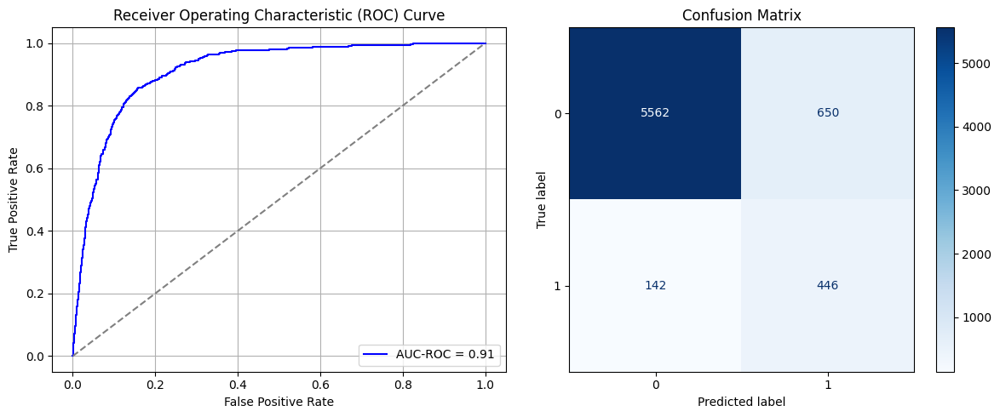

Best threshold based on F1-score: 0.9934703707695007
False Negative Rate: 0.24149659863945577
Time elapsed (performance): 1.0848571520000405
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6803 - loss: 0.6455 - val_AUC: 0.8015 - val_loss: 0.5600
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8035 - loss: 0.5512 - val_AUC: 0.8650 - val_loss: 0.4891
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8605 - loss: 0.4798 - val_AUC: 0.8773 - val_loss: 0.4565
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8730 - loss: 0.4529 - val_AUC: 0.8749 - val_loss: 0.4566
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8699 - loss: 0.4569 - val_AUC: 0.8786 - val_loss: 0.4512
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8781 - loss: 0.4435 - val_AUC: 0.8816 - val_loss: 0.4466
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8789 - loss: 0.4401 - val_AUC: 0.8787 - val_loss: 0.4466
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8866 - loss: 0.4264 - val_AUC: 0.8804 - val_loss: 0.4442
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8882 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9143463003359749
Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.92      0.94      6212
           1       0.44      0.65      0.52       588

    accuracy                           0.90      6800
   macro avg       0.70      0.78      0.73      6800
weighted avg       0.92      0.90      0.91      6800

FPR 0.07855763039278815 TPR: 0.6479591836734694 FNR: 0.3520408163265306 TNR: 0.9214423696072118


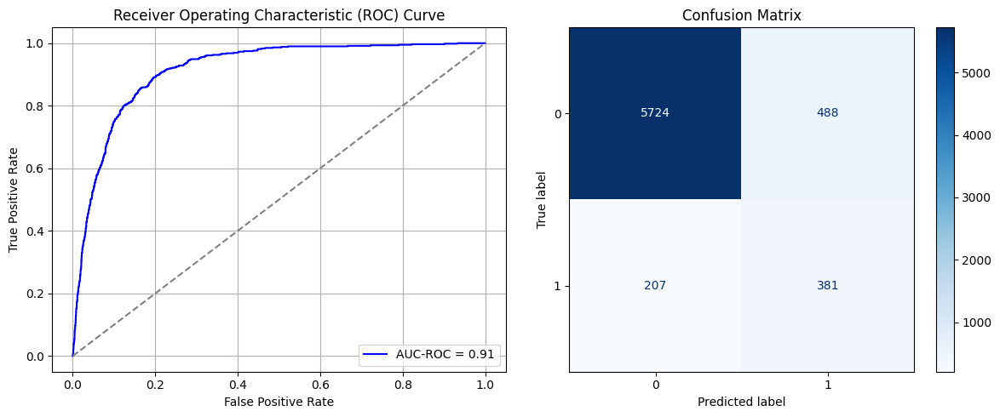

Best threshold based on F1-score: 0.9991673231124878
False Negative Rate: 0.3520408163265306
Time elapsed (performance): 1.0513578509999206
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6658 - loss: 0.6511 - val_AUC: 0.7714 - val_loss: 0.5832
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7854 - loss: 0.5614 - val_AUC: 0.8393 - val_loss: 0.5117
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8483 - loss: 0.4931 - val_AUC: 0.8670 - val_loss: 0.4627
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8635 - loss: 0.4665 - val_AUC: 0.8708 - val_loss: 0.4562
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8774 - loss: 0.4443 - val_AUC: 0.8755 - val_loss: 0.4449
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8856 - loss: 0.4288 - val_AUC: 0.8764 - val_loss: 0.4418
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8907 - loss: 0.4227 - val_AUC: 0.8770 - val_loss: 0.4433
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8862 - loss: 0.4257 - val_AUC: 0.8794 - val_loss: 0.4358
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8927 -

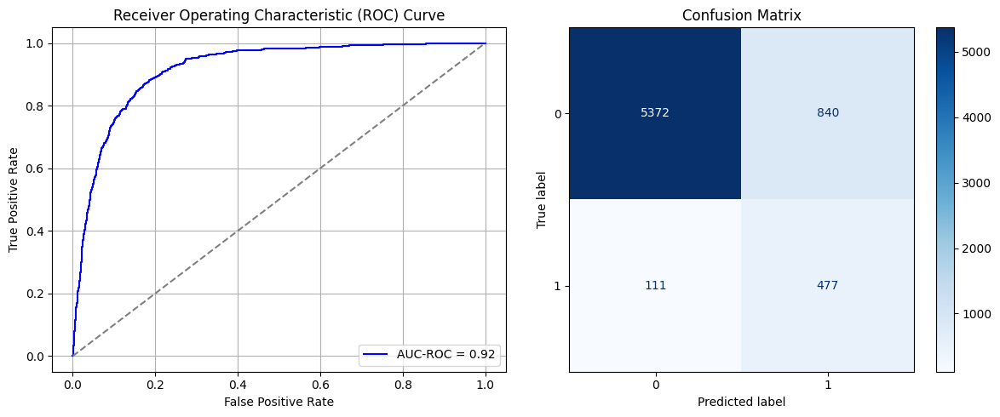

Best threshold based on F1-score: 0.6876296997070312
False Negative Rate: 0.18877551020408162
Time elapsed (performance): 0.9847588329994323
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6463 - loss: 0.6598 - val_AUC: 0.7818 - val_loss: 0.5747
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7773 - loss: 0.5725 - val_AUC: 0.8597 - val_loss: 0.4964
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8464 - loss: 0.4986 - val_AUC: 0.8741 - val_loss: 0.4610
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8665 - loss: 0.4646 - val_AUC: 0.8780 - val_loss: 0.4561
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8667 - loss: 0.4609 - val_AUC: 0.8781 - val_loss: 0.4485
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8645 - loss: 0.4631 - val_AUC: 0.8804 - val_loss: 0.4553
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8771 - loss: 0.4437 - val_AUC: 0.8810 - val_loss: 0.4397
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8739 - loss: 0.4466 - val_AUC: 0.8810 - val_loss: 0.4546
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8774 -

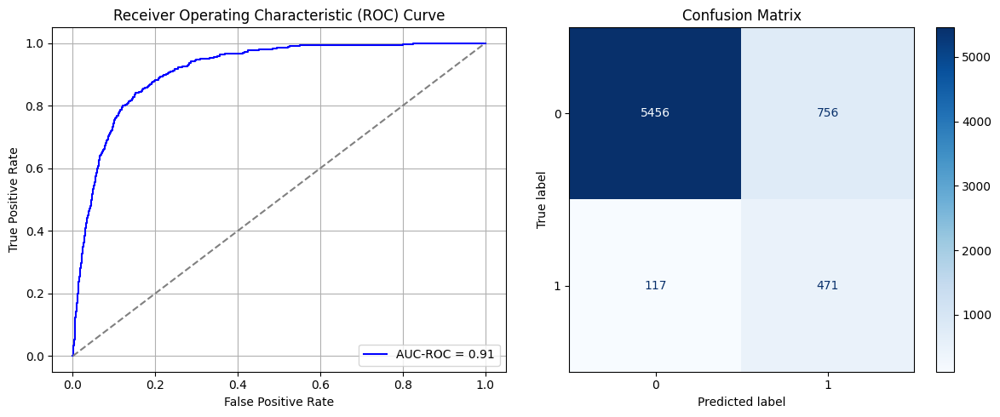

Best threshold based on F1-score: 0.6381537318229675
False Negative Rate: 0.1989795918367347
Time elapsed (performance): 0.9140830950000236
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6343 - loss: 0.6615 - val_AUC: 0.7708 - val_loss: 0.5844
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7876 - loss: 0.5641 - val_AUC: 0.8570 - val_loss: 0.4945
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8444 - loss: 0.5044 - val_AUC: 0.8770 - val_loss: 0.4512
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8693 - loss: 0.4658 - val_AUC: 0.8814 - val_loss: 0.4391
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8759 - loss: 0.4523 - val_AUC: 0.8850 - val_loss: 0.4375
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8740 - loss: 0.4534 - val_AUC: 0.8848 - val_loss: 0.4307
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8799 - loss: 0.4417 - val_AUC: 0.8839 - val_loss: 0.4294
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8812 - loss: 0.4361 - val_AUC: 0.8833 - val_loss: 0.4389
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8891 -

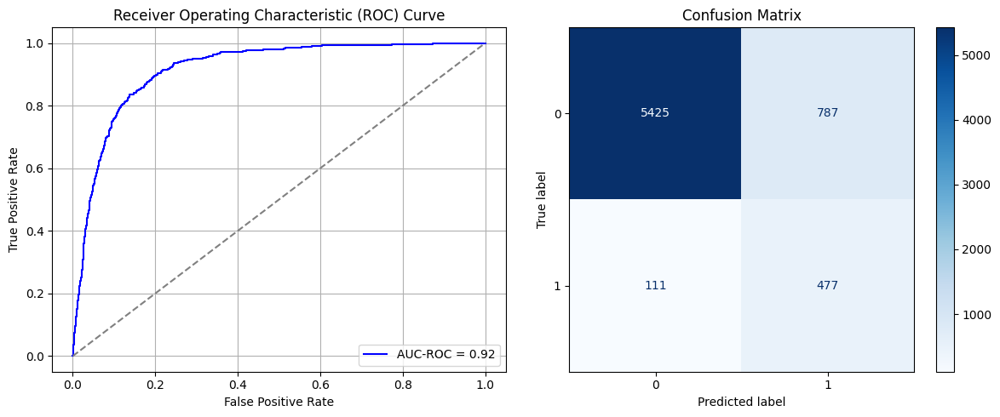

Best threshold based on F1-score: 0.9969630241394043
False Negative Rate: 0.18877551020408162
Time elapsed (performance): 0.9272692600006849


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


In [62]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    data_S_maj_rus = data_S_majority.sample(n=undersample_size, replace=True)
    data_S_SRSwR_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_SRSwR = data_S_SRSwR_RUS.iloc[:, :-1]
    y_S_SRSwR = data_S_SRSwR_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_SRSwR, y_S_SRSwR, test_size=0.20, random_state=0)
    model_SRSwR = create_dnn_model(X_S_train.shape[1])
    result_SRSwR = train_and_evaluate(model_SRSwR, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_SRSwR = Transductive_TL(model_SRSwR, X_T_full, y_T_full, "Target")

    Training_time.append(result_SRSwR)
    FPR.append(result_TL_SRSwR[0])
    TNR.append(result_TL_SRSwR[1])
    FNR.append(result_TL_SRSwR[2])
    TPR.append(result_TL_SRSwR[3])
    TL_time.append(result_TL_SRSwR[4])

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
# print(ParamFit)

In [63]:
print(ParamFit)
ParamFit.to_csv('SRSwR_RUS.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0      9.877794  0.121217  0.878783  0.202381  0.797619     0.765718
1      9.844381  0.121217  0.878783  0.198980  0.801020     0.761299
2      9.457096  0.131359  0.868641  0.178571  0.821429     0.759616
3      8.182196  0.124920  0.875080  0.190476  0.809524     5.179590
4     11.087582  0.111880  0.888120  0.219388  0.780612     1.059051
5     10.776249  0.140695  0.859305  0.171769  0.828231     0.792698
6     11.419041  0.106890  0.893110  0.226190  0.773810     1.076500
7     11.726464  0.159369  0.840631  0.134354  0.865646     0.786054
8     12.101202  0.142305  0.857695  0.175170  0.824830     0.816689
9     11.220874  0.135705  0.864295  0.171769  0.828231     0.799892
10    11.113264  0.171925  0.828075  0.129252  0.870748     0.817731
11     9.159059  0.127978  0.872022  0.183673  0.816327     1.118777
12    13.700235  0.155023  0.844977  0.146259  0.853741     0.822400
13    12.316243  0.102222  0.89777

In [64]:
ParamFit['FNR'].mean()

np.float64(0.19680272108843536)

In [65]:
ParamFit['Source time'].mean()

np.float64(12.918902565000026)

## Systematic Sampling:

First, we select a single systematic sample from the majority class, in which $k = \frac{N_0}{N_1}$, where $N_0$ is the majority class size in the source domain and $N_1$ is the minority class in the source domain.

7.209564628919468
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6931 - loss: 0.6534 - val_AUC: 0.7769 - val_loss: 0.5742
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8009 - loss: 0.5515 - val_AUC: 0.8586 - val_loss: 0.4851
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8678 - loss: 0.4713 - val_AUC: 0.8755 - val_loss: 0.4529
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8828 - loss: 0.4397 - val_AUC: 0.8777 - val_loss: 0.4475
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8851 - loss: 0.4342 - val_AUC: 0.8784 - val_loss: 0.4444
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8846 - loss: 0.4327 - val_AUC: 0.8796 - val_loss: 0.4487
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8919 - loss: 0.4214 - val_AUC: 0.8793 - val_loss: 0.4404
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8874 - loss: 0.4250 - val_AUC: 0.8797 - val_loss: 0.4410
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8856 -

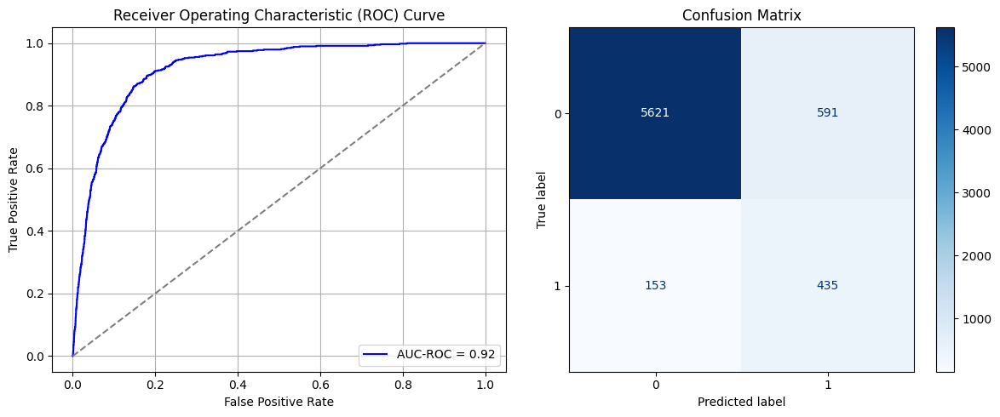

Best threshold based on F1-score: 0.9970194697380066
False Negative Rate: 0.2602040816326531
Time elapsed (performance): 0.7630974070007142
(np.float64(0.0951384417256922), np.float64(0.9048615582743078))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6716 - loss: 0.6516 - val_AUC: 0.7801 - val_loss: 0.5691
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8194 - loss: 0.5324 - val_AUC: 0.8491 - val_loss: 0.4924
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8606 - loss: 0.4778 - val_AUC: 0.8670 - val_loss: 0.4798
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8670 - loss: 0.4621 - val_AUC: 0.8698 - val_loss: 0.4597
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8757 - loss: 0.4469 - val_AUC: 0.8714 - val_loss: 0.4566
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8889 - loss: 0.4260 - val_AUC: 0.8724 - val_loss: 0.4518
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8780 - loss: 0.4415 - val_AUC: 0.8732 - val_loss: 0.4597
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8860 - loss: 0.4275 - val_AUC: 0.8723 - val_loss: 0.4513
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8846 -

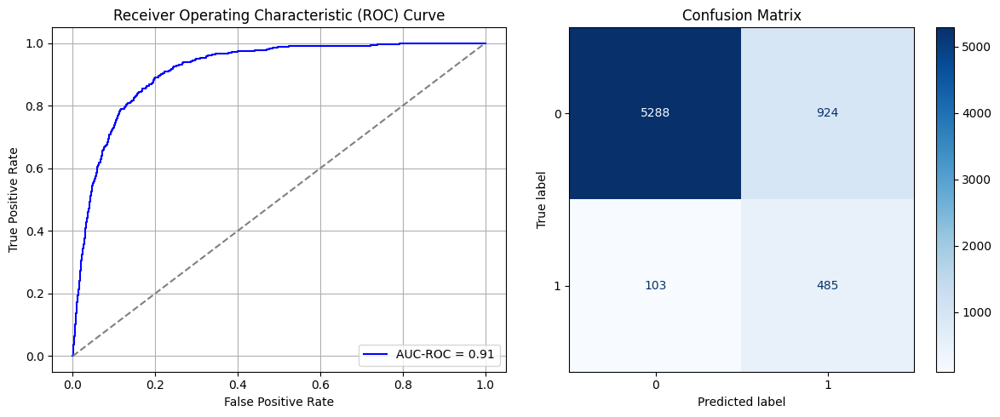

Best threshold based on F1-score: 0.6884526014328003
False Negative Rate: 0.17517006802721088
Time elapsed (performance): 0.7656360669998321
(np.float64(0.14874436574372182), np.float64(0.8512556342562781))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6835 - loss: 0.6458 - val_AUC: 0.7650 - val_loss: 0.5952
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7819 - loss: 0.5687 - val_AUC: 0.8421 - val_loss: 0.5067
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8547 - loss: 0.4893 - val_AUC: 0.8665 - val_loss: 0.4684
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8719 - loss: 0.4588 - val_AUC: 0.8732 - val_loss: 0.4549
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8702 - loss: 0.4578 - val_AUC: 0.8720 - val_loss: 0.4662
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8700 - loss: 0.4575 - val_AUC: 0.8767 - val_loss: 0.4521
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8807 - loss: 0.4387 - val_AUC: 0.8785 - val_loss: 0.4410
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8838 - loss: 0.4300 - val_AUC: 0.8771 - val_loss: 0.4492
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8891 -

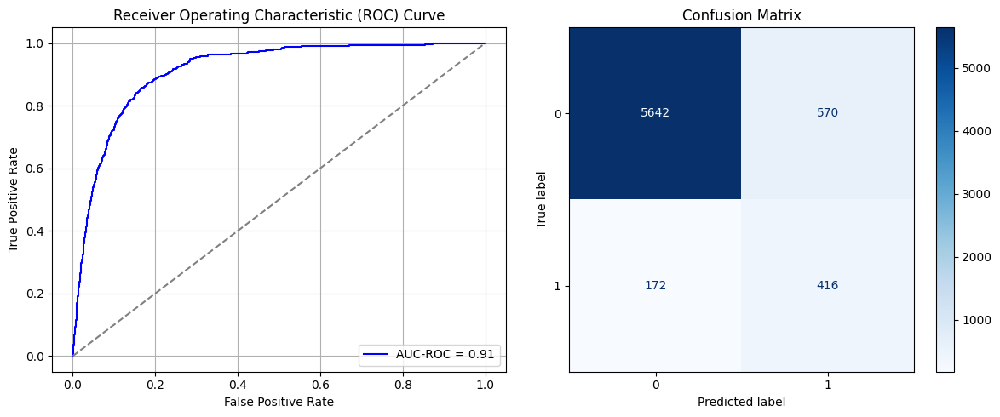

Best threshold based on F1-score: 0.9937626719474792
False Negative Rate: 0.2925170068027211
Time elapsed (performance): 0.7693240709995735
(np.float64(0.09175788795878943), np.float64(0.9082421120412105))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6804 - loss: 0.6543 - val_AUC: 0.7617 - val_loss: 0.5890
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7840 - loss: 0.5666 - val_AUC: 0.8451 - val_loss: 0.5031
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8522 - loss: 0.4938 - val_AUC: 0.8727 - val_loss: 0.4732
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8886 - loss: 0.4336 - val_AUC: 0.8760 - val_loss: 0.4467
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8803 - loss: 0.4412 - val_AUC: 0.8743 - val_loss: 0.4514
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8839 - loss: 0.4324 - val_AUC: 0.8772 - val_loss: 0.4456
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8908 - loss: 0.4193 - val_AUC: 0.8785 - val_loss: 0.4370
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8880 - loss: 0.4230 - val_AUC: 0.8785 - val_loss: 0.4363
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8944 -

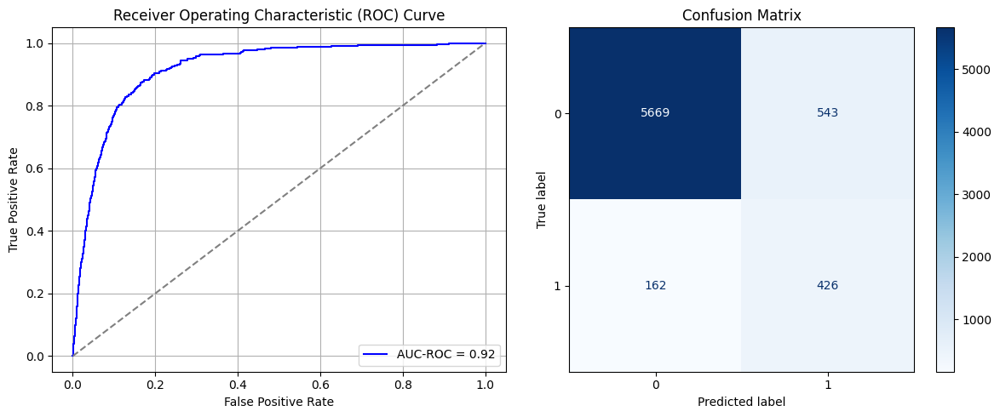

Best threshold based on F1-score: 0.9942380785942078
False Negative Rate: 0.2755102040816326
Time elapsed (performance): 1.116936700000224
(np.float64(0.08741146168705731), np.float64(0.9125885383129427))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6556 - loss: 0.6603 - val_AUC: 0.7710 - val_loss: 0.5834
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7938 - loss: 0.5577 - val_AUC: 0.8467 - val_loss: 0.5074
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8590 - loss: 0.4838 - val_AUC: 0.8755 - val_loss: 0.4543
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8808 - loss: 0.4415 - val_AUC: 0.8774 - val_loss: 0.4437
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8839 - loss: 0.4340 - val_AUC: 0.8800 - val_loss: 0.4389
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8833 - loss: 0.4330 - val_AUC: 0.8810 - val_loss: 0.4401
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8891 - loss: 0.4222 - val_AUC: 0.8814 - val_loss: 0.4346
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8899 - loss: 0.4199 - val_AUC: 0.8813 - val_loss: 0.4374
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8973 -

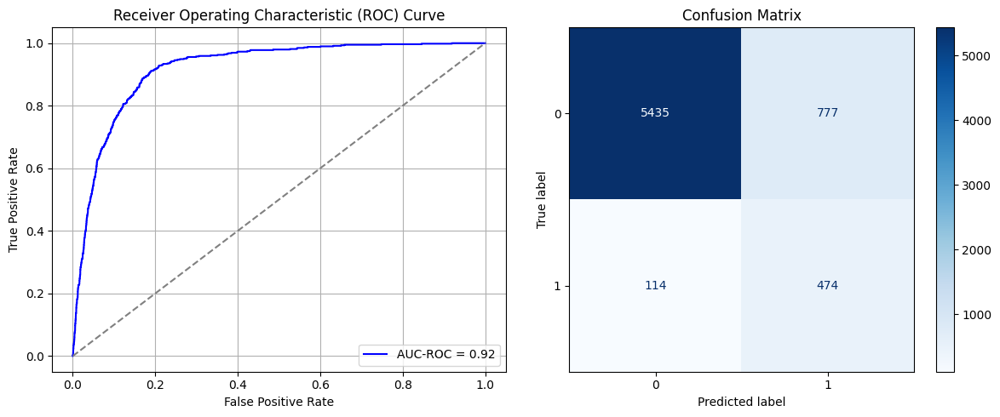

Best threshold based on F1-score: 0.9953034520149231
False Negative Rate: 0.19387755102040816
Time elapsed (performance): 5.069858838000073
(np.float64(0.12508048937540245), np.float64(0.8749195106245975))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6799 - loss: 0.6545 - val_AUC: 0.7591 - val_loss: 0.5875
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7796 - loss: 0.5682 - val_AUC: 0.8497 - val_loss: 0.4978
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8646 - loss: 0.4719 - val_AUC: 0.8774 - val_loss: 0.4521
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8706 - loss: 0.4619 - val_AUC: 0.8792 - val_loss: 0.4463
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8802 - loss: 0.4387 - val_AUC: 0.8776 - val_loss: 0.4435
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8812 - loss: 0.4359 - val_AUC: 0.8824 - val_loss: 0.4429
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8856 - loss: 0.4287 - val_AUC: 0.8848 - val_loss: 0.4337
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8930 - loss: 0.4154 - val_AUC: 0.8824 - val_loss: 0.4344
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8880 -

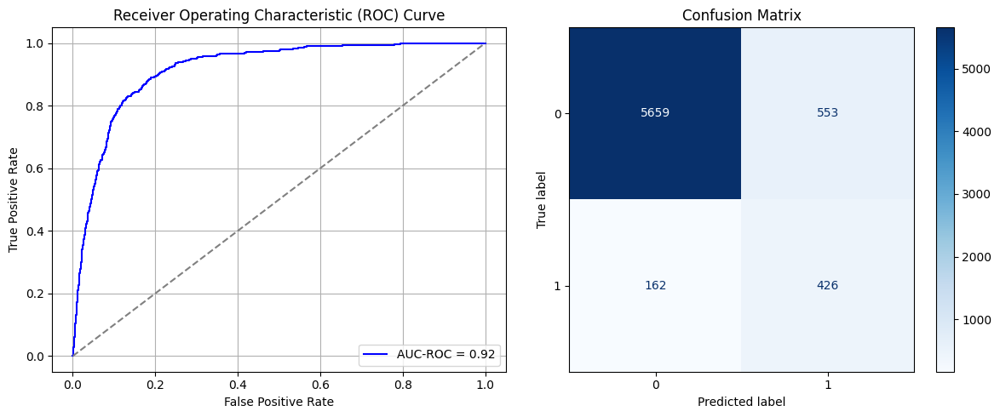

Best threshold based on F1-score: 0.48316141963005066
False Negative Rate: 0.2755102040816326
Time elapsed (performance): 1.0831054209993454
(np.float64(0.08902124919510625), np.float64(0.9109787508048938))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6197 - loss: 0.6646 - val_AUC: 0.7629 - val_loss: 0.5828
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7921 - loss: 0.5570 - val_AUC: 0.8580 - val_loss: 0.5635
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8440 - loss: 0.4979 - val_AUC: 0.8773 - val_loss: 0.4533
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8847 - loss: 0.4395 - val_AUC: 0.8806 - val_loss: 0.4468
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8838 - loss: 0.4362 - val_AUC: 0.8789 - val_loss: 0.4414
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8864 - loss: 0.4312 - val_AUC: 0.8821 - val_loss: 0.4429
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8803 - loss: 0.4388 - val_AUC: 0.8815 - val_loss: 0.4455
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8905 - loss: 0.4212 - val_AUC: 0.8842 - val_loss: 0.4304
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8952 -

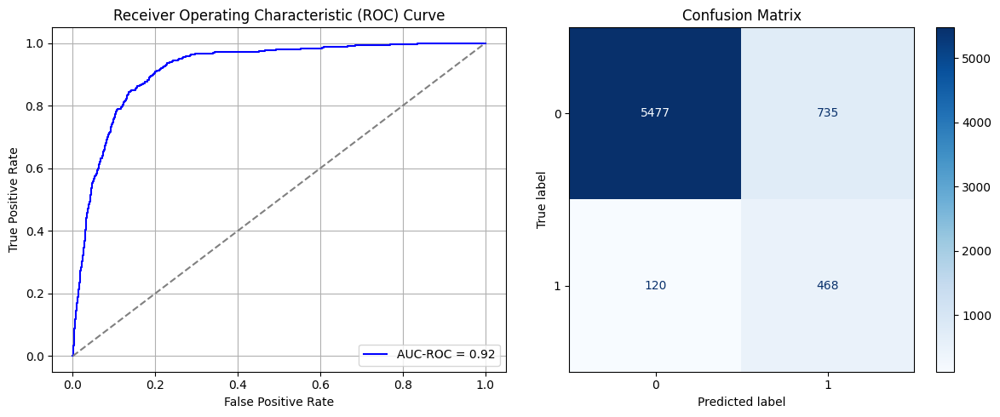

Best threshold based on F1-score: 0.9941644668579102
False Negative Rate: 0.20408163265306123
Time elapsed (performance): 1.0661837530005869
(np.float64(0.1183193818415969), np.float64(0.8816806181584032))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6739 - loss: 0.6526 - val_AUC: 0.7565 - val_loss: 0.5912
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7864 - loss: 0.5642 - val_AUC: 0.8510 - val_loss: 0.5085
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8502 - loss: 0.4946 - val_AUC: 0.8702 - val_loss: 0.4579
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8796 - loss: 0.4460 - val_AUC: 0.8750 - val_loss: 0.4476
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8833 - loss: 0.4352 - val_AUC: 0.8760 - val_loss: 0.4441
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8911 - loss: 0.4209 - val_AUC: 0.8775 - val_loss: 0.4431
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8883 - loss: 0.4254 - val_AUC: 0.8782 - val_loss: 0.4394
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8899 - loss: 0.4230 - val_AUC: 0.8765 - val_loss: 0.4430
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8892 -

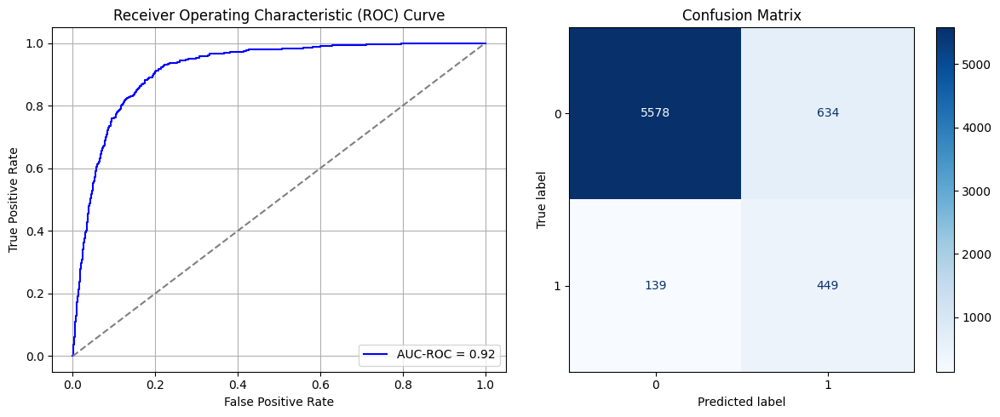

Best threshold based on F1-score: 0.5499475598335266
False Negative Rate: 0.23639455782312926
Time elapsed (performance): 0.8334268920007162
(np.float64(0.10206052801030265), np.float64(0.8979394719896974))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6454 - loss: 0.6577 - val_AUC: 0.7694 - val_loss: 0.5858
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7932 - loss: 0.5606 - val_AUC: 0.8573 - val_loss: 0.4922
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8661 - loss: 0.4713 - val_AUC: 0.8653 - val_loss: 0.4696
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8725 - loss: 0.4534 - val_AUC: 0.8715 - val_loss: 0.4587
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8860 - loss: 0.4322 - val_AUC: 0.8759 - val_loss: 0.4510
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8816 - loss: 0.4399 - val_AUC: 0.8758 - val_loss: 0.4465
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8815 - loss: 0.4370 - val_AUC: 0.8730 - val_loss: 0.4621
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8858 - loss: 0.4283 - val_AUC: 0.8757 - val_loss: 0.4456
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8912 -

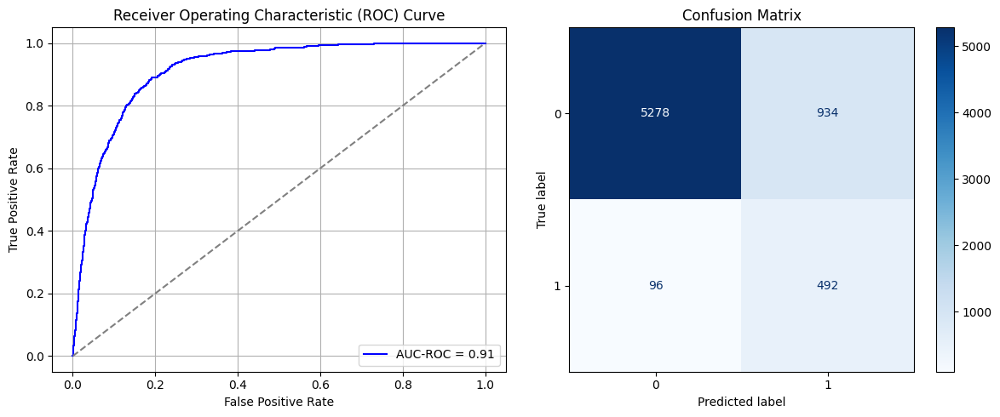

Best threshold based on F1-score: 0.9979415535926819
False Negative Rate: 0.16326530612244897
Time elapsed (performance): 0.8633487349998177
(np.float64(0.15035415325177076), np.float64(0.8496458467482293))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6413 - loss: 0.6599 - val_AUC: 0.7606 - val_loss: 0.5865
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8102 - loss: 0.5460 - val_AUC: 0.8515 - val_loss: 0.4986
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8631 - loss: 0.4755 - val_AUC: 0.8664 - val_loss: 0.4800
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8699 - loss: 0.4575 - val_AUC: 0.8701 - val_loss: 0.4637
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8810 - loss: 0.4394 - val_AUC: 0.8706 - val_loss: 0.4764
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8814 - loss: 0.4400 - val_AUC: 0.8706 - val_loss: 0.4544
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8821 - loss: 0.4361 - val_AUC: 0.8711 - val_loss: 0.4546
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8761 - loss: 0.4439 - val_AUC: 0.8693 - val_loss: 0.4710
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8851 -

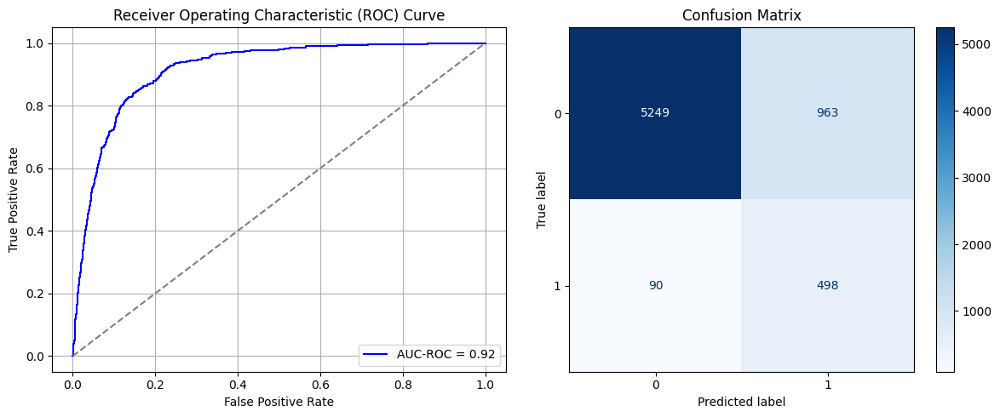

Best threshold based on F1-score: 0.7118768692016602
False Negative Rate: 0.15306122448979592
Time elapsed (performance): 0.8188501129998258
(np.float64(0.15502253702511268), np.float64(0.8449774629748873))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6732 - loss: 0.6534 - val_AUC: 0.7569 - val_loss: 0.6002
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7888 - loss: 0.5666 - val_AUC: 0.8421 - val_loss: 0.5283
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8477 - loss: 0.4973 - val_AUC: 0.8665 - val_loss: 0.4751
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8728 - loss: 0.4539 - val_AUC: 0.8682 - val_loss: 0.4603
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8695 - loss: 0.4555 - val_AUC: 0.8704 - val_loss: 0.4650
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8854 - loss: 0.4300 - val_AUC: 0.8730 - val_loss: 0.4488
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8910 - loss: 0.4186 - val_AUC: 0.8705 - val_loss: 0.4726
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8875 - loss: 0.4252 - val_AUC: 0.8736 - val_loss: 0.4466
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8905 -

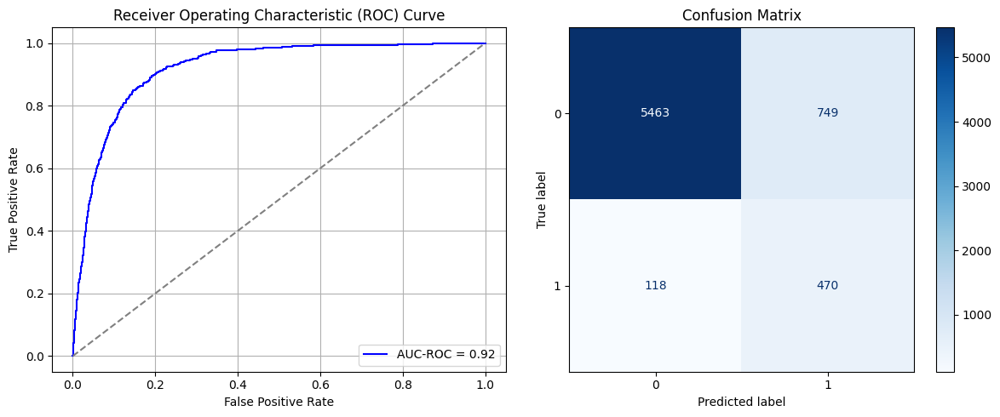

Best threshold based on F1-score: 0.9970830678939819
False Negative Rate: 0.20068027210884354
Time elapsed (performance): 1.0706208709998464
(np.float64(0.12057308435286543), np.float64(0.8794269156471346))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6383 - loss: 0.6647 - val_AUC: 0.7618 - val_loss: 0.5829
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7829 - loss: 0.5677 - val_AUC: 0.8496 - val_loss: 0.5448
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8592 - loss: 0.4887 - val_AUC: 0.8735 - val_loss: 0.4545
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8749 - loss: 0.4518 - val_AUC: 0.8772 - val_loss: 0.4452
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8780 - loss: 0.4430 - val_AUC: 0.8780 - val_loss: 0.4433
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8882 - loss: 0.4251 - val_AUC: 0.8793 - val_loss: 0.4393
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8841 - loss: 0.4325 - val_AUC: 0.8785 - val_loss: 0.4402
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8882 - loss: 0.4244 - val_AUC: 0.8798 - val_loss: 0.4393
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8892 -

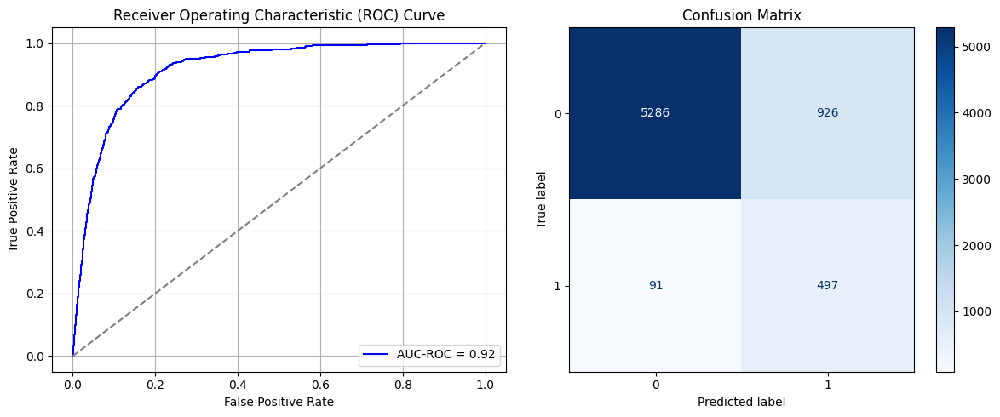

Best threshold based on F1-score: 0.9956772327423096
False Negative Rate: 0.15476190476190477
Time elapsed (performance): 0.8310304679998808
(np.float64(0.14906632324533162), np.float64(0.8509336767546684))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6326 - loss: 0.6640 - val_AUC: 0.7659 - val_loss: 0.5844
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7952 - loss: 0.5573 - val_AUC: 0.8468 - val_loss: 0.5084
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8621 - loss: 0.4817 - val_AUC: 0.8650 - val_loss: 0.4675
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8721 - loss: 0.4572 - val_AUC: 0.8693 - val_loss: 0.4585
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8790 - loss: 0.4429 - val_AUC: 0.8685 - val_loss: 0.4587
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8824 - loss: 0.4350 - val_AUC: 0.8703 - val_loss: 0.4548
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8815 - loss: 0.4352 - val_AUC: 0.8720 - val_loss: 0.4513
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8864 - loss: 0.4258 - val_AUC: 0.8715 - val_loss: 0.4504
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8899 -

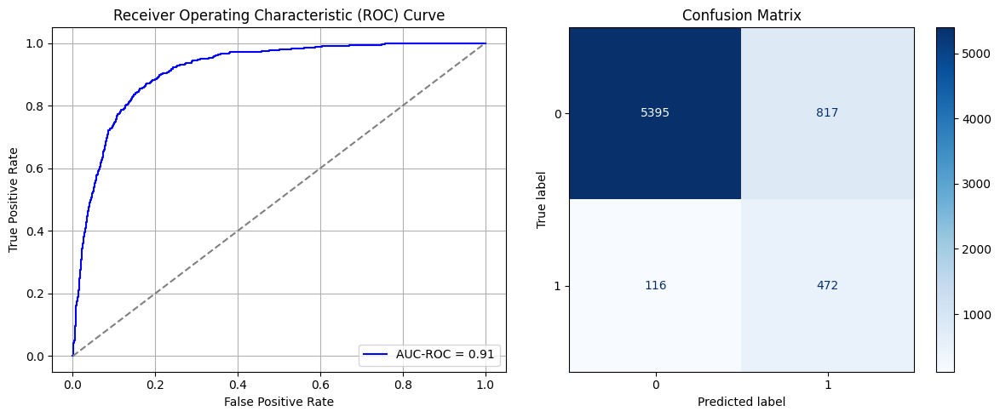

Best threshold based on F1-score: 0.994853675365448
False Negative Rate: 0.19727891156462585
Time elapsed (performance): 1.0614371600004233
(np.float64(0.1315196394075982), np.float64(0.8684803605924019))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6910 - loss: 0.6471 - val_AUC: 0.7891 - val_loss: 0.5709
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8080 - loss: 0.5476 - val_AUC: 0.8631 - val_loss: 0.4847
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8638 - loss: 0.4741 - val_AUC: 0.8760 - val_loss: 0.4571
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8843 - loss: 0.4388 - val_AUC: 0.8768 - val_loss: 0.4468
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8811 - loss: 0.4390 - val_AUC: 0.8812 - val_loss: 0.4386
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8873 - loss: 0.4282 - val_AUC: 0.8801 - val_loss: 0.4393
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8911 - loss: 0.4205 - val_AUC: 0.8823 - val_loss: 0.4431
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8830 - loss: 0.4343 - val_AUC: 0.8788 - val_loss: 0.4383
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8911 -

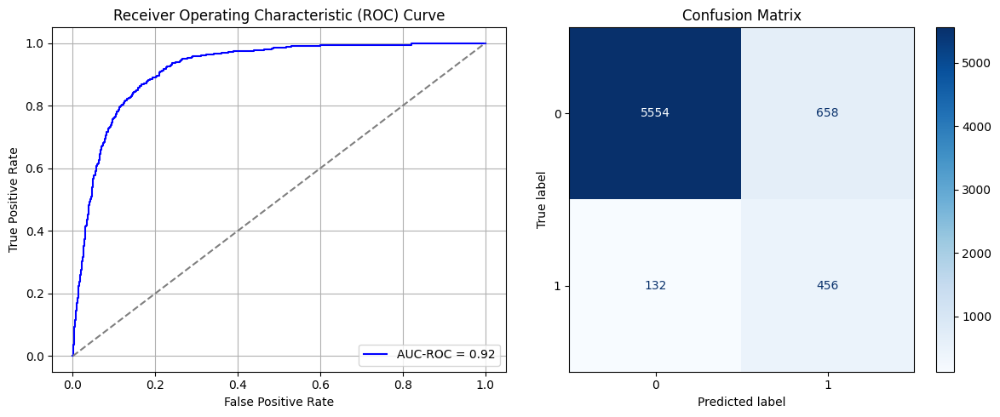

Best threshold based on F1-score: 0.9931896328926086
False Negative Rate: 0.22448979591836735
Time elapsed (performance): 1.0766394310003307
(np.float64(0.10592401802962009), np.float64(0.8940759819703799))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6607 - loss: 0.6562 - val_AUC: 0.7650 - val_loss: 0.5890
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8013 - loss: 0.5560 - val_AUC: 0.8546 - val_loss: 0.5125
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8505 - loss: 0.4869 - val_AUC: 0.8669 - val_loss: 0.4785
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8781 - loss: 0.4503 - val_AUC: 0.8660 - val_loss: 0.4711
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8815 - loss: 0.4410 - val_AUC: 0.8711 - val_loss: 0.4586
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8789 - loss: 0.4435 - val_AUC: 0.8724 - val_loss: 0.4555
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8893 - loss: 0.4245 - val_AUC: 0.8721 - val_loss: 0.4562
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8879 - loss: 0.4281 - val_AUC: 0.8711 - val_loss: 0.4553
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8899 -

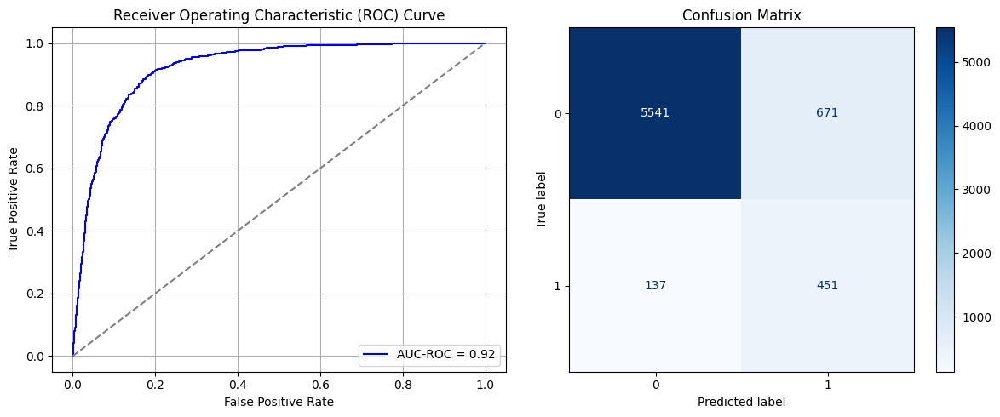

Best threshold based on F1-score: 0.9985909461975098
False Negative Rate: 0.23299319727891157
Time elapsed (performance): 0.8442835109999578
(np.float64(0.1080167417900837), np.float64(0.8919832582099163))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6314 - loss: 0.6621 - val_AUC: 0.7414 - val_loss: 0.5994
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.7731 - loss: 0.5753 - val_AUC: 0.8434 - val_loss: 0.5189
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8485 - loss: 0.4980 - val_AUC: 0.8743 - val_loss: 0.4717
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8613 - loss: 0.4709 - val_AUC: 0.8772 - val_loss: 0.4461
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8769 - loss: 0.4429 - val_AUC: 0.8740 - val_loss: 0.4680
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8771 - loss: 0.4413 - val_AUC: 0.8788 - val_loss: 0.4403
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8742 - loss: 0.4445 - val_AUC: 0.8815 - val_loss: 0.4338
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8896 - loss: 0.4205 - val_AUC: 0.8801 - val_loss: 0.4347
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8822 -

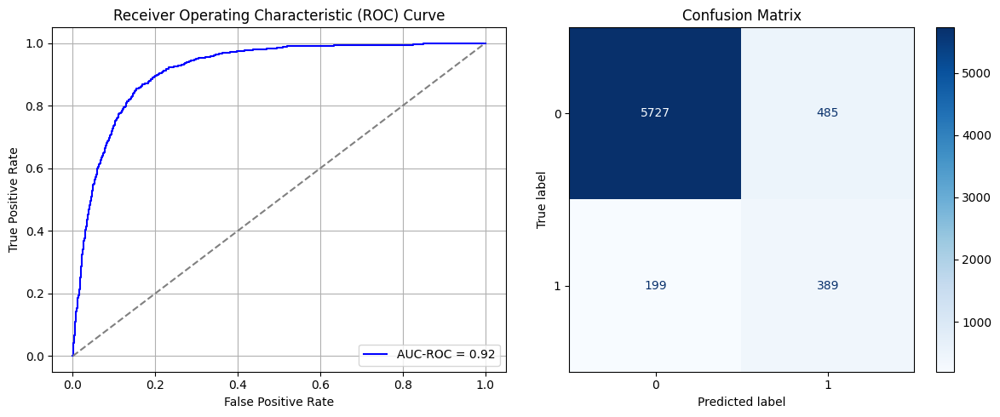

Best threshold based on F1-score: 0.9918234944343567
False Negative Rate: 0.33843537414965985
Time elapsed (performance): 0.8397936799992749
(np.float64(0.07807469414037348), np.float64(0.9219253058596265))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6683 - loss: 0.6518 - val_AUC: 0.7612 - val_loss: 0.5882
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7845 - loss: 0.5687 - val_AUC: 0.8430 - val_loss: 0.5129
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8438 - loss: 0.5021 - val_AUC: 0.8746 - val_loss: 0.4587
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8763 - loss: 0.4485 - val_AUC: 0.8806 - val_loss: 0.4468
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8690 - loss: 0.4580 - val_AUC: 0.8781 - val_loss: 0.4465
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8816 - loss: 0.4382 - val_AUC: 0.8766 - val_loss: 0.4456
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8808 - loss: 0.4378 - val_AUC: 0.8805 - val_loss: 0.4464
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8908 - loss: 0.4254 - val_AUC: 0.8749 - val_loss: 0.4483
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8943 -

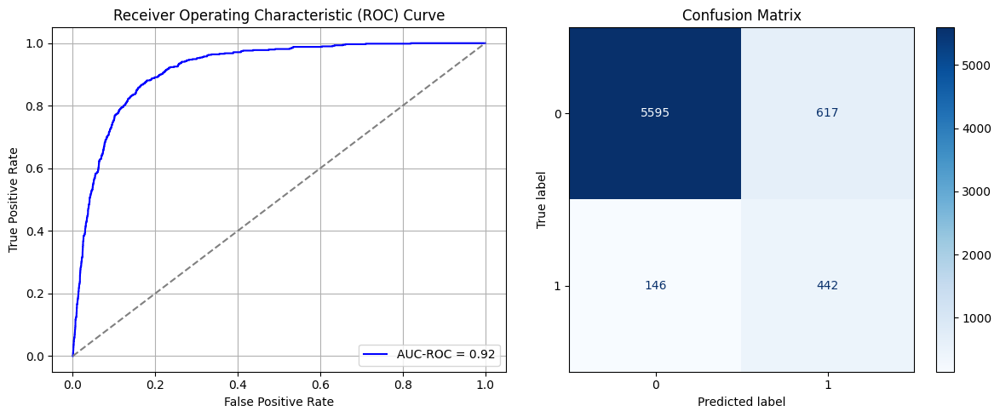

Best threshold based on F1-score: 0.5641196966171265
False Negative Rate: 0.24829931972789115
Time elapsed (performance): 1.7413905820003492
(np.float64(0.09932388924661945), np.float64(0.9006761107533805))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6531 - loss: 0.6607 - val_AUC: 0.7389 - val_loss: 0.6056
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7741 - loss: 0.5723 - val_AUC: 0.8318 - val_loss: 0.5299
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8405 - loss: 0.5123 - val_AUC: 0.8666 - val_loss: 0.4758
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8659 - loss: 0.4728 - val_AUC: 0.8702 - val_loss: 0.4615
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8761 - loss: 0.4530 - val_AUC: 0.8721 - val_loss: 0.4585
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8772 - loss: 0.4530 - val_AUC: 0.8743 - val_loss: 0.4542
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8801 - loss: 0.4455 - val_AUC: 0.8754 - val_loss: 0.4504
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8850 - loss: 0.4360 - val_AUC: 0.8765 - val_loss: 0.4469
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8892 -

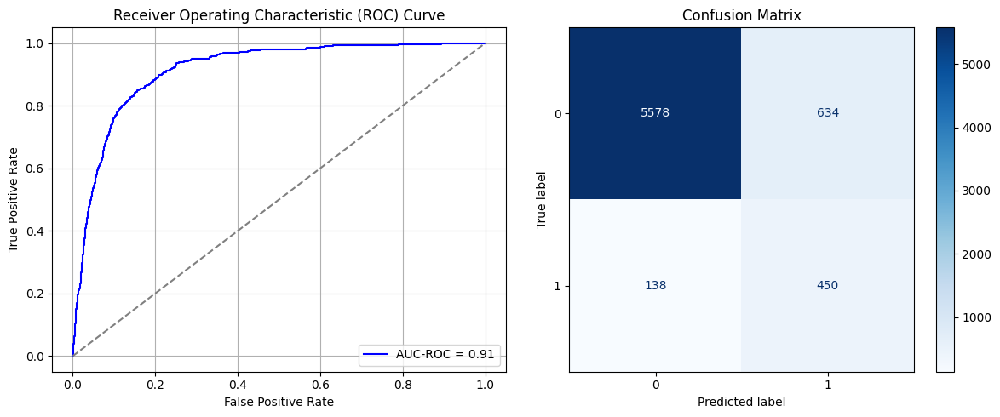

Best threshold based on F1-score: 0.9991316199302673
False Negative Rate: 0.23469387755102042
Time elapsed (performance): 0.8255042610007877
(np.float64(0.10206052801030265), np.float64(0.8979394719896974))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6562 - loss: 0.6557 - val_AUC: 0.7754 - val_loss: 0.5839
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7825 - loss: 0.5688 - val_AUC: 0.8544 - val_loss: 0.4978
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8506 - loss: 0.4900 - val_AUC: 0.8735 - val_loss: 0.4561
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8807 - loss: 0.4405 - val_AUC: 0.8783 - val_loss: 0.4446
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8879 - loss: 0.4256 - val_AUC: 0.8794 - val_loss: 0.4507
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8850 - loss: 0.4305 - val_AUC: 0.8770 - val_loss: 0.4412
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8739 - loss: 0.4481 - val_AUC: 0.8787 - val_loss: 0.4418
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8954 - loss: 0.4090 - val_AUC: 0.8791 - val_loss: 0.4379
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8931 -

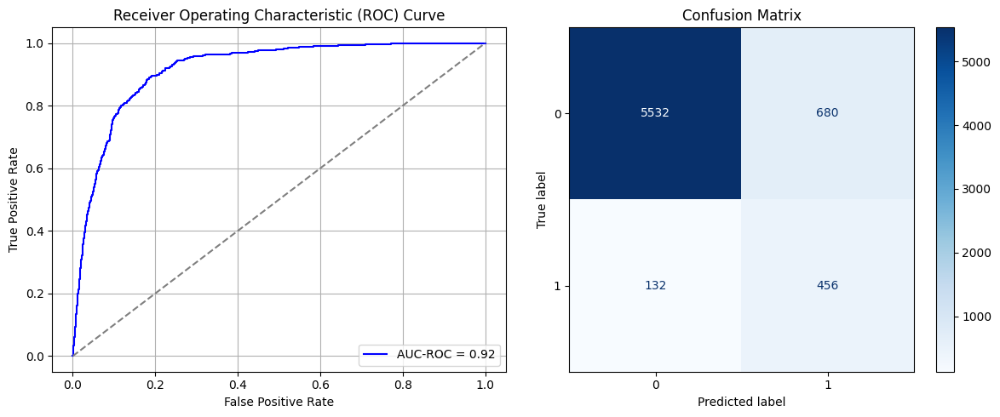

Best threshold based on F1-score: 0.9954885244369507
False Negative Rate: 0.22448979591836735
Time elapsed (performance): 0.8607191230003082
(np.float64(0.10946555054732775), np.float64(0.8905344494526722))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6661 - loss: 0.6541 - val_AUC: 0.7548 - val_loss: 0.5937
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7751 - loss: 0.5750 - val_AUC: 0.8488 - val_loss: 0.5063
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8520 - loss: 0.4905 - val_AUC: 0.8790 - val_loss: 0.4588
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8793 - loss: 0.4525 - val_AUC: 0.8819 - val_loss: 0.4422
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8805 - loss: 0.4422 - val_AUC: 0.8832 - val_loss: 0.4426
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8770 - loss: 0.4498 - val_AUC: 0.8837 - val_loss: 0.4367
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8810 - loss: 0.4404 - val_AUC: 0.8847 - val_loss: 0.4353
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8836 - loss: 0.4348 - val_AUC: 0.8866 - val_loss: 0.4316
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8915 -

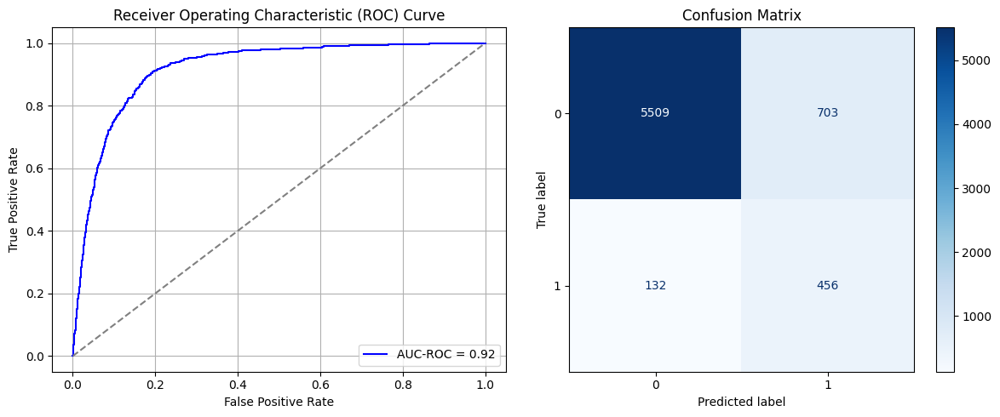

Best threshold based on F1-score: 0.9997315406799316
False Negative Rate: 0.22448979591836735
Time elapsed (performance): 0.834994366000501
(np.float64(0.11316806181584031), np.float64(0.8868319381841597))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6681 - loss: 0.6540 - val_AUC: 0.7822 - val_loss: 0.5655
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8071 - loss: 0.5422 - val_AUC: 0.8633 - val_loss: 0.5052
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8549 - loss: 0.4873 - val_AUC: 0.8760 - val_loss: 0.4551
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8787 - loss: 0.4457 - val_AUC: 0.8814 - val_loss: 0.4429
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8900 - loss: 0.4265 - val_AUC: 0.8825 - val_loss: 0.4388
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8883 - loss: 0.4271 - val_AUC: 0.8837 - val_loss: 0.4332
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8838 - loss: 0.4331 - val_AUC: 0.8843 - val_loss: 0.4311
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8876 - loss: 0.4238 - val_AUC: 0.8849 - val_loss: 0.4312
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8927 -

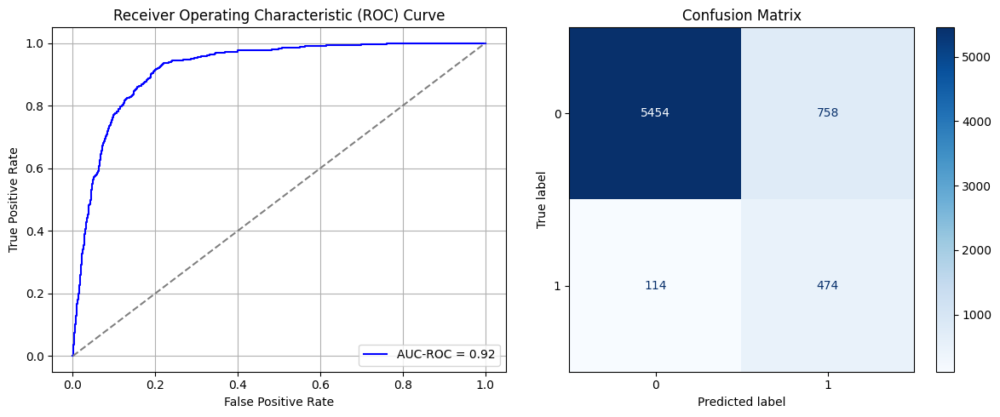

Best threshold based on F1-score: 0.9968541860580444
False Negative Rate: 0.19387755102040816
Time elapsed (performance): 0.8482550520002405
(np.float64(0.12202189311010947), np.float64(0.8779781068898905))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6178 - loss: 0.6701 - val_AUC: 0.7501 - val_loss: 0.5979
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7763 - loss: 0.5729 - val_AUC: 0.8403 - val_loss: 0.5239
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8483 - loss: 0.4979 - val_AUC: 0.8717 - val_loss: 0.4607
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8724 - loss: 0.4563 - val_AUC: 0.8749 - val_loss: 0.4487
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8811 - loss: 0.4381 - val_AUC: 0.8783 - val_loss: 0.4436
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8860 - loss: 0.4281 - val_AUC: 0.8781 - val_loss: 0.4406
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8881 - loss: 0.4226 - val_AUC: 0.8806 - val_loss: 0.4332
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8933 - loss: 0.4127 - val_AUC: 0.8806 - val_loss: 0.4329
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8916 -

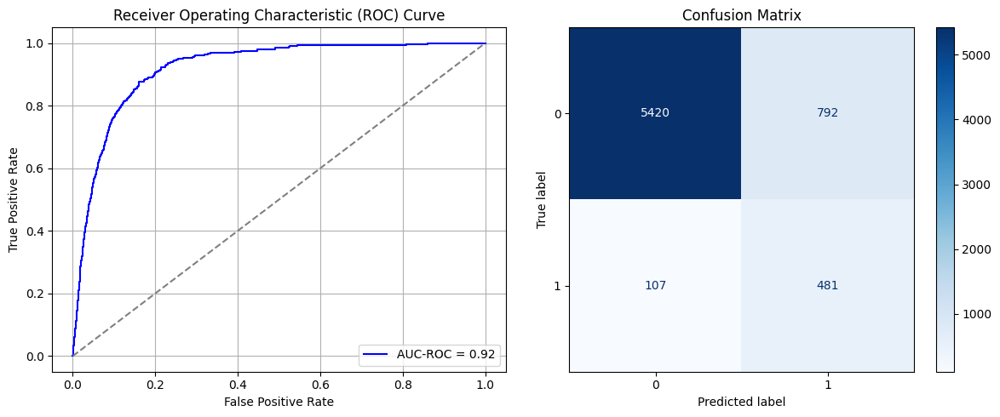

Best threshold based on F1-score: 0.9913394451141357
False Negative Rate: 0.18197278911564627
Time elapsed (performance): 1.09182517499994
(np.float64(0.12749517063747584), np.float64(0.8725048293625242))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6549 - loss: 0.6563 - val_AUC: 0.7987 - val_loss: 0.5672
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8110 - loss: 0.5451 - val_AUC: 0.8658 - val_loss: 0.4808
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8732 - loss: 0.4636 - val_AUC: 0.8770 - val_loss: 0.4586
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8848 - loss: 0.4395 - val_AUC: 0.8796 - val_loss: 0.4434
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8844 - loss: 0.4361 - val_AUC: 0.8799 - val_loss: 0.4419
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8771 - loss: 0.4447 - val_AUC: 0.8809 - val_loss: 0.4385
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8850 - loss: 0.4314 - val_AUC: 0.8829 - val_loss: 0.4382
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8907 - loss: 0.4206 - val_AUC: 0.8832 - val_loss: 0.4322
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8895 -

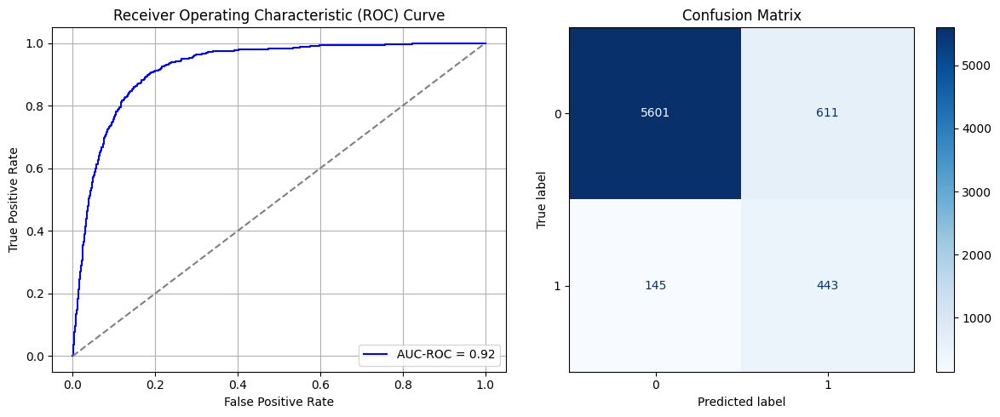

Best threshold based on F1-score: 0.9992820024490356
False Negative Rate: 0.2465986394557823
Time elapsed (performance): 0.8334385879998081
(np.float64(0.09835801674179008), np.float64(0.9016419832582099))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6609 - loss: 0.6554 - val_AUC: 0.7626 - val_loss: 0.5842
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7895 - loss: 0.5602 - val_AUC: 0.8390 - val_loss: 0.5090
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8494 - loss: 0.4930 - val_AUC: 0.8618 - val_loss: 0.4718
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8775 - loss: 0.4502 - val_AUC: 0.8697 - val_loss: 0.4599
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8813 - loss: 0.4397 - val_AUC: 0.8684 - val_loss: 0.4654
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8787 - loss: 0.4417 - val_AUC: 0.8720 - val_loss: 0.4701
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8855 - loss: 0.4324 - val_AUC: 0.8730 - val_loss: 0.4527
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8836 - loss: 0.4336 - val_AUC: 0.8715 - val_loss: 0.4563
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8843 -

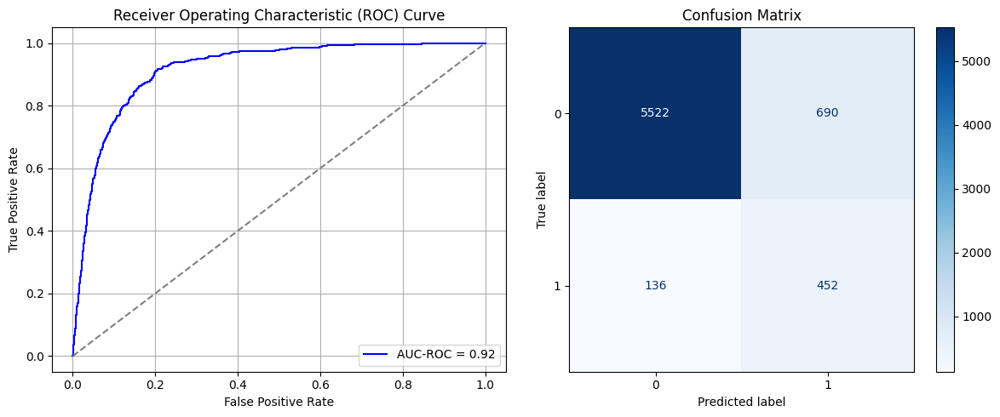

Best threshold based on F1-score: 0.6192365288734436
False Negative Rate: 0.23129251700680273
Time elapsed (performance): 1.0403828239996074
(np.float64(0.11107533805537669), np.float64(0.8889246619446233))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6626 - loss: 0.6603 - val_AUC: 0.7458 - val_loss: 0.5988
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7850 - loss: 0.5704 - val_AUC: 0.8459 - val_loss: 0.5165
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8524 - loss: 0.4949 - val_AUC: 0.8664 - val_loss: 0.4788
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8743 - loss: 0.4577 - val_AUC: 0.8717 - val_loss: 0.4661
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8786 - loss: 0.4479 - val_AUC: 0.8708 - val_loss: 0.4566
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8868 - loss: 0.4298 - val_AUC: 0.8690 - val_loss: 0.4609
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8867 - loss: 0.4296 - val_AUC: 0.8709 - val_loss: 0.4578
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8900 - loss: 0.4211 - val_AUC: 0.8692 - val_loss: 0.4617
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8851 -

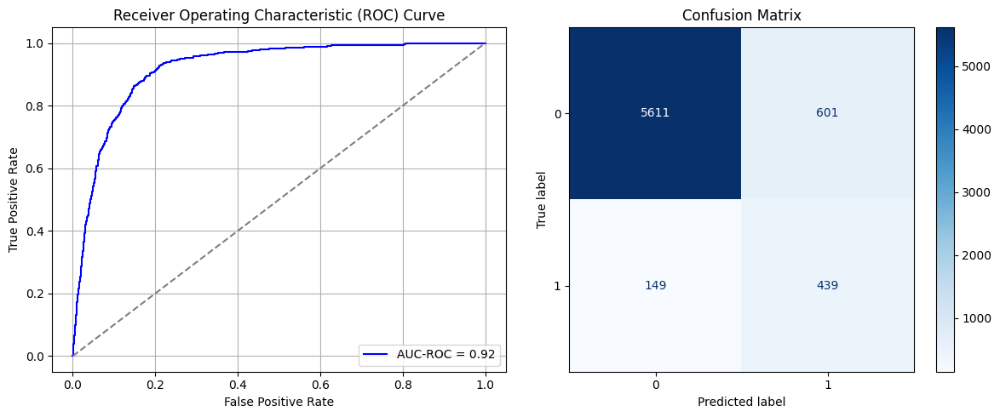

Best threshold based on F1-score: 0.9991944432258606
False Negative Rate: 0.2534013605442177
Time elapsed (performance): 1.0501346900000499
(np.float64(0.09674822923374114), np.float64(0.9032517707662588))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6562 - loss: 0.6602 - val_AUC: 0.7622 - val_loss: 0.5863
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7821 - loss: 0.5673 - val_AUC: 0.8555 - val_loss: 0.4982
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8657 - loss: 0.4770 - val_AUC: 0.8712 - val_loss: 0.4550
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8800 - loss: 0.4414 - val_AUC: 0.8762 - val_loss: 0.4543
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8781 - loss: 0.4414 - val_AUC: 0.8766 - val_loss: 0.4473
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8815 - loss: 0.4363 - val_AUC: 0.8742 - val_loss: 0.4438
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8913 - loss: 0.4175 - val_AUC: 0.8742 - val_loss: 0.4432
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8904 - loss: 0.4171 - val_AUC: 0.8772 - val_loss: 0.4430
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8943 -

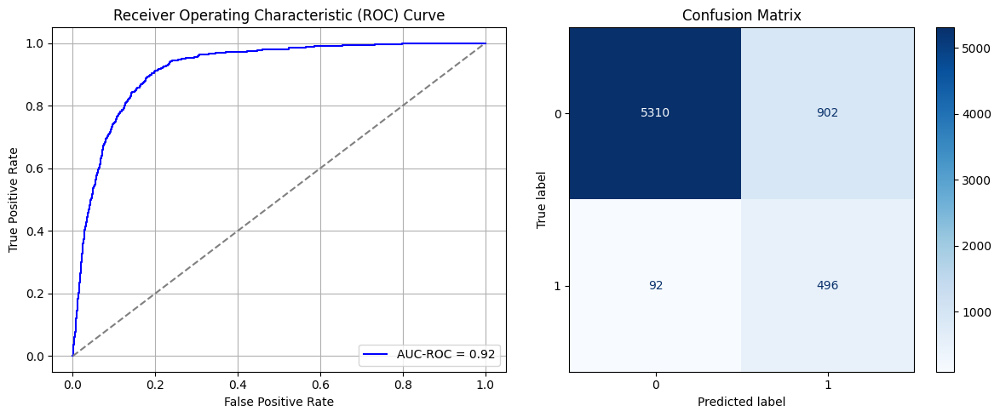

Best threshold based on F1-score: 0.995560884475708
False Negative Rate: 0.1564625850340136
Time elapsed (performance): 1.0635901710002145
(np.float64(0.14520283322601416), np.float64(0.8547971667739859))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6763 - loss: 0.6581 - val_AUC: 0.7524 - val_loss: 0.5920
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7742 - loss: 0.5741 - val_AUC: 0.8329 - val_loss: 0.5244
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8487 - loss: 0.4949 - val_AUC: 0.8676 - val_loss: 0.4678
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8822 - loss: 0.4428 - val_AUC: 0.8723 - val_loss: 0.4541
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8816 - loss: 0.4413 - val_AUC: 0.8751 - val_loss: 0.4468
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8839 - loss: 0.4311 - val_AUC: 0.8774 - val_loss: 0.4607
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8891 - loss: 0.4223 - val_AUC: 0.8734 - val_loss: 0.4741
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8873 - loss: 0.4259 - val_AUC: 0.8770 - val_loss: 0.4403
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8958 -

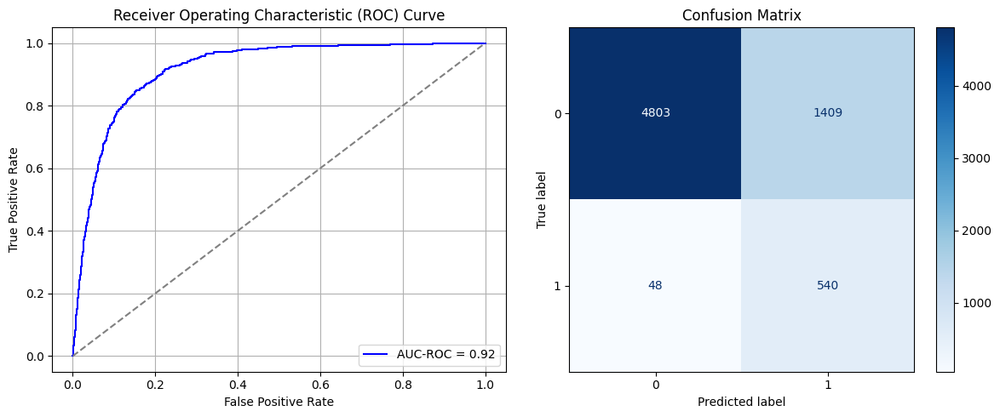

Best threshold based on F1-score: 0.7620491981506348
False Negative Rate: 0.08163265306122448
Time elapsed (performance): 1.025902689000759
(np.float64(0.2268190598840953), np.float64(0.7731809401159047))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6808 - loss: 0.6539 - val_AUC: 0.7668 - val_loss: 0.5824
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.7893 - loss: 0.5612 - val_AUC: 0.8513 - val_loss: 0.5077
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8450 - loss: 0.4972 - val_AUC: 0.8736 - val_loss: 0.4599
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8764 - loss: 0.4473 - val_AUC: 0.8781 - val_loss: 0.4442
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8865 - loss: 0.4293 - val_AUC: 0.8779 - val_loss: 0.4457
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8900 - loss: 0.4247 - val_AUC: 0.8826 - val_loss: 0.4350
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8991 - loss: 0.4045 - val_AUC: 0.8834 - val_loss: 0.4330
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8858 - loss: 0.4262 - val_AUC: 0.8839 - val_loss: 0.4288
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8965 -

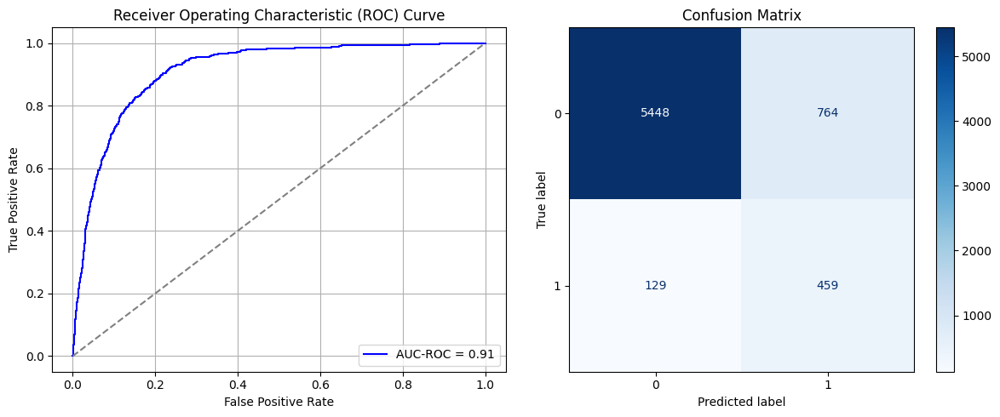

Best threshold based on F1-score: 0.9891507625579834
False Negative Rate: 0.2193877551020408
Time elapsed (performance): 1.0483105029998114
(np.float64(0.12298776561493883), np.float64(0.8770122343850612))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6574 - loss: 0.6567 - val_AUC: 0.7657 - val_loss: 0.5873
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7911 - loss: 0.5594 - val_AUC: 0.8467 - val_loss: 0.5049
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8612 - loss: 0.4775 - val_AUC: 0.8695 - val_loss: 0.4632
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8765 - loss: 0.4501 - val_AUC: 0.8667 - val_loss: 0.4611
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8650 - loss: 0.4635 - val_AUC: 0.8725 - val_loss: 0.4517
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8793 - loss: 0.4411 - val_AUC: 0.8703 - val_loss: 0.4558
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8779 - loss: 0.4406 - val_AUC: 0.8696 - val_loss: 0.4747
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8867 - loss: 0.4274 - val_AUC: 0.8737 - val_loss: 0.4559
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8854 -

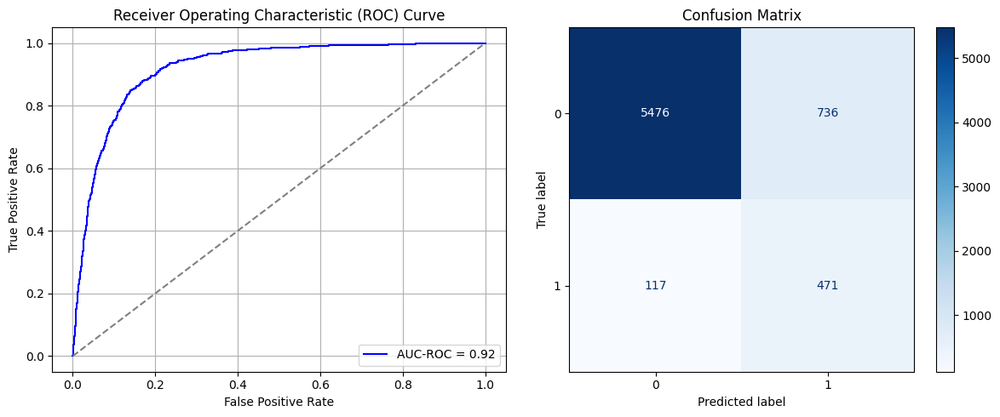

Best threshold based on F1-score: 0.645901620388031
False Negative Rate: 0.1989795918367347
Time elapsed (performance): 0.8732076389997019
(np.float64(0.1184803605924018), np.float64(0.8815196394075981))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6594 - loss: 0.6642 - val_AUC: 0.7526 - val_loss: 0.5913
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7892 - loss: 0.5615 - val_AUC: 0.8435 - val_loss: 0.5079
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8554 - loss: 0.4868 - val_AUC: 0.8674 - val_loss: 0.4699
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8731 - loss: 0.4566 - val_AUC: 0.8687 - val_loss: 0.4729
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8765 - loss: 0.4473 - val_AUC: 0.8678 - val_loss: 0.4721
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8804 - loss: 0.4435 - val_AUC: 0.8698 - val_loss: 0.4628
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8881 - loss: 0.4278 - val_AUC: 0.8737 - val_loss: 0.4535
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8839 - loss: 0.4309 - val_AUC: 0.8693 - val_loss: 0.4619
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8839 -

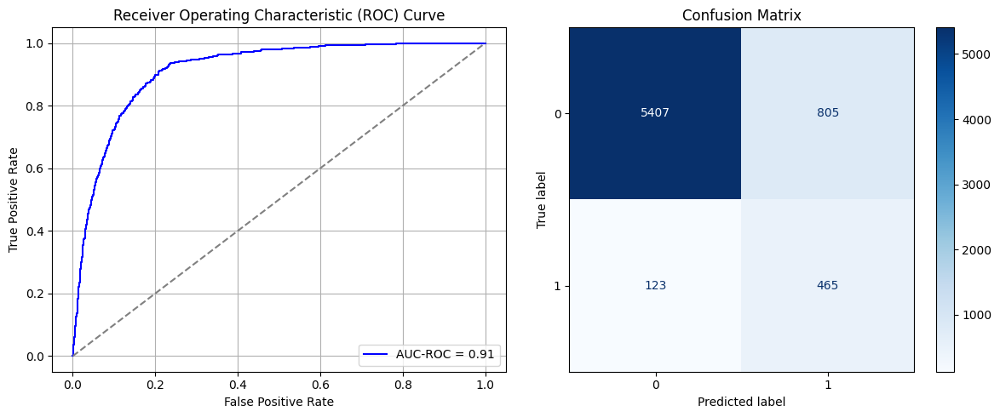

Best threshold based on F1-score: 0.9998292326927185
False Negative Rate: 0.20918367346938777
Time elapsed (performance): 1.048142791999453
(np.float64(0.12958789439793947), np.float64(0.8704121056020605))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6501 - loss: 0.6587 - val_AUC: 0.7759 - val_loss: 0.5746
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7828 - loss: 0.5660 - val_AUC: 0.8556 - val_loss: 0.5059
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8623 - loss: 0.4715 - val_AUC: 0.8806 - val_loss: 0.4722
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8726 - loss: 0.4541 - val_AUC: 0.8814 - val_loss: 0.4407
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8866 - loss: 0.4316 - val_AUC: 0.8846 - val_loss: 0.4363
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8821 - loss: 0.4355 - val_AUC: 0.8852 - val_loss: 0.4390
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8820 - loss: 0.4342 - val_AUC: 0.8854 - val_loss: 0.4341
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8932 - loss: 0.4135 - val_AUC: 0.8844 - val_loss: 0.4299
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8962 -

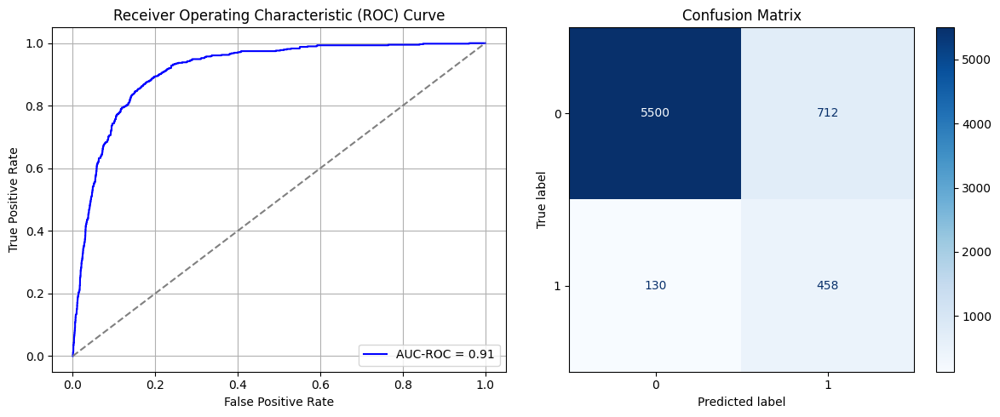

Best threshold based on F1-score: 0.6672537326812744
False Negative Rate: 0.22108843537414966
Time elapsed (performance): 0.8688063170002351
(np.float64(0.11461687057308435), np.float64(0.8853831294269157))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6564 - loss: 0.6540 - val_AUC: 0.7828 - val_loss: 0.5743
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8043 - loss: 0.5491 - val_AUC: 0.8625 - val_loss: 0.5036
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8603 - loss: 0.4825 - val_AUC: 0.8813 - val_loss: 0.4491
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8826 - loss: 0.4434 - val_AUC: 0.8829 - val_loss: 0.4461
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8809 - loss: 0.4412 - val_AUC: 0.8834 - val_loss: 0.4364
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8841 - loss: 0.4339 - val_AUC: 0.8840 - val_loss: 0.4343
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8905 - loss: 0.4228 - val_AUC: 0.8856 - val_loss: 0.4327
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8886 - loss: 0.4241 - val_AUC: 0.8858 - val_loss: 0.4531
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8888 -

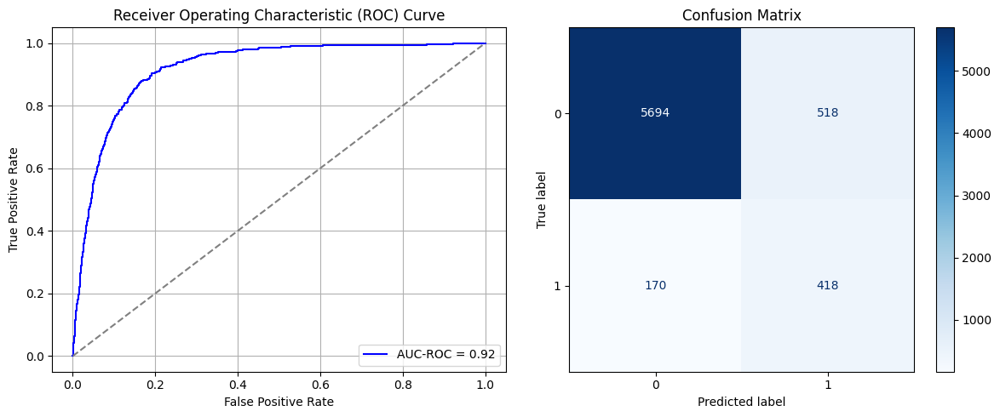

Best threshold based on F1-score: 0.5039384365081787
False Negative Rate: 0.2891156462585034
Time elapsed (performance): 1.0561950549999892
(np.float64(0.08338699291693497), np.float64(0.916613007083065))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6503 - loss: 0.6542 - val_AUC: 0.7555 - val_loss: 0.6001
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7786 - loss: 0.5703 - val_AUC: 0.8347 - val_loss: 0.5210
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8309 - loss: 0.5187 - val_AUC: 0.8614 - val_loss: 0.4780
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8702 - loss: 0.4610 - val_AUC: 0.8711 - val_loss: 0.4703
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8716 - loss: 0.4573 - val_AUC: 0.8735 - val_loss: 0.4542
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8779 - loss: 0.4436 - val_AUC: 0.8773 - val_loss: 0.4413
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8783 - loss: 0.4407 - val_AUC: 0.8777 - val_loss: 0.4428
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8816 - loss: 0.4356 - val_AUC: 0.8768 - val_loss: 0.4467
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8882 -

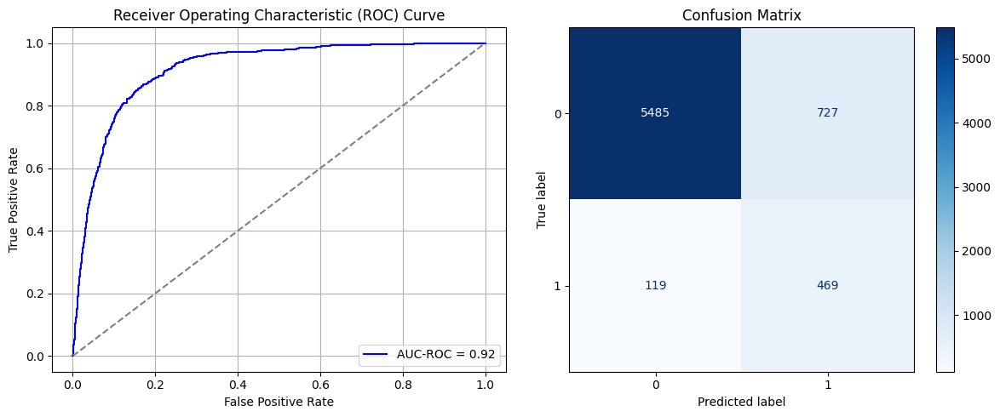

Best threshold based on F1-score: 0.6235944628715515
False Negative Rate: 0.20238095238095238
Time elapsed (performance): 1.0552705800000695
(np.float64(0.11703155183515776), np.float64(0.8829684481648422))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6664 - loss: 0.6523 - val_AUC: 0.7743 - val_loss: 0.5804
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8002 - loss: 0.5528 - val_AUC: 0.8481 - val_loss: 0.5099
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8548 - loss: 0.4882 - val_AUC: 0.8736 - val_loss: 0.4584
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8856 - loss: 0.4374 - val_AUC: 0.8772 - val_loss: 0.4465
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8853 - loss: 0.4310 - val_AUC: 0.8786 - val_loss: 0.4376
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8834 - loss: 0.4322 - val_AUC: 0.8792 - val_loss: 0.4383
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8961 - loss: 0.4102 - val_AUC: 0.8764 - val_loss: 0.4397
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8939 - loss: 0.4135 - val_AUC: 0.8807 - val_loss: 0.4328
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8978 -

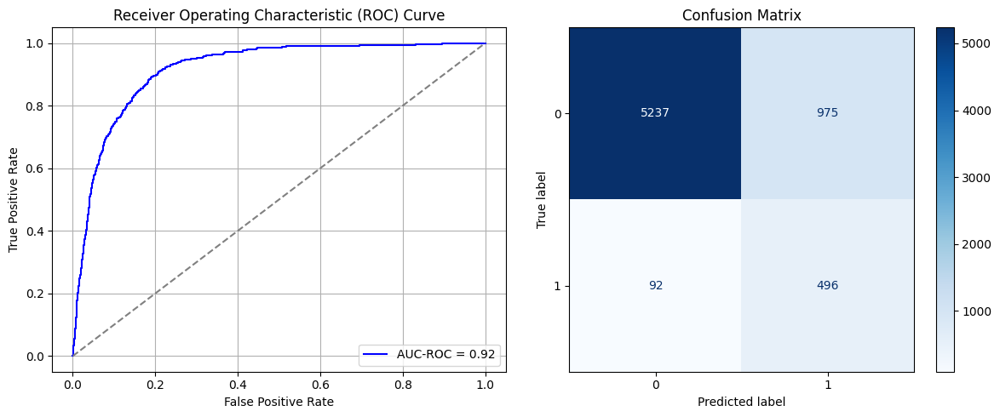

Best threshold based on F1-score: 0.9943792819976807
False Negative Rate: 0.1564625850340136
Time elapsed (performance): 0.920356568999523
(np.float64(0.1569542820347714), np.float64(0.8430457179652286))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6067 - loss: 0.6742 - val_AUC: 0.7577 - val_loss: 0.5906
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7967 - loss: 0.5520 - val_AUC: 0.8479 - val_loss: 0.5125
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8491 - loss: 0.4950 - val_AUC: 0.8764 - val_loss: 0.4599
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8658 - loss: 0.4659 - val_AUC: 0.8775 - val_loss: 0.4542
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8761 - loss: 0.4490 - val_AUC: 0.8763 - val_loss: 0.4488
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8792 - loss: 0.4382 - val_AUC: 0.8766 - val_loss: 0.4483
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8872 - loss: 0.4285 - val_AUC: 0.8802 - val_loss: 0.4412
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8810 - loss: 0.4365 - val_AUC: 0.8815 - val_loss: 0.4364
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8897 -

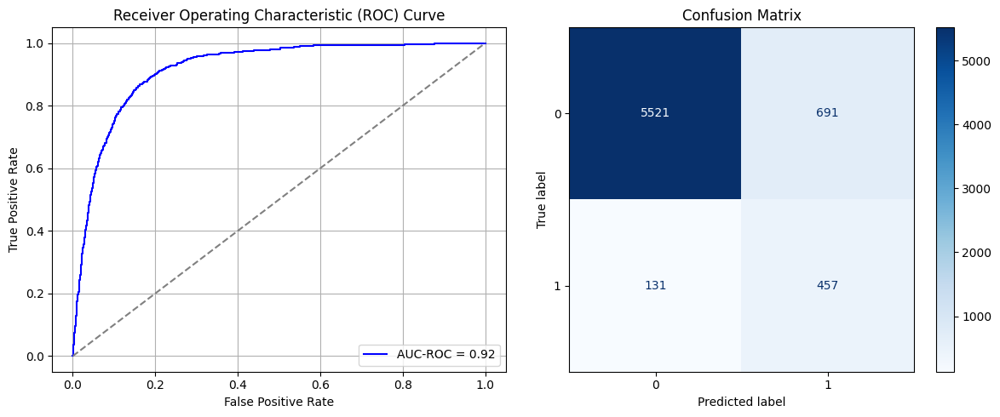

Best threshold based on F1-score: 0.6596947312355042
False Negative Rate: 0.2227891156462585
Time elapsed (performance): 0.8818577990004997
(np.float64(0.11123631680618158), np.float64(0.8887636831938184))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6672 - loss: 0.6582 - val_AUC: 0.7619 - val_loss: 0.5849
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7868 - loss: 0.5643 - val_AUC: 0.8490 - val_loss: 0.5077
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8507 - loss: 0.4925 - val_AUC: 0.8704 - val_loss: 0.4614
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8796 - loss: 0.4477 - val_AUC: 0.8754 - val_loss: 0.4491
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8804 - loss: 0.4418 - val_AUC: 0.8742 - val_loss: 0.4465
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8842 - loss: 0.4314 - val_AUC: 0.8783 - val_loss: 0.4392
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8808 - loss: 0.4374 - val_AUC: 0.8763 - val_loss: 0.4429
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8843 - loss: 0.4307 - val_AUC: 0.8724 - val_loss: 0.4510
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8840 -

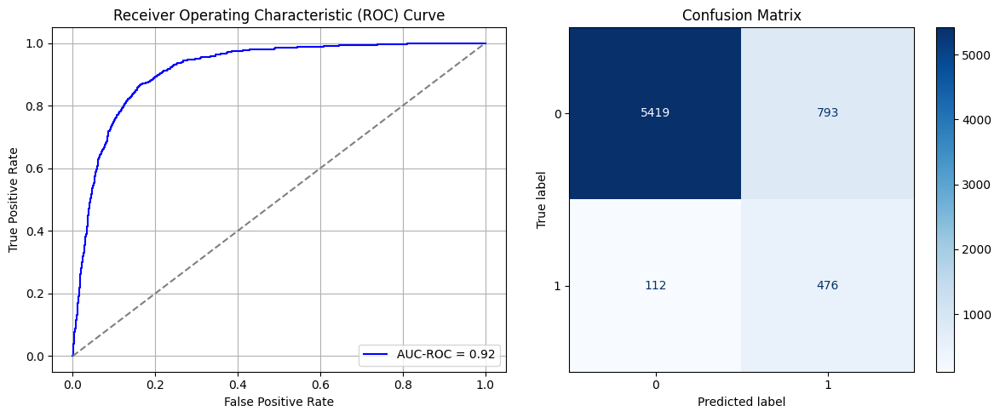

Best threshold based on F1-score: 0.9914769530296326
False Negative Rate: 0.19047619047619047
Time elapsed (performance): 0.8961575390003418
(np.float64(0.12765614938828074), np.float64(0.8723438506117193))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6540 - loss: 0.6629 - val_AUC: 0.7617 - val_loss: 0.5878
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.7884 - loss: 0.5637 - val_AUC: 0.8419 - val_loss: 0.5121
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8513 - loss: 0.4972 - val_AUC: 0.8686 - val_loss: 0.4634
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8723 - loss: 0.4564 - val_AUC: 0.8762 - val_loss: 0.4614
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8802 - loss: 0.4414 - val_AUC: 0.8768 - val_loss: 0.4552
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8870 - loss: 0.4309 - val_AUC: 0.8790 - val_loss: 0.4472
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8889 - loss: 0.4245 - val_AUC: 0.8808 - val_loss: 0.4390
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8832 - loss: 0.4312 - val_AUC: 0.8806 - val_loss: 0.4426
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8885 -

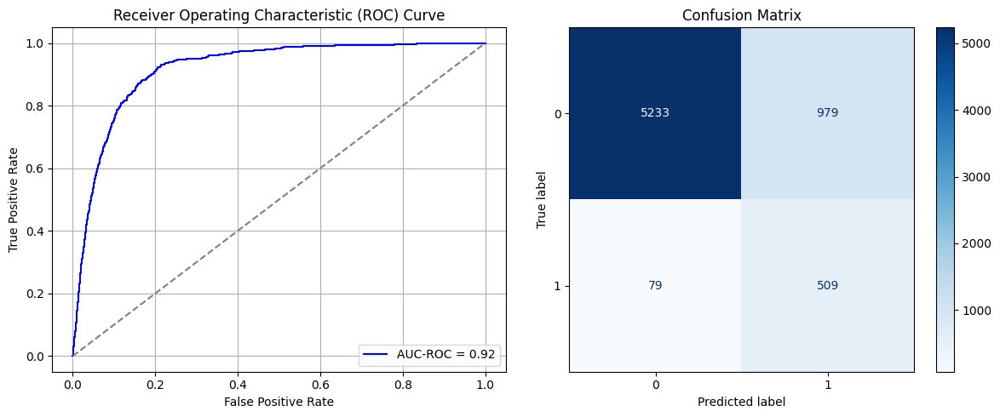

Best threshold based on F1-score: 0.994886577129364
False Negative Rate: 0.13435374149659865
Time elapsed (performance): 1.2840021539996087
(np.float64(0.157598197037991), np.float64(0.8424018029620091))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6700 - loss: 0.6577 - val_AUC: 0.7527 - val_loss: 0.5957
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7835 - loss: 0.5691 - val_AUC: 0.8450 - val_loss: 0.5111
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8608 - loss: 0.4821 - val_AUC: 0.8647 - val_loss: 0.4784
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8756 - loss: 0.4521 - val_AUC: 0.8680 - val_loss: 0.4670
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8805 - loss: 0.4457 - val_AUC: 0.8673 - val_loss: 0.4625
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8830 - loss: 0.4386 - val_AUC: 0.8691 - val_loss: 0.4597
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8743 - loss: 0.4503 - val_AUC: 0.8717 - val_loss: 0.4559
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8846 - loss: 0.4337 - val_AUC: 0.8695 - val_loss: 0.4629
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8857 -

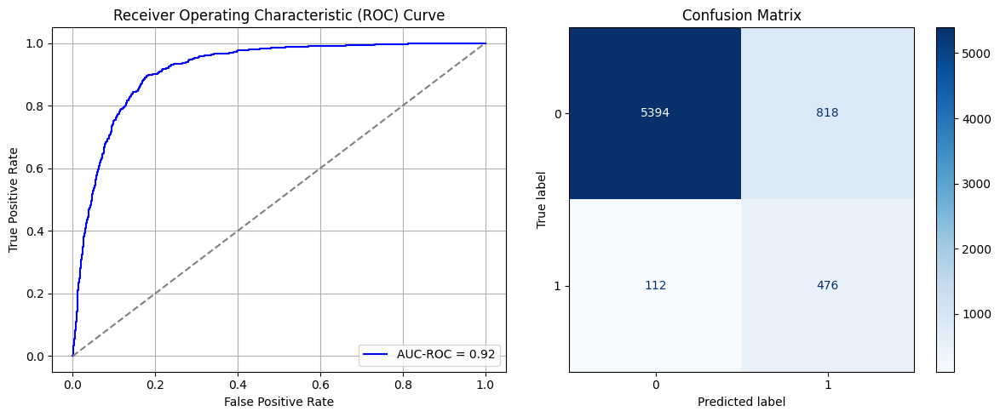

Best threshold based on F1-score: 0.9995165467262268
False Negative Rate: 0.19047619047619047
Time elapsed (performance): 1.28883984300046
(np.float64(0.1316806181584031), np.float64(0.8683193818415968))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6755 - loss: 0.6528 - val_AUC: 0.7699 - val_loss: 0.5809
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8000 - loss: 0.5547 - val_AUC: 0.8545 - val_loss: 0.4973
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8659 - loss: 0.4782 - val_AUC: 0.8719 - val_loss: 0.4587
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8829 - loss: 0.4436 - val_AUC: 0.8762 - val_loss: 0.4477
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8788 - loss: 0.4453 - val_AUC: 0.8773 - val_loss: 0.4508
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8831 - loss: 0.4353 - val_AUC: 0.8795 - val_loss: 0.4534
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8909 - loss: 0.4242 - val_AUC: 0.8777 - val_loss: 0.4441
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8974 - loss: 0.4067 - val_AUC: 0.8797 - val_loss: 0.4355
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8891 -

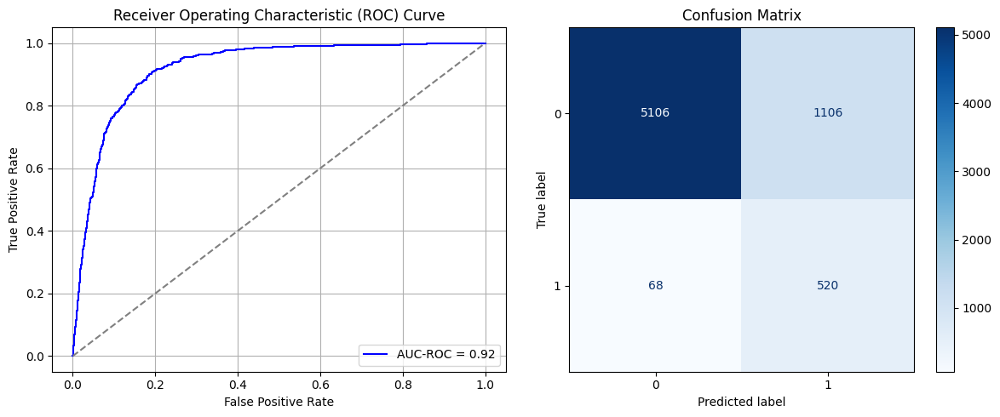

Best threshold based on F1-score: 0.9987515807151794
False Negative Rate: 0.11564625850340136
Time elapsed (performance): 1.0511572100003832
(np.float64(0.1780424983902125), np.float64(0.8219575016097875))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6690 - loss: 0.6542 - val_AUC: 0.7548 - val_loss: 0.5975
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7919 - loss: 0.5614 - val_AUC: 0.8385 - val_loss: 0.5142
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8587 - loss: 0.4838 - val_AUC: 0.8631 - val_loss: 0.4721
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8683 - loss: 0.4618 - val_AUC: 0.8675 - val_loss: 0.4615
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8801 - loss: 0.4426 - val_AUC: 0.8683 - val_loss: 0.4579
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8857 - loss: 0.4311 - val_AUC: 0.8680 - val_loss: 0.4575
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8766 - loss: 0.4450 - val_AUC: 0.8684 - val_loss: 0.4593
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8839 - loss: 0.4330 - val_AUC: 0.8722 - val_loss: 0.4533
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8858 -

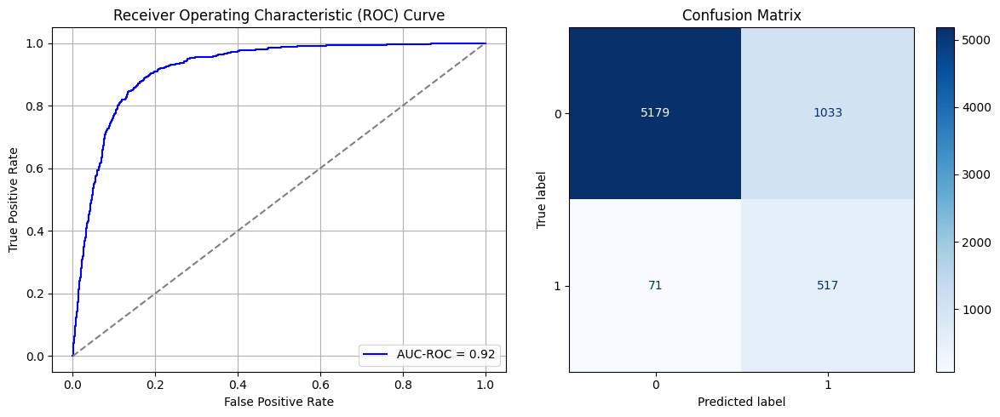

Best threshold based on F1-score: 0.6916190981864929
False Negative Rate: 0.12074829931972789
Time elapsed (performance): 1.0504483760005314
(np.float64(0.16629104958145524), np.float64(0.8337089504185448))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6138 - loss: 0.6644 - val_AUC: 0.7688 - val_loss: 0.6020
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7909 - loss: 0.5580 - val_AUC: 0.8586 - val_loss: 0.5058
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8543 - loss: 0.4861 - val_AUC: 0.8772 - val_loss: 0.4526
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8676 - loss: 0.4598 - val_AUC: 0.8842 - val_loss: 0.4404
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8854 - loss: 0.4343 - val_AUC: 0.8851 - val_loss: 0.4297
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8894 - loss: 0.4244 - val_AUC: 0.8827 - val_loss: 0.4465
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8783 - loss: 0.4439 - val_AUC: 0.8873 - val_loss: 0.4240
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8929 - loss: 0.4159 - val_AUC: 0.8876 - val_loss: 0.4232
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8815 -

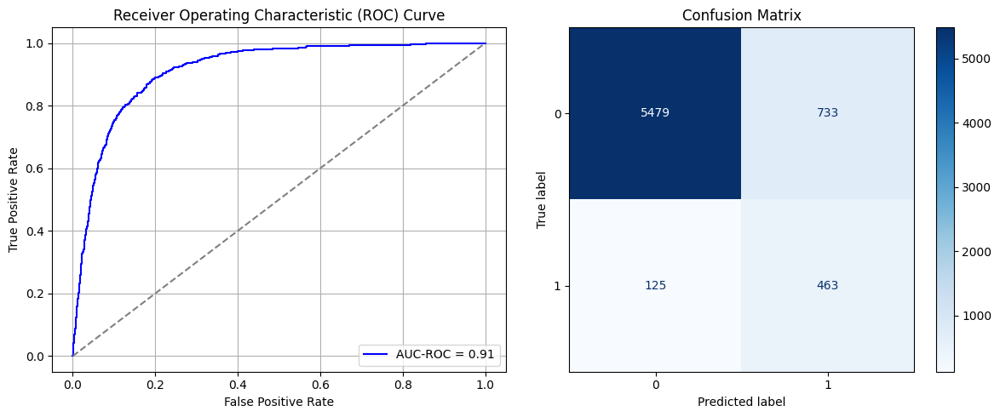

Best threshold based on F1-score: 0.9979143142700195
False Negative Rate: 0.21258503401360543
Time elapsed (performance): 5.451546600999791
(np.float64(0.11799742433998713), np.float64(0.8820025756600128))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6534 - loss: 0.6567 - val_AUC: 0.7445 - val_loss: 0.6012
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.7640 - loss: 0.5828 - val_AUC: 0.8329 - val_loss: 0.5302
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8545 - loss: 0.4959 - val_AUC: 0.8690 - val_loss: 0.4683
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8756 - loss: 0.4556 - val_AUC: 0.8729 - val_loss: 0.4499
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8748 - loss: 0.4502 - val_AUC: 0.8754 - val_loss: 0.4486
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - AUC: 0.8857 - loss: 0.4324 - val_AUC: 0.8759 - val_loss: 0.4428
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8863 - loss: 0.4271 - val_AUC: 0.8736 - val_loss: 0.4489
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8945 - loss: 0.4119 - val_AUC: 0.8770 - val_loss: 0.4406
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8890 -

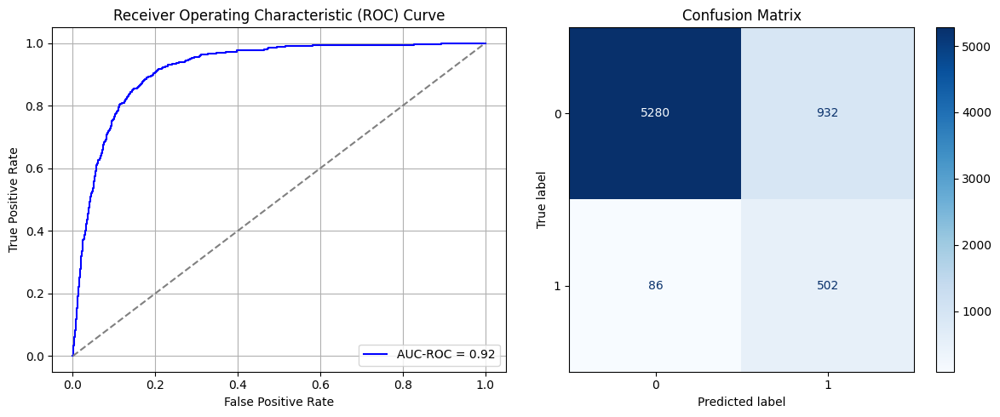

Best threshold based on F1-score: 0.9982837438583374
False Negative Rate: 0.14625850340136054
Time elapsed (performance): 1.214947702000245
(np.float64(0.15003219575016097), np.float64(0.8499678042498391))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6452 - loss: 0.6613 - val_AUC: 0.7725 - val_loss: 0.5751
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8050 - loss: 0.5461 - val_AUC: 0.8514 - val_loss: 0.5104
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8597 - loss: 0.4822 - val_AUC: 0.8741 - val_loss: 0.4593
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8736 - loss: 0.4545 - val_AUC: 0.8781 - val_loss: 0.4498
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8780 - loss: 0.4500 - val_AUC: 0.8782 - val_loss: 0.4542
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8893 - loss: 0.4255 - val_AUC: 0.8786 - val_loss: 0.4456
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8918 - loss: 0.4240 - val_AUC: 0.8804 - val_loss: 0.4435
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8795 - loss: 0.4434 - val_AUC: 0.8818 - val_loss: 0.4392
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8909 -

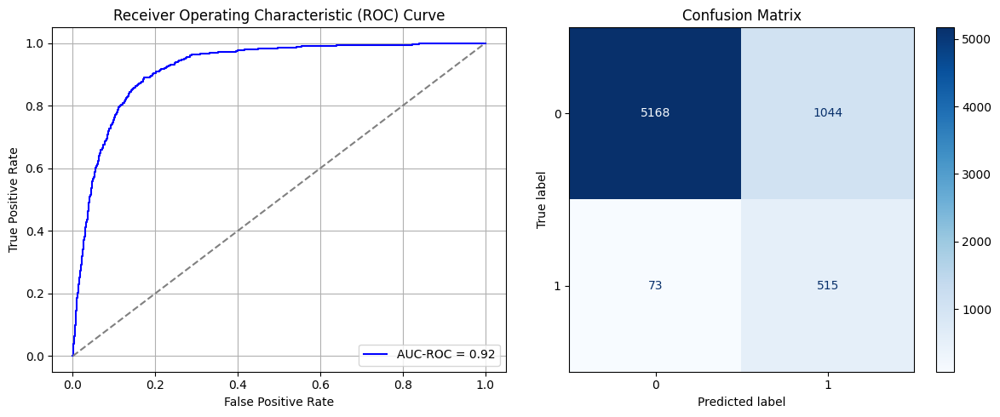

Best threshold based on F1-score: 0.9966088533401489
False Negative Rate: 0.12414965986394558
Time elapsed (performance): 0.988888768999459
(np.float64(0.16806181584030908), np.float64(0.8319381841596909))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6697 - loss: 0.6520 - val_AUC: 0.7572 - val_loss: 0.5959
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7798 - loss: 0.5738 - val_AUC: 0.8461 - val_loss: 0.5102
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8584 - loss: 0.4866 - val_AUC: 0.8763 - val_loss: 0.4585
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8691 - loss: 0.4637 - val_AUC: 0.8826 - val_loss: 0.4409
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8840 - loss: 0.4356 - val_AUC: 0.8838 - val_loss: 0.4390
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8681 - loss: 0.4625 - val_AUC: 0.8864 - val_loss: 0.4444
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8844 - loss: 0.4343 - val_AUC: 0.8867 - val_loss: 0.4319
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8885 - loss: 0.4262 - val_AUC: 0.8883 - val_loss: 0.4331
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8820 -

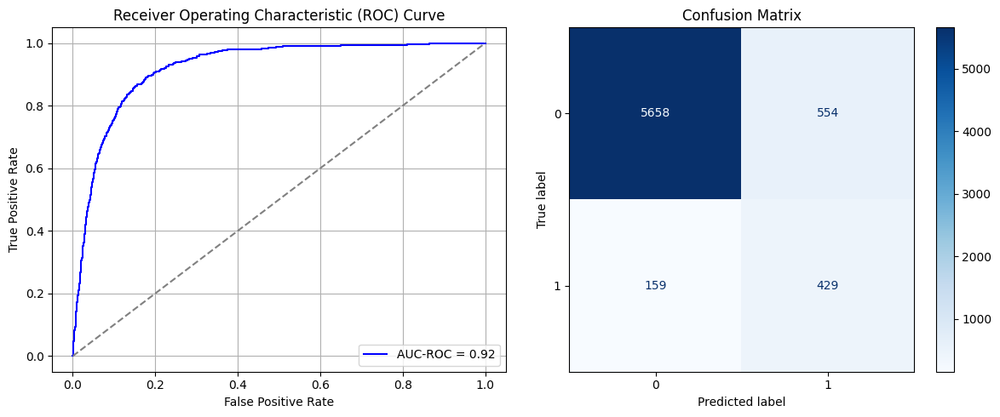

Best threshold based on F1-score: 0.9989683628082275
False Negative Rate: 0.27040816326530615
Time elapsed (performance): 1.1399117119999573
(np.float64(0.08918222794591114), np.float64(0.9108177720540889))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6674 - loss: 0.6541 - val_AUC: 0.7576 - val_loss: 0.5889
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7847 - loss: 0.5645 - val_AUC: 0.8507 - val_loss: 0.5103
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8538 - loss: 0.4969 - val_AUC: 0.8745 - val_loss: 0.4614
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8733 - loss: 0.4548 - val_AUC: 0.8797 - val_loss: 0.4451
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8877 - loss: 0.4277 - val_AUC: 0.8821 - val_loss: 0.4433
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8888 - loss: 0.4255 - val_AUC: 0.8825 - val_loss: 0.4331
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8845 - loss: 0.4282 - val_AUC: 0.8818 - val_loss: 0.4357
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8896 - loss: 0.4203 - val_AUC: 0.8835 - val_loss: 0.4321
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8902 -

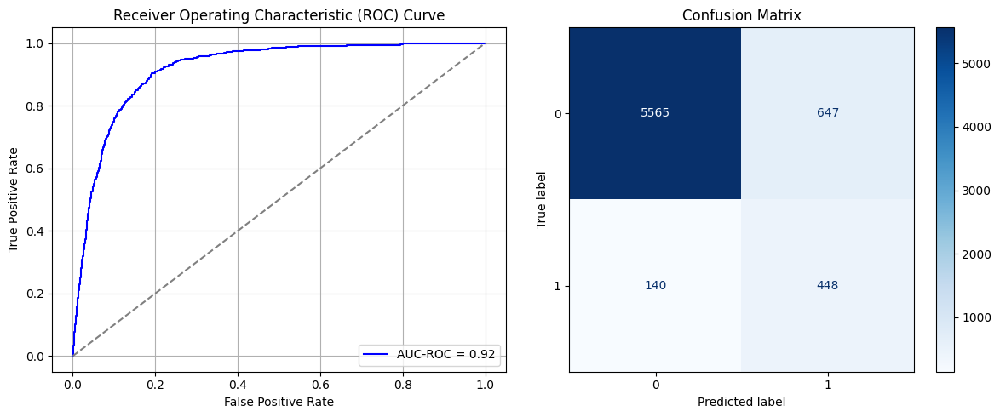

Best threshold based on F1-score: 0.9881413578987122
False Negative Rate: 0.23809523809523808
Time elapsed (performance): 1.1246452159994078
(np.float64(0.10415325177076626), np.float64(0.8958467482292337))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6119 - loss: 0.6681 - val_AUC: 0.7616 - val_loss: 0.5850
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7936 - loss: 0.5564 - val_AUC: 0.8557 - val_loss: 0.4940
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8624 - loss: 0.4809 - val_AUC: 0.8730 - val_loss: 0.4546
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8783 - loss: 0.4482 - val_AUC: 0.8774 - val_loss: 0.4457
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8835 - loss: 0.4340 - val_AUC: 0.8772 - val_loss: 0.4449
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8934 - loss: 0.4167 - val_AUC: 0.8801 - val_loss: 0.4439
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8825 - loss: 0.4346 - val_AUC: 0.8781 - val_loss: 0.4378
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8947 - loss: 0.4109 - val_AUC: 0.8763 - val_loss: 0.4425
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8899 -

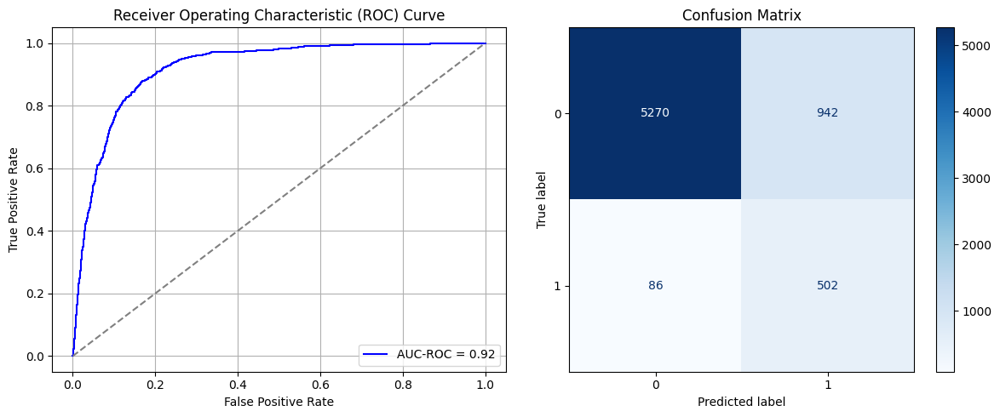

Best threshold based on F1-score: 0.9972490072250366
False Negative Rate: 0.14625850340136054
Time elapsed (performance): 0.9887372359999063
(np.float64(0.1516419832582099), np.float64(0.8483580167417901))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6413 - loss: 0.6626 - val_AUC: 0.7584 - val_loss: 0.5893
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.7821 - loss: 0.5694 - val_AUC: 0.8545 - val_loss: 0.5052
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8567 - loss: 0.4909 - val_AUC: 0.8721 - val_loss: 0.4677
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8690 - loss: 0.4639 - val_AUC: 0.8733 - val_loss: 0.4647
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8783 - loss: 0.4437 - val_AUC: 0.8708 - val_loss: 0.4658
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8809 - loss: 0.4411 - val_AUC: 0.8781 - val_loss: 0.4412
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8955 - loss: 0.4147 - val_AUC: 0.8758 - val_loss: 0.4434
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8811 - loss: 0.4376 - val_AUC: 0.8765 - val_loss: 0.4423
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8819 -

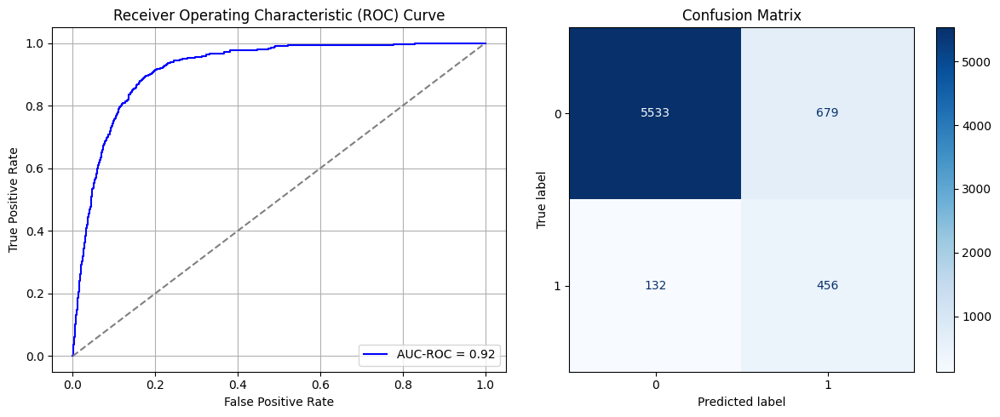

Best threshold based on F1-score: 0.6025999784469604
False Negative Rate: 0.22448979591836735
Time elapsed (performance): 1.2476898009999786
(np.float64(0.10930457179652286), np.float64(0.8906954282034771))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6378 - loss: 0.6618 - val_AUC: 0.7609 - val_loss: 0.5893
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7855 - loss: 0.5665 - val_AUC: 0.8461 - val_loss: 0.5109
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8520 - loss: 0.4944 - val_AUC: 0.8715 - val_loss: 0.4628
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8786 - loss: 0.4483 - val_AUC: 0.8701 - val_loss: 0.4722
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8638 - loss: 0.4677 - val_AUC: 0.8753 - val_loss: 0.4441
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8868 - loss: 0.4282 - val_AUC: 0.8763 - val_loss: 0.4493
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8810 - loss: 0.4384 - val_AUC: 0.8764 - val_loss: 0.4505
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8925 - loss: 0.4192 - val_AUC: 0.8765 - val_loss: 0.4407
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8966 -

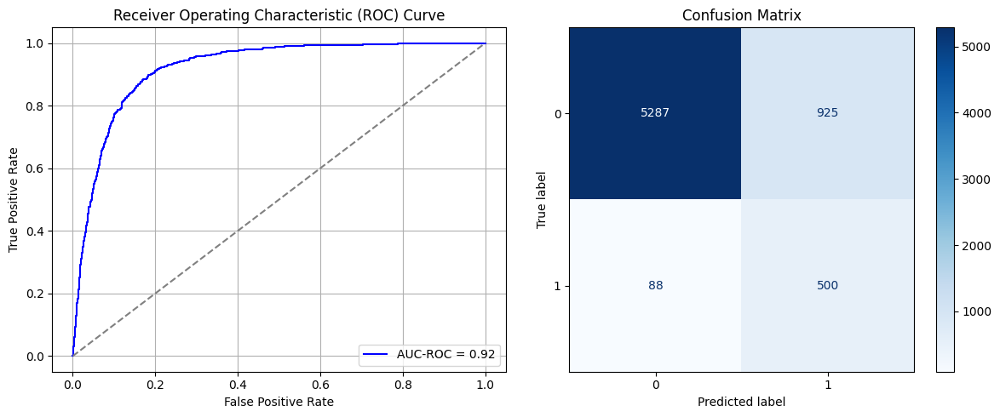

Best threshold based on F1-score: 0.9977033734321594
False Negative Rate: 0.14965986394557823
Time elapsed (performance): 0.9699391080002897
(np.float64(0.14890534449452672), np.float64(0.8510946555054733))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6392 - loss: 0.6585 - val_AUC: 0.7738 - val_loss: 0.5876
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7958 - loss: 0.5569 - val_AUC: 0.8489 - val_loss: 0.5014
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8522 - loss: 0.4888 - val_AUC: 0.8622 - val_loss: 0.4721
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8732 - loss: 0.4526 - val_AUC: 0.8645 - val_loss: 0.4693
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8790 - loss: 0.4411 - val_AUC: 0.8674 - val_loss: 0.4597
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8850 - loss: 0.4317 - val_AUC: 0.8680 - val_loss: 0.4856
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8794 - loss: 0.4408 - val_AUC: 0.8681 - val_loss: 0.4577
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8865 - loss: 0.4257 - val_AUC: 0.8716 - val_loss: 0.4522
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8857 -

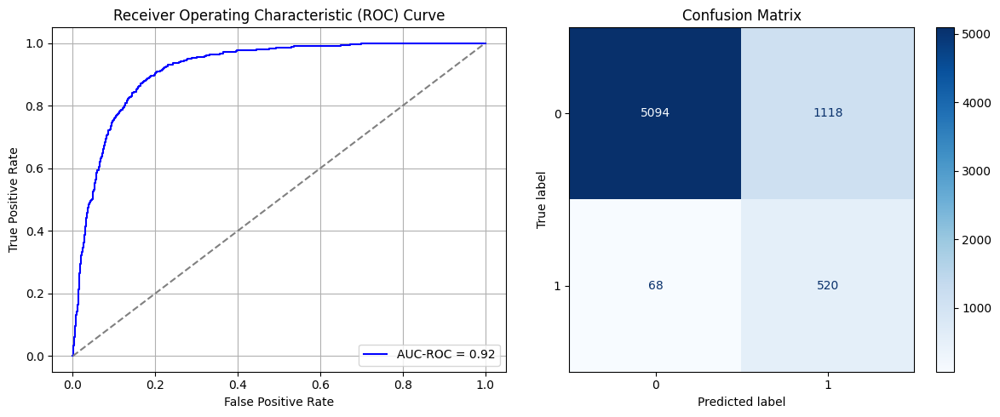

Best threshold based on F1-score: 0.9980069398880005
False Negative Rate: 0.11564625850340136
Time elapsed (performance): 1.140571056999761
(np.float64(0.17997424339987123), np.float64(0.8200257566001288))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6650 - loss: 0.6510 - val_AUC: 0.7593 - val_loss: 0.5876
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7914 - loss: 0.5586 - val_AUC: 0.8441 - val_loss: 0.5287
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8560 - loss: 0.4862 - val_AUC: 0.8657 - val_loss: 0.4716
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8827 - loss: 0.4406 - val_AUC: 0.8664 - val_loss: 0.4668
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8835 - loss: 0.4345 - val_AUC: 0.8693 - val_loss: 0.4563
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8853 - loss: 0.4300 - val_AUC: 0.8711 - val_loss: 0.4582
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8914 - loss: 0.4194 - val_AUC: 0.8735 - val_loss: 0.4551
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8838 - loss: 0.4315 - val_AUC: 0.8740 - val_loss: 0.4475
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8838 -

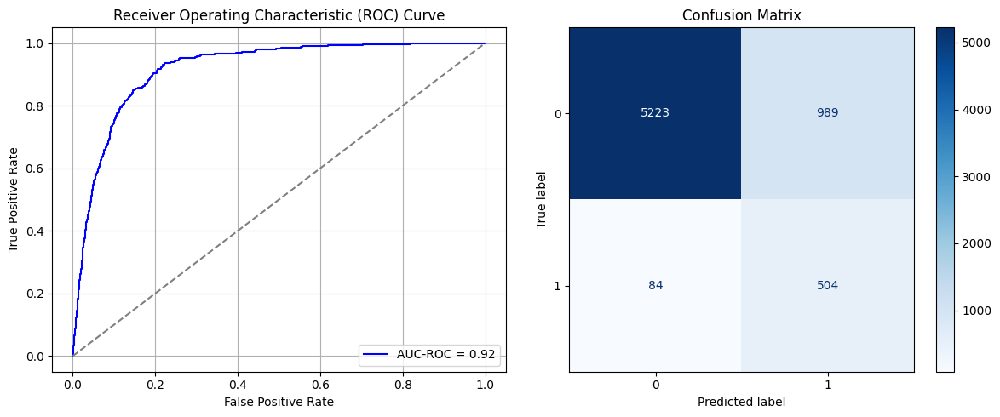

Best threshold based on F1-score: 0.6682463884353638
False Negative Rate: 0.14285714285714285
Time elapsed (performance): 1.1017892780000693
(np.float64(0.15920798454603993), np.float64(0.8407920154539601))
    Source time       FPR       TNR       FNR       TPR  Target time
0      9.826070  0.095138  0.904862  0.260204  0.739796     0.763097
1     11.775620  0.148744  0.851256  0.175170  0.824830     0.765636
2      9.984600  0.091758  0.908242  0.292517  0.707483     0.769324
3      8.371730  0.087411  0.912589  0.275510  0.724490     1.116937
4      8.360161  0.125080  0.874920  0.193878  0.806122     5.069859
5     11.307910  0.089021  0.910979  0.275510  0.724490     1.083105
6     12.487118  0.118319  0.881681  0.204082  0.795918     1.066184
7     12.498987  0.102061  0.897939  0.236395  0.763605     0.833427
8     11.993303  0.150354  0.849646  0.163265  0.836735     0.863349
9     12.151030  0.155023  0.844977  0.153061  0.846939     0.818850
10    12.190948  0.120573  0.87942

In [70]:
import random

times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []

k = oversample_size/undersample_size
print(k)

# np.random.seed(123)

for i in range(times):
    start = random.randint(1, int(k))
    # print(start)

    Row = []

    for j in range(undersample_size):
      row = start+int(k*j)-1
      Row.append(row)

    # print(Row)

    data_S_maj_rus = pd.DataFrame()
    data_S_maj_rus = data_S_majority.iloc[Row]

    data_S_Sy_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_Sy = data_S_Sy_RUS.iloc[:, :-1]
    y_S_Sy = data_S_Sy_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_Sy, y_S_Sy, test_size=0.20, random_state=0)
    model_Sy = create_dnn_model(X_S_train.shape[1])
    result_Sy = train_and_evaluate(model_Sy, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_Sy = Transductive_TL(model_Sy, X_T_full, y_T_full, "Target")
    print(result_TL_Sy[0:2])

    Training_time.append(result_Sy)
    FPR.append(result_TL_Sy[0])
    TNR.append(result_TL_Sy[1])
    FNR.append(result_TL_Sy[2])
    TPR.append(result_TL_Sy[3])
    TL_time.append(result_TL_Sy[4])

# return fpr, tnr, fnr, tpr, time_elapsed

# print(TNR)

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
print(ParamFit)


In [71]:
print(ParamFit)
ParamFit.to_csv('Sy_RUS.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0      9.826070  0.095138  0.904862  0.260204  0.739796     0.763097
1     11.775620  0.148744  0.851256  0.175170  0.824830     0.765636
2      9.984600  0.091758  0.908242  0.292517  0.707483     0.769324
3      8.371730  0.087411  0.912589  0.275510  0.724490     1.116937
4      8.360161  0.125080  0.874920  0.193878  0.806122     5.069859
5     11.307910  0.089021  0.910979  0.275510  0.724490     1.083105
6     12.487118  0.118319  0.881681  0.204082  0.795918     1.066184
7     12.498987  0.102061  0.897939  0.236395  0.763605     0.833427
8     11.993303  0.150354  0.849646  0.163265  0.836735     0.863349
9     12.151030  0.155023  0.844977  0.153061  0.846939     0.818850
10    12.190948  0.120573  0.879427  0.200680  0.799320     1.070621
11    12.731697  0.149066  0.850934  0.154762  0.845238     0.831030
12    12.661391  0.131520  0.868480  0.197279  0.802721     1.061437
13    12.973635  0.105924  0.89407

In [72]:
ParamFit['FNR'].mean()

np.float64(0.20193877551020412)

In [73]:
ParamFit['Source time'].mean()

np.float64(13.152513781279941)

## Systematic Sampling (multiple samples):

Now, we investigate the possibility of conducting $m$ systematic samples, each with a sampling interval of $k=m*\frac{N_0}{N_1}$, and obtaining the undersampled majority class data using all $m$ systematic samples combined. This may more closely approximate SRS sampling.

For convenience, we take $m=10$ in this case.

72.09564628919468
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6553 - loss: 0.6577 - val_AUC: 0.7514 - val_loss: 0.6129
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7893 - loss: 0.5624 - val_AUC: 0.8366 - val_loss: 0.5046
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8573 - loss: 0.4838 - val_AUC: 0.8660 - val_loss: 0.4735
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8812 - loss: 0.4434 - val_AUC: 0.8781 - val_loss: 0.4474
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8827 - loss: 0.4351 - val_AUC: 0.8795 - val_loss: 0.4393
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8837 - loss: 0.4341 - val_AUC: 0.8798 - val_loss: 0.4362
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8739 - loss: 0.4469 - val_AUC: 0.8810 - val_loss: 0.4510
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8833 - loss: 0.4317 - val_AUC: 0.8850 - val_loss: 0.4323
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8904 -

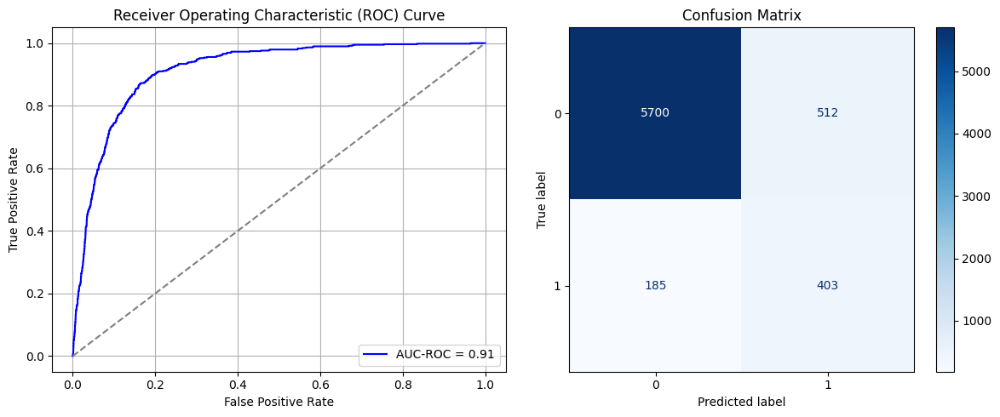

Best threshold based on F1-score: 0.9967053532600403
False Negative Rate: 0.31462585034013607
Time elapsed (performance): 1.0322436119995473
(np.float64(0.0824211204121056), np.float64(0.9175788795878944))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6339 - loss: 0.6622 - val_AUC: 0.7536 - val_loss: 0.5919
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7854 - loss: 0.5651 - val_AUC: 0.8328 - val_loss: 0.5190
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8627 - loss: 0.4792 - val_AUC: 0.8574 - val_loss: 0.4836
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8741 - loss: 0.4569 - val_AUC: 0.8628 - val_loss: 0.4660
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8812 - loss: 0.4404 - val_AUC: 0.8629 - val_loss: 0.4743
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8879 - loss: 0.4266 - val_AUC: 0.8669 - val_loss: 0.4604
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8884 - loss: 0.4262 - val_AUC: 0.8688 - val_loss: 0.4551
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8924 - loss: 0.4177 - val_AUC: 0.8694 - val_loss: 0.4554
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8997 -

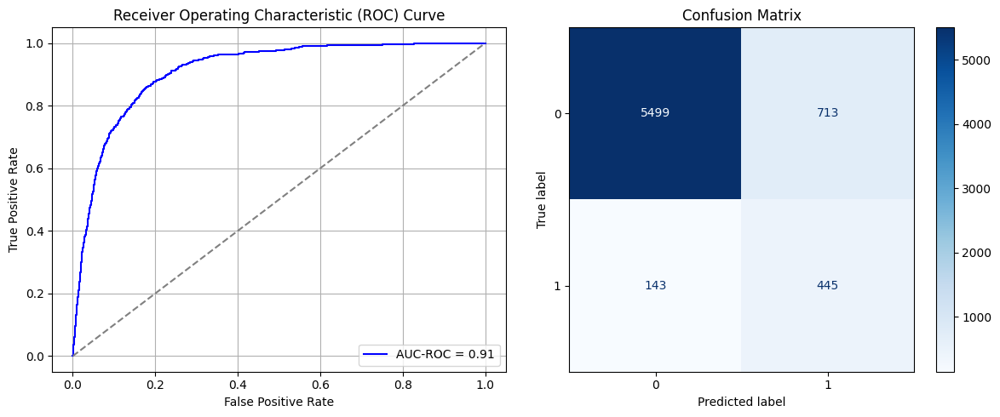

Best threshold based on F1-score: 0.6374825239181519
False Negative Rate: 0.24319727891156462
Time elapsed (performance): 0.8017067209993911
(np.float64(0.11477784932388925), np.float64(0.8852221506761108))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6477 - loss: 0.6597 - val_AUC: 0.7600 - val_loss: 0.5908
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.7964 - loss: 0.5555 - val_AUC: 0.8326 - val_loss: 0.5115
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8626 - loss: 0.4743 - val_AUC: 0.8553 - val_loss: 0.4779
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8715 - loss: 0.4523 - val_AUC: 0.8659 - val_loss: 0.4640
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8796 - loss: 0.4415 - val_AUC: 0.8685 - val_loss: 0.4599
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8821 - loss: 0.4347 - val_AUC: 0.8704 - val_loss: 0.4745
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8851 - loss: 0.4272 - val_AUC: 0.8728 - val_loss: 0.4551
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8883 - loss: 0.4225 - val_AUC: 0.8746 - val_loss: 0.4503
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8937 -

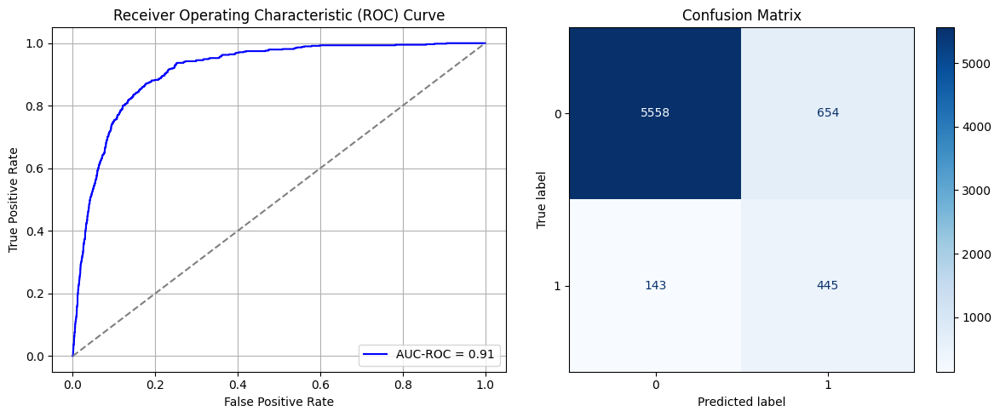

Best threshold based on F1-score: 0.9981804490089417
False Negative Rate: 0.24319727891156462
Time elapsed (performance): 0.7839831889996276
(np.float64(0.10528010302640052), np.float64(0.8947198969735994))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6781 - loss: 0.6466 - val_AUC: 0.7730 - val_loss: 0.5775
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8137 - loss: 0.5405 - val_AUC: 0.8491 - val_loss: 0.4996
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8701 - loss: 0.4692 - val_AUC: 0.8615 - val_loss: 0.4720
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8714 - loss: 0.4568 - val_AUC: 0.8653 - val_loss: 0.4656
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8819 - loss: 0.4383 - val_AUC: 0.8689 - val_loss: 0.4791
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8752 - loss: 0.4480 - val_AUC: 0.8717 - val_loss: 0.4544
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8857 - loss: 0.4275 - val_AUC: 0.8722 - val_loss: 0.4575
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8928 - loss: 0.4180 - val_AUC: 0.8743 - val_loss: 0.4494
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8867 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9171613751746673
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.37      0.81      0.51       588

    accuracy                           0.87      6800
   macro avg       0.68      0.84      0.72      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.12830006439150032 TPR: 0.8129251700680272 FNR: 0.1870748299319728 TNR: 0.8716999356084997


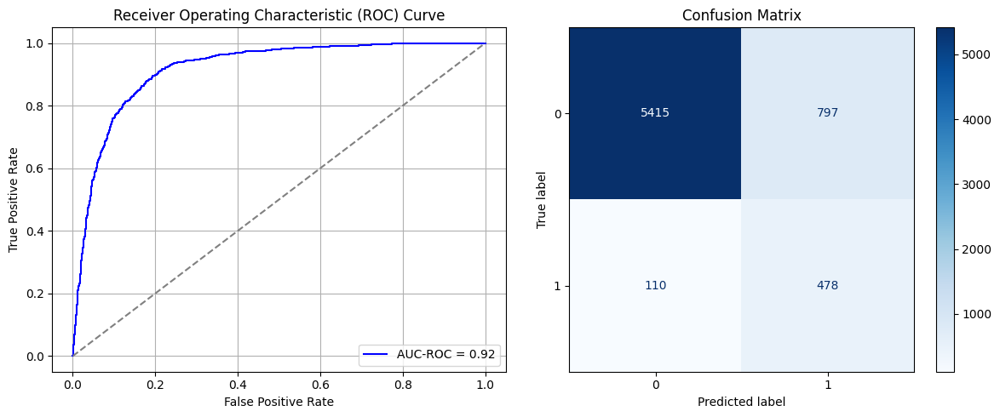

Best threshold based on F1-score: 0.706899881362915
False Negative Rate: 0.1870748299319728
Time elapsed (performance): 0.7956736750002165
(np.float64(0.12830006439150032), np.float64(0.8716999356084997))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6441 - loss: 0.6629 - val_AUC: 0.7539 - val_loss: 0.5928
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8037 - loss: 0.5479 - val_AUC: 0.8306 - val_loss: 0.5147
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8623 - loss: 0.4771 - val_AUC: 0.8560 - val_loss: 0.4874
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8834 - loss: 0.4361 - val_AUC: 0.8538 - val_loss: 0.4849
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8849 - loss: 0.4318 - val_AUC: 0.8577 - val_loss: 0.4772
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8803 - loss: 0.4390 - val_AUC: 0.8584 - val_loss: 0.4750
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8832 - loss: 0.4329 - val_AUC: 0.8615 - val_loss: 0.4718
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8922 - loss: 0.4151 - val_AUC: 0.8608 - val_loss: 0.4794
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8897 -

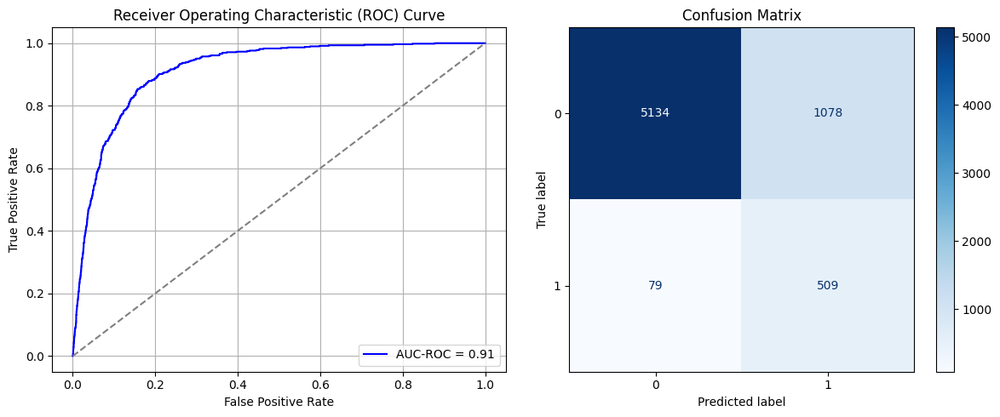

Best threshold based on F1-score: 0.9981495141983032
False Negative Rate: 0.13435374149659865
Time elapsed (performance): 0.8151853309991566
(np.float64(0.17353509336767547), np.float64(0.8264649066323245))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6355 - loss: 0.6676 - val_AUC: 0.7385 - val_loss: 0.6073
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7572 - loss: 0.5856 - val_AUC: 0.8158 - val_loss: 0.5369
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8268 - loss: 0.5213 - val_AUC: 0.8528 - val_loss: 0.4833
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8666 - loss: 0.4640 - val_AUC: 0.8697 - val_loss: 0.4609
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8702 - loss: 0.4548 - val_AUC: 0.8688 - val_loss: 0.4661
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8715 - loss: 0.4508 - val_AUC: 0.8729 - val_loss: 0.4484
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8851 - loss: 0.4277 - val_AUC: 0.8722 - val_loss: 0.4517
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8849 - loss: 0.4269 - val_AUC: 0.8744 - val_loss: 0.4606
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8866 -

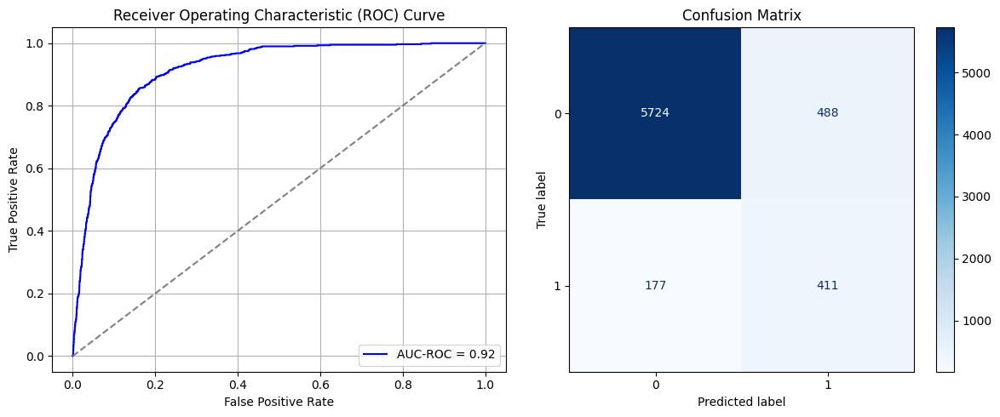

Best threshold based on F1-score: 0.9951257705688477
False Negative Rate: 0.3010204081632653
Time elapsed (performance): 1.0577764460003891
(np.float64(0.07855763039278815), np.float64(0.9214423696072118))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6267 - loss: 0.6661 - val_AUC: 0.7543 - val_loss: 0.5930
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7805 - loss: 0.5726 - val_AUC: 0.8387 - val_loss: 0.5120
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8490 - loss: 0.4932 - val_AUC: 0.8681 - val_loss: 0.4722
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8762 - loss: 0.4518 - val_AUC: 0.8731 - val_loss: 0.4747
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8743 - loss: 0.4515 - val_AUC: 0.8755 - val_loss: 0.4497
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8777 - loss: 0.4420 - val_AUC: 0.8799 - val_loss: 0.4406
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8779 - loss: 0.4403 - val_AUC: 0.8766 - val_loss: 0.4502
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8797 - loss: 0.4383 - val_AUC: 0.8824 - val_loss: 0.4340
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8833 -

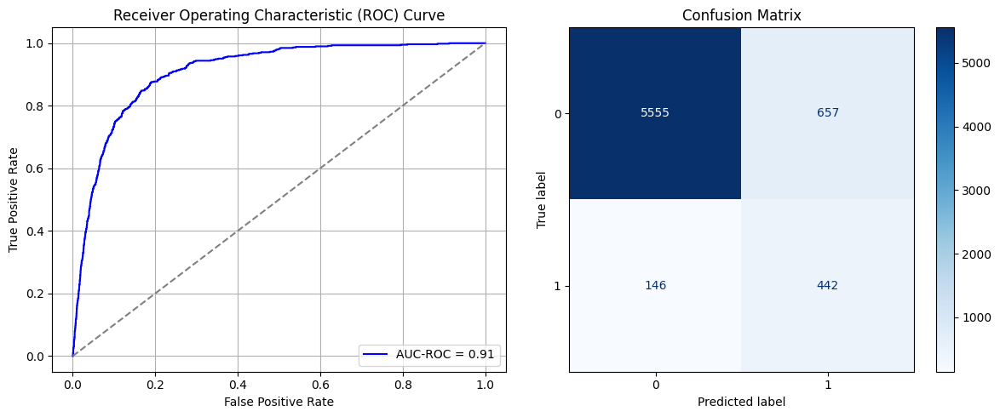

Best threshold based on F1-score: 0.5803914070129395
False Negative Rate: 0.24829931972789115
Time elapsed (performance): 0.7881310210004813
(np.float64(0.1057630392788152), np.float64(0.8942369607211849))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6915 - loss: 0.6587 - val_AUC: 0.7644 - val_loss: 0.5886
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7903 - loss: 0.5619 - val_AUC: 0.8356 - val_loss: 0.5279
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8533 - loss: 0.4903 - val_AUC: 0.8701 - val_loss: 0.4586
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8824 - loss: 0.4416 - val_AUC: 0.8775 - val_loss: 0.4463
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8874 - loss: 0.4318 - val_AUC: 0.8781 - val_loss: 0.4435
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8895 - loss: 0.4254 - val_AUC: 0.8778 - val_loss: 0.4573
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8875 - loss: 0.4278 - val_AUC: 0.8821 - val_loss: 0.4342
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8937 - loss: 0.4198 - val_AUC: 0.8810 - val_loss: 0.4350
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8976 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9152627567446812
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.90      0.93      6212
           1       0.41      0.76      0.53       588

    accuracy                           0.88      6800
   macro avg       0.69      0.83      0.73      6800
weighted avg       0.93      0.88      0.90      6800

FPR 0.10431423052157116 TPR: 0.7602040816326531 FNR: 0.23979591836734693 TNR: 0.8956857694784288


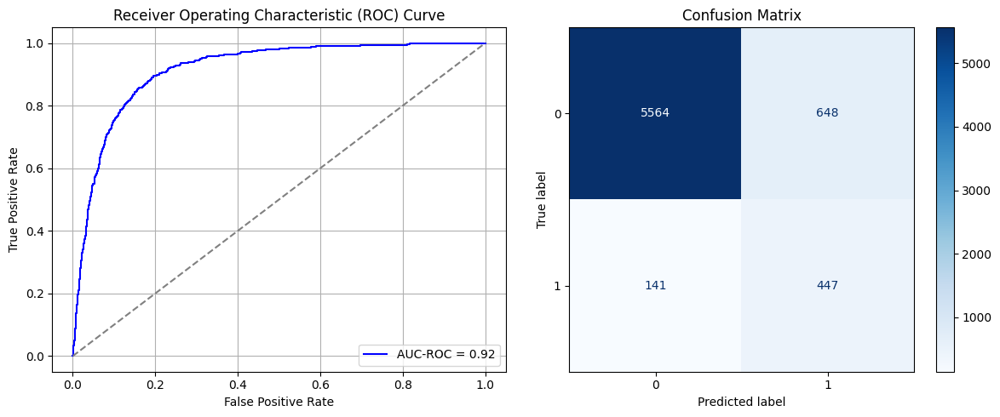

Best threshold based on F1-score: 0.998746395111084
False Negative Rate: 0.23979591836734693
Time elapsed (performance): 0.8089594359998955
(np.float64(0.10431423052157116), np.float64(0.8956857694784288))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6066 - loss: 0.6674 - val_AUC: 0.7638 - val_loss: 0.5851
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8044 - loss: 0.5459 - val_AUC: 0.8504 - val_loss: 0.4956
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8610 - loss: 0.4776 - val_AUC: 0.8689 - val_loss: 0.4633
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8799 - loss: 0.4421 - val_AUC: 0.8748 - val_loss: 0.4579
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8847 - loss: 0.4333 - val_AUC: 0.8754 - val_loss: 0.4466
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8918 - loss: 0.4187 - val_AUC: 0.8764 - val_loss: 0.4481
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8840 - loss: 0.4322 - val_AUC: 0.8802 - val_loss: 0.4381
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8937 - loss: 0.4159 - val_AUC: 0.8796 - val_loss: 0.4423
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9016 -

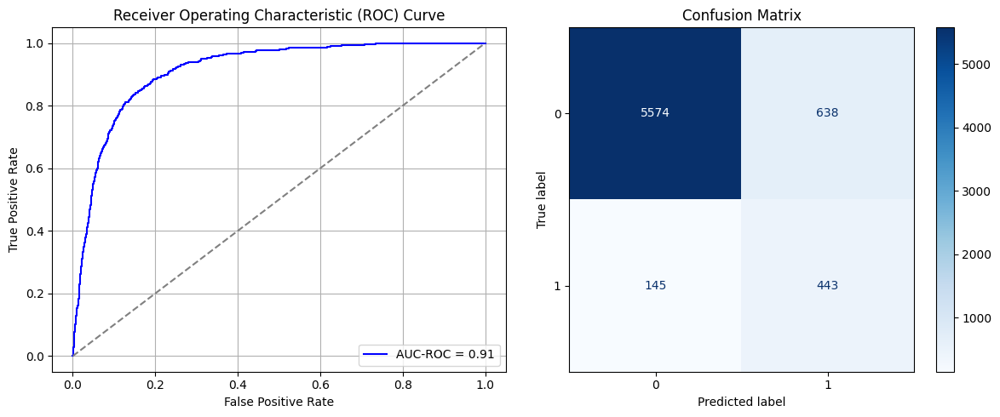

Best threshold based on F1-score: 0.6282841563224792
False Negative Rate: 0.2465986394557823
Time elapsed (performance): 1.057432204000179
(np.float64(0.10270444301352222), np.float64(0.8972955569864778))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6542 - loss: 0.6563 - val_AUC: 0.7518 - val_loss: 0.5964
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7840 - loss: 0.5654 - val_AUC: 0.8374 - val_loss: 0.5135
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8539 - loss: 0.4871 - val_AUC: 0.8591 - val_loss: 0.4780
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8594 - loss: 0.4716 - val_AUC: 0.8661 - val_loss: 0.4598
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8735 - loss: 0.4491 - val_AUC: 0.8695 - val_loss: 0.4596
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8846 - loss: 0.4303 - val_AUC: 0.8694 - val_loss: 0.4523
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8865 - loss: 0.4254 - val_AUC: 0.8741 - val_loss: 0.4440
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8740 - loss: 0.4442 - val_AUC: 0.8733 - val_loss: 0.4459
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8828 -

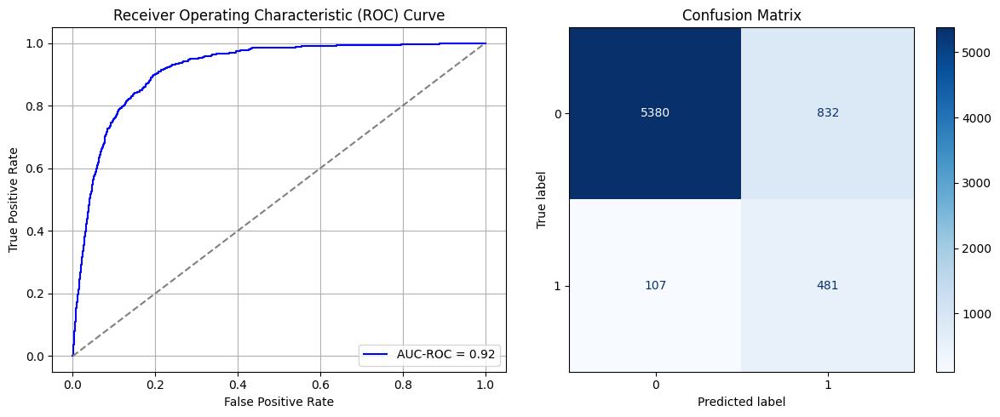

Best threshold based on F1-score: 0.996396541595459
False Negative Rate: 0.18197278911564627
Time elapsed (performance): 1.0545078770001055
(np.float64(0.1339343206696716), np.float64(0.8660656793303284))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6416 - loss: 0.6607 - val_AUC: 0.7703 - val_loss: 0.5836
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7899 - loss: 0.5616 - val_AUC: 0.8450 - val_loss: 0.5027
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8613 - loss: 0.4791 - val_AUC: 0.8745 - val_loss: 0.4553
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8734 - loss: 0.4537 - val_AUC: 0.8825 - val_loss: 0.4407
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8766 - loss: 0.4471 - val_AUC: 0.8826 - val_loss: 0.4360
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8824 - loss: 0.4335 - val_AUC: 0.8869 - val_loss: 0.4319
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8867 - loss: 0.4260 - val_AUC: 0.8859 - val_loss: 0.4304
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8877 - loss: 0.4211 - val_AUC: 0.8843 - val_loss: 0.4308
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8899 -

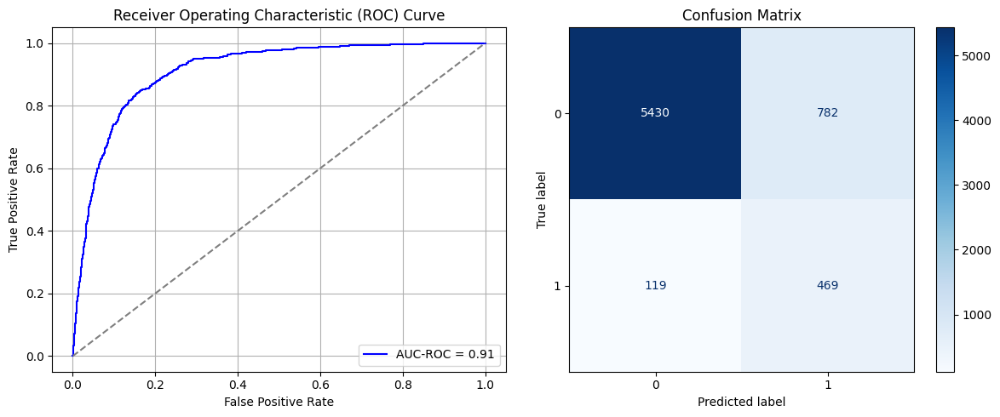

Best threshold based on F1-score: 0.701093852519989
False Negative Rate: 0.20238095238095238
Time elapsed (performance): 0.8062200979993577
(np.float64(0.1258853831294269), np.float64(0.8741146168705731))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6949 - loss: 0.6469 - val_AUC: 0.7665 - val_loss: 0.5848
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7969 - loss: 0.5565 - val_AUC: 0.8374 - val_loss: 0.5230
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8546 - loss: 0.4869 - val_AUC: 0.8635 - val_loss: 0.4742
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8787 - loss: 0.4491 - val_AUC: 0.8736 - val_loss: 0.4559
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8816 - loss: 0.4430 - val_AUC: 0.8770 - val_loss: 0.4481
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8843 - loss: 0.4337 - val_AUC: 0.8767 - val_loss: 0.4471
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8919 - loss: 0.4252 - val_AUC: 0.8778 - val_loss: 0.4424
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8902 - loss: 0.4224 - val_AUC: 0.8740 - val_loss: 0.4500
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8937 -

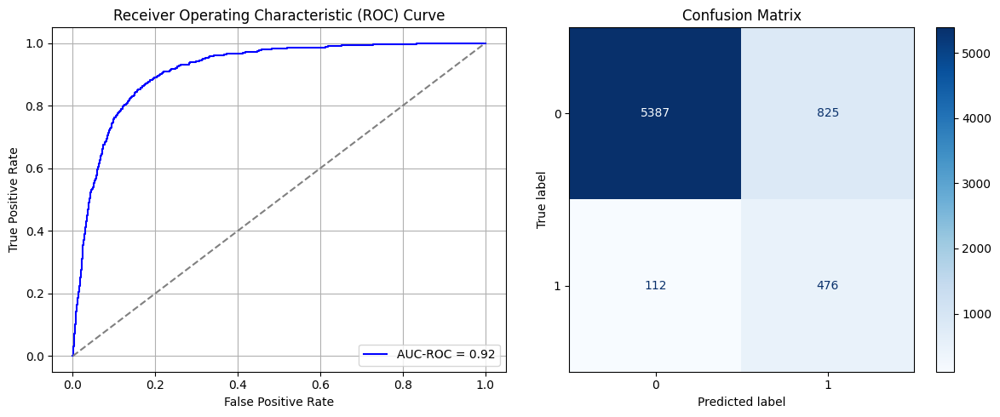

Best threshold based on F1-score: 0.9975414276123047
False Negative Rate: 0.19047619047619047
Time elapsed (performance): 0.82713651999984
(np.float64(0.13280746941403734), np.float64(0.8671925305859627))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6413 - loss: 0.6607 - val_AUC: 0.7587 - val_loss: 0.5963
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7890 - loss: 0.5597 - val_AUC: 0.8285 - val_loss: 0.5422
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8489 - loss: 0.4936 - val_AUC: 0.8541 - val_loss: 0.4820
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8743 - loss: 0.4542 - val_AUC: 0.8636 - val_loss: 0.4663
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8647 - loss: 0.4631 - val_AUC: 0.8657 - val_loss: 0.4613
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8776 - loss: 0.4420 - val_AUC: 0.8679 - val_loss: 0.4552
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8813 - loss: 0.4334 - val_AUC: 0.8681 - val_loss: 0.4540
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8840 - loss: 0.4274 - val_AUC: 0.8708 - val_loss: 0.4570
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8713 -

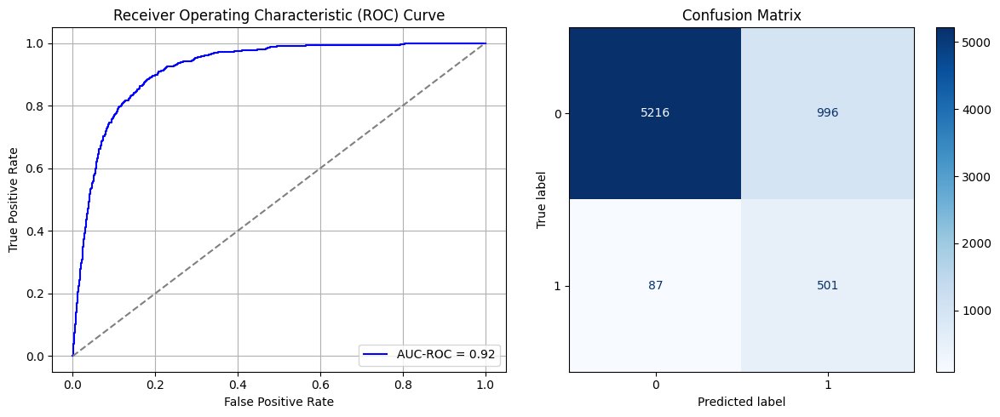

Best threshold based on F1-score: 0.9893438816070557
False Negative Rate: 0.14795918367346939
Time elapsed (performance): 1.0521152319997782
(np.float64(0.16033483580167418), np.float64(0.8396651641983258))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.7004 - loss: 0.6487 - val_AUC: 0.7803 - val_loss: 0.5685
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8080 - loss: 0.5420 - val_AUC: 0.8509 - val_loss: 0.4920
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8608 - loss: 0.4796 - val_AUC: 0.8648 - val_loss: 0.4662
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8700 - loss: 0.4582 - val_AUC: 0.8729 - val_loss: 0.4533
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8731 - loss: 0.4504 - val_AUC: 0.8741 - val_loss: 0.4460
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8854 - loss: 0.4300 - val_AUC: 0.8765 - val_loss: 0.4422
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8800 - loss: 0.4372 - val_AUC: 0.8778 - val_loss: 0.4421
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8831 - loss: 0.4327 - val_AUC: 0.8784 - val_loss: 0.4403
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8850 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9172960716804429
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.83      0.90      6212
           1       0.32      0.86      0.47       588

    accuracy                           0.83      6800
   macro avg       0.65      0.85      0.68      6800
weighted avg       0.93      0.83      0.86      6800

FPR 0.17305215711526079 TPR: 0.8639455782312925 FNR: 0.1360544217687075 TNR: 0.8269478428847392


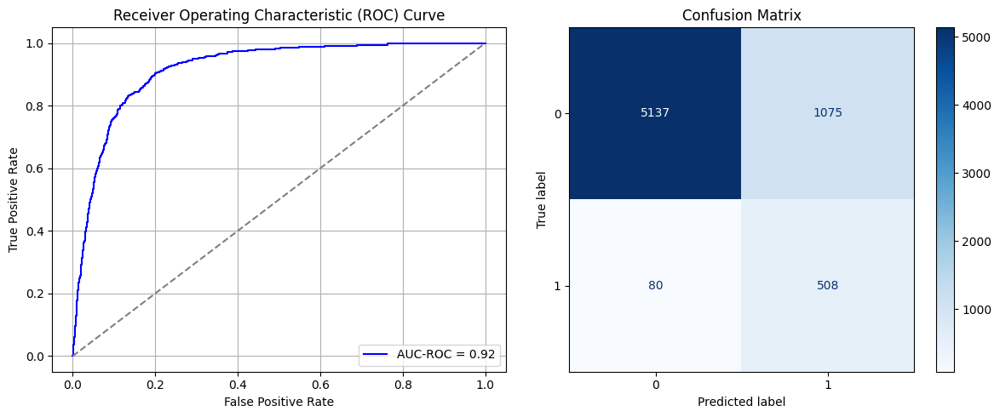

Best threshold based on F1-score: 0.9953895211219788
False Negative Rate: 0.1360544217687075
Time elapsed (performance): 1.042517251999925
(np.float64(0.17305215711526079), np.float64(0.8269478428847392))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6752 - loss: 0.6475 - val_AUC: 0.7719 - val_loss: 0.5741
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7954 - loss: 0.5538 - val_AUC: 0.8453 - val_loss: 0.5007
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8624 - loss: 0.4802 - val_AUC: 0.8676 - val_loss: 0.4643
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8771 - loss: 0.4510 - val_AUC: 0.8727 - val_loss: 0.4653
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8845 - loss: 0.4328 - val_AUC: 0.8734 - val_loss: 0.4555
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8760 - loss: 0.4442 - val_AUC: 0.8750 - val_loss: 0.4664
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8778 - loss: 0.4388 - val_AUC: 0.8777 - val_loss: 0.4406
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8883 - loss: 0.4241 - val_AUC: 0.8760 - val_loss: 0.4428
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8878 -

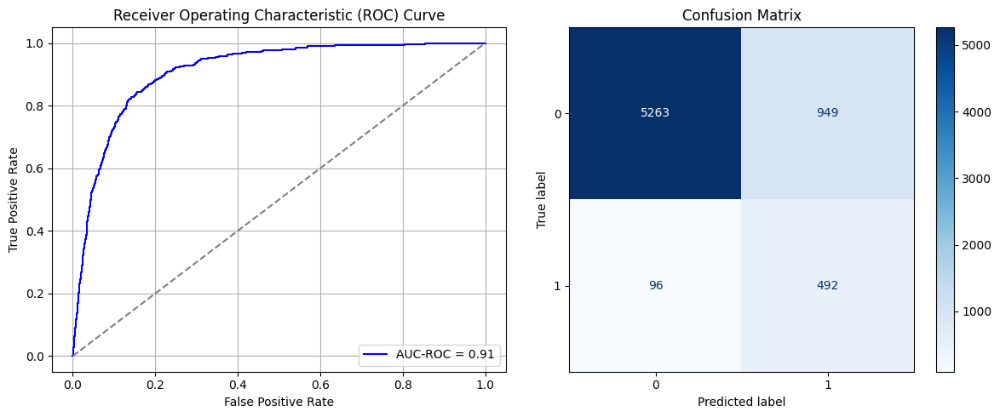

Best threshold based on F1-score: 0.9960312843322754
False Negative Rate: 0.16326530612244897
Time elapsed (performance): 1.0489427699994849
(np.float64(0.15276883451384418), np.float64(0.8472311654861558))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6695 - loss: 0.6503 - val_AUC: 0.7432 - val_loss: 0.5979
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7860 - loss: 0.5606 - val_AUC: 0.8283 - val_loss: 0.5244
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8514 - loss: 0.4930 - val_AUC: 0.8625 - val_loss: 0.4736
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8673 - loss: 0.4600 - val_AUC: 0.8678 - val_loss: 0.4594
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8801 - loss: 0.4383 - val_AUC: 0.8738 - val_loss: 0.4508
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8836 - loss: 0.4343 - val_AUC: 0.8775 - val_loss: 0.4446
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8804 - loss: 0.4357 - val_AUC: 0.8794 - val_loss: 0.4532
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8792 - loss: 0.4371 - val_AUC: 0.8768 - val_loss: 0.4468
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8869 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9119087589961935
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.85      0.91      6212
           1       0.35      0.83      0.49       588

    accuracy                           0.85      6800
   macro avg       0.66      0.84      0.70      6800
weighted avg       0.93      0.85      0.88      6800

FPR 0.14842240824211203 TPR: 0.826530612244898 FNR: 0.17346938775510204 TNR: 0.8515775917578879


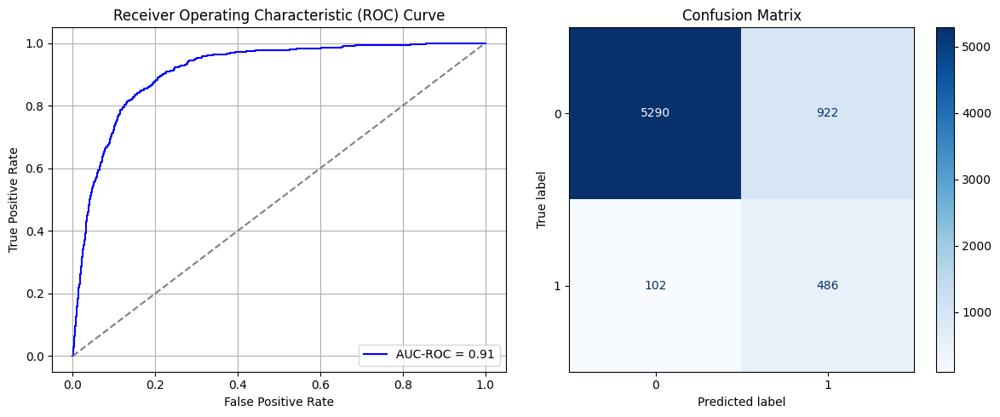

Best threshold based on F1-score: 0.9968301057815552
False Negative Rate: 0.17346938775510204
Time elapsed (performance): 1.0659701260001384
(np.float64(0.14842240824211203), np.float64(0.8515775917578879))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6672 - loss: 0.6544 - val_AUC: 0.7700 - val_loss: 0.5815
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7973 - loss: 0.5528 - val_AUC: 0.8376 - val_loss: 0.5202
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8639 - loss: 0.4738 - val_AUC: 0.8707 - val_loss: 0.4604
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8693 - loss: 0.4625 - val_AUC: 0.8711 - val_loss: 0.4505
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8841 - loss: 0.4336 - val_AUC: 0.8750 - val_loss: 0.4457
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8846 - loss: 0.4336 - val_AUC: 0.8773 - val_loss: 0.4587
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8854 - loss: 0.4307 - val_AUC: 0.8780 - val_loss: 0.4382
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8922 - loss: 0.4190 - val_AUC: 0.8783 - val_loss: 0.4433
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8828 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.912332560197292
Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.91      0.94      6212
           1       0.42      0.72      0.53       588

    accuracy                           0.89      6800
   macro avg       0.70      0.81      0.74      6800
weighted avg       0.92      0.89      0.90      6800

FPR 0.0928847392144237 TPR: 0.7210884353741497 FNR: 0.2789115646258503 TNR: 0.9071152607855764


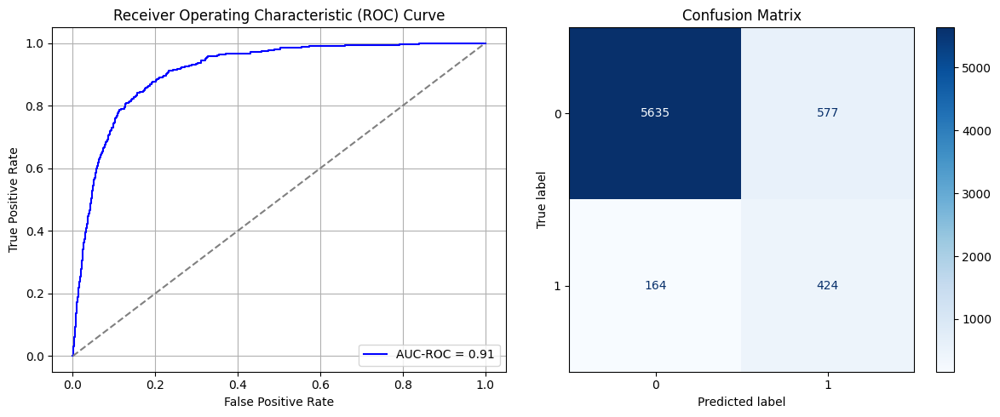

Best threshold based on F1-score: 0.9936076998710632
False Negative Rate: 0.2789115646258503
Time elapsed (performance): 0.8577563849994476
(np.float64(0.0928847392144237), np.float64(0.9071152607855764))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6930 - loss: 0.6460 - val_AUC: 0.7440 - val_loss: 0.6057
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7920 - loss: 0.5621 - val_AUC: 0.8304 - val_loss: 0.5180
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8524 - loss: 0.4961 - val_AUC: 0.8657 - val_loss: 0.4703
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8756 - loss: 0.4589 - val_AUC: 0.8700 - val_loss: 0.4590
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8794 - loss: 0.4423 - val_AUC: 0.8748 - val_loss: 0.4488
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8839 - loss: 0.4373 - val_AUC: 0.8743 - val_loss: 0.4495
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8825 - loss: 0.4375 - val_AUC: 0.8751 - val_loss: 0.4443
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8780 - loss: 0.4438 - val_AUC: 0.8776 - val_loss: 0.4399
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8872 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9146703111379774
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.89      0.93      6212
           1       0.40      0.78      0.52       588

    accuracy                           0.88      6800
   macro avg       0.69      0.83      0.73      6800
weighted avg       0.93      0.88      0.89      6800

FPR 0.11236316806181584 TPR: 0.7755102040816326 FNR: 0.22448979591836735 TNR: 0.8876368319381842


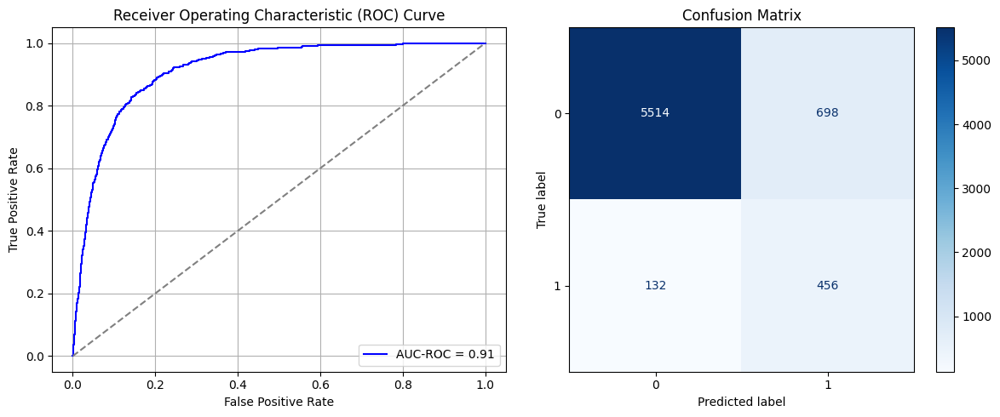

Best threshold based on F1-score: 0.9970859885215759
False Negative Rate: 0.22448979591836735
Time elapsed (performance): 0.8600416159997621
(np.float64(0.11236316806181584), np.float64(0.8876368319381842))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6975 - loss: 0.6419 - val_AUC: 0.7775 - val_loss: 0.5733
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8057 - loss: 0.5449 - val_AUC: 0.8467 - val_loss: 0.5003
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8617 - loss: 0.4761 - val_AUC: 0.8702 - val_loss: 0.4684
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8743 - loss: 0.4513 - val_AUC: 0.8738 - val_loss: 0.4492
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8779 - loss: 0.4433 - val_AUC: 0.8767 - val_loss: 0.4454
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8870 - loss: 0.4259 - val_AUC: 0.8774 - val_loss: 0.4469
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8827 - loss: 0.4328 - val_AUC: 0.8755 - val_loss: 0.4692
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8798 - loss: 0.4339 - val_AUC: 0.8776 - val_loss: 0.4403
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8812 -

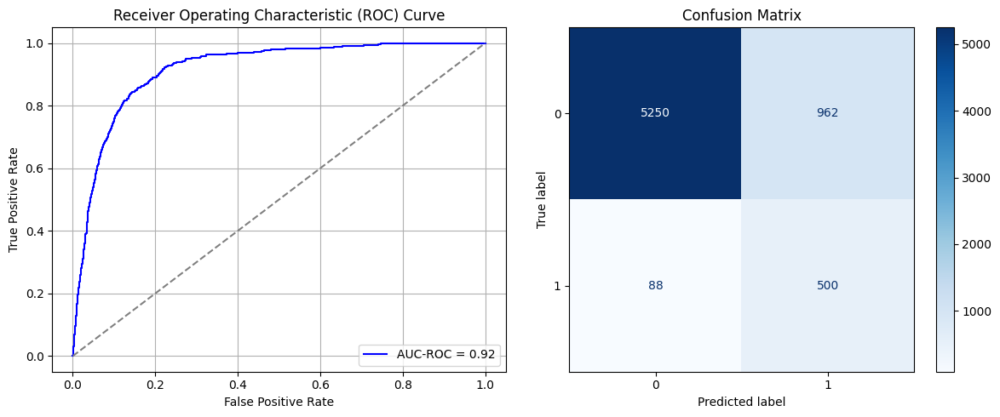

Best threshold based on F1-score: 0.9885933995246887
False Negative Rate: 0.14965986394557823
Time elapsed (performance): 1.0743771190000189
(np.float64(0.15486155827430778), np.float64(0.8451384417256922))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6572 - loss: 0.6532 - val_AUC: 0.7604 - val_loss: 0.5860
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.7806 - loss: 0.5681 - val_AUC: 0.8342 - val_loss: 0.5129
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8515 - loss: 0.4910 - val_AUC: 0.8637 - val_loss: 0.4700
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8746 - loss: 0.4518 - val_AUC: 0.8723 - val_loss: 0.4588
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8755 - loss: 0.4483 - val_AUC: 0.8730 - val_loss: 0.4587
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8796 - loss: 0.4435 - val_AUC: 0.8739 - val_loss: 0.4538
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8878 - loss: 0.4256 - val_AUC: 0.8762 - val_loss: 0.4506
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8910 - loss: 0.4261 - val_AUC: 0.8793 - val_loss: 0.4445
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8924 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
AUC-ROC: 0.9157500733712673
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.38      0.80      0.51       588

    accuracy                           0.87      6800
   macro avg       0.68      0.84      0.72      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.12556342562781714 TPR: 0.7993197278911565 FNR: 0.20068027210884354 TNR: 0.8744365743721829


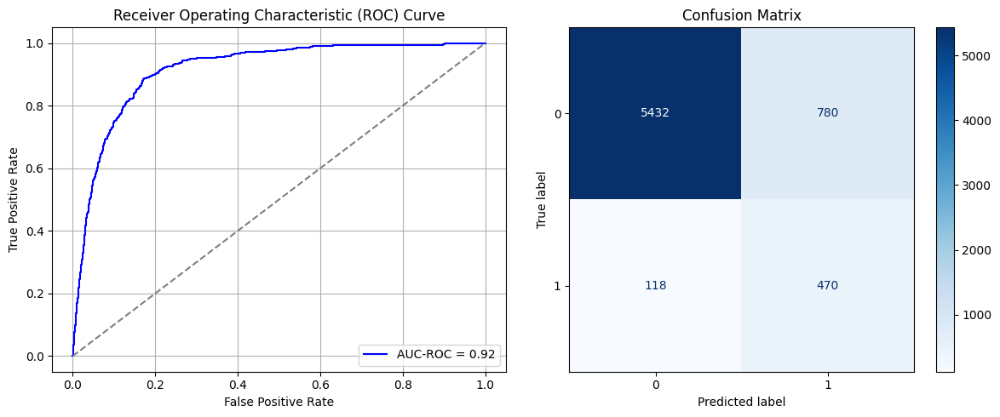

Best threshold based on F1-score: 0.9995362758636475
False Negative Rate: 0.20068027210884354
Time elapsed (performance): 1.7285083269998722
(np.float64(0.12556342562781714), np.float64(0.8744365743721829))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step - AUC: 0.6604 - loss: 0.6570 - val_AUC: 0.7477 - val_loss: 0.5966
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7810 - loss: 0.5661 - val_AUC: 0.8296 - val_loss: 0.5174
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8529 - loss: 0.4878 - val_AUC: 0.8576 - val_loss: 0.4767
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8775 - loss: 0.4489 - val_AUC: 0.8669 - val_loss: 0.4620
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8785 - loss: 0.4433 - val_AUC: 0.8700 - val_loss: 0.4857
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8784 - loss: 0.4421 - val_AUC: 0.8702 - val_loss: 0.4524
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8788 - loss: 0.4392 - val_AUC: 0.8724 - val_loss: 0.4483
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8880 - loss: 0.4229 - val_AUC: 0.8734 - val_loss: 0.4458
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8817 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9185157321138372
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.38      0.81      0.52       588

    accuracy                           0.87      6800
   macro avg       0.68      0.84      0.72      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.1265292981326465 TPR: 0.814625850340136 FNR: 0.18537414965986396 TNR: 0.8734707018673535


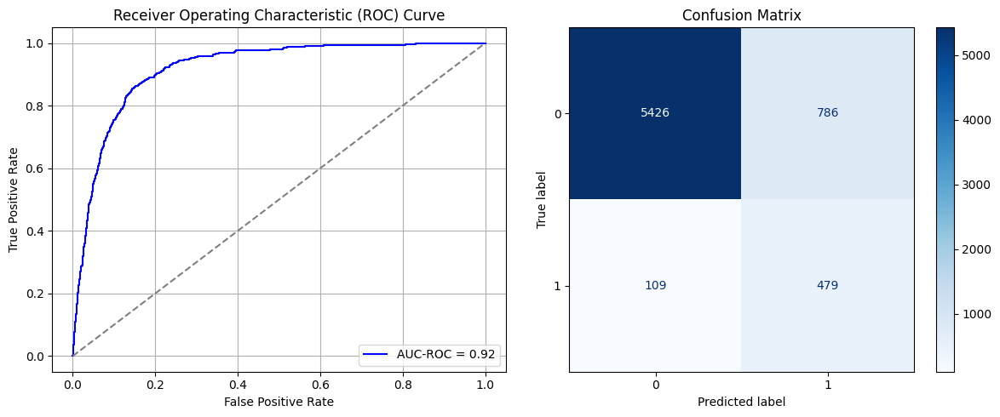

Best threshold based on F1-score: 0.6976252794265747
False Negative Rate: 0.18537414965986396
Time elapsed (performance): 1.074404462999155
(np.float64(0.1265292981326465), np.float64(0.8734707018673535))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6570 - loss: 0.6547 - val_AUC: 0.7537 - val_loss: 0.5945
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7854 - loss: 0.5646 - val_AUC: 0.8379 - val_loss: 0.5084
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8652 - loss: 0.4736 - val_AUC: 0.8661 - val_loss: 0.4612
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8719 - loss: 0.4536 - val_AUC: 0.8732 - val_loss: 0.4481
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8863 - loss: 0.4273 - val_AUC: 0.8730 - val_loss: 0.4525
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8845 - loss: 0.4280 - val_AUC: 0.8782 - val_loss: 0.4384
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8951 - loss: 0.4101 - val_AUC: 0.8761 - val_loss: 0.4432
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8892 - loss: 0.4199 - val_AUC: 0.8788 - val_loss: 0.4443
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9006 -

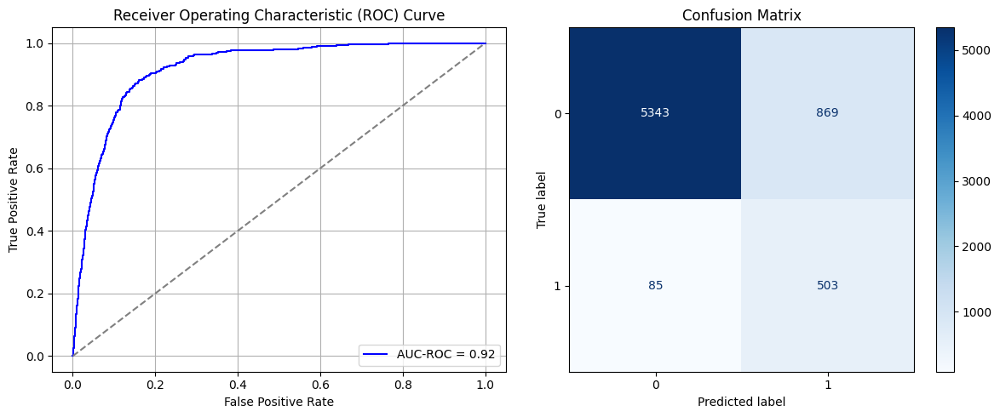

Best threshold based on F1-score: 0.9970899820327759
False Negative Rate: 0.1445578231292517
Time elapsed (performance): 0.9183863019998171
(np.float64(0.13989053444945268), np.float64(0.8601094655505473))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6406 - loss: 0.6643 - val_AUC: 0.7836 - val_loss: 0.5720
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7886 - loss: 0.5618 - val_AUC: 0.8535 - val_loss: 0.4904
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8613 - loss: 0.4758 - val_AUC: 0.8743 - val_loss: 0.4586
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8743 - loss: 0.4507 - val_AUC: 0.8762 - val_loss: 0.4509
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8729 - loss: 0.4495 - val_AUC: 0.8802 - val_loss: 0.4498
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8941 - loss: 0.4140 - val_AUC: 0.8806 - val_loss: 0.4423
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8927 - loss: 0.4157 - val_AUC: 0.8794 - val_loss: 0.4442
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8908 - loss: 0.4162 - val_AUC: 0.8813 - val_loss: 0.4592
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8878 -

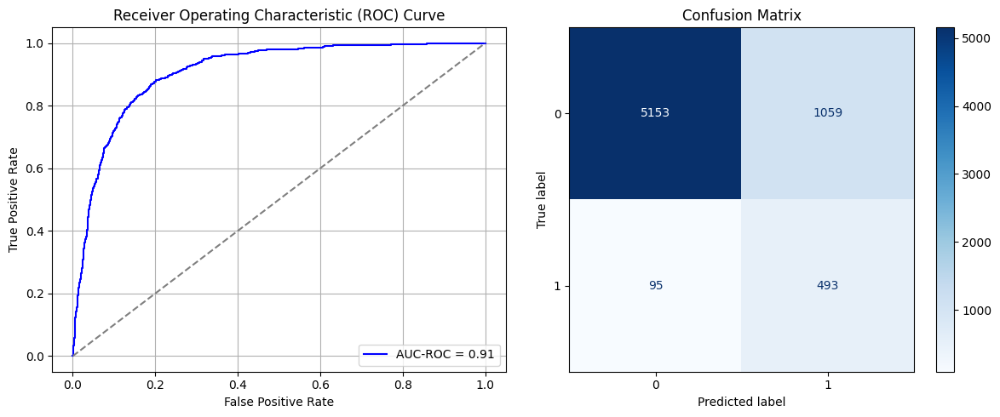

Best threshold based on F1-score: 0.9983221292495728
False Negative Rate: 0.16156462585034015
Time elapsed (performance): 1.1245422350002627
(np.float64(0.1704764971023825), np.float64(0.8295235028976176))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6803 - loss: 0.6499 - val_AUC: 0.7428 - val_loss: 0.6050
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7923 - loss: 0.5575 - val_AUC: 0.8239 - val_loss: 0.5256
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8571 - loss: 0.4868 - val_AUC: 0.8535 - val_loss: 0.4797
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8755 - loss: 0.4514 - val_AUC: 0.8627 - val_loss: 0.4670
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8845 - loss: 0.4334 - val_AUC: 0.8621 - val_loss: 0.4701
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8831 - loss: 0.4350 - val_AUC: 0.8658 - val_loss: 0.4610
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8853 - loss: 0.4311 - val_AUC: 0.8656 - val_loss: 0.4573
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8914 - loss: 0.4178 - val_AUC: 0.8674 - val_loss: 0.4518
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8947 -

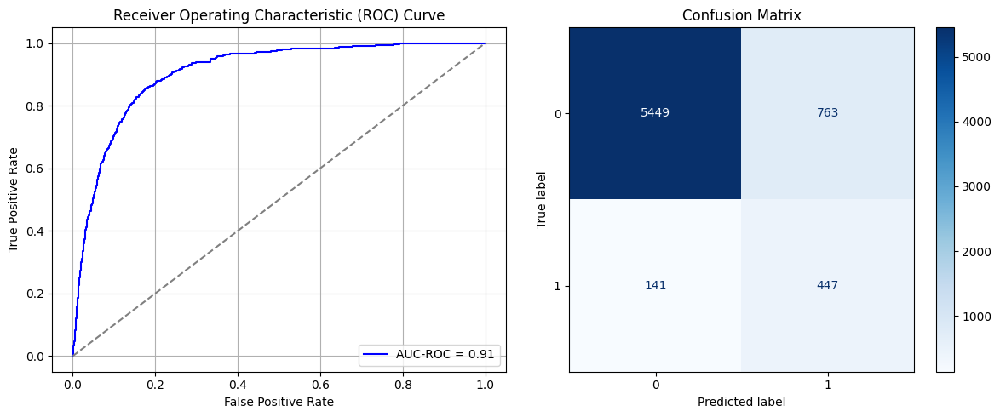

Best threshold based on F1-score: 0.6825760006904602
False Negative Rate: 0.23979591836734693
Time elapsed (performance): 1.0536006389993418
(np.float64(0.12282678686413394), np.float64(0.877173213135866))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6487 - loss: 0.6580 - val_AUC: 0.7756 - val_loss: 0.5806
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8105 - loss: 0.5415 - val_AUC: 0.8578 - val_loss: 0.4817
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8705 - loss: 0.4629 - val_AUC: 0.8697 - val_loss: 0.4588
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8772 - loss: 0.4428 - val_AUC: 0.8810 - val_loss: 0.4398
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8911 - loss: 0.4220 - val_AUC: 0.8819 - val_loss: 0.4423
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8826 - loss: 0.4339 - val_AUC: 0.8828 - val_loss: 0.4431
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8908 - loss: 0.4202 - val_AUC: 0.8838 - val_loss: 0.4308
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8914 - loss: 0.4172 - val_AUC: 0.8835 - val_loss: 0.4302
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8953 -

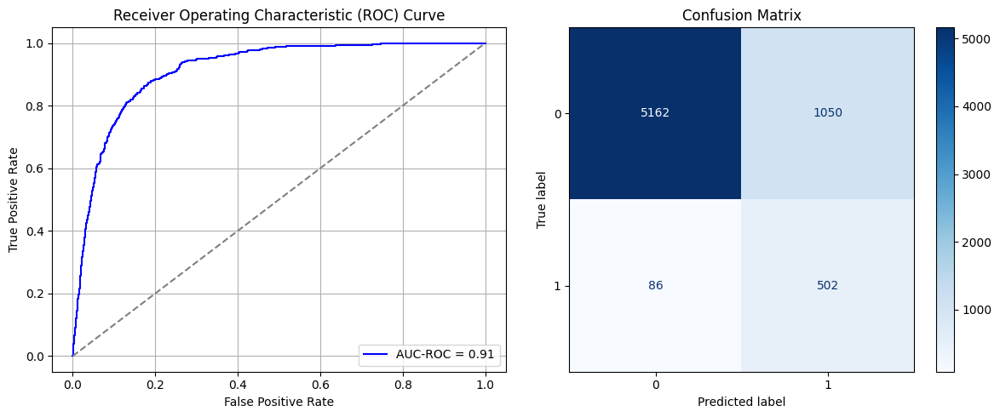

Best threshold based on F1-score: 0.9967684149742126
False Negative Rate: 0.14625850340136054
Time elapsed (performance): 0.8721526950002954
(np.float64(0.16902768834513845), np.float64(0.8309723116548615))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6870 - loss: 0.6489 - val_AUC: 0.7754 - val_loss: 0.5745
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8149 - loss: 0.5362 - val_AUC: 0.8421 - val_loss: 0.5140
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8607 - loss: 0.4743 - val_AUC: 0.8580 - val_loss: 0.4738
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8734 - loss: 0.4502 - val_AUC: 0.8628 - val_loss: 0.4685
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8859 - loss: 0.4292 - val_AUC: 0.8636 - val_loss: 0.4691
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8839 - loss: 0.4313 - val_AUC: 0.8647 - val_loss: 0.4627
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8846 - loss: 0.4294 - val_AUC: 0.8659 - val_loss: 0.4662
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8879 - loss: 0.4212 - val_AUC: 0.8667 - val_loss: 0.4595
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8907 -

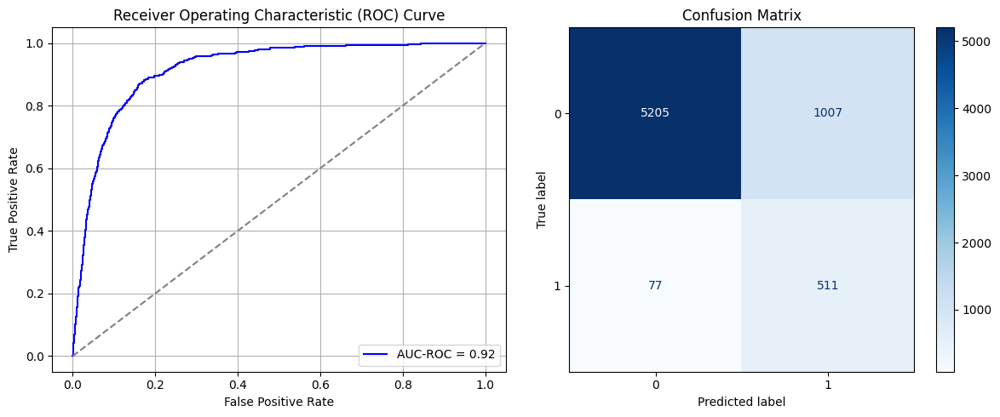

Best threshold based on F1-score: 0.9960383176803589
False Negative Rate: 0.13095238095238096
Time elapsed (performance): 1.0790725189999648
(np.float64(0.16210560206052801), np.float64(0.837894397939472))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6781 - loss: 0.6528 - val_AUC: 0.7502 - val_loss: 0.5981
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7847 - loss: 0.5668 - val_AUC: 0.8283 - val_loss: 0.5190
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8568 - loss: 0.4851 - val_AUC: 0.8624 - val_loss: 0.4667
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8724 - loss: 0.4537 - val_AUC: 0.8736 - val_loss: 0.4541
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8767 - loss: 0.4457 - val_AUC: 0.8753 - val_loss: 0.4434
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8885 - loss: 0.4236 - val_AUC: 0.8789 - val_loss: 0.4379
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8835 - loss: 0.4313 - val_AUC: 0.8759 - val_loss: 0.4435
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8875 - loss: 0.4224 - val_AUC: 0.8797 - val_loss: 0.4511
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8928 -

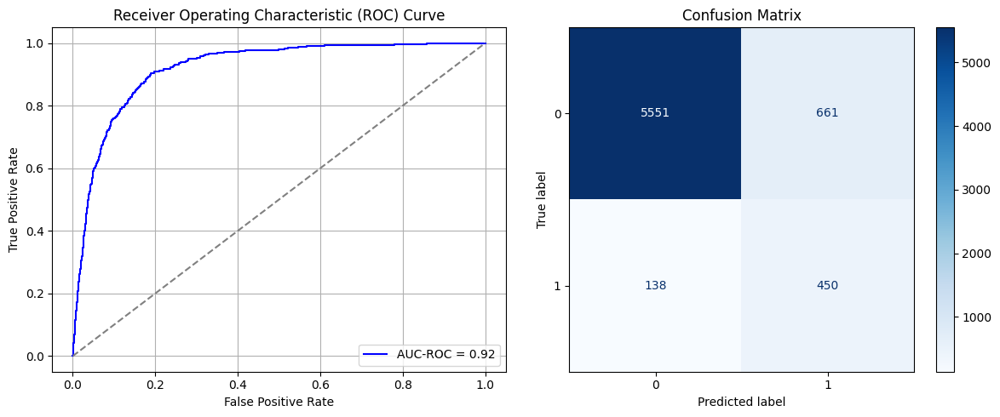

Best threshold based on F1-score: 0.983851432800293
False Negative Rate: 0.23469387755102042
Time elapsed (performance): 0.9179486749999342
(np.float64(0.10640695428203477), np.float64(0.8935930457179653))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6669 - loss: 0.6494 - val_AUC: 0.7647 - val_loss: 0.5872
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7912 - loss: 0.5599 - val_AUC: 0.8249 - val_loss: 0.5419
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8564 - loss: 0.4859 - val_AUC: 0.8639 - val_loss: 0.4665
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8708 - loss: 0.4579 - val_AUC: 0.8720 - val_loss: 0.4525
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8877 - loss: 0.4268 - val_AUC: 0.8743 - val_loss: 0.4487
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8861 - loss: 0.4299 - val_AUC: 0.8757 - val_loss: 0.4464
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8807 - loss: 0.4361 - val_AUC: 0.8774 - val_loss: 0.4440
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8804 - loss: 0.4351 - val_AUC: 0.8797 - val_loss: 0.4436
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8893 -

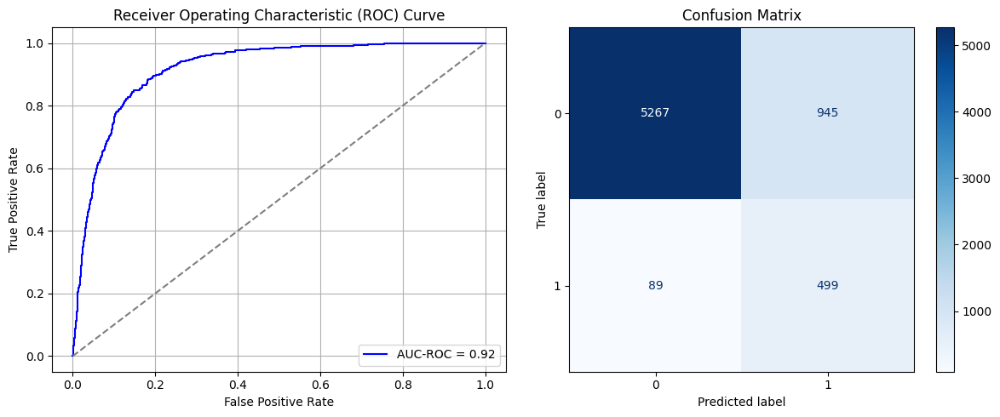

Best threshold based on F1-score: 0.9969807267189026
False Negative Rate: 0.15136054421768708
Time elapsed (performance): 1.0915219640000942
(np.float64(0.1521249195106246), np.float64(0.8478750804893754))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.7084 - loss: 0.6383 - val_AUC: 0.7625 - val_loss: 0.5874
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7977 - loss: 0.5528 - val_AUC: 0.8314 - val_loss: 0.5143
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8638 - loss: 0.4742 - val_AUC: 0.8530 - val_loss: 0.4843
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8792 - loss: 0.4424 - val_AUC: 0.8673 - val_loss: 0.4618
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8821 - loss: 0.4354 - val_AUC: 0.8695 - val_loss: 0.4710
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8909 - loss: 0.4230 - val_AUC: 0.8671 - val_loss: 0.4622
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8819 - loss: 0.4350 - val_AUC: 0.8725 - val_loss: 0.4516
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8911 - loss: 0.4185 - val_AUC: 0.8717 - val_loss: 0.4548
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8952 -

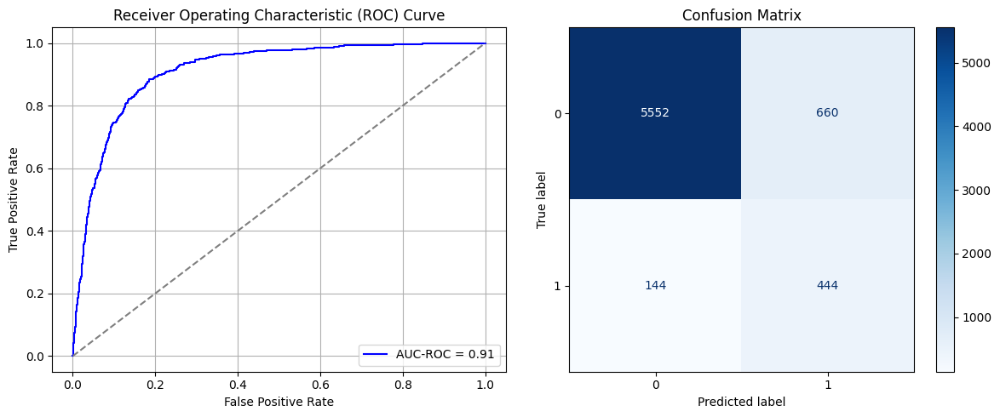

Best threshold based on F1-score: 0.9981442093849182
False Negative Rate: 0.24489795918367346
Time elapsed (performance): 1.103178282999579
(np.float64(0.10624597553122987), np.float64(0.8937540244687702))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6445 - loss: 0.6616 - val_AUC: 0.7590 - val_loss: 0.5923
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.7829 - loss: 0.5700 - val_AUC: 0.8391 - val_loss: 0.5154
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8634 - loss: 0.4808 - val_AUC: 0.8698 - val_loss: 0.4673
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8752 - loss: 0.4542 - val_AUC: 0.8869 - val_loss: 0.4374
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8753 - loss: 0.4482 - val_AUC: 0.8876 - val_loss: 0.4326
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8766 - loss: 0.4478 - val_AUC: 0.8875 - val_loss: 0.4415
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8855 - loss: 0.4375 - val_AUC: 0.8875 - val_loss: 0.4440
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8864 - loss: 0.4361 - val_AUC: 0.8901 - val_loss: 0.4256
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8939 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9184029374789194
Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.90      0.93      6212
           1       0.41      0.75      0.53       588

    accuracy                           0.88      6800
   macro avg       0.69      0.82      0.73      6800
weighted avg       0.93      0.88      0.90      6800

FPR 0.10254346426271732 TPR: 0.75 FNR: 0.25 TNR: 0.8974565357372827


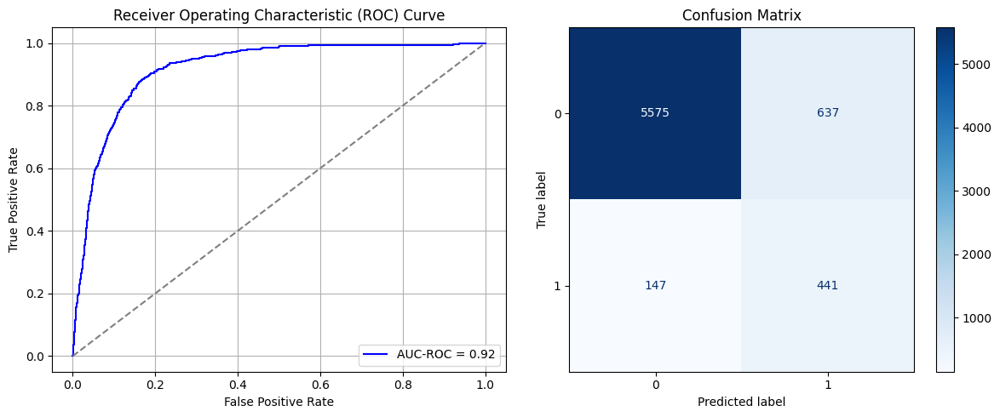

Best threshold based on F1-score: 0.9994226694107056
False Negative Rate: 0.25
Time elapsed (performance): 0.9194717079999464
(np.float64(0.10254346426271732), np.float64(0.8974565357372827))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - AUC: 0.6565 - loss: 0.6573 - val_AUC: 0.7726 - val_loss: 0.5816
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.7932 - loss: 0.5561 - val_AUC: 0.8520 - val_loss: 0.5031
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8553 - loss: 0.4856 - val_AUC: 0.8782 - val_loss: 0.4824
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8599 - loss: 0.4743 - val_AUC: 0.8807 - val_loss: 0.4578
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8735 - loss: 0.4550 - val_AUC: 0.8825 - val_loss: 0.4456
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8764 - loss: 0.4483 - val_AUC: 0.8859 - val_loss: 0.4408
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8815 - loss: 0.4395 - val_AUC: 0.8859 - val_loss: 0.4375
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8837 - loss: 0.4317 - val_AUC: 0.8872 - val_loss: 0.4304
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8833 -

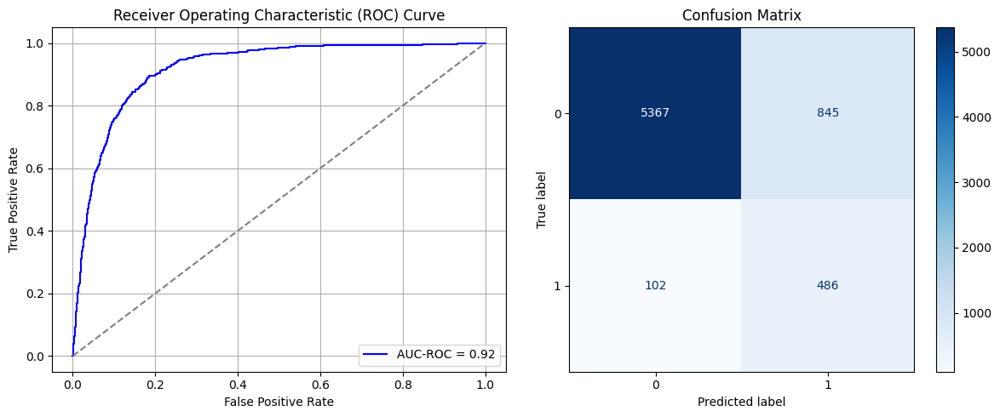

Best threshold based on F1-score: 0.9965617656707764
False Negative Rate: 0.17346938775510204
Time elapsed (performance): 1.2554356990003726
(np.float64(0.13602704443013522), np.float64(0.8639729555698648))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6746 - loss: 0.6497 - val_AUC: 0.7808 - val_loss: 0.5715
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7966 - loss: 0.5545 - val_AUC: 0.8490 - val_loss: 0.5034
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8544 - loss: 0.4904 - val_AUC: 0.8703 - val_loss: 0.4701
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8798 - loss: 0.4428 - val_AUC: 0.8787 - val_loss: 0.4648
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8845 - loss: 0.4347 - val_AUC: 0.8846 - val_loss: 0.4339
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8878 - loss: 0.4253 - val_AUC: 0.8852 - val_loss: 0.4559
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8895 - loss: 0.4219 - val_AUC: 0.8851 - val_loss: 0.4324
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8889 - loss: 0.4231 - val_AUC: 0.8860 - val_loss: 0.4277
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8934 -

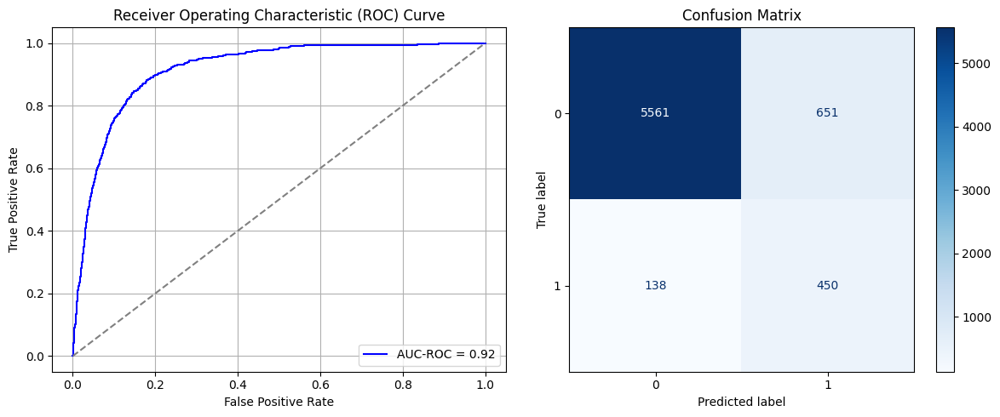

Best threshold based on F1-score: 0.9976022839546204
False Negative Rate: 0.23469387755102042
Time elapsed (performance): 0.9225263339994854
(np.float64(0.10479716677398583), np.float64(0.8952028332260141))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6434 - loss: 0.6618 - val_AUC: 0.7547 - val_loss: 0.5904
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7915 - loss: 0.5606 - val_AUC: 0.8380 - val_loss: 0.5128
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8596 - loss: 0.4857 - val_AUC: 0.8629 - val_loss: 0.4681
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8780 - loss: 0.4470 - val_AUC: 0.8687 - val_loss: 0.4554
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8760 - loss: 0.4479 - val_AUC: 0.8736 - val_loss: 0.4588
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8934 - loss: 0.4178 - val_AUC: 0.8720 - val_loss: 0.4489
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8875 - loss: 0.4260 - val_AUC: 0.8733 - val_loss: 0.4480
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8938 - loss: 0.4127 - val_AUC: 0.8751 - val_loss: 0.4432
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8954 -

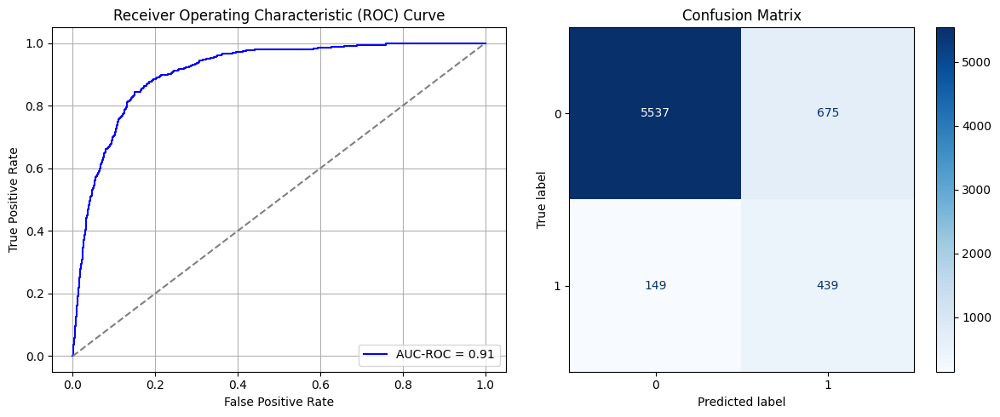

Best threshold based on F1-score: 0.9971844553947449
False Negative Rate: 0.2534013605442177
Time elapsed (performance): 1.0861141859995769
(np.float64(0.10866065679330328), np.float64(0.8913393432066967))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6450 - loss: 0.6586 - val_AUC: 0.7731 - val_loss: 0.5777
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8035 - loss: 0.5503 - val_AUC: 0.8497 - val_loss: 0.4938
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8628 - loss: 0.4753 - val_AUC: 0.8737 - val_loss: 0.4518
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8863 - loss: 0.4313 - val_AUC: 0.8783 - val_loss: 0.4421
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8775 - loss: 0.4424 - val_AUC: 0.8792 - val_loss: 0.4418
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8845 - loss: 0.4304 - val_AUC: 0.8829 - val_loss: 0.4325
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8970 - loss: 0.4085 - val_AUC: 0.8856 - val_loss: 0.4294
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8840 - loss: 0.4300 - val_AUC: 0.8838 - val_loss: 0.4298
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8835 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9164668120950891
Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.92      0.94      6212
           1       0.45      0.69      0.54       588

    accuracy                           0.90      6800
   macro avg       0.71      0.80      0.74      6800
weighted avg       0.92      0.90      0.91      6800

FPR 0.07920154539600772 TPR: 0.685374149659864 FNR: 0.31462585034013607 TNR: 0.9207984546039922


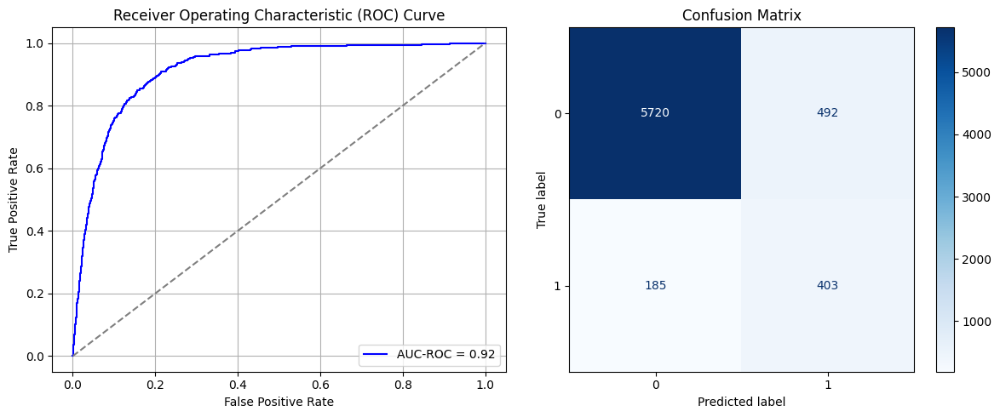

Best threshold based on F1-score: 0.9973179697990417
False Negative Rate: 0.31462585034013607
Time elapsed (performance): 1.0730399159992885
(np.float64(0.07920154539600772), np.float64(0.9207984546039922))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6233 - loss: 0.6668 - val_AUC: 0.7699 - val_loss: 0.5957
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8015 - loss: 0.5499 - val_AUC: 0.8418 - val_loss: 0.5027
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8616 - loss: 0.4743 - val_AUC: 0.8653 - val_loss: 0.4644
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8828 - loss: 0.4368 - val_AUC: 0.8679 - val_loss: 0.4600
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8820 - loss: 0.4383 - val_AUC: 0.8728 - val_loss: 0.4486
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8853 - loss: 0.4280 - val_AUC: 0.8731 - val_loss: 0.4474
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8954 - loss: 0.4107 - val_AUC: 0.8749 - val_loss: 0.4453
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8801 - loss: 0.4353 - val_AUC: 0.8730 - val_loss: 0.4548
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8939 -

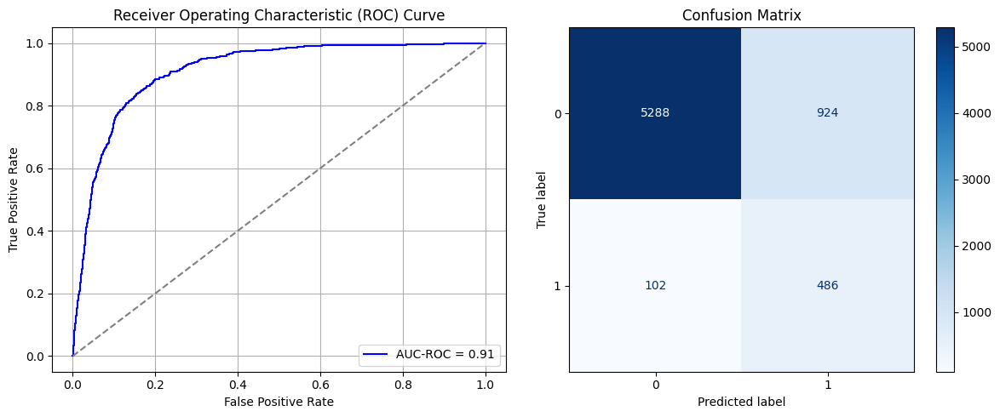

Best threshold based on F1-score: 0.9975866675376892
False Negative Rate: 0.17346938775510204
Time elapsed (performance): 1.0946950349998588
(np.float64(0.14874436574372182), np.float64(0.8512556342562781))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.7013 - loss: 0.6431 - val_AUC: 0.7464 - val_loss: 0.5980
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7939 - loss: 0.5530 - val_AUC: 0.8215 - val_loss: 0.5249
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8576 - loss: 0.4818 - val_AUC: 0.8577 - val_loss: 0.4731
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8836 - loss: 0.4350 - val_AUC: 0.8720 - val_loss: 0.4517
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8826 - loss: 0.4330 - val_AUC: 0.8751 - val_loss: 0.4459
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8868 - loss: 0.4258 - val_AUC: 0.8724 - val_loss: 0.4502
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8927 - loss: 0.4155 - val_AUC: 0.8739 - val_loss: 0.4515
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8967 - loss: 0.4059 - val_AUC: 0.8750 - val_loss: 0.4440
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8952 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9160430108939905
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.37      0.82      0.51       588

    accuracy                           0.86      6800
   macro avg       0.68      0.84      0.72      6800
weighted avg       0.93      0.86      0.89      6800

FPR 0.131841596909208 TPR: 0.8180272108843537 FNR: 0.18197278911564627 TNR: 0.8681584030907921


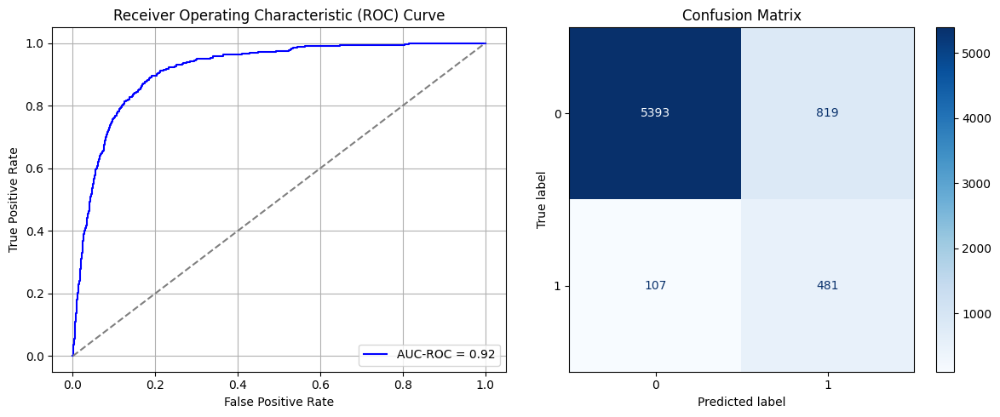

Best threshold based on F1-score: 0.7187069058418274
False Negative Rate: 0.18197278911564627
Time elapsed (performance): 1.0883790020006927
(np.float64(0.131841596909208), np.float64(0.8681584030907921))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6519 - loss: 0.6569 - val_AUC: 0.7734 - val_loss: 0.5810
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8105 - loss: 0.5401 - val_AUC: 0.8515 - val_loss: 0.4878
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8735 - loss: 0.4610 - val_AUC: 0.8793 - val_loss: 0.4467
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8843 - loss: 0.4348 - val_AUC: 0.8821 - val_loss: 0.4426
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8877 - loss: 0.4256 - val_AUC: 0.8836 - val_loss: 0.4357
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8867 - loss: 0.4252 - val_AUC: 0.8836 - val_loss: 0.4467
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8943 - loss: 0.4125 - val_AUC: 0.8867 - val_loss: 0.4299
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8933 - loss: 0.4137 - val_AUC: 0.8836 - val_loss: 0.4645
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8916 -

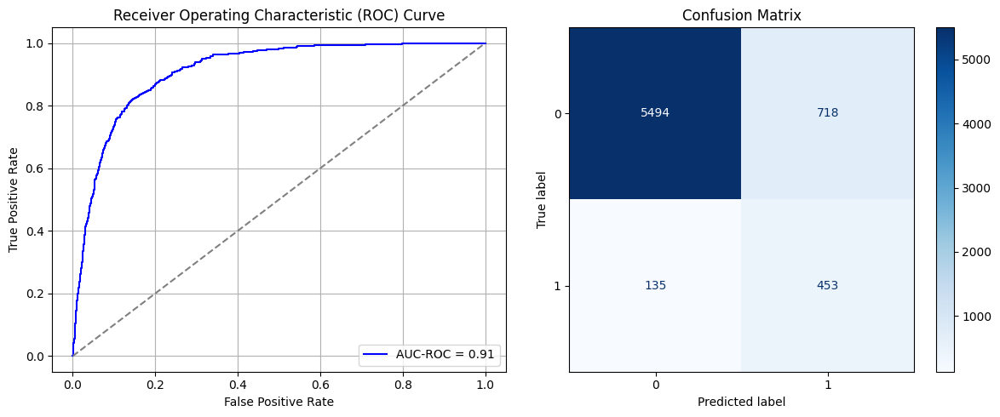

Best threshold based on F1-score: 0.6527204513549805
False Negative Rate: 0.22959183673469388
Time elapsed (performance): 1.1208419410004353
(np.float64(0.11558274307791372), np.float64(0.8844172569220863))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6449 - loss: 0.6584 - val_AUC: 0.7659 - val_loss: 0.5825
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7974 - loss: 0.5530 - val_AUC: 0.8482 - val_loss: 0.5083
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8645 - loss: 0.4740 - val_AUC: 0.8683 - val_loss: 0.4635
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8775 - loss: 0.4464 - val_AUC: 0.8722 - val_loss: 0.4511
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8726 - loss: 0.4513 - val_AUC: 0.8743 - val_loss: 0.4499
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8871 - loss: 0.4283 - val_AUC: 0.8771 - val_loss: 0.4475
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8878 - loss: 0.4285 - val_AUC: 0.8778 - val_loss: 0.4390
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8890 - loss: 0.4231 - val_AUC: 0.8801 - val_loss: 0.4356
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8909 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9114162406752785
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.82      0.90      6212
           1       0.31      0.86      0.46       588

    accuracy                           0.83      6800
   macro avg       0.65      0.84      0.68      6800
weighted avg       0.93      0.83      0.86      6800

FPR 0.17707662588538314 TPR: 0.8571428571428572 FNR: 0.14285714285714285 TNR: 0.8229233741146169


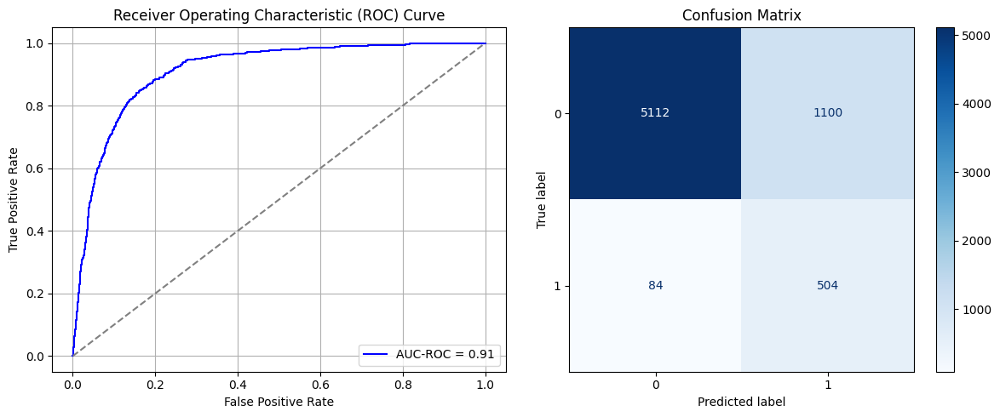

Best threshold based on F1-score: 0.9950035214424133
False Negative Rate: 0.14285714285714285
Time elapsed (performance): 0.9893112769996151
(np.float64(0.17707662588538314), np.float64(0.8229233741146169))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - AUC: 0.6404 - loss: 0.6606 - val_AUC: 0.7629 - val_loss: 0.5846
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.7893 - loss: 0.5606 - val_AUC: 0.8348 - val_loss: 0.5099
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8542 - loss: 0.4909 - val_AUC: 0.8580 - val_loss: 0.4976
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8669 - loss: 0.4630 - val_AUC: 0.8669 - val_loss: 0.4946
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8842 - loss: 0.4341 - val_AUC: 0.8726 - val_loss: 0.4478
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8854 - loss: 0.4282 - val_AUC: 0.8730 - val_loss: 0.4507
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8902 - loss: 0.4205 - val_AUC: 0.8733 - val_loss: 0.4450
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8893 - loss: 0.4203 - val_AUC: 0.8726 - val_loss: 0.4468
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8881 -

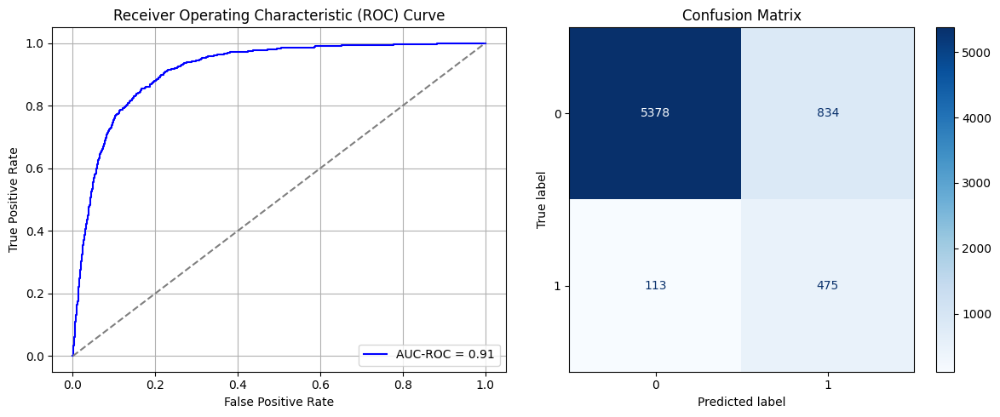

Best threshold based on F1-score: 0.996889054775238
False Negative Rate: 0.1921768707482993
Time elapsed (performance): 1.8903789719997803
(np.float64(0.13425627817128138), np.float64(0.8657437218287186))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6615 - loss: 0.6590 - val_AUC: 0.7760 - val_loss: 0.5747
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7949 - loss: 0.5575 - val_AUC: 0.8500 - val_loss: 0.4971
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8550 - loss: 0.4882 - val_AUC: 0.8758 - val_loss: 0.4503
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8696 - loss: 0.4578 - val_AUC: 0.8774 - val_loss: 0.4434
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8850 - loss: 0.4297 - val_AUC: 0.8839 - val_loss: 0.4382
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8829 - loss: 0.4329 - val_AUC: 0.8830 - val_loss: 0.4392
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8825 - loss: 0.4316 - val_AUC: 0.8845 - val_loss: 0.4561
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8892 - loss: 0.4223 - val_AUC: 0.8858 - val_loss: 0.4319
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8964 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9126805261705455
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.89      0.93      6212
           1       0.39      0.77      0.52       588

    accuracy                           0.88      6800
   macro avg       0.68      0.83      0.72      6800
weighted avg       0.93      0.88      0.89      6800

FPR 0.11461687057308435 TPR: 0.7687074829931972 FNR: 0.23129251700680273 TNR: 0.8853831294269157


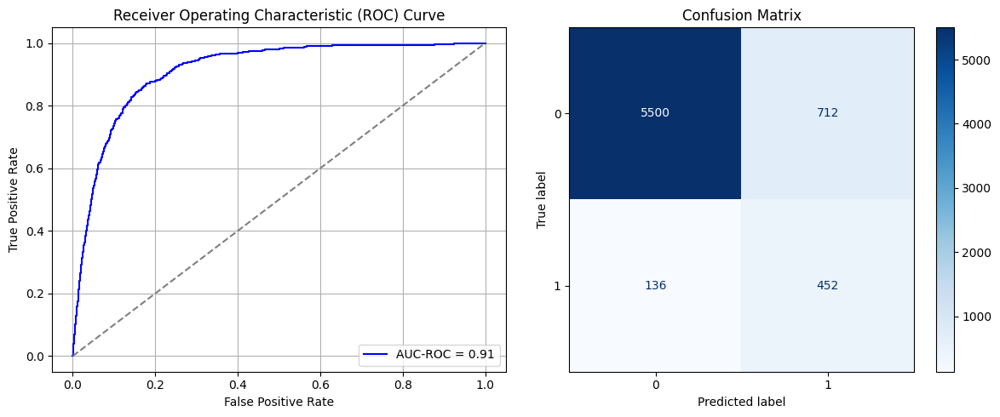

Best threshold based on F1-score: 0.9989387392997742
False Negative Rate: 0.23129251700680273
Time elapsed (performance): 1.0950554749997536
(np.float64(0.11461687057308435), np.float64(0.8853831294269157))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6660 - loss: 0.6591 - val_AUC: 0.7500 - val_loss: 0.5936
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7873 - loss: 0.5591 - val_AUC: 0.8287 - val_loss: 0.5199
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8521 - loss: 0.4935 - val_AUC: 0.8639 - val_loss: 0.4718
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8751 - loss: 0.4509 - val_AUC: 0.8718 - val_loss: 0.4535
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8781 - loss: 0.4429 - val_AUC: 0.8775 - val_loss: 0.4435
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8782 - loss: 0.4422 - val_AUC: 0.8768 - val_loss: 0.4450
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8914 - loss: 0.4186 - val_AUC: 0.8809 - val_loss: 0.4328
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8948 - loss: 0.4118 - val_AUC: 0.8800 - val_loss: 0.4381
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8907 -

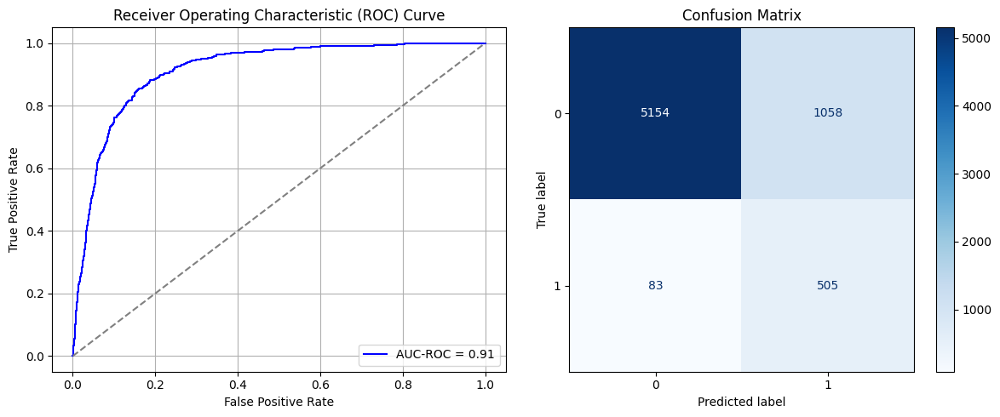

Best threshold based on F1-score: 0.9926126003265381
False Negative Rate: 0.141156462585034
Time elapsed (performance): 1.065759562000494
(np.float64(0.1703155183515776), np.float64(0.8296844816484223))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6092 - loss: 0.6679 - val_AUC: 0.7440 - val_loss: 0.6024
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7832 - loss: 0.5685 - val_AUC: 0.8265 - val_loss: 0.5234
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8439 - loss: 0.5018 - val_AUC: 0.8550 - val_loss: 0.4796
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8710 - loss: 0.4592 - val_AUC: 0.8636 - val_loss: 0.4660
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8784 - loss: 0.4429 - val_AUC: 0.8675 - val_loss: 0.4585
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8814 - loss: 0.4379 - val_AUC: 0.8733 - val_loss: 0.4545
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8817 - loss: 0.4342 - val_AUC: 0.8737 - val_loss: 0.4482
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8829 - loss: 0.4319 - val_AUC: 0.8737 - val_loss: 0.4494
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8884 -

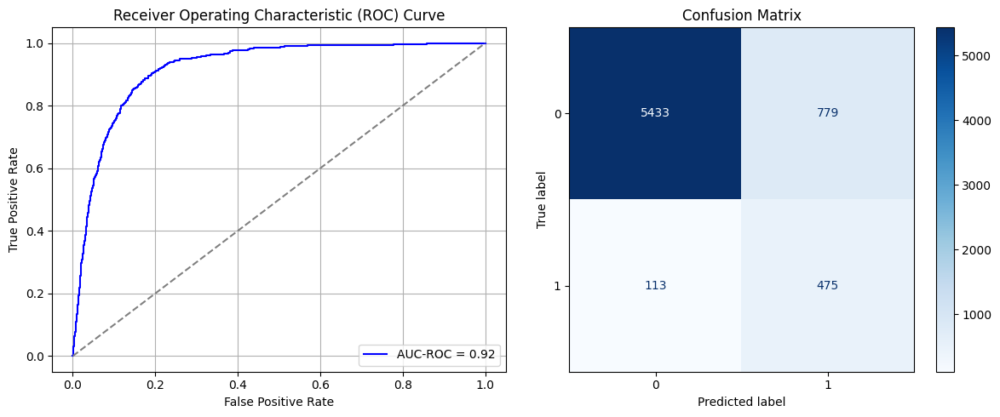

Best threshold based on F1-score: 0.9949823617935181
False Negative Rate: 0.1921768707482993
Time elapsed (performance): 1.0597104700000273
(np.float64(0.12540244687701224), np.float64(0.8745975531229877))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6862 - loss: 0.6495 - val_AUC: 0.7654 - val_loss: 0.5837
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7817 - loss: 0.5682 - val_AUC: 0.8340 - val_loss: 0.5162
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8512 - loss: 0.4954 - val_AUC: 0.8698 - val_loss: 0.4649
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8669 - loss: 0.4623 - val_AUC: 0.8748 - val_loss: 0.4473
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8783 - loss: 0.4440 - val_AUC: 0.8803 - val_loss: 0.4385
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8859 - loss: 0.4281 - val_AUC: 0.8773 - val_loss: 0.4908
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8794 - loss: 0.4389 - val_AUC: 0.8821 - val_loss: 0.4423
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8826 - loss: 0.4313 - val_AUC: 0.8825 - val_loss: 0.4453
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8750 -

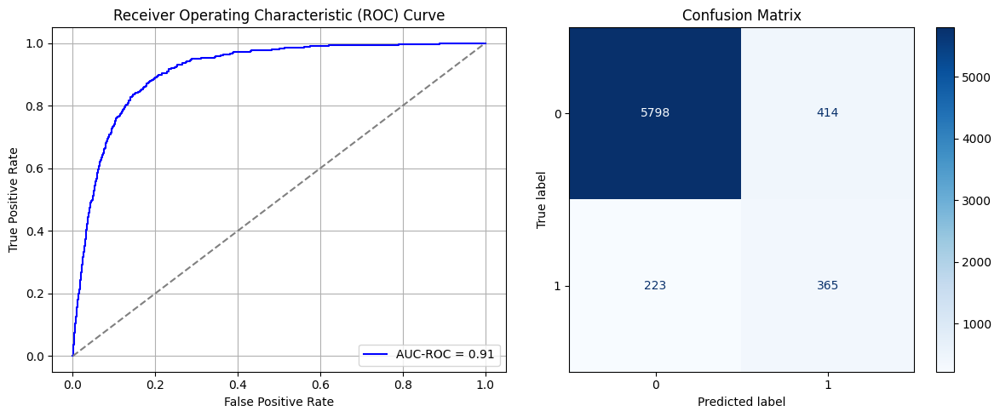

Best threshold based on F1-score: 0.9919302463531494
False Negative Rate: 0.3792517006802721
Time elapsed (performance): 0.9608560119995673
(np.float64(0.06664520283322602), np.float64(0.9333547971667739))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6962 - loss: 0.6481 - val_AUC: 0.7739 - val_loss: 0.5786
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8046 - loss: 0.5512 - val_AUC: 0.8434 - val_loss: 0.5021
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8677 - loss: 0.4696 - val_AUC: 0.8649 - val_loss: 0.4696
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8770 - loss: 0.4480 - val_AUC: 0.8729 - val_loss: 0.4546
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8863 - loss: 0.4282 - val_AUC: 0.8749 - val_loss: 0.4478
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8854 - loss: 0.4298 - val_AUC: 0.8768 - val_loss: 0.4465
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8867 - loss: 0.4251 - val_AUC: 0.8754 - val_loss: 0.4512
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8921 - loss: 0.4155 - val_AUC: 0.8768 - val_loss: 0.4452
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8915 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9168005418522851
Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.89      0.93      6212
           1       0.40      0.76      0.52       588

    accuracy                           0.88      6800
   macro avg       0.69      0.83      0.73      6800
weighted avg       0.93      0.88      0.90      6800

FPR 0.10672891178364456 TPR: 0.7568027210884354 FNR: 0.24319727891156462 TNR: 0.8932710882163555


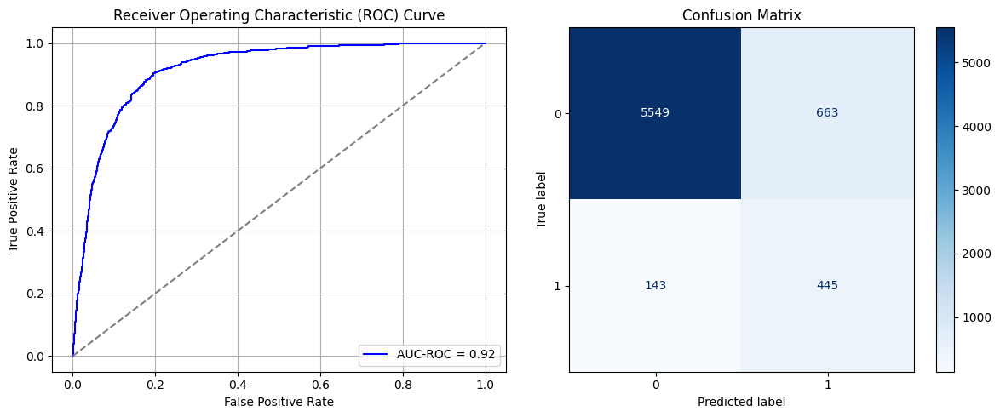

Best threshold based on F1-score: 0.9947680234909058
False Negative Rate: 0.24319727891156462
Time elapsed (performance): 1.0677386100005606
(np.float64(0.10672891178364456), np.float64(0.8932710882163555))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6407 - loss: 0.6575 - val_AUC: 0.7656 - val_loss: 0.5846
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7839 - loss: 0.5648 - val_AUC: 0.8243 - val_loss: 0.5212
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8439 - loss: 0.4940 - val_AUC: 0.8632 - val_loss: 0.4695
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8785 - loss: 0.4455 - val_AUC: 0.8718 - val_loss: 0.4524
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8799 - loss: 0.4389 - val_AUC: 0.8738 - val_loss: 0.4605
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8885 - loss: 0.4252 - val_AUC: 0.8763 - val_loss: 0.4517
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8819 - loss: 0.4326 - val_AUC: 0.8748 - val_loss: 0.4435
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8855 - loss: 0.4264 - val_AUC: 0.8773 - val_loss: 0.4429
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8875 -

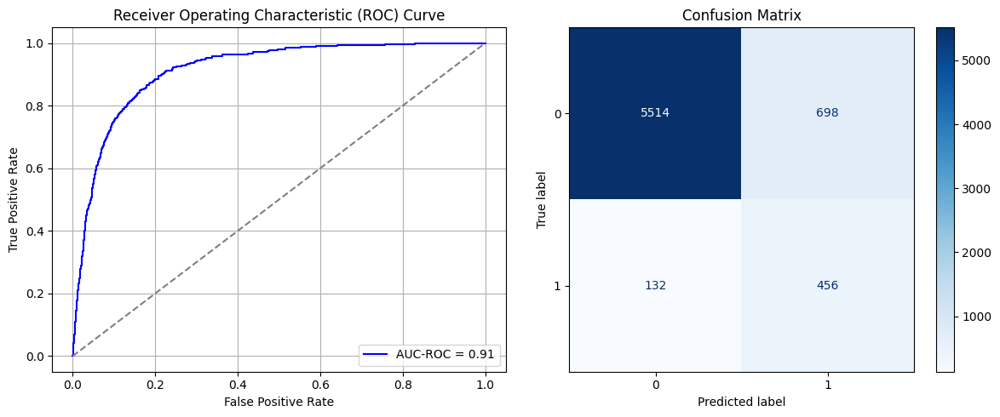

Best threshold based on F1-score: 0.9962413907051086
False Negative Rate: 0.22448979591836735
Time elapsed (performance): 0.9652641919992675
(np.float64(0.11236316806181584), np.float64(0.8876368319381842))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6818 - loss: 0.6508 - val_AUC: 0.7602 - val_loss: 0.5847
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7968 - loss: 0.5515 - val_AUC: 0.8368 - val_loss: 0.5096
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8664 - loss: 0.4728 - val_AUC: 0.8615 - val_loss: 0.4917
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8803 - loss: 0.4418 - val_AUC: 0.8741 - val_loss: 0.4560
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8786 - loss: 0.4437 - val_AUC: 0.8747 - val_loss: 0.4570
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8935 - loss: 0.4161 - val_AUC: 0.8750 - val_loss: 0.4688
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8909 - loss: 0.4182 - val_AUC: 0.8749 - val_loss: 0.4507
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8880 - loss: 0.4247 - val_AUC: 0.8778 - val_loss: 0.4427
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8922 -

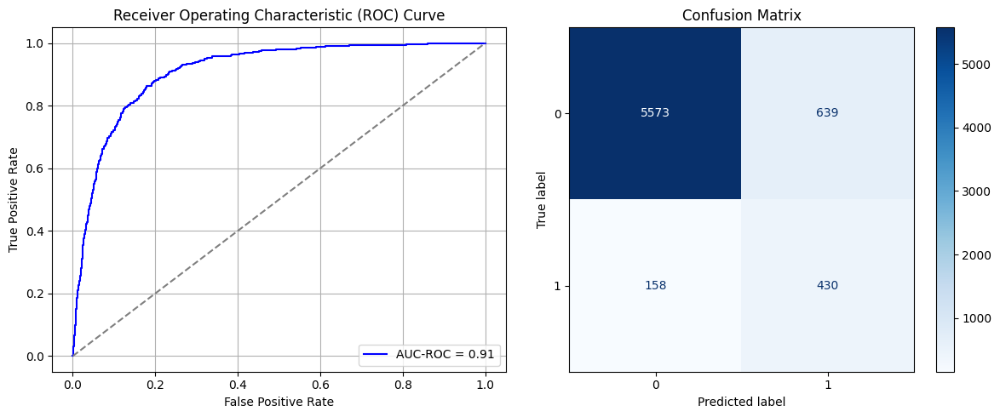

Best threshold based on F1-score: 0.9973539113998413
False Negative Rate: 0.2687074829931973
Time elapsed (performance): 0.9588925279995237
(np.float64(0.10286542176432711), np.float64(0.8971345782356729))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - AUC: 0.6550 - loss: 0.6566 - val_AUC: 0.7557 - val_loss: 0.5923
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.7972 - loss: 0.5552 - val_AUC: 0.8470 - val_loss: 0.5072
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8620 - loss: 0.4771 - val_AUC: 0.8623 - val_loss: 0.4699
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8723 - loss: 0.4525 - val_AUC: 0.8704 - val_loss: 0.4685
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8762 - loss: 0.4466 - val_AUC: 0.8696 - val_loss: 0.4564
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8769 - loss: 0.4407 - val_AUC: 0.8711 - val_loss: 0.4512
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8917 - loss: 0.4151 - val_AUC: 0.8717 - val_loss: 0.4508
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8881 - loss: 0.4214 - val_AUC: 0.8701 - val_loss: 0.4544
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8934 -

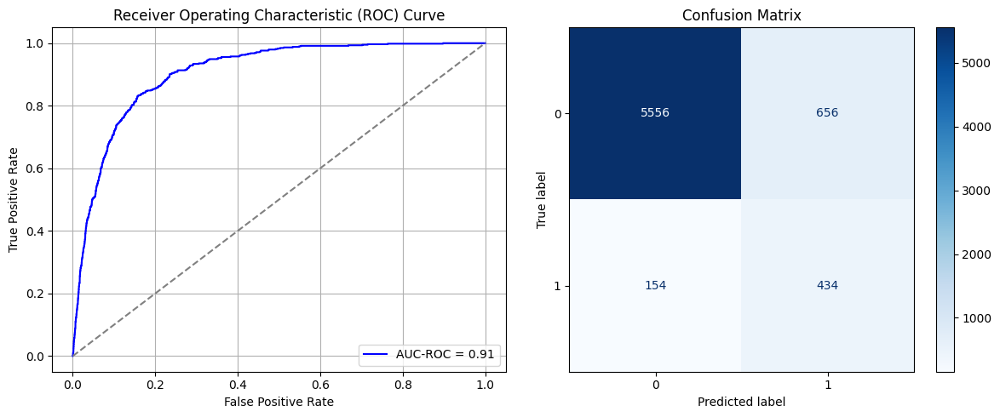

Best threshold based on F1-score: 0.9976218342781067
False Negative Rate: 0.2619047619047619
Time elapsed (performance): 1.3407310109996615
(np.float64(0.1056020605280103), np.float64(0.8943979394719896))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6692 - loss: 0.6533 - val_AUC: 0.7778 - val_loss: 0.5828
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7987 - loss: 0.5522 - val_AUC: 0.8522 - val_loss: 0.4931
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8563 - loss: 0.4834 - val_AUC: 0.8737 - val_loss: 0.4528
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8785 - loss: 0.4454 - val_AUC: 0.8804 - val_loss: 0.4608
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8878 - loss: 0.4249 - val_AUC: 0.8846 - val_loss: 0.4369
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8851 - loss: 0.4299 - val_AUC: 0.8807 - val_loss: 0.4559
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8853 - loss: 0.4297 - val_AUC: 0.8844 - val_loss: 0.4321
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8843 - loss: 0.4300 - val_AUC: 0.8852 - val_loss: 0.4334
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8903 -

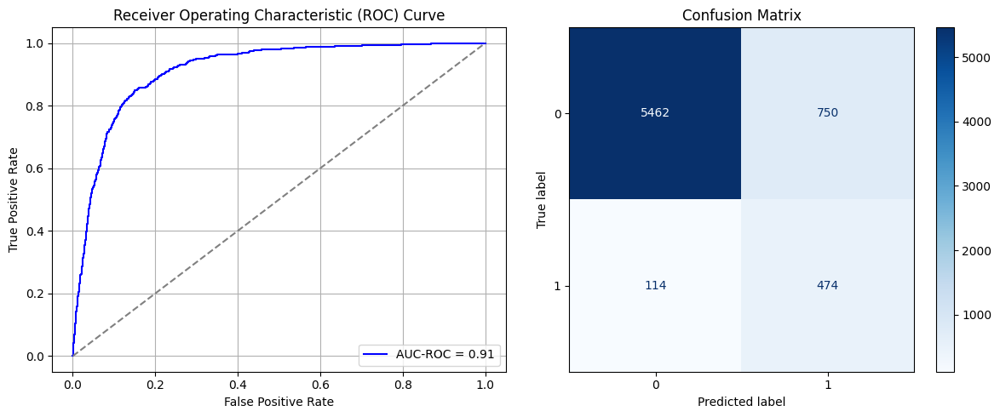

Best threshold based on F1-score: 0.9980162978172302
False Negative Rate: 0.19387755102040816
Time elapsed (performance): 1.159899647000202
(np.float64(0.12073406310367031), np.float64(0.8792659368963297))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6334 - loss: 0.6645 - val_AUC: 0.7512 - val_loss: 0.5949
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7777 - loss: 0.5708 - val_AUC: 0.8185 - val_loss: 0.5315
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8308 - loss: 0.5158 - val_AUC: 0.8677 - val_loss: 0.4668
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8728 - loss: 0.4569 - val_AUC: 0.8802 - val_loss: 0.4460
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8748 - loss: 0.4458 - val_AUC: 0.8829 - val_loss: 0.4351
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8811 - loss: 0.4360 - val_AUC: 0.8833 - val_loss: 0.4368
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8786 - loss: 0.4386 - val_AUC: 0.8855 - val_loss: 0.4287
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8872 - loss: 0.4219 - val_AUC: 0.8865 - val_loss: 0.4253
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8738 -

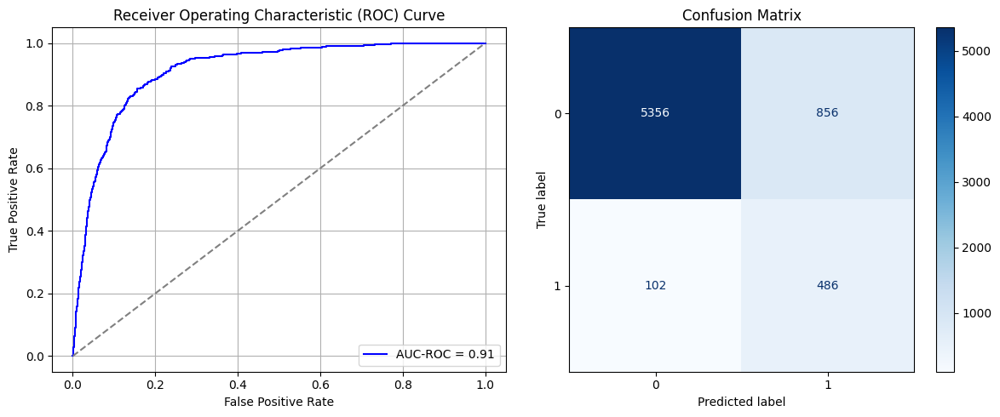

Best threshold based on F1-score: 0.9956830143928528
False Negative Rate: 0.17346938775510204
Time elapsed (performance): 0.9918702599998142
(np.float64(0.13779781068898905), np.float64(0.862202189311011))
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6696 - loss: 0.6626 - val_AUC: 0.7567 - val_loss: 0.5912
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7785 - loss: 0.5699 - val_AUC: 0.8391 - val_loss: 0.5064
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8631 - loss: 0.4778 - val_AUC: 0.8686 - val_loss: 0.4664
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8736 - loss: 0.4519 - val_AUC: 0.8773 - val_loss: 0.4471
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8864 - loss: 0.4281 - val_AUC: 0.8790 - val_loss: 0.4488
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8844 - loss: 0.4318 - val_AUC: 0.8811 - val_loss: 0.4398
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8851 - loss: 0.4299 - val_AUC: 0.8821 - val_loss: 0.4468
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8836 - loss: 0.4313 - val_AUC: 0.8834 - val_loss: 0.4335
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8870 -

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9176697723519542
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.78      0.87      6212
           1       0.28      0.90      0.43       588

    accuracy                           0.79      6800
   macro avg       0.63      0.84      0.65      6800
weighted avg       0.93      0.79      0.83      6800

FPR 0.21989697359948487 TPR: 0.9047619047619048 FNR: 0.09523809523809523 TNR: 0.7801030264005151


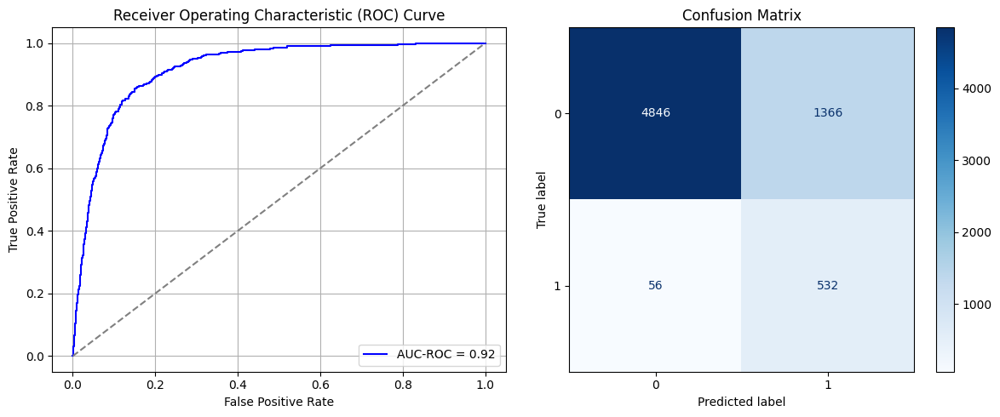

Best threshold based on F1-score: 0.7544754147529602
False Negative Rate: 0.09523809523809523
Time elapsed (performance): 1.0608178279999265
(np.float64(0.21989697359948487), np.float64(0.7801030264005151))
    Source time       FPR       TNR       FNR       TPR  Target time
0      8.854341  0.082421  0.917579  0.314626  0.685374     1.032244
1      9.052820  0.114778  0.885222  0.243197  0.756803     0.801707
2      9.798625  0.105280  0.894720  0.243197  0.756803     0.783983
3      9.923694  0.128300  0.871700  0.187075  0.812925     0.795674
4     10.986750  0.173535  0.826465  0.134354  0.865646     0.815185
5     10.186807  0.078558  0.921442  0.301020  0.698980     1.057776
6     11.494875  0.105763  0.894237  0.248299  0.751701     0.788131
7     11.524918  0.104314  0.895686  0.239796  0.760204     0.808959
8     10.900586  0.102704  0.897296  0.246599  0.753401     1.057432
9     11.698242  0.133934  0.866066  0.181973  0.818027     1.054508
10    11.090941  0.125885  0.87411

In [78]:
import random

times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []

m = 10

k = oversample_size/undersample_size * m
print(k)

# np.random.seed(123)

for i in range(times):
    start = np.random.choice(int(k), 10)
    # print(start)

    Row = []

    Row = []

    for j in range(len(start)):
      for l in range(int(undersample_size/m)):
        row = start[j]+int(k*l)-1
        Row.append(row)

    # print(Row)

    data_S_maj_rus = pd.DataFrame()
    data_S_maj_rus = data_S_majority.iloc[Row]

    data_S_Sy_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_Sy = data_S_Sy_RUS.iloc[:, :-1]
    y_S_Sy = data_S_Sy_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_Sy, y_S_Sy, test_size=0.20, random_state=0)
    model_Sy = create_dnn_model(X_S_train.shape[1])
    result_Sy = train_and_evaluate(model_Sy, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_Sy = Transductive_TL(model_Sy, X_T_full, y_T_full, "Target")
    print(result_TL_Sy[0:2])

    Training_time.append(result_Sy)
    FPR.append(result_TL_Sy[0])
    TNR.append(result_TL_Sy[1])
    FNR.append(result_TL_Sy[2])
    TPR.append(result_TL_Sy[3])
    TL_time.append(result_TL_Sy[4])

# return fpr, tnr, fnr, tpr, time_elapsed

# print(TNR)

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
print(ParamFit)

In [79]:
print(ParamFit)
ParamFit.to_csv('Sy2_RUS.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0      8.854341  0.082421  0.917579  0.314626  0.685374     1.032244
1      9.052820  0.114778  0.885222  0.243197  0.756803     0.801707
2      9.798625  0.105280  0.894720  0.243197  0.756803     0.783983
3      9.923694  0.128300  0.871700  0.187075  0.812925     0.795674
4     10.986750  0.173535  0.826465  0.134354  0.865646     0.815185
5     10.186807  0.078558  0.921442  0.301020  0.698980     1.057776
6     11.494875  0.105763  0.894237  0.248299  0.751701     0.788131
7     11.524918  0.104314  0.895686  0.239796  0.760204     0.808959
8     10.900586  0.102704  0.897296  0.246599  0.753401     1.057432
9     11.698242  0.133934  0.866066  0.181973  0.818027     1.054508
10    11.090941  0.125885  0.874115  0.202381  0.797619     0.806220
11    11.976555  0.132807  0.867193  0.190476  0.809524     0.827137
12    11.692934  0.160335  0.839665  0.147959  0.852041     1.052115
13    11.704464  0.173052  0.82694

In [80]:
ParamFit['FNR'].mean()

np.float64(0.20795918367346936)

In [81]:
ParamFit['Source time'].mean()

np.float64(13.108915867539963)

# Random Oversampling (ROS):

## Simple Random Sampling with Replacement:

In this case, we investigate the effectiveness of Random Oversampling methods, beginning with Simple Random Sampling (SRS) with replacement. For this, we perform random resampling from the minority class of size $N_1$ to generate an additional sample of size $N_0-N_1$, such that the oversampled minority class will have the same size as the majority class.

In [82]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

4433
31960


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.8003 - loss: 0.5423 - val_AUC: 0.8878 - val_loss: 0.4343
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8810 - loss: 0.4372 - val_AUC: 0.8924 - val_loss: 0.4139
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8929 - loss: 0.4112 - val_AUC: 0.8990 - val_loss: 0.3993
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 7ms/step - AUC: 0.8960 - loss: 0.4034 - val_AUC: 0.9048 - val_loss: 0.3896
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.9003 - loss: 0.3950 - val_AUC: 0.9061 - val_loss: 0.3834
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9060 - loss: 0.3837 - val_AUC: 0.9074 - val_loss: 0.3796
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9093 - loss: 0.3749 - val_AUC: 0.9130 - val_loss: 0.3678
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.9127 - loss: 0.3688 - val_AUC: 0.9161 - val_loss: 0.3654
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/s

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9263875382735194
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.83      0.90      6212
           1       0.33      0.89      0.48       588

    accuracy                           0.83      6800
   macro avg       0.66      0.86      0.69      6800
weighted avg       0.93      0.83      0.86      6800

FPR 0.1728911783644559 TPR: 0.891156462585034 FNR: 0.10884353741496598 TNR: 0.8271088216355441


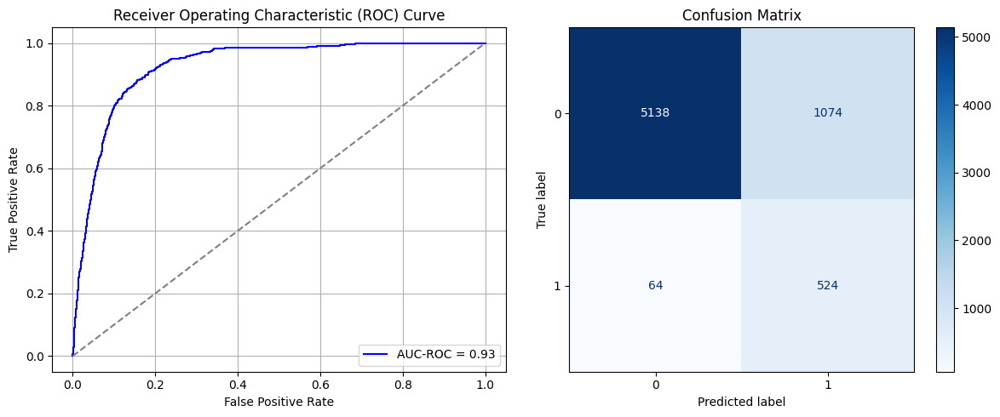

Best threshold based on F1-score: 0.7271057963371277
False Negative Rate: 0.10884353741496598
Time elapsed (performance): 0.7816874600011943
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7829 - loss: 0.5571 - val_AUC: 0.8874 - val_loss: 0.4260
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.8860 - loss: 0.4239 - val_AUC: 0.8946 - val_loss: 0.4104
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8939 - loss: 0.4080 - val_AUC: 0.8983 - val_loss: 0.4014
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8998 - loss: 0.3962 - val_AUC: 0.9036 - val_loss: 0.3899
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9003 - loss: 0.3943 - val_AUC: 0.9067 - val_loss: 0.3918
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9073 - loss: 0.3803 - val_AUC: 0.9098 - val_loss: 0.3772
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9087 - loss: 0.3770 - val_AUC: 0.9113 - val_loss: 0.3686
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9131 - loss: 0.3682 - val_AUC: 0.9136 - val_loss: 0.3642
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9306792098681069
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.81      0.89      6212
           1       0.31      0.92      0.47       588

    accuracy                           0.82      6800
   macro avg       0.65      0.87      0.68      6800
weighted avg       0.93      0.82      0.85      6800

FPR 0.1904378622021893 TPR: 0.9217687074829932 FNR: 0.0782312925170068 TNR: 0.8095621377978107


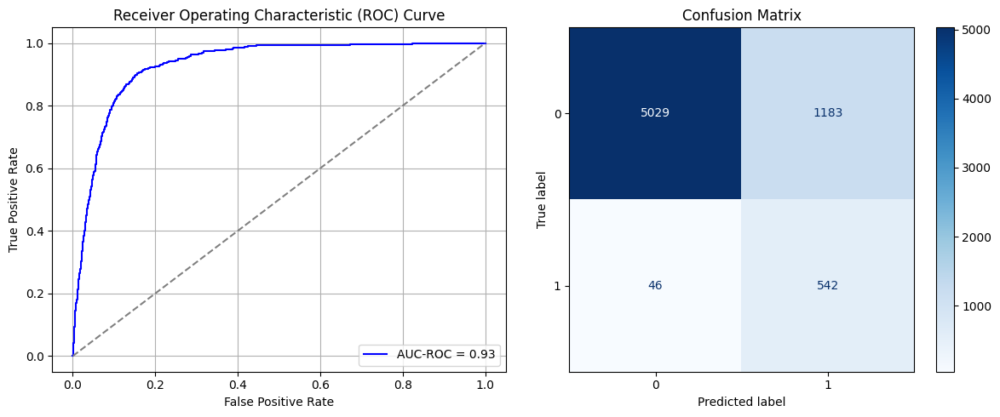

Best threshold based on F1-score: 0.7678840160369873
False Negative Rate: 0.0782312925170068
Time elapsed (performance): 1.2460247420003725
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7818 - loss: 0.5557 - val_AUC: 0.8883 - val_loss: 0.4285
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8875 - loss: 0.4230 - val_AUC: 0.8936 - val_loss: 0.4105
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8938 - loss: 0.4093 - val_AUC: 0.9013 - val_loss: 0.4275
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9024 - loss: 0.3934 - val_AUC: 0.9083 - val_loss: 0.3803
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9081 - loss: 0.3810 - val_AUC: 0.9124 - val_loss: 0.3734
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9110 - loss: 0.3730 - val_AUC: 0.9144 - val_loss: 0.3660
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9147 - loss: 0.3655 - val_AUC: 0.9154 - val_loss: 0.3641
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.9133 - loss: 0.3683 - val_AUC: 0.9174 - val_loss: 0.3790
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/st

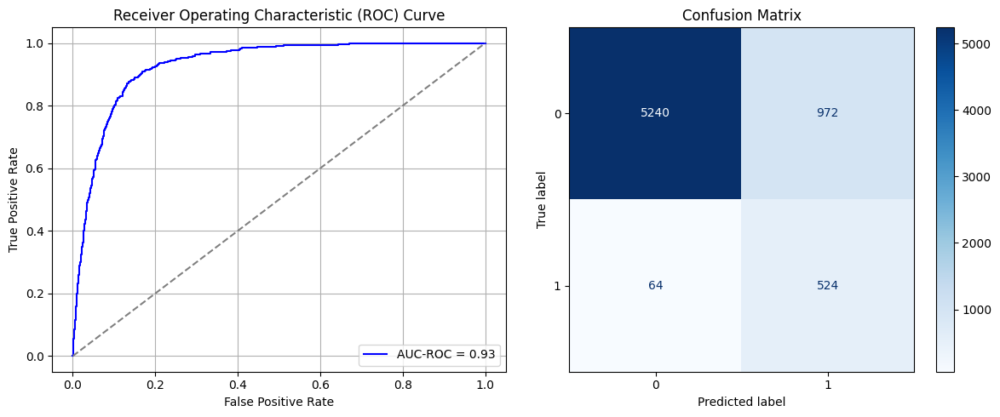

Best threshold based on F1-score: 0.7296077013015747
False Negative Rate: 0.10884353741496598
Time elapsed (performance): 1.0154398979993857
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7881 - loss: 0.5508 - val_AUC: 0.8854 - val_loss: 0.4330
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8817 - loss: 0.4331 - val_AUC: 0.8867 - val_loss: 0.4233
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8898 - loss: 0.4154 - val_AUC: 0.8956 - val_loss: 0.4216
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8933 - loss: 0.4095 - val_AUC: 0.9033 - val_loss: 0.3867
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9001 - loss: 0.3950 - val_AUC: 0.9087 - val_loss: 0.3761
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9072 - loss: 0.3799 - val_AUC: 0.9129 - val_loss: 0.3723
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9091 - loss: 0.3756 - val_AUC: 0.9151 - val_loss: 0.3628
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.9110 - loss: 0.3715 - val_AUC: 0.9162 - val_loss: 0.3572
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

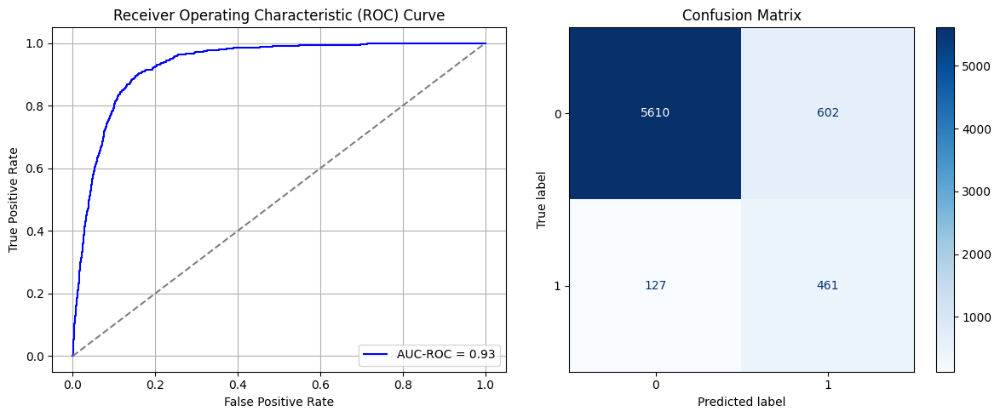

Best threshold based on F1-score: 0.9889294505119324
False Negative Rate: 0.21598639455782312
Time elapsed (performance): 0.7667864989998634
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7829 - loss: 0.5562 - val_AUC: 0.8840 - val_loss: 0.4634
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8844 - loss: 0.4302 - val_AUC: 0.8916 - val_loss: 0.4205
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8897 - loss: 0.4170 - val_AUC: 0.8993 - val_loss: 0.4075
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8991 - loss: 0.3994 - val_AUC: 0.9049 - val_loss: 0.3854
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9050 - loss: 0.3865 - val_AUC: 0.9079 - val_loss: 0.3812
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.9060 - loss: 0.3831 - val_AUC: 0.9092 - val_loss: 0.3767
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9096 - loss: 0.3748 - val_AUC: 0.9125 - val_loss: 0.3770
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9127 - loss: 0.3676 - val_AUC: 0.9150 - val_loss: 0.3646
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

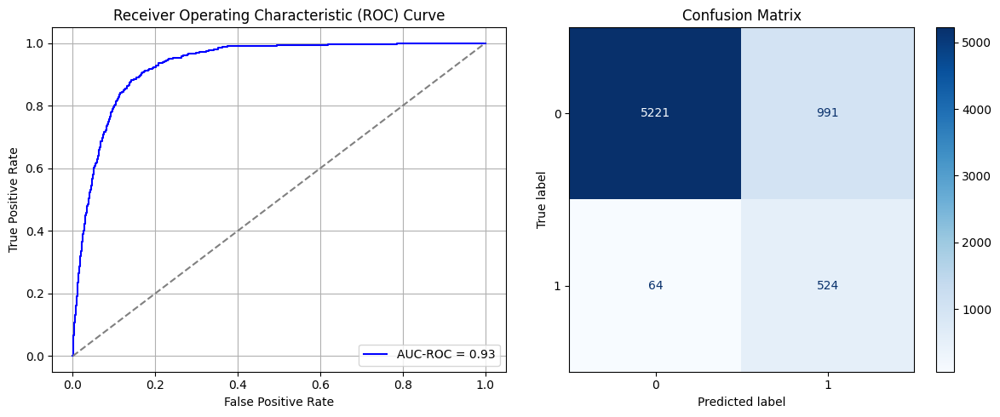

Best threshold based on F1-score: 0.9914000630378723
False Negative Rate: 0.10884353741496598
Time elapsed (performance): 0.7733377410004323
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7791 - loss: 0.5598 - val_AUC: 0.8888 - val_loss: 0.4248
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.8842 - loss: 0.4287 - val_AUC: 0.8943 - val_loss: 0.4112
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8909 - loss: 0.4151 - val_AUC: 0.8967 - val_loss: 0.4145
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8899 - loss: 0.4148 - val_AUC: 0.9011 - val_loss: 0.3944
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.8982 - loss: 0.4001 - val_AUC: 0.9055 - val_loss: 0.3931
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9000 - loss: 0.3957 - val_AUC: 0.9084 - val_loss: 0.3807
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9039 - loss: 0.3883 - val_AUC: 0.9104 - val_loss: 0.3746
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9060 - loss: 0.3824 - val_AUC: 0.9134 - val_loss: 0.3720
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/st

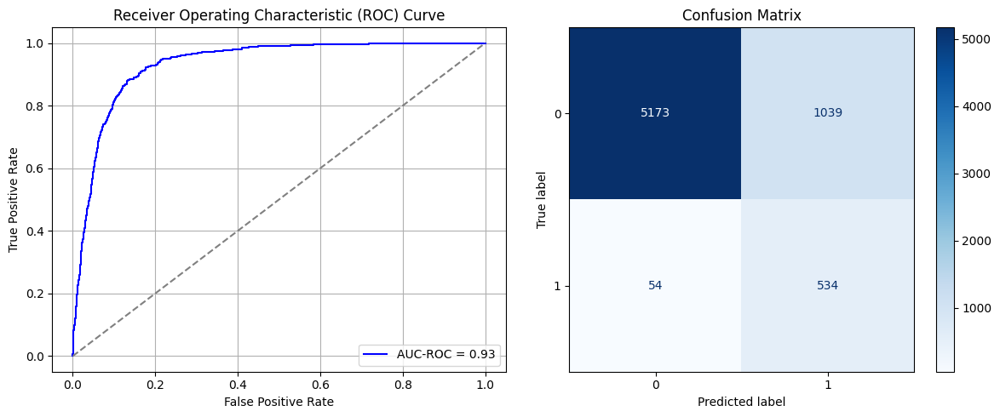

Best threshold based on F1-score: 0.7788267135620117
False Negative Rate: 0.09183673469387756
Time elapsed (performance): 0.7810162839996337
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7796 - loss: 0.5536 - val_AUC: 0.8922 - val_loss: 0.4211
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8832 - loss: 0.4292 - val_AUC: 0.8978 - val_loss: 0.4026
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8931 - loss: 0.4112 - val_AUC: 0.9049 - val_loss: 0.3892
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9020 - loss: 0.3933 - val_AUC: 0.9087 - val_loss: 0.3777
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.9060 - loss: 0.3845 - val_AUC: 0.9132 - val_loss: 0.3781
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9091 - loss: 0.3781 - val_AUC: 0.9161 - val_loss: 0.3612
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.9133 - loss: 0.3681 - val_AUC: 0.9177 - val_loss: 0.3663
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9141 - loss: 0.3665 - val_AUC: 0.9200 - val_loss: 0.3518
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

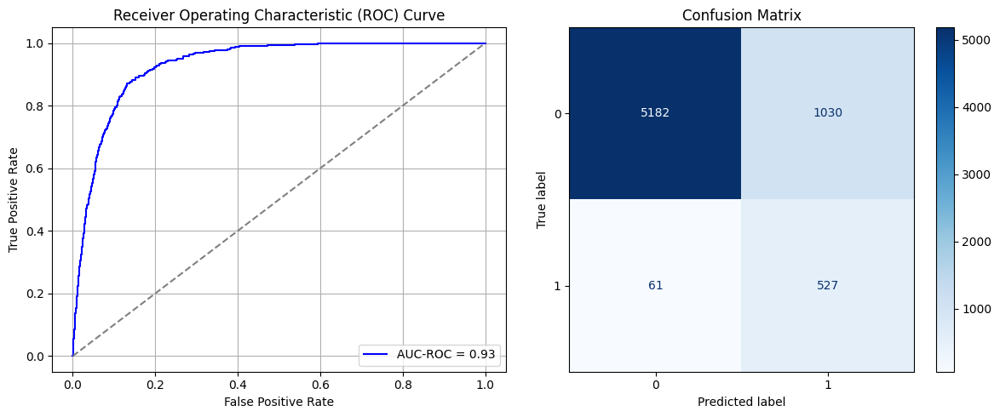

Best threshold based on F1-score: 0.9827923774719238
False Negative Rate: 0.10374149659863946
Time elapsed (performance): 0.7865675089997239
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7913 - loss: 0.5502 - val_AUC: 0.8891 - val_loss: 0.4252
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8841 - loss: 0.4317 - val_AUC: 0.8961 - val_loss: 0.4063
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8945 - loss: 0.4088 - val_AUC: 0.9042 - val_loss: 0.3892
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8992 - loss: 0.3979 - val_AUC: 0.9069 - val_loss: 0.4048
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9050 - loss: 0.3848 - val_AUC: 0.9110 - val_loss: 0.3888
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9100 - loss: 0.3735 - val_AUC: 0.9142 - val_loss: 0.3654
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9126 - loss: 0.3677 - val_AUC: 0.9157 - val_loss: 0.3600
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9142 - loss: 0.3646 - val_AUC: 0.9183 - val_loss: 0.3535
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9280690544086276
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.85      0.91      6212
           1       0.35      0.89      0.51       588

    accuracy                           0.85      6800
   macro avg       0.67      0.87      0.71      6800
weighted avg       0.93      0.85      0.88      6800

FPR 0.15453960077269802 TPR: 0.8928571428571429 FNR: 0.10714285714285714 TNR: 0.845460399227302


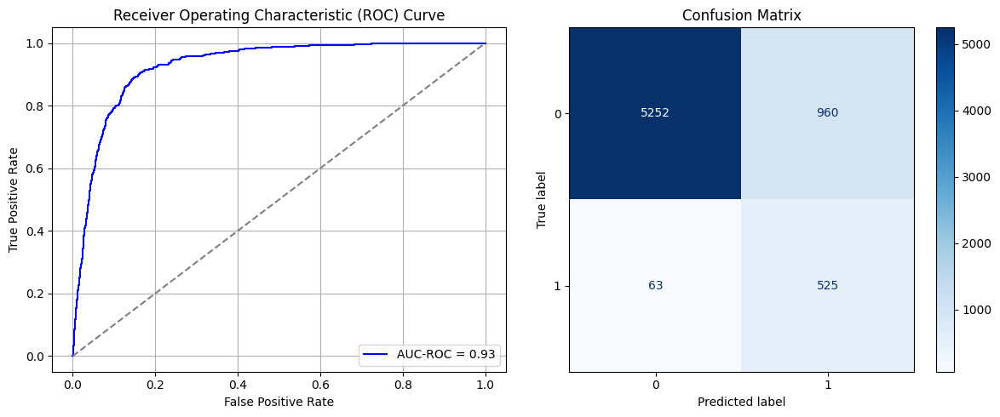

Best threshold based on F1-score: 0.9858877658843994
False Negative Rate: 0.10714285714285714
Time elapsed (performance): 1.1931478290007362
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7946 - loss: 0.5468 - val_AUC: 0.8861 - val_loss: 0.4282
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8871 - loss: 0.4239 - val_AUC: 0.8925 - val_loss: 0.4202
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8951 - loss: 0.4073 - val_AUC: 0.8981 - val_loss: 0.3998
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8949 - loss: 0.4063 - val_AUC: 0.9032 - val_loss: 0.3997
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9067 - loss: 0.3839 - val_AUC: 0.9099 - val_loss: 0.3744
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9091 - loss: 0.3768 - val_AUC: 0.9116 - val_loss: 0.3736
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9139 - loss: 0.3667 - val_AUC: 0.9159 - val_loss: 0.3679
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9180 - loss: 0.3572 - val_AUC: 0.9155 - val_loss: 0.3806
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.932276130027027
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.85      0.92      6212
           1       0.37      0.89      0.52       588

    accuracy                           0.86      6800
   macro avg       0.68      0.87      0.72      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.14536381197681905 TPR: 0.8860544217687075 FNR: 0.11394557823129252 TNR: 0.854636188023181


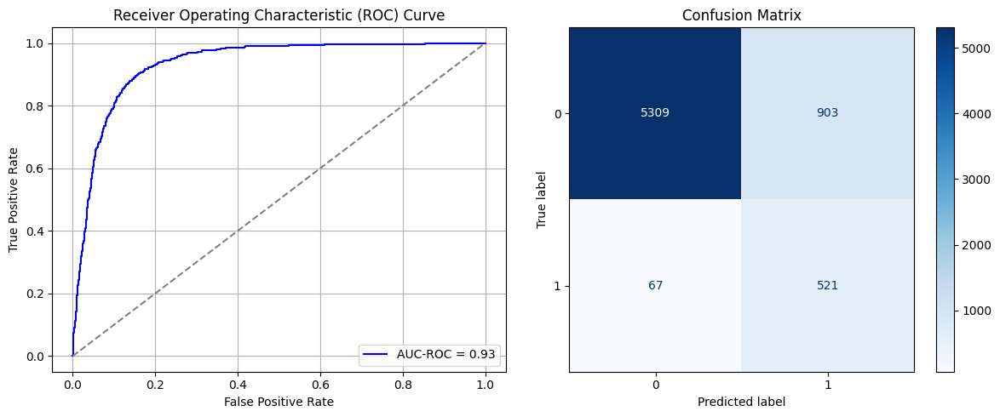

Best threshold based on F1-score: 0.7783387303352356
False Negative Rate: 0.11394557823129252
Time elapsed (performance): 1.0523417959993822
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7915 - loss: 0.5491 - val_AUC: 0.8878 - val_loss: 0.4257
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8855 - loss: 0.4264 - val_AUC: 0.8939 - val_loss: 0.4104
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8917 - loss: 0.4130 - val_AUC: 0.8995 - val_loss: 0.3996
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8931 - loss: 0.4085 - val_AUC: 0.9019 - val_loss: 0.3926
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8991 - loss: 0.3975 - val_AUC: 0.9082 - val_loss: 0.3791
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9060 - loss: 0.3839 - val_AUC: 0.9101 - val_loss: 0.3733
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9073 - loss: 0.3803 - val_AUC: 0.9141 - val_loss: 0.3656
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.9123 - loss: 0.3698 - val_AUC: 0.9151 - val_loss: 0.3639
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9158346693474557
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.80      0.89      6212
           1       0.30      0.91      0.46       588

    accuracy                           0.81      6800
   macro avg       0.65      0.86      0.67      6800
weighted avg       0.93      0.81      0.85      6800

FPR 0.19784288473921444 TPR: 0.9115646258503401 FNR: 0.08843537414965986 TNR: 0.8021571152607856


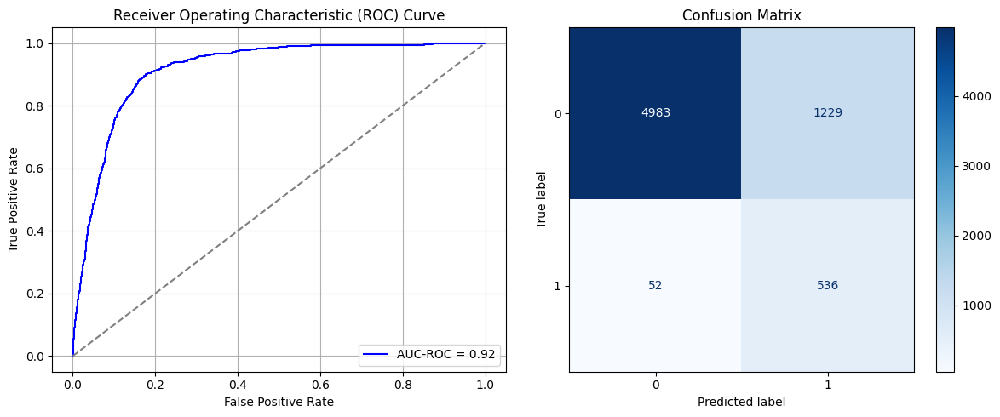

Best threshold based on F1-score: 0.9830700159072876
False Negative Rate: 0.08843537414965986
Time elapsed (performance): 0.9526259920003213
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7762 - loss: 0.5598 - val_AUC: 0.8856 - val_loss: 0.4288
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8855 - loss: 0.4253 - val_AUC: 0.8935 - val_loss: 0.4106
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8914 - loss: 0.4126 - val_AUC: 0.8988 - val_loss: 0.3972
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8987 - loss: 0.3988 - val_AUC: 0.9033 - val_loss: 0.3924
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9030 - loss: 0.3902 - val_AUC: 0.9070 - val_loss: 0.3830
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9074 - loss: 0.3805 - val_AUC: 0.9104 - val_loss: 0.3746
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9118 - loss: 0.3709 - val_AUC: 0.9130 - val_loss: 0.3651
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9136 - loss: 0.3666 - val_AUC: 0.9167 - val_loss: 0.3617
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/st

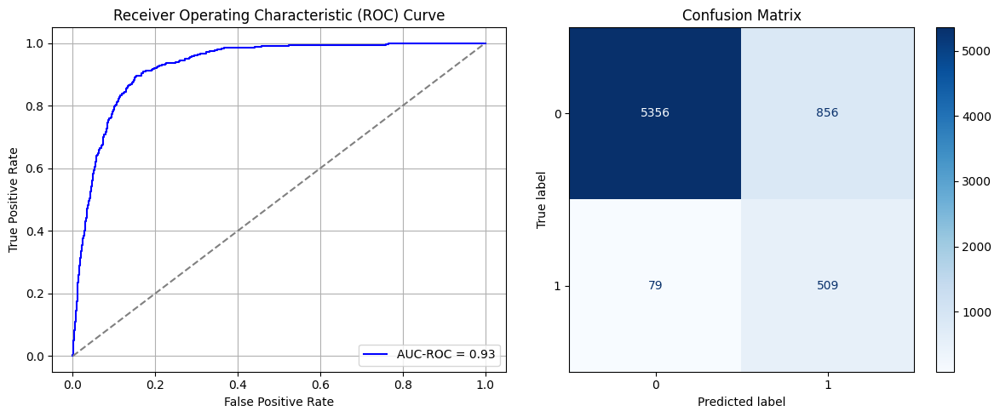

Best threshold based on F1-score: 0.7813960909843445
False Negative Rate: 0.13435374149659865
Time elapsed (performance): 1.2110073660005582
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7817 - loss: 0.5562 - val_AUC: 0.8846 - val_loss: 0.4321
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8831 - loss: 0.4296 - val_AUC: 0.8929 - val_loss: 0.4102
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.8910 - loss: 0.4129 - val_AUC: 0.8996 - val_loss: 0.4029
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9014 - loss: 0.3932 - val_AUC: 0.9055 - val_loss: 0.3927
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9091 - loss: 0.3760 - val_AUC: 0.9099 - val_loss: 0.3749
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9108 - loss: 0.3730 - val_AUC: 0.9138 - val_loss: 0.3656
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9133 - loss: 0.3660 - val_AUC: 0.9159 - val_loss: 0.3593
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9200 - loss: 0.3518 - val_AUC: 0.9165 - val_loss: 0.3579
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9296813058771479
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.86      0.92      6212
           1       0.37      0.87      0.52       588

    accuracy                           0.86      6800
   macro avg       0.68      0.87      0.72      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.14230521571152607 TPR: 0.8741496598639455 FNR: 0.12585034013605442 TNR: 0.8576947842884739


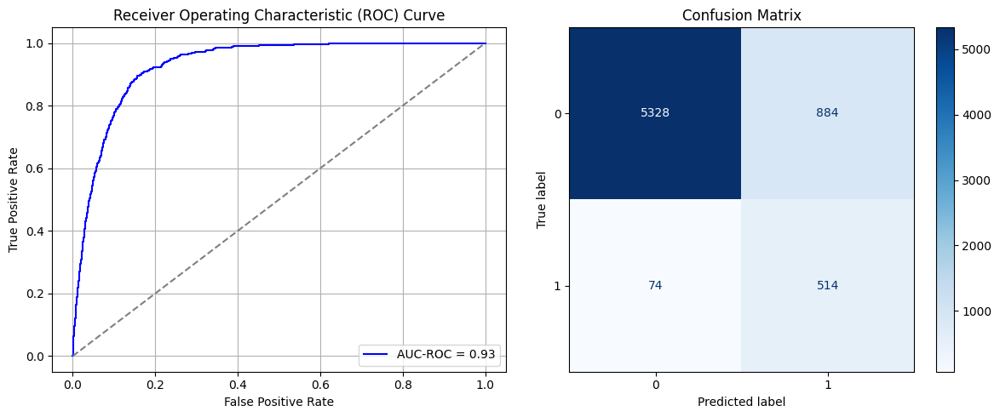

Best threshold based on F1-score: 0.9826549291610718
False Negative Rate: 0.12585034013605442
Time elapsed (performance): 1.2599598340002558
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 12s 8ms/step - AUC: 0.7730 - loss: 0.5619 - val_AUC: 0.8832 - val_loss: 0.4333
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 15s 4ms/step - AUC: 0.8805 - loss: 0.4360 - val_AUC: 0.8908 - val_loss: 0.4285
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8910 - loss: 0.4159 - val_AUC: 0.8961 - val_loss: 0.4087
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8960 - loss: 0.4048 - val_AUC: 0.9033 - val_loss: 0.3923
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9033 - loss: 0.3897 - val_AUC: 0.9084 - val_loss: 0.3785
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9107 - loss: 0.3742 - val_AUC: 0.9092 - val_loss: 0.3755
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9122 - loss: 0.3698 - val_AUC: 0.9138 - val_loss: 0.3709
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9156 - loss: 0.3625 - val_AUC: 0.9164 - val_loss: 0.3599
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/

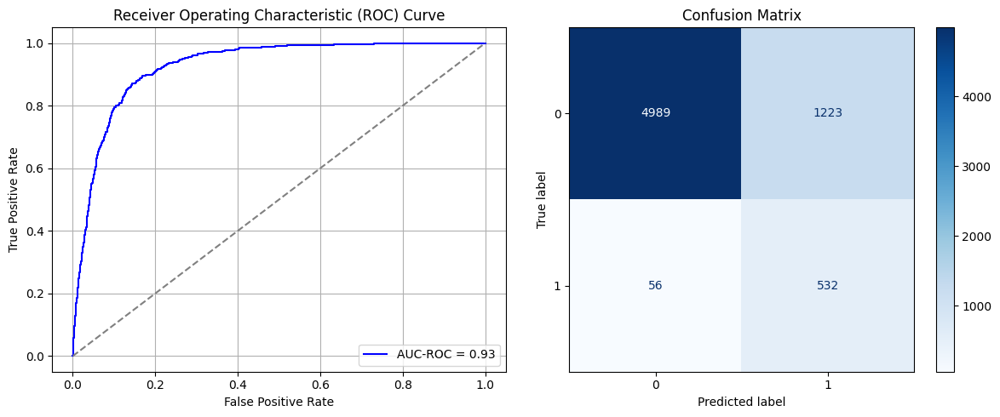

Best threshold based on F1-score: 0.8010038137435913
False Negative Rate: 0.09523809523809523
Time elapsed (performance): 1.0964786489985272
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7898 - loss: 0.5513 - val_AUC: 0.8871 - val_loss: 0.4332
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8859 - loss: 0.4256 - val_AUC: 0.8920 - val_loss: 0.4356
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8889 - loss: 0.4190 - val_AUC: 0.8993 - val_loss: 0.4263
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8958 - loss: 0.4045 - val_AUC: 0.9036 - val_loss: 0.3881
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9008 - loss: 0.3947 - val_AUC: 0.9072 - val_loss: 0.3857
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9053 - loss: 0.3841 - val_AUC: 0.9103 - val_loss: 0.3729
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9095 - loss: 0.3738 - val_AUC: 0.9129 - val_loss: 0.3747
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9115 - loss: 0.3688 - val_AUC: 0.9154 - val_loss: 0.3619
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9248012952766426
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.81      0.89      6212
           1       0.31      0.91      0.46       588

    accuracy                           0.81      6800
   macro avg       0.65      0.86      0.67      6800
weighted avg       0.93      0.81      0.85      6800

FPR 0.19397939471989697 TPR: 0.9081632653061225 FNR: 0.09183673469387756 TNR: 0.806020605280103


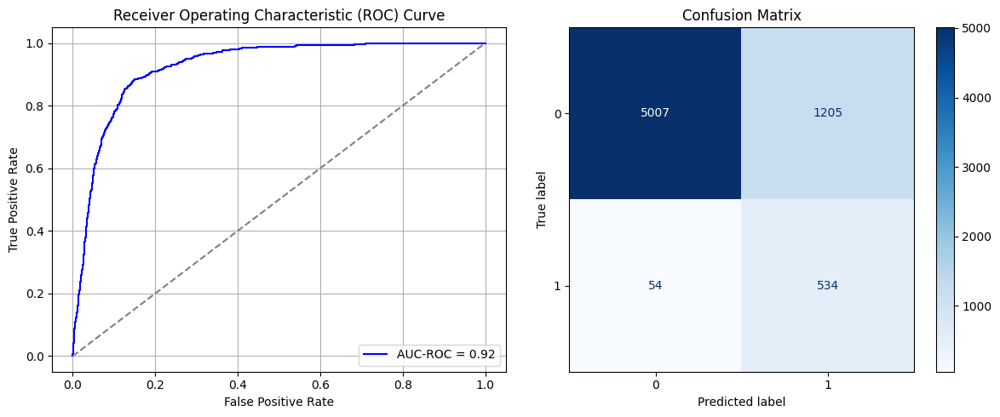

Best threshold based on F1-score: 0.8135409355163574
False Negative Rate: 0.09183673469387756
Time elapsed (performance): 0.9137464790001104
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7934 - loss: 0.5510 - val_AUC: 0.8907 - val_loss: 0.4212
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8854 - loss: 0.4288 - val_AUC: 0.8984 - val_loss: 0.4076
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8927 - loss: 0.4111 - val_AUC: 0.9017 - val_loss: 0.4012
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9016 - loss: 0.3939 - val_AUC: 0.9086 - val_loss: 0.3780
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9045 - loss: 0.3869 - val_AUC: 0.9127 - val_loss: 0.3673
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9066 - loss: 0.3812 - val_AUC: 0.9152 - val_loss: 0.3612
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9133 - loss: 0.3677 - val_AUC: 0.9157 - val_loss: 0.3645
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9141 - loss: 0.3652 - val_AUC: 0.9166 - val_loss: 0.3600
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9283458393015931
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.82      0.90      6212
           1       0.32      0.91      0.48       588

    accuracy                           0.83      6800
   macro avg       0.66      0.87      0.69      6800
weighted avg       0.93      0.83      0.86      6800

FPR 0.1831938184159691 TPR: 0.9149659863945578 FNR: 0.08503401360544217 TNR: 0.8168061815840308


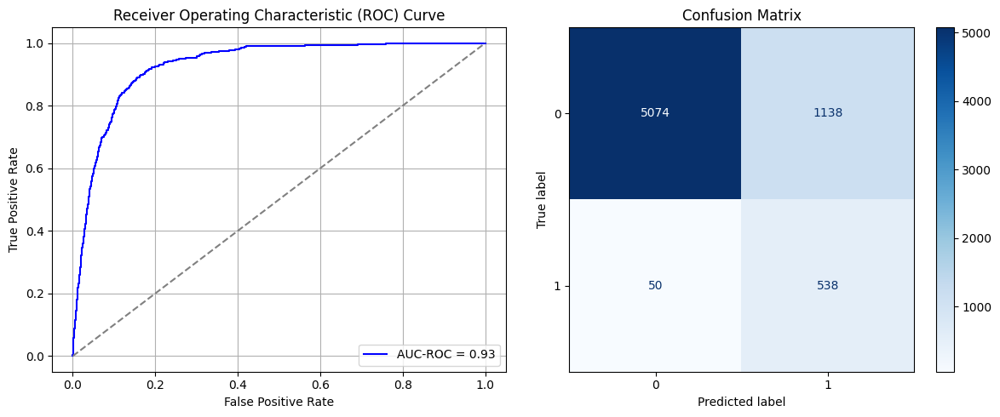

Best threshold based on F1-score: 0.787233829498291
False Negative Rate: 0.08503401360544217
Time elapsed (performance): 0.8763004200009163
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7905 - loss: 0.5511 - val_AUC: 0.8841 - val_loss: 0.4312
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8834 - loss: 0.4307 - val_AUC: 0.8908 - val_loss: 0.4328
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8903 - loss: 0.4143 - val_AUC: 0.8965 - val_loss: 0.4080
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.8958 - loss: 0.4039 - val_AUC: 0.9021 - val_loss: 0.3906
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9017 - loss: 0.3911 - val_AUC: 0.9062 - val_loss: 0.3821
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9068 - loss: 0.3807 - val_AUC: 0.9088 - val_loss: 0.3753
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9120 - loss: 0.3693 - val_AUC: 0.9113 - val_loss: 0.3732
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9115 - loss: 0.3707 - val_AUC: 0.9100 - val_loss: 0.3751
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/s

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9212058294019475
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.84      0.91      6212
           1       0.34      0.88      0.49       588

    accuracy                           0.84      6800
   macro avg       0.66      0.86      0.70      6800
weighted avg       0.93      0.84      0.87      6800

FPR 0.16307147456535737 TPR: 0.8775510204081632 FNR: 0.12244897959183673 TNR: 0.8369285254346426


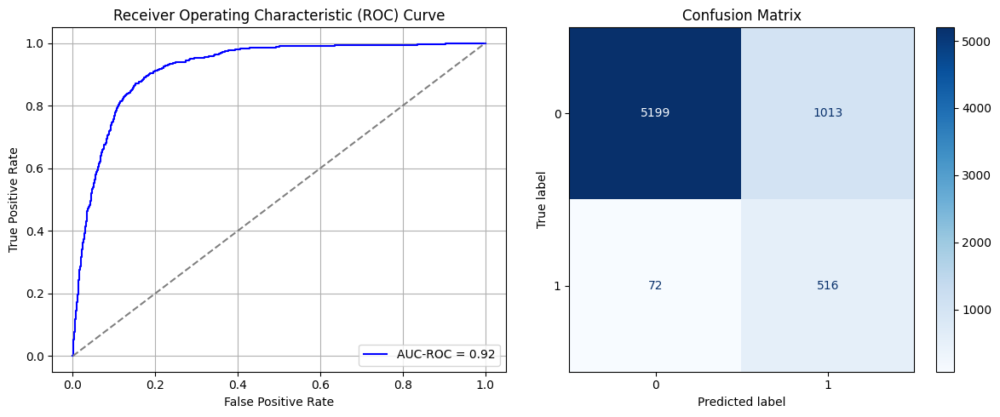

Best threshold based on F1-score: 0.993807315826416
False Negative Rate: 0.12244897959183673
Time elapsed (performance): 0.8741511499993067
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7899 - loss: 0.5508 - val_AUC: 0.8832 - val_loss: 0.4488
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8826 - loss: 0.4317 - val_AUC: 0.8937 - val_loss: 0.4107
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8929 - loss: 0.4110 - val_AUC: 0.9011 - val_loss: 0.4023
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9029 - loss: 0.3914 - val_AUC: 0.9049 - val_loss: 0.3890
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9062 - loss: 0.3826 - val_AUC: 0.9080 - val_loss: 0.3806
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9080 - loss: 0.3793 - val_AUC: 0.9109 - val_loss: 0.3722
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9138 - loss: 0.3662 - val_AUC: 0.9116 - val_loss: 0.3769
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9133 - loss: 0.3670 - val_AUC: 0.9145 - val_loss: 0.3632
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/s

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9211878972451826
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.84      0.90      6212
           1       0.34      0.87      0.48       588

    accuracy                           0.84      6800
   macro avg       0.66      0.85      0.69      6800
weighted avg       0.93      0.84      0.87      6800

FPR 0.16387636831938185 TPR: 0.8724489795918368 FNR: 0.12755102040816327 TNR: 0.8361236316806182


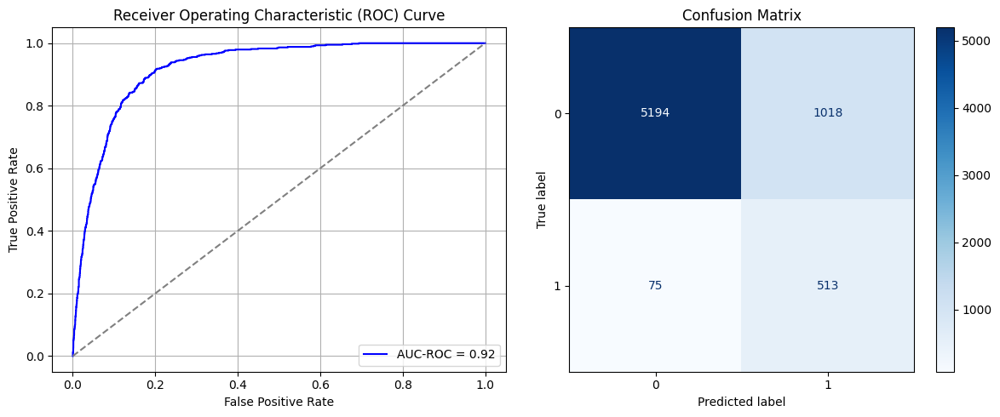

Best threshold based on F1-score: 0.7133845686912537
False Negative Rate: 0.12755102040816327
Time elapsed (performance): 0.9086256989994581
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7831 - loss: 0.5545 - val_AUC: 0.8855 - val_loss: 0.4306
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8817 - loss: 0.4333 - val_AUC: 0.8879 - val_loss: 0.4229
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8897 - loss: 0.4175 - val_AUC: 0.8961 - val_loss: 0.4098
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8912 - loss: 0.4133 - val_AUC: 0.9011 - val_loss: 0.4090
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 4ms/step - AUC: 0.9010 - loss: 0.3956 - val_AUC: 0.9046 - val_loss: 0.3895
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9075 - loss: 0.3821 - val_AUC: 0.9094 - val_loss: 0.3756
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.9107 - loss: 0.3730 - val_AUC: 0.9120 - val_loss: 0.3710
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9107 - loss: 0.3715 - val_AUC: 0.9137 - val_loss: 0.3646
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/s

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9279765190042533
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.86      0.92      6212
           1       0.37      0.88      0.52       588

    accuracy                           0.86      6800
   macro avg       0.68      0.87      0.72      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.14198325820991628 TPR: 0.8758503401360545 FNR: 0.12414965986394558 TNR: 0.8580167417900837


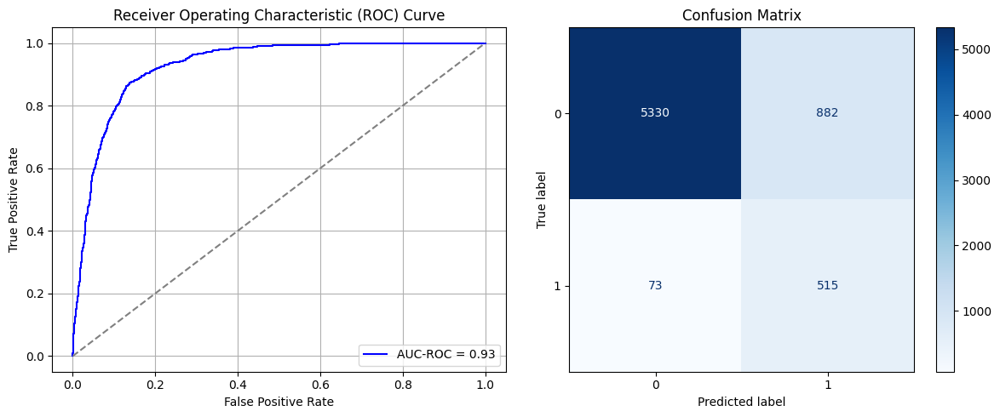

Best threshold based on F1-score: 0.7572708129882812
False Negative Rate: 0.12414965986394558
Time elapsed (performance): 0.8534370319994196
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7800 - loss: 0.5574 - val_AUC: 0.8880 - val_loss: 0.4234
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8805 - loss: 0.4341 - val_AUC: 0.8947 - val_loss: 0.4098
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8896 - loss: 0.4168 - val_AUC: 0.9006 - val_loss: 0.3969
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8922 - loss: 0.4111 - val_AUC: 0.9040 - val_loss: 0.3889
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8968 - loss: 0.4033 - val_AUC: 0.9059 - val_loss: 0.3955
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9042 - loss: 0.3876 - val_AUC: 0.9097 - val_loss: 0.3753
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9045 - loss: 0.3862 - val_AUC: 0.9110 - val_loss: 0.3708
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9044 - loss: 0.3851 - val_AUC: 0.9135 - val_loss: 0.3655
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9259210284242481
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.85      0.91      6212
           1       0.35      0.87      0.50       588

    accuracy                           0.85      6800
   macro avg       0.67      0.86      0.71      6800
weighted avg       0.93      0.85      0.88      6800

FPR 0.15292981326464908 TPR: 0.8707482993197279 FNR: 0.1292517006802721 TNR: 0.847070186735351


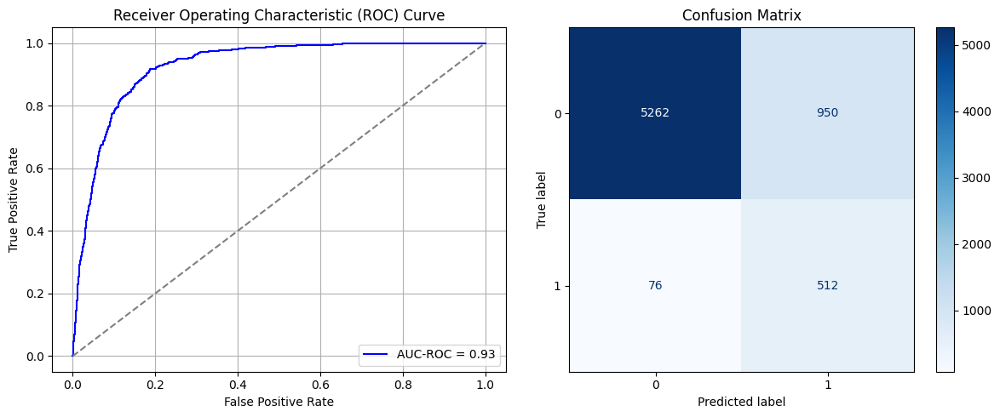

Best threshold based on F1-score: 0.9840419292449951
False Negative Rate: 0.1292517006802721
Time elapsed (performance): 1.0893983000005392
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7884 - loss: 0.5555 - val_AUC: 0.8858 - val_loss: 0.4492
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8854 - loss: 0.4268 - val_AUC: 0.8930 - val_loss: 0.4150
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8934 - loss: 0.4105 - val_AUC: 0.8997 - val_loss: 0.4005
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9007 - loss: 0.3954 - val_AUC: 0.9053 - val_loss: 0.3856
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9038 - loss: 0.3880 - val_AUC: 0.9079 - val_loss: 0.3827
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9073 - loss: 0.3798 - val_AUC: 0.9090 - val_loss: 0.3807
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9110 - loss: 0.3717 - val_AUC: 0.9125 - val_loss: 0.3672
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9116 - loss: 0.3703 - val_AUC: 0.9130 - val_loss: 0.3667
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
AUC-ROC: 0.9291395083468029
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.38      0.85      0.53       588

    accuracy                           0.87      6800
   macro avg       0.68      0.86      0.73      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.12974887314874436 TPR: 0.8503401360544218 FNR: 0.14965986394557823 TNR: 0.8702511268512556


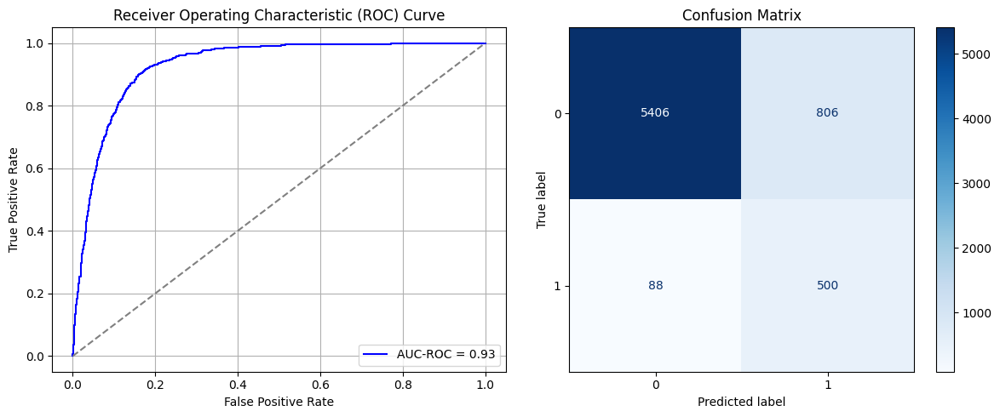

Best threshold based on F1-score: 0.7083871960639954
False Negative Rate: 0.14965986394557823
Time elapsed (performance): 1.340507296999931
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7860 - loss: 0.5527 - val_AUC: 0.8878 - val_loss: 0.4307
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8828 - loss: 0.4335 - val_AUC: 0.8929 - val_loss: 0.4151
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8889 - loss: 0.4186 - val_AUC: 0.8958 - val_loss: 0.4152
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8947 - loss: 0.4067 - val_AUC: 0.9027 - val_loss: 0.3984
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9026 - loss: 0.3908 - val_AUC: 0.9067 - val_loss: 0.3808
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9055 - loss: 0.3848 - val_AUC: 0.9107 - val_loss: 0.3726
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9114 - loss: 0.3727 - val_AUC: 0.9137 - val_loss: 0.3652
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9139 - loss: 0.3662 - val_AUC: 0.9171 - val_loss: 0.3625
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/st

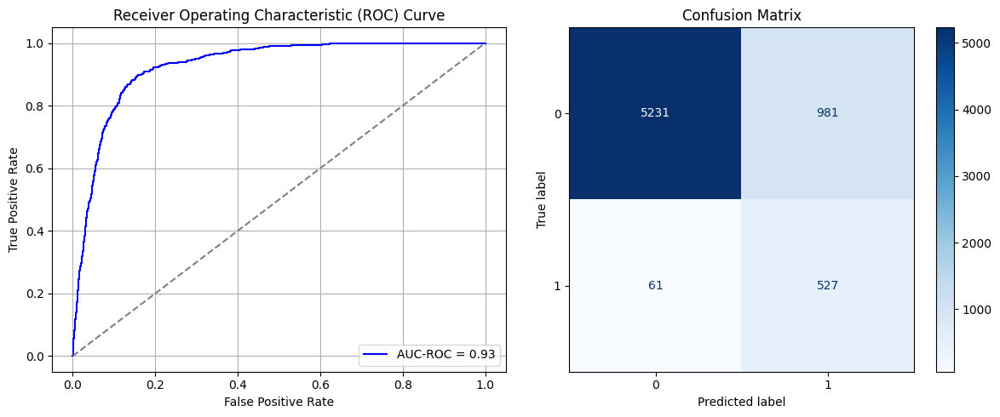

Best threshold based on F1-score: 0.9867531657218933
False Negative Rate: 0.10374149659863946
Time elapsed (performance): 0.895213469000737
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.7865 - loss: 0.5525 - val_AUC: 0.8877 - val_loss: 0.4257
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8896 - loss: 0.4198 - val_AUC: 0.8970 - val_loss: 0.4206
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8938 - loss: 0.4097 - val_AUC: 0.9029 - val_loss: 0.3897
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9040 - loss: 0.3884 - val_AUC: 0.9065 - val_loss: 0.3821
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9048 - loss: 0.3855 - val_AUC: 0.9114 - val_loss: 0.3737
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9077 - loss: 0.3791 - val_AUC: 0.9129 - val_loss: 0.3709
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9086 - loss: 0.3771 - val_AUC: 0.9148 - val_loss: 0.3743
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9139 - loss: 0.3656 - val_AUC: 0.9159 - val_loss: 0.3619
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9277388837054462
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.86      0.92      6212
           1       0.37      0.87      0.52       588

    accuracy                           0.86      6800
   macro avg       0.68      0.87      0.72      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.14117836445589182 TPR: 0.8724489795918368 FNR: 0.12755102040816327 TNR: 0.8588216355441082


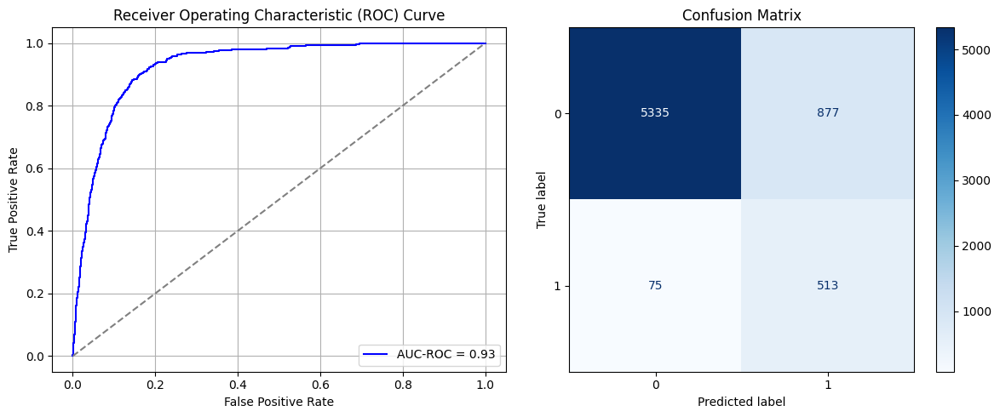

Best threshold based on F1-score: 0.7438499927520752
False Negative Rate: 0.12755102040816327
Time elapsed (performance): 1.076153482999871
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7857 - loss: 0.5538 - val_AUC: 0.8912 - val_loss: 0.4192
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 4ms/step - AUC: 0.8866 - loss: 0.4243 - val_AUC: 0.8993 - val_loss: 0.4009
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8954 - loss: 0.4058 - val_AUC: 0.9053 - val_loss: 0.3917
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9021 - loss: 0.3919 - val_AUC: 0.9086 - val_loss: 0.3790
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9057 - loss: 0.3833 - val_AUC: 0.9117 - val_loss: 0.3776
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9108 - loss: 0.3732 - val_AUC: 0.9132 - val_loss: 0.3707
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9139 - loss: 0.3663 - val_AUC: 0.9176 - val_loss: 0.3568
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9130 - loss: 0.3662 - val_AUC: 0.9191 - val_loss: 0.3532
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/s

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.928720908840033
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.84      0.91      6212
           1       0.34      0.89      0.50       588

    accuracy                           0.84      6800
   macro avg       0.67      0.86      0.70      6800
weighted avg       0.93      0.84      0.87      6800

FPR 0.16049581455247908 TPR: 0.8894557823129252 FNR: 0.11054421768707483 TNR: 0.8395041854475209


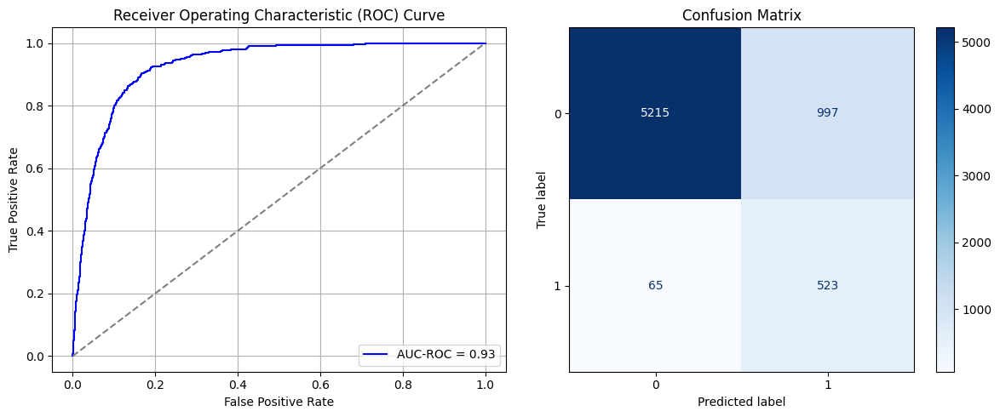

Best threshold based on F1-score: 0.796737551689148
False Negative Rate: 0.11054421768707483
Time elapsed (performance): 0.9067930640012491
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7967 - loss: 0.5464 - val_AUC: 0.8851 - val_loss: 0.4309
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8843 - loss: 0.4291 - val_AUC: 0.8920 - val_loss: 0.4158
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8944 - loss: 0.4074 - val_AUC: 0.8981 - val_loss: 0.4021
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8953 - loss: 0.4044 - val_AUC: 0.9013 - val_loss: 0.3931
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9017 - loss: 0.3930 - val_AUC: 0.9056 - val_loss: 0.3871
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9017 - loss: 0.3911 - val_AUC: 0.9077 - val_loss: 0.3792
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9072 - loss: 0.3793 - val_AUC: 0.9113 - val_loss: 0.3735
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9116 - loss: 0.3708 - val_AUC: 0.9123 - val_loss: 0.3702
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9237105821079237
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.82      0.90      6212
           1       0.33      0.91      0.48       588

    accuracy                           0.83      6800
   macro avg       0.66      0.87      0.69      6800
weighted avg       0.93      0.83      0.86      6800

FPR 0.17852543464262718 TPR: 0.9098639455782312 FNR: 0.09013605442176871 TNR: 0.8214745653573728


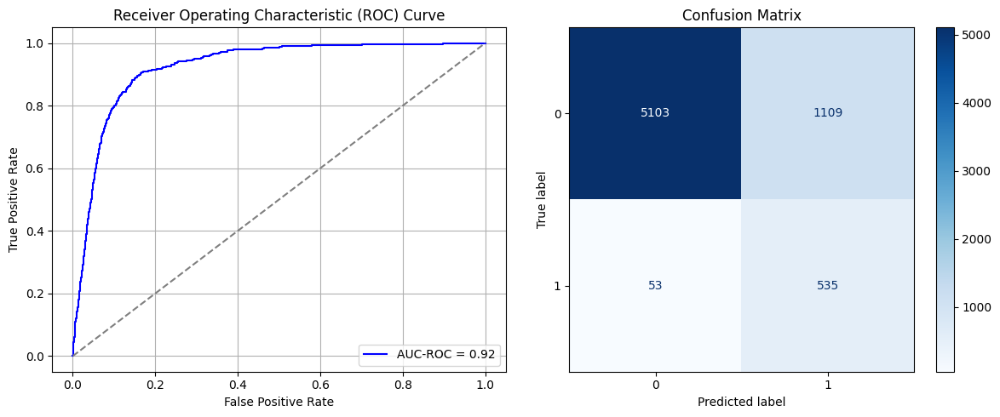

Best threshold based on F1-score: 0.7526538968086243
False Negative Rate: 0.09013605442176871
Time elapsed (performance): 0.9501092800001061
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7964 - loss: 0.5447 - val_AUC: 0.8837 - val_loss: 0.4293
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8870 - loss: 0.4233 - val_AUC: 0.8923 - val_loss: 0.4177
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8906 - loss: 0.4158 - val_AUC: 0.8991 - val_loss: 0.3987
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8985 - loss: 0.3996 - val_AUC: 0.9033 - val_loss: 0.3907
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9075 - loss: 0.3821 - val_AUC: 0.9077 - val_loss: 0.3939
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9102 - loss: 0.3750 - val_AUC: 0.9100 - val_loss: 0.3794
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9147 - loss: 0.3662 - val_AUC: 0.9136 - val_loss: 0.3723
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9150 - loss: 0.3641 - val_AUC: 0.9157 - val_loss: 0.3616
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9266506344971986
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.38      0.85      0.52       588

    accuracy                           0.87      6800
   macro avg       0.68      0.86      0.72      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.13264649066323245 TPR: 0.846938775510204 FNR: 0.15306122448979592 TNR: 0.8673535093367676


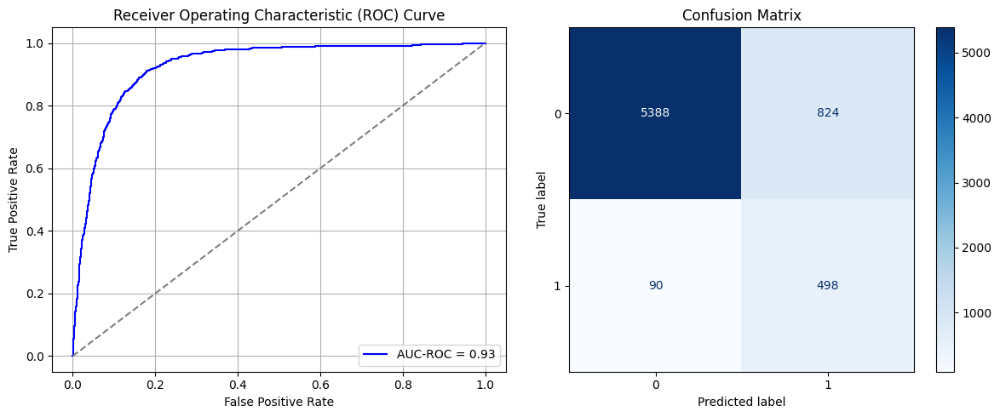

Best threshold based on F1-score: 0.6820456385612488
False Negative Rate: 0.15306122448979592
Time elapsed (performance): 0.925028009000016
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7794 - loss: 0.5584 - val_AUC: 0.8855 - val_loss: 0.4264
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8864 - loss: 0.4230 - val_AUC: 0.8931 - val_loss: 0.4146
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8930 - loss: 0.4100 - val_AUC: 0.8977 - val_loss: 0.4020
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8965 - loss: 0.4015 - val_AUC: 0.9056 - val_loss: 0.3861
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9029 - loss: 0.3890 - val_AUC: 0.9089 - val_loss: 0.3785
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - AUC: 0.9088 - loss: 0.3744 - val_AUC: 0.9122 - val_loss: 0.3673
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9134 - loss: 0.3670 - val_AUC: 0.9141 - val_loss: 0.3616
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9159 - loss: 0.3593 - val_AUC: 0.9145 - val_loss: 0.3700
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/st

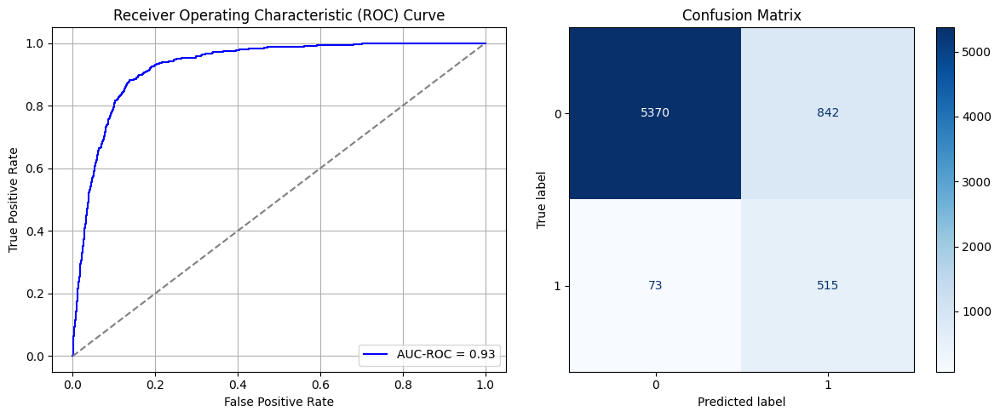

Best threshold based on F1-score: 0.9852718710899353
False Negative Rate: 0.12414965986394558
Time elapsed (performance): 0.876423108000381
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7972 - loss: 0.5451 - val_AUC: 0.8863 - val_loss: 0.4254
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8838 - loss: 0.4292 - val_AUC: 0.8934 - val_loss: 0.4194
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8879 - loss: 0.4209 - val_AUC: 0.8991 - val_loss: 0.3986
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8943 - loss: 0.4081 - val_AUC: 0.9028 - val_loss: 0.3904
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8975 - loss: 0.4013 - val_AUC: 0.9065 - val_loss: 0.3815
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.9020 - loss: 0.3921 - val_AUC: 0.9090 - val_loss: 0.3753
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9041 - loss: 0.3870 - val_AUC: 0.9111 - val_loss: 0.3707
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9071 - loss: 0.3791 - val_AUC: 0.9144 - val_loss: 0.3706
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9264420191772782
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.89      0.93      6212
           1       0.40      0.81      0.54       588

    accuracy                           0.88      6800
   macro avg       0.69      0.85      0.73      6800
weighted avg       0.93      0.88      0.90      6800

FPR 0.11316806181584031 TPR: 0.8078231292517006 FNR: 0.1921768707482993 TNR: 0.8868319381841597


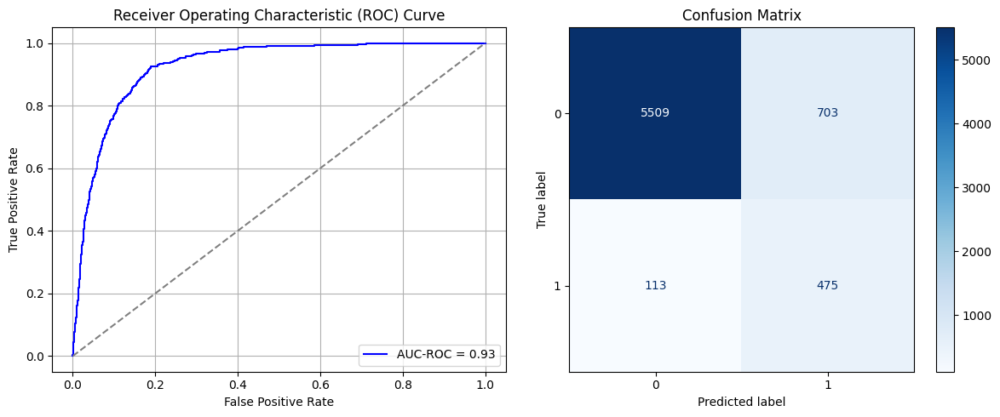

Best threshold based on F1-score: 0.6588642001152039
False Negative Rate: 0.1921768707482993
Time elapsed (performance): 0.9119840559997101
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.7859 - loss: 0.5517 - val_AUC: 0.8881 - val_loss: 0.4264
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8860 - loss: 0.4250 - val_AUC: 0.8953 - val_loss: 0.4085
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8920 - loss: 0.4126 - val_AUC: 0.9017 - val_loss: 0.3954
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8948 - loss: 0.4059 - val_AUC: 0.9054 - val_loss: 0.3853
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9007 - loss: 0.3938 - val_AUC: 0.9102 - val_loss: 0.3764
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9058 - loss: 0.3832 - val_AUC: 0.9120 - val_loss: 0.3720
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9110 - loss: 0.3727 - val_AUC: 0.9143 - val_loss: 0.3646
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.9115 - loss: 0.3711 - val_AUC: 0.9160 - val_loss: 0.3605
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/st

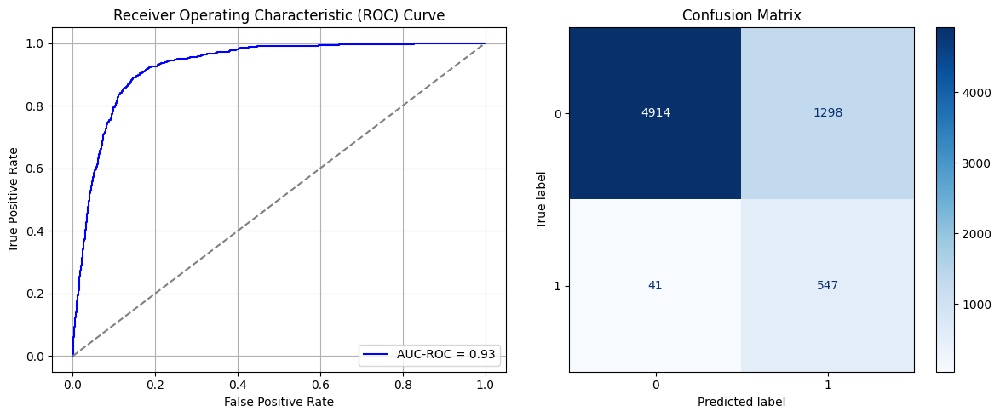

Best threshold based on F1-score: 0.7936757206916809
False Negative Rate: 0.06972789115646258
Time elapsed (performance): 1.7373283679989981
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7770 - loss: 0.5590 - val_AUC: 0.8870 - val_loss: 0.4339
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8862 - loss: 0.4240 - val_AUC: 0.8969 - val_loss: 0.4045
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8924 - loss: 0.4109 - val_AUC: 0.9032 - val_loss: 0.3905
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8994 - loss: 0.3967 - val_AUC: 0.9070 - val_loss: 0.3821
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9018 - loss: 0.3916 - val_AUC: 0.9097 - val_loss: 0.3819
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - AUC: 0.9029 - loss: 0.3894 - val_AUC: 0.9122 - val_loss: 0.3774
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9123 - loss: 0.3692 - val_AUC: 0.9144 - val_loss: 0.3662
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9112 - loss: 0.3709 - val_AUC: 0.9166 - val_loss: 0.3588
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

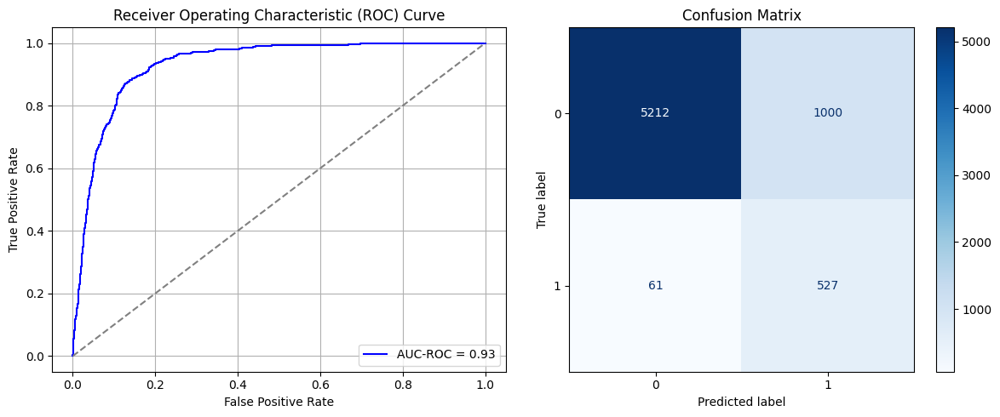

Best threshold based on F1-score: 0.8110036849975586
False Negative Rate: 0.10374149659863946
Time elapsed (performance): 0.9355779350007651
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7979 - loss: 0.5453 - val_AUC: 0.8882 - val_loss: 0.4257
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8845 - loss: 0.4275 - val_AUC: 0.8942 - val_loss: 0.4112
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8906 - loss: 0.4147 - val_AUC: 0.9006 - val_loss: 0.3958
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8983 - loss: 0.3992 - val_AUC: 0.9060 - val_loss: 0.3832
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9036 - loss: 0.3881 - val_AUC: 0.9099 - val_loss: 0.3835
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9071 - loss: 0.3805 - val_AUC: 0.9126 - val_loss: 0.3717
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9097 - loss: 0.3735 - val_AUC: 0.9124 - val_loss: 0.3815
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9138 - loss: 0.3642 - val_AUC: 0.9162 - val_loss: 0.3600
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

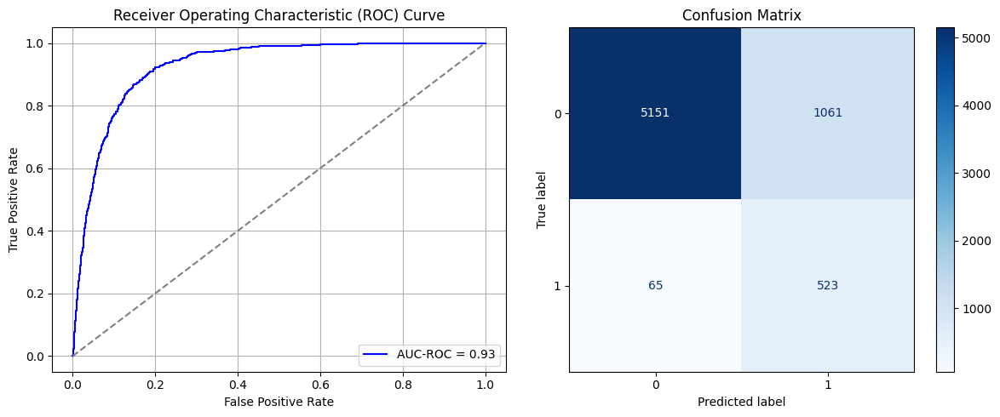

Best threshold based on F1-score: 0.9956526160240173
False Negative Rate: 0.11054421768707483
Time elapsed (performance): 0.8865824210006394
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7717 - loss: 0.5673 - val_AUC: 0.8802 - val_loss: 0.4445
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8807 - loss: 0.4366 - val_AUC: 0.8897 - val_loss: 0.4191
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8918 - loss: 0.4124 - val_AUC: 0.8957 - val_loss: 0.4035
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8940 - loss: 0.4059 - val_AUC: 0.9018 - val_loss: 0.3907
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9011 - loss: 0.3919 - val_AUC: 0.9055 - val_loss: 0.3849
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9063 - loss: 0.3816 - val_AUC: 0.9114 - val_loss: 0.3696
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9077 - loss: 0.3774 - val_AUC: 0.9145 - val_loss: 0.3683
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9132 - loss: 0.3665 - val_AUC: 0.9172 - val_loss: 0.3607
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
AUC-ROC: 0.9239586207953883
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.80      0.88      6212
           1       0.30      0.91      0.45       588

    accuracy                           0.81      6800
   macro avg       0.64      0.85      0.67      6800
weighted avg       0.93      0.81      0.85      6800

FPR 0.2033161622665808 TPR: 0.9115646258503401 FNR: 0.08843537414965986 TNR: 0.7966838377334192


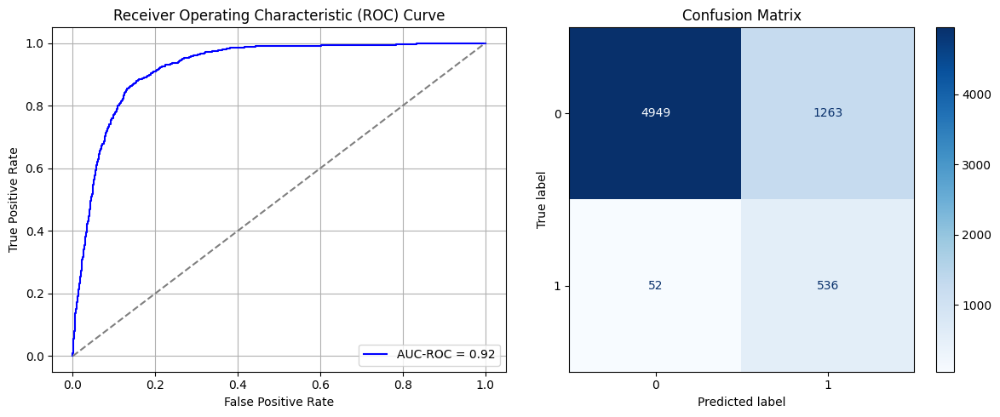

Best threshold based on F1-score: 0.7966214418411255
False Negative Rate: 0.08843537414965986
Time elapsed (performance): 1.902435649999461
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7899 - loss: 0.5502 - val_AUC: 0.8871 - val_loss: 0.4391
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8787 - loss: 0.4382 - val_AUC: 0.8926 - val_loss: 0.4138
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8860 - loss: 0.4237 - val_AUC: 0.8951 - val_loss: 0.4084
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8888 - loss: 0.4170 - val_AUC: 0.8978 - val_loss: 0.3994
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8974 - loss: 0.4009 - val_AUC: 0.9036 - val_loss: 0.3895
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8996 - loss: 0.3947 - val_AUC: 0.9065 - val_loss: 0.3814
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9032 - loss: 0.3882 - val_AUC: 0.9088 - val_loss: 0.3767
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9067 - loss: 0.3819 - val_AUC: 0.9136 - val_loss: 0.3660
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9298016292801731
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.87      0.92      6212
           1       0.38      0.87      0.53       588

    accuracy                           0.87      6800
   macro avg       0.68      0.87      0.72      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.13441725692208628 TPR: 0.8673469387755102 FNR: 0.1326530612244898 TNR: 0.8655827430779137


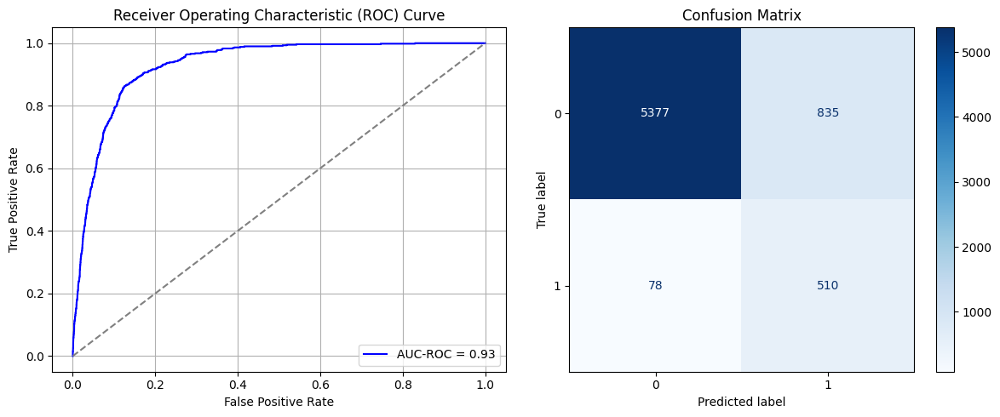

Best threshold based on F1-score: 0.6751454472541809
False Negative Rate: 0.1326530612244898
Time elapsed (performance): 0.9368099650000659
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.7807 - loss: 0.5574 - val_AUC: 0.8908 - val_loss: 0.4189
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8869 - loss: 0.4231 - val_AUC: 0.8981 - val_loss: 0.4099
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8931 - loss: 0.4109 - val_AUC: 0.9022 - val_loss: 0.3955
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8998 - loss: 0.3962 - val_AUC: 0.9061 - val_loss: 0.3854
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.9071 - loss: 0.3817 - val_AUC: 0.9104 - val_loss: 0.3721
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9066 - loss: 0.3800 - val_AUC: 0.9130 - val_loss: 0.3655
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9088 - loss: 0.3753 - val_AUC: 0.9146 - val_loss: 0.3625
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9146 - loss: 0.3628 - val_AUC: 0.9172 - val_loss: 0.3734
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/s

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.925964284619192
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.86      0.92      6212
           1       0.37      0.86      0.52       588

    accuracy                           0.86      6800
   macro avg       0.68      0.86      0.72      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.1389246619446233 TPR: 0.8571428571428572 FNR: 0.14285714285714285 TNR: 0.8610753380553767


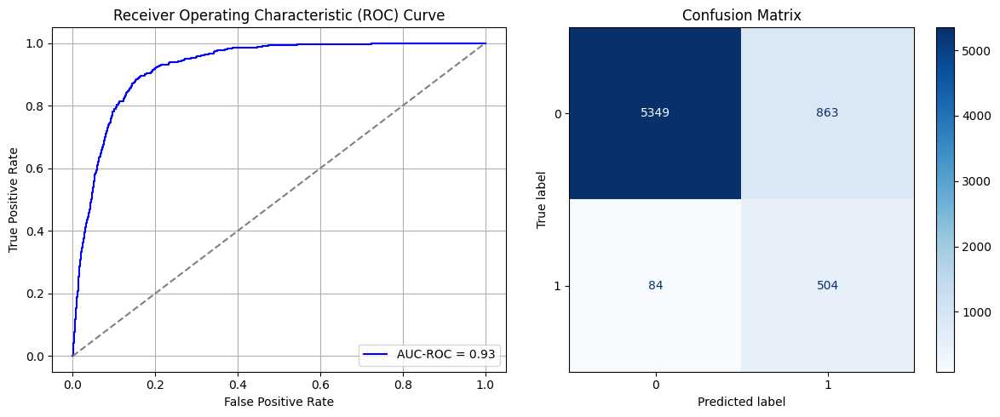

Best threshold based on F1-score: 0.6985416412353516
False Negative Rate: 0.14285714285714285
Time elapsed (performance): 1.0725407379995886
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7901 - loss: 0.5491 - val_AUC: 0.8888 - val_loss: 0.4271
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8848 - loss: 0.4275 - val_AUC: 0.8955 - val_loss: 0.4112
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8913 - loss: 0.4137 - val_AUC: 0.8996 - val_loss: 0.3970
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8987 - loss: 0.3985 - val_AUC: 0.9033 - val_loss: 0.4077
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9002 - loss: 0.3938 - val_AUC: 0.9063 - val_loss: 0.3852
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.9024 - loss: 0.3882 - val_AUC: 0.9104 - val_loss: 0.3764
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9097 - loss: 0.3735 - val_AUC: 0.9134 - val_loss: 0.3657
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9111 - loss: 0.3706 - val_AUC: 0.9150 - val_loss: 0.3662
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9295592029471158
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.81      0.89      6212
           1       0.31      0.91      0.47       588

    accuracy                           0.82      6800
   macro avg       0.65      0.86      0.68      6800
weighted avg       0.93      0.82      0.85      6800

FPR 0.1901159047005795 TPR: 0.9115646258503401 FNR: 0.08843537414965986 TNR: 0.8098840952994205


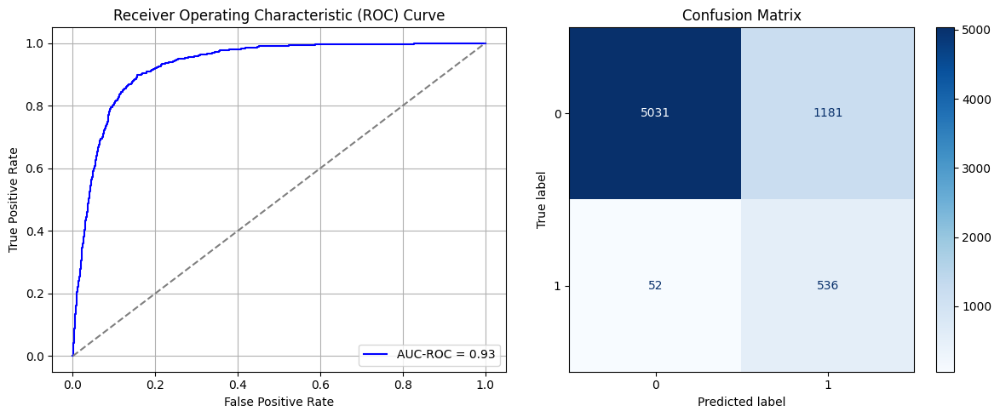

Best threshold based on F1-score: 0.9904981851577759
False Negative Rate: 0.08843537414965986
Time elapsed (performance): 1.2284293180000532
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7948 - loss: 0.5478 - val_AUC: 0.8886 - val_loss: 0.4216
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8863 - loss: 0.4243 - val_AUC: 0.8950 - val_loss: 0.4130
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8945 - loss: 0.4082 - val_AUC: 0.8991 - val_loss: 0.4066
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8993 - loss: 0.3978 - val_AUC: 0.9046 - val_loss: 0.3942
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9024 - loss: 0.3924 - val_AUC: 0.9091 - val_loss: 0.3781
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9062 - loss: 0.3827 - val_AUC: 0.9112 - val_loss: 0.3716
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9101 - loss: 0.3742 - val_AUC: 0.9150 - val_loss: 0.3702
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9151 - loss: 0.3626 - val_AUC: 0.9152 - val_loss: 0.3621
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/s

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9300333784511873
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.38      0.86      0.52       588

    accuracy                           0.86      6800
   macro avg       0.68      0.86      0.72      6800
weighted avg       0.93      0.86      0.89      6800

FPR 0.13441725692208628 TPR: 0.858843537414966 FNR: 0.141156462585034 TNR: 0.8655827430779137


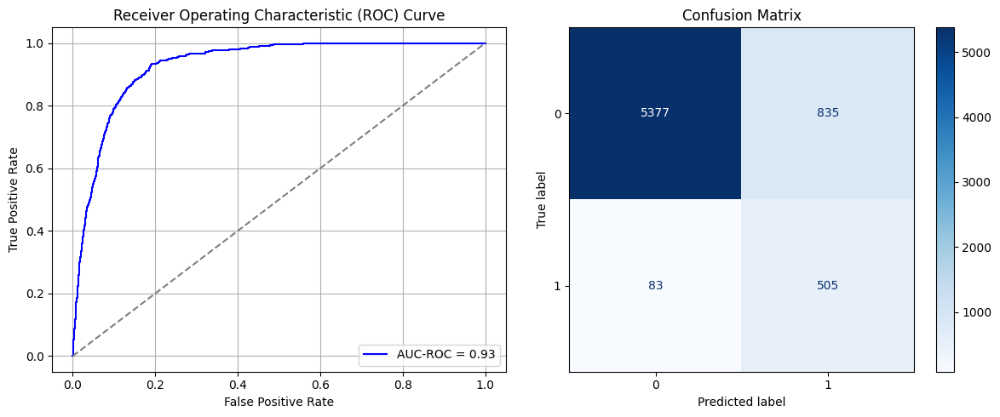

Best threshold based on F1-score: 0.9851369857788086
False Negative Rate: 0.141156462585034
Time elapsed (performance): 0.9259848860001512
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7830 - loss: 0.5524 - val_AUC: 0.8879 - val_loss: 0.4264
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.8808 - loss: 0.4355 - val_AUC: 0.8927 - val_loss: 0.4114
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8886 - loss: 0.4190 - val_AUC: 0.8962 - val_loss: 0.4026
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8914 - loss: 0.4121 - val_AUC: 0.9028 - val_loss: 0.3934
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8933 - loss: 0.4081 - val_AUC: 0.9049 - val_loss: 0.3892
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9028 - loss: 0.3893 - val_AUC: 0.9076 - val_loss: 0.3796
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.9030 - loss: 0.3887 - val_AUC: 0.9108 - val_loss: 0.3734
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9093 - loss: 0.3768 - val_AUC: 0.9127 - val_loss: 0.3692
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9310830256120477
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.87      0.92      6212
           1       0.39      0.87      0.54       588

    accuracy                           0.87      6800
   macro avg       0.69      0.87      0.73      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.12862202189311012 TPR: 0.8656462585034014 FNR: 0.13435374149659865 TNR: 0.8713779781068899


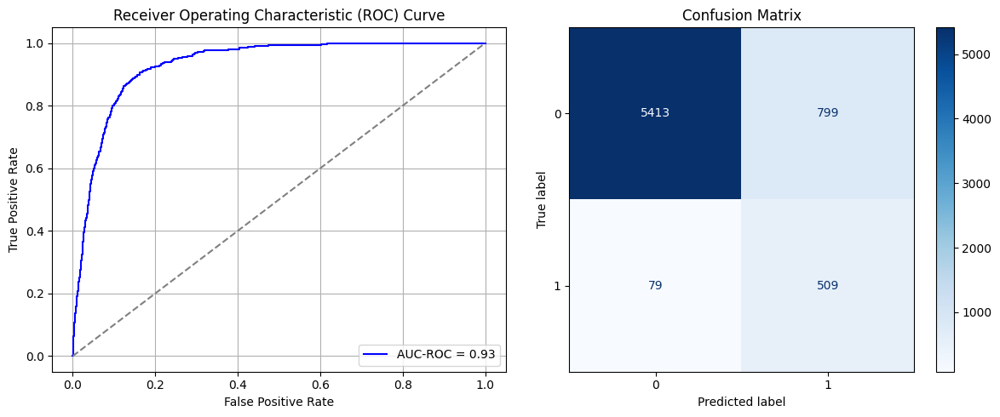

Best threshold based on F1-score: 0.6472142934799194
False Negative Rate: 0.13435374149659865
Time elapsed (performance): 0.9283088770007453
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7934 - loss: 0.5492 - val_AUC: 0.8914 - val_loss: 0.4513
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8826 - loss: 0.4326 - val_AUC: 0.8994 - val_loss: 0.4029
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8971 - loss: 0.4038 - val_AUC: 0.9033 - val_loss: 0.3955
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9003 - loss: 0.3948 - val_AUC: 0.9079 - val_loss: 0.3793
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9070 - loss: 0.3819 - val_AUC: 0.9107 - val_loss: 0.3724
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9081 - loss: 0.3778 - val_AUC: 0.9126 - val_loss: 0.3679
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9100 - loss: 0.3735 - val_AUC: 0.9132 - val_loss: 0.3716
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.9134 - loss: 0.3670 - val_AUC: 0.9151 - val_loss: 0.3664
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/s

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9272726476295605
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.85      0.91      6212
           1       0.35      0.87      0.50       588

    accuracy                           0.85      6800
   macro avg       0.67      0.86      0.71      6800
weighted avg       0.93      0.85      0.88      6800

FPR 0.15051513200257566 TPR: 0.8741496598639455 FNR: 0.12585034013605442 TNR: 0.8494848679974243


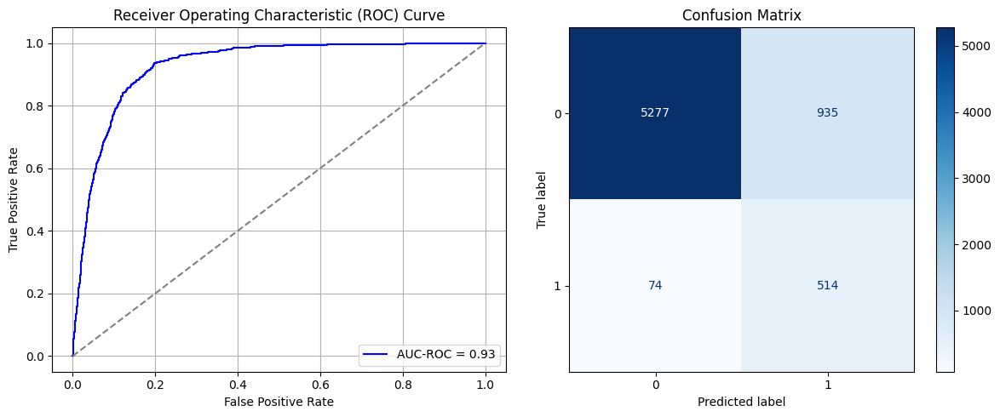

Best threshold based on F1-score: 0.9884076118469238
False Negative Rate: 0.12585034013605442
Time elapsed (performance): 0.8846267120006814
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7955 - loss: 0.5484 - val_AUC: 0.8837 - val_loss: 0.4328
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8817 - loss: 0.4330 - val_AUC: 0.8905 - val_loss: 0.4210
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8889 - loss: 0.4188 - val_AUC: 0.8960 - val_loss: 0.4101
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8945 - loss: 0.4062 - val_AUC: 0.9001 - val_loss: 0.3973
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9025 - loss: 0.3902 - val_AUC: 0.9045 - val_loss: 0.3859
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9043 - loss: 0.3851 - val_AUC: 0.9099 - val_loss: 0.3755
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9070 - loss: 0.3805 - val_AUC: 0.9127 - val_loss: 0.3686
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9119 - loss: 0.3695 - val_AUC: 0.9122 - val_loss: 0.3696
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/s

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.930071159178417
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.86      0.92      6212
           1       0.37      0.86      0.52       588

    accuracy                           0.86      6800
   macro avg       0.68      0.86      0.72      6800
weighted avg       0.93      0.86      0.89      6800

FPR 0.13747585318737926 TPR: 0.8622448979591837 FNR: 0.1377551020408163 TNR: 0.8625241468126208


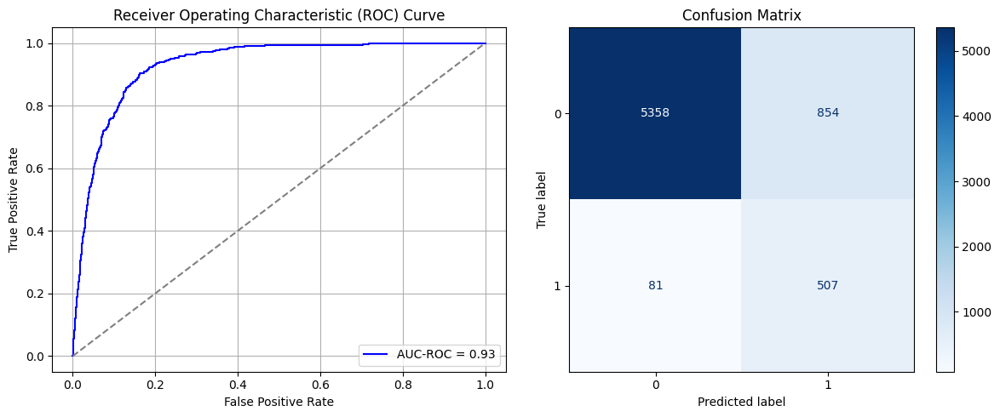

Best threshold based on F1-score: 0.9858725070953369
False Negative Rate: 0.1377551020408163
Time elapsed (performance): 1.0488816880006198
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7797 - loss: 0.5579 - val_AUC: 0.8889 - val_loss: 0.4230
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8856 - loss: 0.4264 - val_AUC: 0.8949 - val_loss: 0.4091
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8895 - loss: 0.4177 - val_AUC: 0.8999 - val_loss: 0.3976
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8977 - loss: 0.4010 - val_AUC: 0.9056 - val_loss: 0.3859
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9028 - loss: 0.3902 - val_AUC: 0.9088 - val_loss: 0.3788
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9057 - loss: 0.3830 - val_AUC: 0.9110 - val_loss: 0.3708
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 4ms/step - AUC: 0.9087 - loss: 0.3774 - val_AUC: 0.9121 - val_loss: 0.3765
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9142 - loss: 0.3655 - val_AUC: 0.9161 - val_loss: 0.3605
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms

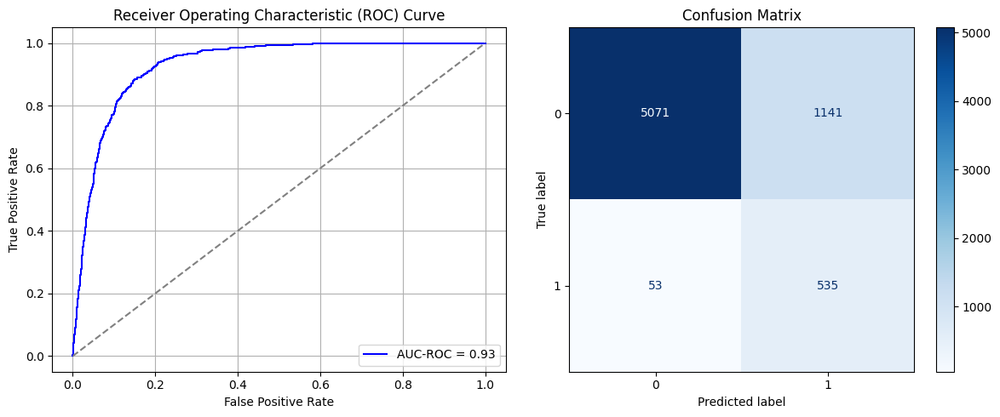

Best threshold based on F1-score: 0.8100438117980957
False Negative Rate: 0.09013605442176871
Time elapsed (performance): 0.9554035250002926
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7901 - loss: 0.5521 - val_AUC: 0.8828 - val_loss: 0.4354
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8818 - loss: 0.4328 - val_AUC: 0.8897 - val_loss: 0.4292
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8887 - loss: 0.4178 - val_AUC: 0.8946 - val_loss: 0.4077
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.8954 - loss: 0.4052 - val_AUC: 0.8990 - val_loss: 0.3972
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8985 - loss: 0.3989 - val_AUC: 0.9007 - val_loss: 0.3926
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9021 - loss: 0.3910 - val_AUC: 0.9052 - val_loss: 0.3845
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 12s 6ms/step - AUC: 0.9046 - loss: 0.3865 - val_AUC: 0.9091 - val_loss: 0.3910
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.9092 - loss: 0.3767 - val_AUC: 0.9120 - val_loss: 0.3695
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9307282153041512
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.81      0.89      6212
           1       0.32      0.92      0.47       588

    accuracy                           0.82      6800
   macro avg       0.65      0.87      0.68      6800
weighted avg       0.93      0.82      0.86      6800

FPR 0.18625241468126208 TPR: 0.9200680272108843 FNR: 0.07993197278911565 TNR: 0.8137475853187379


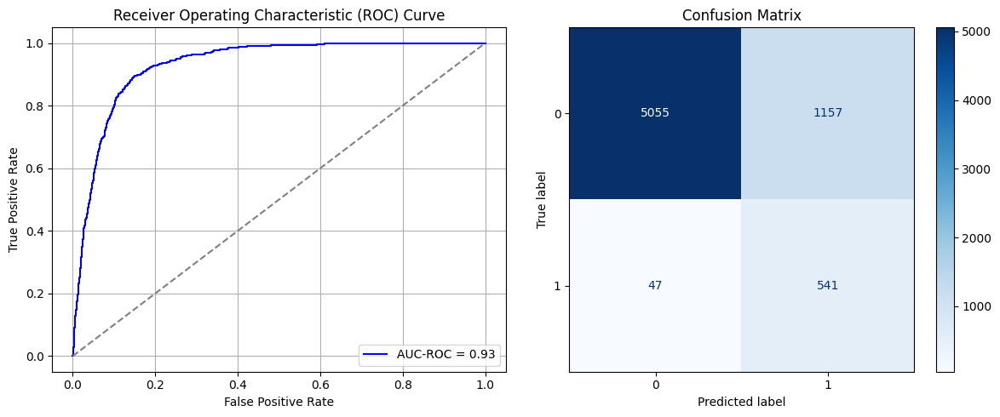

Best threshold based on F1-score: 0.8159794211387634
False Negative Rate: 0.07993197278911565
Time elapsed (performance): 0.9545288459994481
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7962 - loss: 0.5468 - val_AUC: 0.8897 - val_loss: 0.4215
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8828 - loss: 0.4304 - val_AUC: 0.8945 - val_loss: 0.4084
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8883 - loss: 0.4193 - val_AUC: 0.8987 - val_loss: 0.3976
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8967 - loss: 0.4016 - val_AUC: 0.9034 - val_loss: 0.3882
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8967 - loss: 0.4009 - val_AUC: 0.9055 - val_loss: 0.3823
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9013 - loss: 0.3919 - val_AUC: 0.9087 - val_loss: 0.3752
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.9033 - loss: 0.3869 - val_AUC: 0.9099 - val_loss: 0.3816
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9087 - loss: 0.3759 - val_AUC: 0.9132 - val_loss: 0.3646
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/s

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9306794836414927
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.79      0.88      6212
           1       0.29      0.94      0.45       588

    accuracy                           0.80      6800
   macro avg       0.64      0.86      0.66      6800
weighted avg       0.93      0.80      0.84      6800

FPR 0.21329684481648423 TPR: 0.9404761904761905 FNR: 0.05952380952380952 TNR: 0.7867031551835157


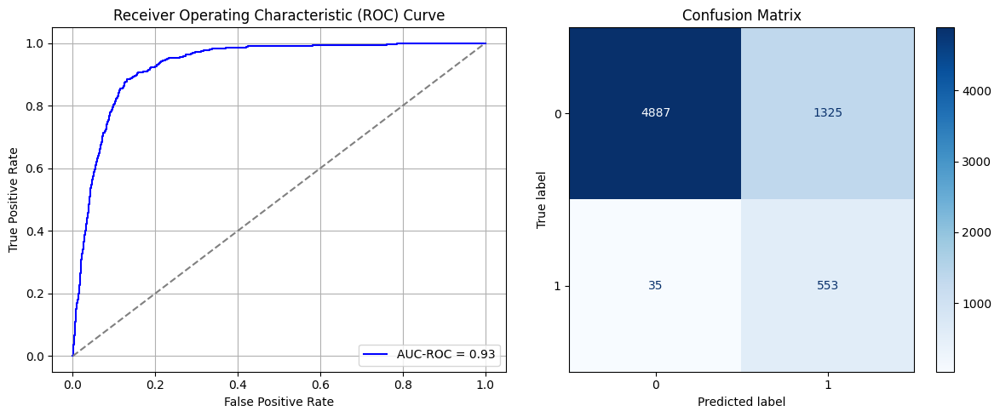

Best threshold based on F1-score: 0.9835224747657776
False Negative Rate: 0.05952380952380952
Time elapsed (performance): 1.170251260000441
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.7944 - loss: 0.5471 - val_AUC: 0.8872 - val_loss: 0.4290
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.8838 - loss: 0.4304 - val_AUC: 0.8945 - val_loss: 0.4106
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8907 - loss: 0.4157 - val_AUC: 0.9015 - val_loss: 0.3936
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8993 - loss: 0.3984 - val_AUC: 0.9057 - val_loss: 0.3884
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9067 - loss: 0.3832 - val_AUC: 0.9098 - val_loss: 0.3819
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9090 - loss: 0.3777 - val_AUC: 0.9118 - val_loss: 0.3819
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9104 - loss: 0.3744 - val_AUC: 0.9147 - val_loss: 0.3624
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - AUC: 0.9157 - loss: 0.3622 - val_AUC: 0.9146 - val_loss: 0.3617
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9297724724145936
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.85      0.92      6212
           1       0.37      0.89      0.52       588

    accuracy                           0.86      6800
   macro avg       0.68      0.87      0.72      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.14552479072762395 TPR: 0.8894557823129252 FNR: 0.11054421768707483 TNR: 0.8544752092723761


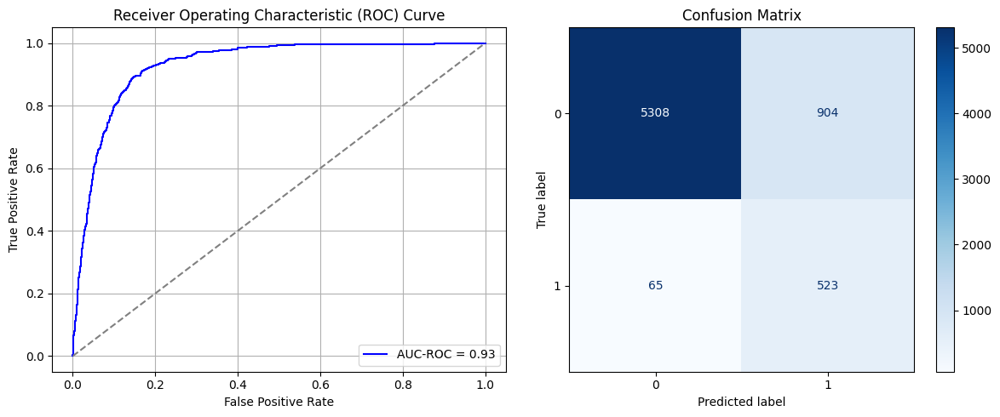

Best threshold based on F1-score: 0.7669517993927002
False Negative Rate: 0.11054421768707483
Time elapsed (performance): 1.0278074699999706
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7889 - loss: 0.5496 - val_AUC: 0.8845 - val_loss: 0.4323
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8846 - loss: 0.4294 - val_AUC: 0.8932 - val_loss: 0.4138
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8892 - loss: 0.4178 - val_AUC: 0.8970 - val_loss: 0.4066
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8945 - loss: 0.4061 - val_AUC: 0.9017 - val_loss: 0.3961
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9010 - loss: 0.3945 - val_AUC: 0.9062 - val_loss: 0.3828
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9044 - loss: 0.3861 - val_AUC: 0.9082 - val_loss: 0.3814
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9051 - loss: 0.3842 - val_AUC: 0.9105 - val_loss: 0.3718
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9101 - loss: 0.3737 - val_AUC: 0.9139 - val_loss: 0.3653
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/s

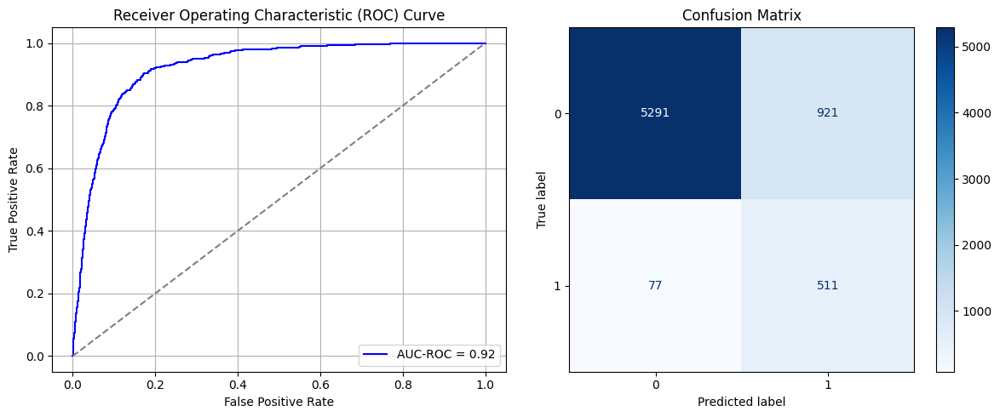

Best threshold based on F1-score: 0.6695915460586548
False Negative Rate: 0.13095238095238096
Time elapsed (performance): 0.9028916690003825
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.8030 - loss: 0.5432 - val_AUC: 0.8911 - val_loss: 0.4205
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8848 - loss: 0.4280 - val_AUC: 0.8990 - val_loss: 0.4044
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8967 - loss: 0.4033 - val_AUC: 0.9046 - val_loss: 0.3878
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9002 - loss: 0.3950 - val_AUC: 0.9102 - val_loss: 0.3781
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9020 - loss: 0.3903 - val_AUC: 0.9118 - val_loss: 0.3699
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9086 - loss: 0.3762 - val_AUC: 0.9141 - val_loss: 0.3649
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9120 - loss: 0.3697 - val_AUC: 0.9161 - val_loss: 0.3598
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9133 - loss: 0.3655 - val_AUC: 0.9169 - val_loss: 0.3577
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/s

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9342552378324157
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.86      0.92      6212
           1       0.38      0.88      0.53       588

    accuracy                           0.86      6800
   macro avg       0.68      0.87      0.73      6800
weighted avg       0.93      0.86      0.89      6800

FPR 0.13715389568576947 TPR: 0.8826530612244898 FNR: 0.11734693877551021 TNR: 0.8628461043142306


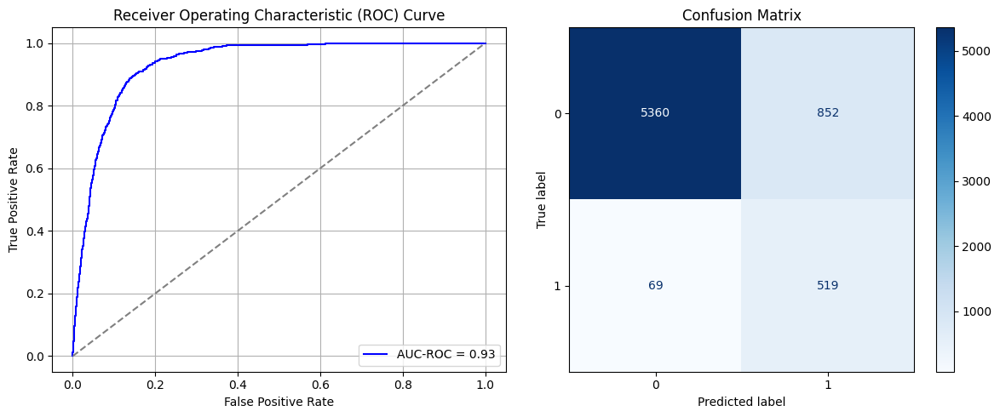

Best threshold based on F1-score: 0.7322071194648743
False Negative Rate: 0.11734693877551021
Time elapsed (performance): 0.9670259640006407
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7866 - loss: 0.5538 - val_AUC: 0.8852 - val_loss: 0.4393
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8834 - loss: 0.4335 - val_AUC: 0.8903 - val_loss: 0.4210
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8867 - loss: 0.4236 - val_AUC: 0.8935 - val_loss: 0.4124
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8904 - loss: 0.4135 - val_AUC: 0.8973 - val_loss: 0.4024
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8940 - loss: 0.4056 - val_AUC: 0.8993 - val_loss: 0.3968
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9009 - loss: 0.3937 - val_AUC: 0.9053 - val_loss: 0.3846
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9036 - loss: 0.3875 - val_AUC: 0.9066 - val_loss: 0.3902
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9062 - loss: 0.3812 - val_AUC: 0.9102 - val_loss: 0.3735
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9285612989561568
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.86      0.92      6212
           1       0.38      0.87      0.52       588

    accuracy                           0.86      6800
   macro avg       0.68      0.87      0.72      6800
weighted avg       0.93      0.86      0.89      6800

FPR 0.13715389568576947 TPR: 0.8707482993197279 FNR: 0.1292517006802721 TNR: 0.8628461043142306


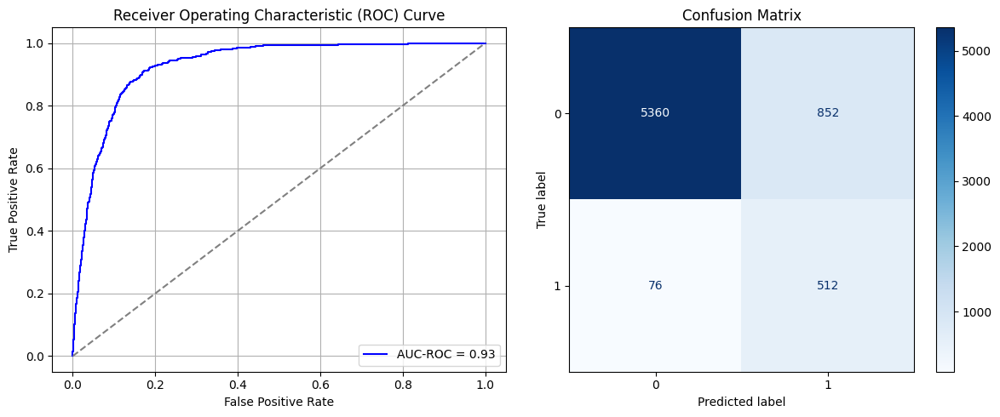

Best threshold based on F1-score: 0.7807510495185852
False Negative Rate: 0.1292517006802721
Time elapsed (performance): 1.0757347870003287
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.7943 - loss: 0.5483 - val_AUC: 0.8842 - val_loss: 0.4345
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8835 - loss: 0.4309 - val_AUC: 0.8939 - val_loss: 0.4220
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8913 - loss: 0.4152 - val_AUC: 0.9023 - val_loss: 0.3968
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8999 - loss: 0.3980 - val_AUC: 0.9069 - val_loss: 0.3857
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9038 - loss: 0.3887 - val_AUC: 0.9111 - val_loss: 0.3737
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9057 - loss: 0.3842 - val_AUC: 0.9134 - val_loss: 0.3702
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9088 - loss: 0.3763 - val_AUC: 0.9146 - val_loss: 0.3641
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9127 - loss: 0.3682 - val_AUC: 0.9179 - val_loss: 0.3566
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.926055177383252
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.86      0.92      6212
           1       0.37      0.87      0.52       588

    accuracy                           0.86      6800
   macro avg       0.68      0.87      0.72      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.14021249195106247 TPR: 0.8741496598639455 FNR: 0.12585034013605442 TNR: 0.8597875080489376


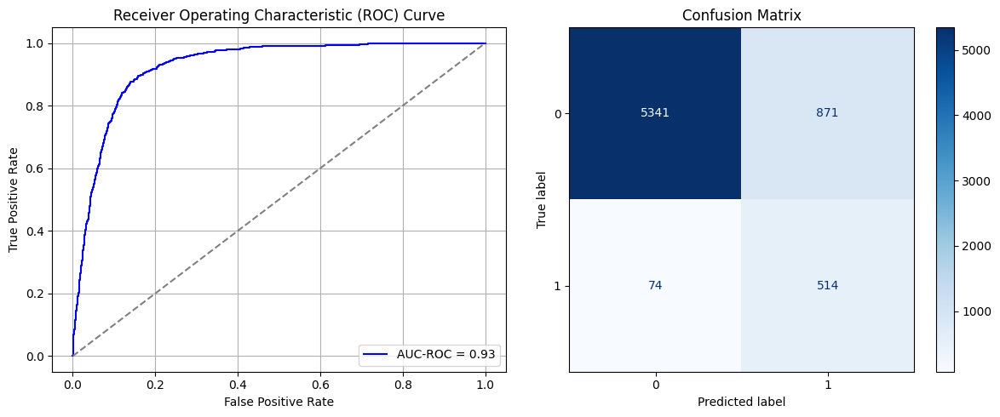

Best threshold based on F1-score: 0.9849991798400879
False Negative Rate: 0.12585034013605442
Time elapsed (performance): 1.1041336660000525
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.7879 - loss: 0.5559 - val_AUC: 0.8884 - val_loss: 0.4253
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8870 - loss: 0.4242 - val_AUC: 0.8958 - val_loss: 0.4067
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8950 - loss: 0.4074 - val_AUC: 0.9013 - val_loss: 0.3939
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9003 - loss: 0.3959 - val_AUC: 0.9064 - val_loss: 0.3837
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9039 - loss: 0.3879 - val_AUC: 0.9097 - val_loss: 0.3751
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9086 - loss: 0.3792 - val_AUC: 0.9129 - val_loss: 0.3682
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9120 - loss: 0.3718 - val_AUC: 0.9150 - val_loss: 0.3648
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9141 - loss: 0.3656 - val_AUC: 0.9159 - val_loss: 0.3617
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4m

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9274382805279228
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.84      0.91      6212
           1       0.35      0.89      0.50       588

    accuracy                           0.85      6800
   macro avg       0.67      0.87      0.70      6800
weighted avg       0.93      0.85      0.87      6800

FPR 0.1574372182871861 TPR: 0.8877551020408163 FNR: 0.11224489795918367 TNR: 0.8425627817128138


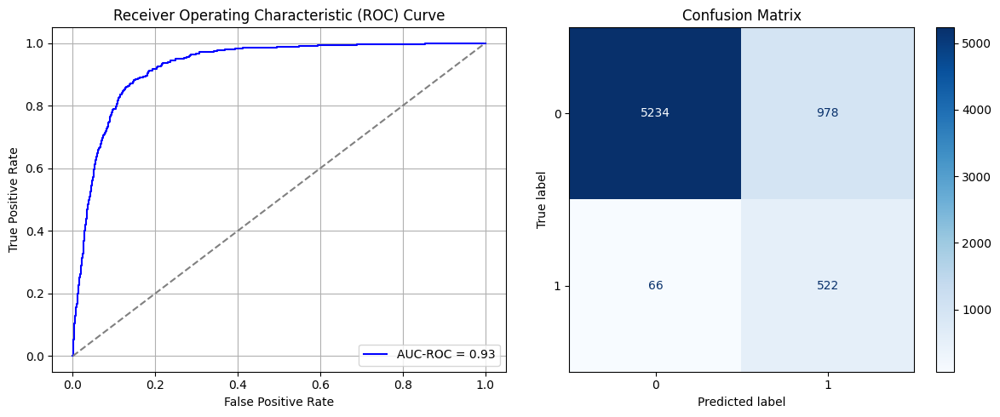

Best threshold based on F1-score: 0.9807065725326538
False Negative Rate: 0.11224489795918367
Time elapsed (performance): 0.9653205530012201
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7819 - loss: 0.5553 - val_AUC: 0.8836 - val_loss: 0.4471
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8834 - loss: 0.4308 - val_AUC: 0.8912 - val_loss: 0.4294
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8906 - loss: 0.4160 - val_AUC: 0.8976 - val_loss: 0.4078
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8964 - loss: 0.4041 - val_AUC: 0.9040 - val_loss: 0.3892
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9048 - loss: 0.3878 - val_AUC: 0.9069 - val_loss: 0.3844
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9060 - loss: 0.3847 - val_AUC: 0.9118 - val_loss: 0.3706
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9093 - loss: 0.3763 - val_AUC: 0.9134 - val_loss: 0.3752
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9121 - loss: 0.3707 - val_AUC: 0.9161 - val_loss: 0.3602
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4m

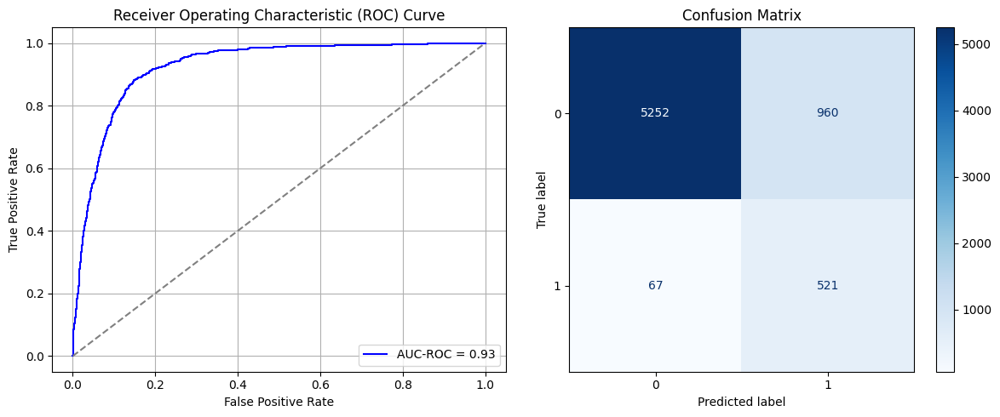

Best threshold based on F1-score: 0.7269484400749207
False Negative Rate: 0.11394557823129252
Time elapsed (performance): 1.0790145050013962
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7925 - loss: 0.5494 - val_AUC: 0.8836 - val_loss: 0.4325
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8844 - loss: 0.4274 - val_AUC: 0.8905 - val_loss: 0.4177
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8856 - loss: 0.4233 - val_AUC: 0.8954 - val_loss: 0.4161
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8960 - loss: 0.4024 - val_AUC: 0.9000 - val_loss: 0.4005
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9016 - loss: 0.3920 - val_AUC: 0.9048 - val_loss: 0.3931
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9044 - loss: 0.3856 - val_AUC: 0.9066 - val_loss: 0.3976
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9121 - loss: 0.3695 - val_AUC: 0.9116 - val_loss: 0.3711
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9118 - loss: 0.3696 - val_AUC: 0.9137 - val_loss: 0.3658
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4

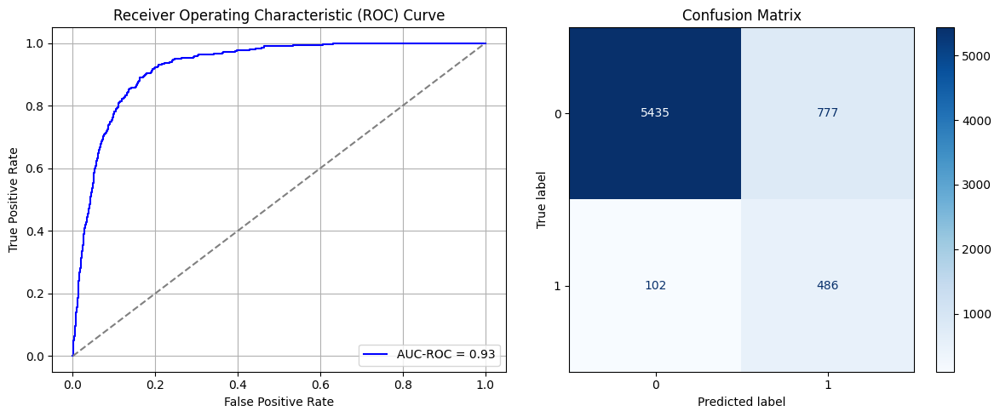

Best threshold based on F1-score: 0.6716269850730896
False Negative Rate: 0.17346938775510204
Time elapsed (performance): 1.1256765849993826
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7950 - loss: 0.5448 - val_AUC: 0.8891 - val_loss: 0.4330
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8904 - loss: 0.4169 - val_AUC: 0.8924 - val_loss: 0.4183
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8922 - loss: 0.4108 - val_AUC: 0.8987 - val_loss: 0.4061
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8965 - loss: 0.4026 - val_AUC: 0.8999 - val_loss: 0.3970
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8961 - loss: 0.4021 - val_AUC: 0.9031 - val_loss: 0.3886
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9021 - loss: 0.3896 - val_AUC: 0.9060 - val_loss: 0.3827
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - AUC: 0.9065 - loss: 0.3821 - val_AUC: 0.9090 - val_loss: 0.3810
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9095 - loss: 0.3750 - val_AUC: 0.9119 - val_loss: 0.3706
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9270714241910543
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.81      0.89      6212
           1       0.31      0.92      0.47       588

    accuracy                           0.82      6800
   macro avg       0.65      0.87      0.68      6800
weighted avg       0.93      0.82      0.85      6800

FPR 0.1910817772054089 TPR: 0.9217687074829932 FNR: 0.0782312925170068 TNR: 0.8089182227945911


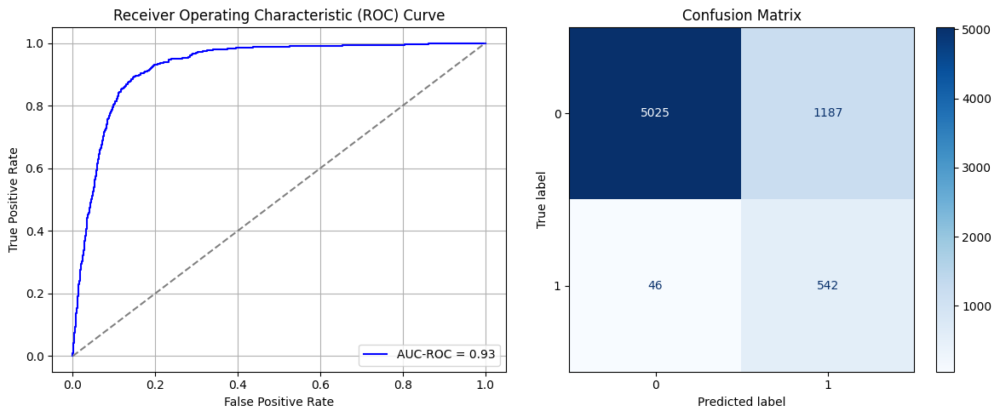

Best threshold based on F1-score: 0.7684733271598816
False Negative Rate: 0.0782312925170068
Time elapsed (performance): 1.0599518039998657


In [84]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    data_S_min_ros = data_S_minority.sample(n=oversample_size - undersample_size, replace=True)
    data_S_SRS_ROS = pd.concat([data_S_majority, data_S_min_ros, data_S_minority])
    X_S_SRS_ROS = data_S_SRS_ROS.iloc[:, :-1]
    y_S_SRS_ROS = data_S_SRS_ROS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_SRS_ROS, y_S_SRS_ROS, test_size=0.20, random_state=0)
    model_SRS_ROS = create_dnn_model(X_S_train.shape[1])
    result_SRS_ROS = train_and_evaluate(model_SRS_ROS, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_SRS_ROS = Transductive_TL(model_SRS_ROS, X_T_full, y_T_full, "Target")

    Training_time.append(result_SRS_ROS)
    FPR.append(result_TL_SRS_ROS[0])
    TNR.append(result_TL_SRS_ROS[1])
    FNR.append(result_TL_SRS_ROS[2])
    TPR.append(result_TL_SRS_ROS[3])
    TL_time.append(result_TL_SRS_ROS[4])

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
# print(ParamFit)

In [88]:
print(ParamFit)
ParamFit.to_csv('SRS_ROS2.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0     56.339338  0.172891  0.827109  0.108844  0.891156     0.781687
1     46.437938  0.190438  0.809562  0.078231  0.921769     1.246025
2     50.372116  0.156471  0.843529  0.108844  0.891156     1.015440
3     46.963292  0.096909  0.903091  0.215986  0.784014     0.766786
4     49.382707  0.159530  0.840470  0.108844  0.891156     0.773338
5     50.357468  0.167257  0.832743  0.091837  0.908163     0.781016
6     50.158974  0.165808  0.834192  0.103741  0.896259     0.786568
7     45.848906  0.154540  0.845460  0.107143  0.892857     1.193148
8     52.797789  0.145364  0.854636  0.113946  0.886054     1.052342
9     46.994923  0.197843  0.802157  0.088435  0.911565     0.952626
10    51.447829  0.137798  0.862202  0.134354  0.865646     1.211007
11    49.951592  0.142305  0.857695  0.125850  0.874150     1.259960
12    75.400701  0.196877  0.803123  0.095238  0.904762     1.096479
13    68.806575  0.193979  0.80602

In [89]:
ParamFit['FNR'].mean()

np.float64(0.11619047619047619)

In [90]:
ParamFit['Source time'].mean()

np.float64(64.41093578899992)

## Systematic Resampling:

In this case, we examine the possibility of performing Random Oversampling on the minority class using systematic sampling. For this purpose, taking a sampling interval of $k$, we would compile a total of $k*\frac{N_0-N_1}{N_1}$ systematic samples from the minority class in order to balance the dataset. We sample the starting point from 1 to $k$ *with replacement*, since a highly imbalanced dataset will require sampling with replacement in order to achieve a balanced dataset.

In particular, taking $k=10$ yields a number of samples of $k*\frac{N_0-N_1}{N_1}= 11.05 \approx 11$, so we take $k=10$.

In [91]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

4433
31960


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - AUC: 0.7804 - loss: 0.5542 - val_AUC: 0.8872 - val_loss: 0.4269
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8787 - loss: 0.4390 - val_AUC: 0.8949 - val_loss: 0.4153
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8888 - loss: 0.4183 - val_AUC: 0.9001 - val_loss: 0.4042
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8972 - loss: 0.4027 - val_AUC: 0.9052 - val_loss: 0.3904
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9011 - loss: 0.3939 - val_AUC: 0.9086 - val_loss: 0.3765
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.9067 - loss: 0.3820 - val_AUC: 0.9119 - val_loss: 0.3692
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9107 - loss: 0.3740 - val_AUC: 0.9135 - val_loss: 0.3697
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9113 - loss: 0.3716 - val_AUC: 0.9182 - val_loss: 0.3574
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━

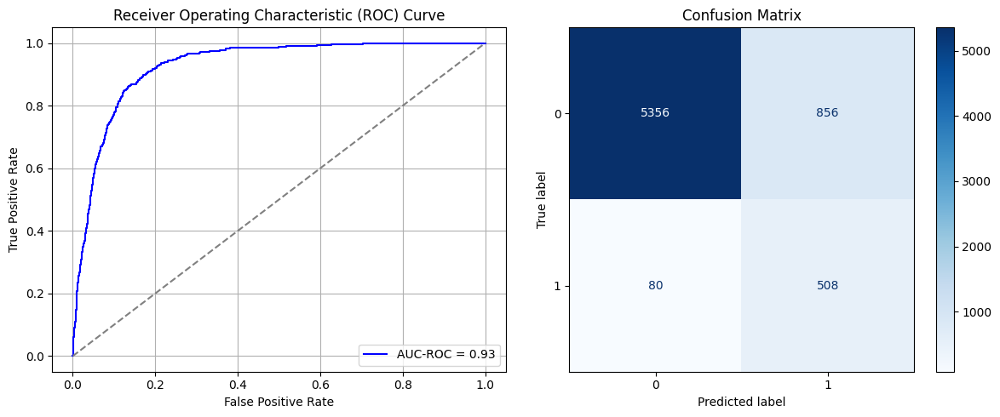

Best threshold based on F1-score: 0.7337432503700256
False Negative Rate: 0.1360544217687075
Time elapsed (performance): 0.7739005419989553
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7908 - loss: 0.5523 - val_AUC: 0.8856 - val_loss: 0.4277
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8834 - loss: 0.4297 - val_AUC: 0.8951 - val_loss: 0.4078
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8925 - loss: 0.4121 - val_AUC: 0.8986 - val_loss: 0.4120
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8953 - loss: 0.4052 - val_AUC: 0.9013 - val_loss: 0.3910
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8972 - loss: 0.3993 - val_AUC: 0.9057 - val_loss: 0.3836
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9038 - loss: 0.3862 - val_AUC: 0.9090 - val_loss: 0.3752
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9075 - loss: 0.3799 - val_AUC: 0.9113 - val_loss: 0.3694
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9082 - loss: 0.3764 - val_AUC: 0.9128 - val_loss: 0.3709
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/st

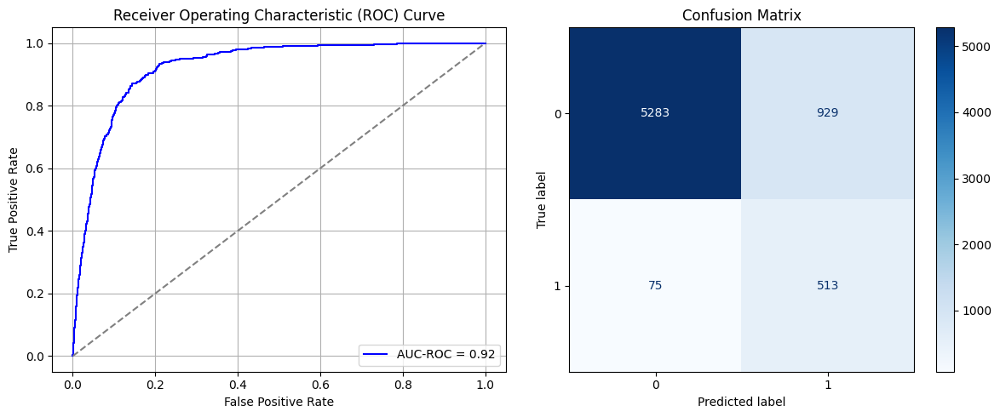

Best threshold based on F1-score: 0.7271180152893066
False Negative Rate: 0.12755102040816327
Time elapsed (performance): 0.7800159660000645
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7888 - loss: 0.5504 - val_AUC: 0.8882 - val_loss: 0.4282
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8857 - loss: 0.4292 - val_AUC: 0.8955 - val_loss: 0.4099
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8960 - loss: 0.4064 - val_AUC: 0.9024 - val_loss: 0.3924
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9017 - loss: 0.3931 - val_AUC: 0.9068 - val_loss: 0.3826
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9063 - loss: 0.3831 - val_AUC: 0.9106 - val_loss: 0.3734
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9076 - loss: 0.3797 - val_AUC: 0.9118 - val_loss: 0.3706
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9098 - loss: 0.3732 - val_AUC: 0.9139 - val_loss: 0.3787
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9142 - loss: 0.3647 - val_AUC: 0.9164 - val_loss: 0.3792
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/st

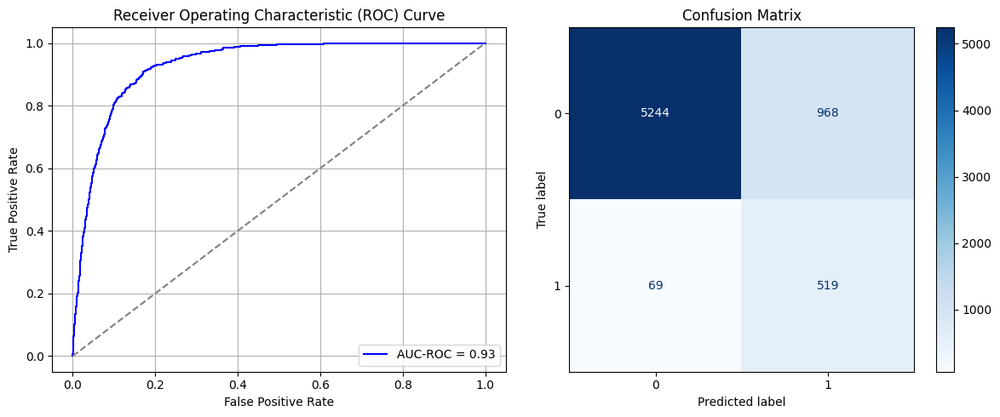

Best threshold based on F1-score: 0.7568551898002625
False Negative Rate: 0.11734693877551021
Time elapsed (performance): 0.7834156389999407
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7998 - loss: 0.5447 - val_AUC: 0.8903 - val_loss: 0.4261
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8840 - loss: 0.4290 - val_AUC: 0.8980 - val_loss: 0.4056
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8944 - loss: 0.4078 - val_AUC: 0.9032 - val_loss: 0.3940
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8992 - loss: 0.3979 - val_AUC: 0.9069 - val_loss: 0.3849
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9037 - loss: 0.3875 - val_AUC: 0.9117 - val_loss: 0.3775
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9056 - loss: 0.3831 - val_AUC: 0.9136 - val_loss: 0.3704
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9112 - loss: 0.3729 - val_AUC: 0.9164 - val_loss: 0.3618
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9128 - loss: 0.3687 - val_AUC: 0.9169 - val_loss: 0.3669
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.925956618964392
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.82      0.90      6212
           1       0.32      0.90      0.47       588

    accuracy                           0.83      6800
   macro avg       0.65      0.86      0.68      6800
weighted avg       0.93      0.83      0.86      6800

FPR 0.18142305215711527 TPR: 0.9013605442176871 FNR: 0.09863945578231292 TNR: 0.8185769478428847


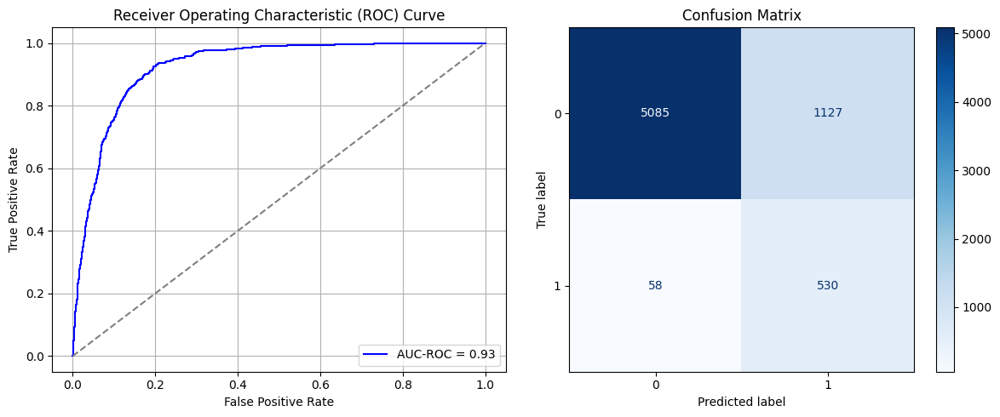

<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Best threshold based on F1-score: 0.9893075227737427
False Negative Rate: 0.09863945578231292
Time elapsed (performance): 1.187272152999867
Epoch 1/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7858 - loss: 0.5533 - val_AUC: 0.8881 - val_loss: 0.4269
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8864 - loss: 0.4264 - val_AUC: 0.8949 - val_loss: 0.4087
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8946 - loss: 0.4091 - val_AUC: 0.8998 - val_loss: 0.3983
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8972 - loss: 0.4022 - val_AUC: 0.9039 - val_loss: 0.3897
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9025 - loss: 0.3921 - val_AUC: 0.9068 - val_loss: 0.3807
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9077 - loss: 0.3810 - val_AUC: 0.9108 - val_loss: 0.3729
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9097 - loss: 0.3756 - val_AUC: 0.9138 - val_loss: 0.3830
Epoch 8/10
1278/1278

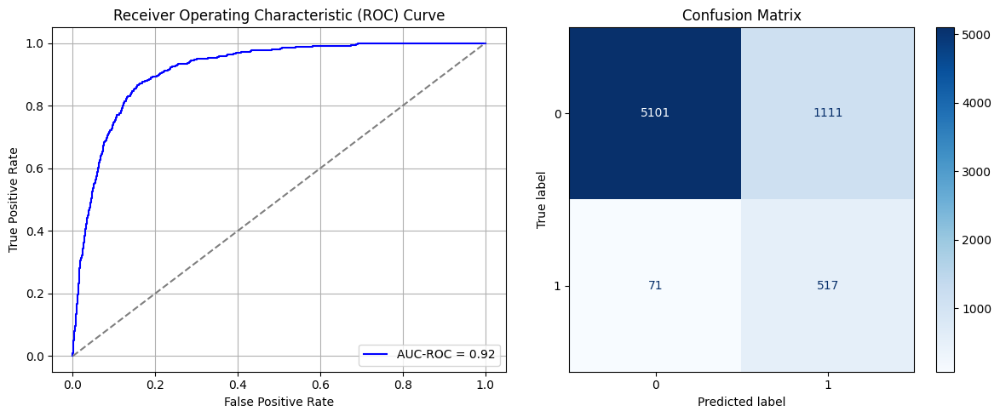

Best threshold based on F1-score: 0.786580502986908
False Negative Rate: 0.12074829931972789
Time elapsed (performance): 1.0395962839993445
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7949 - loss: 0.5460 - val_AUC: 0.8895 - val_loss: 0.4302
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8864 - loss: 0.4253 - val_AUC: 0.8965 - val_loss: 0.4061
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8916 - loss: 0.4134 - val_AUC: 0.9001 - val_loss: 0.3965
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8961 - loss: 0.4038 - val_AUC: 0.9021 - val_loss: 0.3974
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8998 - loss: 0.3959 - val_AUC: 0.9045 - val_loss: 0.4283
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9012 - loss: 0.3929 - val_AUC: 0.9073 - val_loss: 0.3789
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9040 - loss: 0.3876 - val_AUC: 0.9109 - val_loss: 0.3716
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9085 - loss: 0.3782 - val_AUC: 0.9117 - val_loss: 0.3734
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9272477342514598
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.83      0.90      6212
           1       0.33      0.90      0.48       588

    accuracy                           0.83      6800
   macro avg       0.66      0.86      0.69      6800
weighted avg       0.93      0.83      0.87      6800

FPR 0.17192530585962654 TPR: 0.8979591836734694 FNR: 0.10204081632653061 TNR: 0.8280746941403735


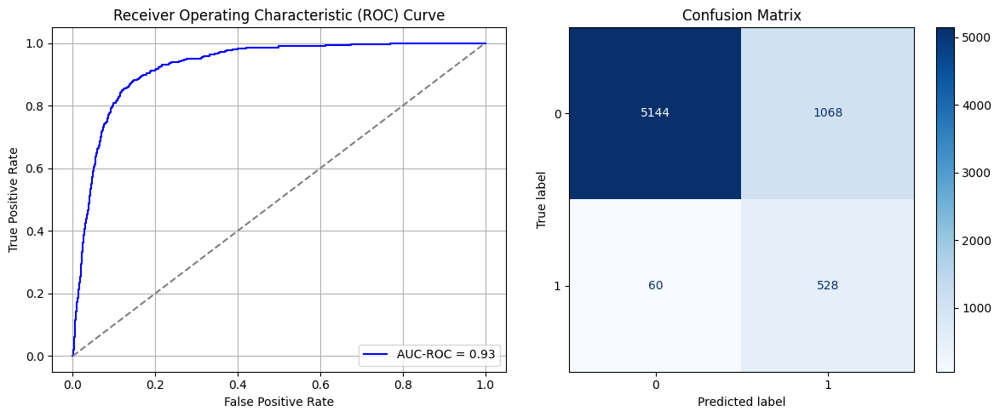

Best threshold based on F1-score: 0.7689446210861206
False Negative Rate: 0.10204081632653061
Time elapsed (performance): 0.7918286329986586
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7794 - loss: 0.5597 - val_AUC: 0.8880 - val_loss: 0.4264
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8836 - loss: 0.4302 - val_AUC: 0.8942 - val_loss: 0.4090
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8904 - loss: 0.4162 - val_AUC: 0.8987 - val_loss: 0.4246
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8956 - loss: 0.4047 - val_AUC: 0.9039 - val_loss: 0.3878
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9018 - loss: 0.3925 - val_AUC: 0.9077 - val_loss: 0.3784
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9086 - loss: 0.3787 - val_AUC: 0.9115 - val_loss: 0.3707
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9103 - loss: 0.3730 - val_AUC: 0.9160 - val_loss: 0.3807
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9125 - loss: 0.3692 - val_AUC: 0.9174 - val_loss: 0.3576
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/st

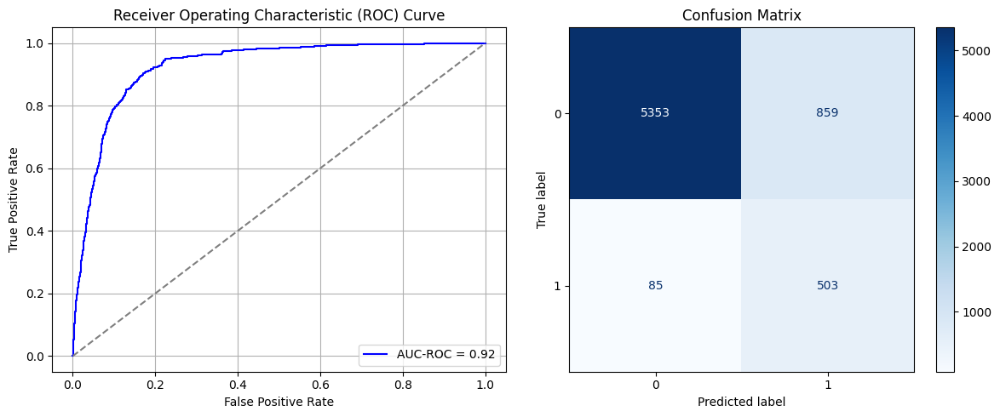

Best threshold based on F1-score: 0.9920536875724792
False Negative Rate: 0.1445578231292517
Time elapsed (performance): 1.0393285579993972
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7829 - loss: 0.5534 - val_AUC: 0.8866 - val_loss: 0.4265
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8834 - loss: 0.4298 - val_AUC: 0.8950 - val_loss: 0.4079
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8921 - loss: 0.4122 - val_AUC: 0.8990 - val_loss: 0.4001
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.8965 - loss: 0.4022 - val_AUC: 0.9032 - val_loss: 0.3890
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9017 - loss: 0.3914 - val_AUC: 0.9075 - val_loss: 0.3832
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9071 - loss: 0.3803 - val_AUC: 0.9117 - val_loss: 0.3692
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9127 - loss: 0.3682 - val_AUC: 0.9132 - val_loss: 0.3673
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9128 - loss: 0.3680 - val_AUC: 0.9152 - val_loss: 0.3606
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

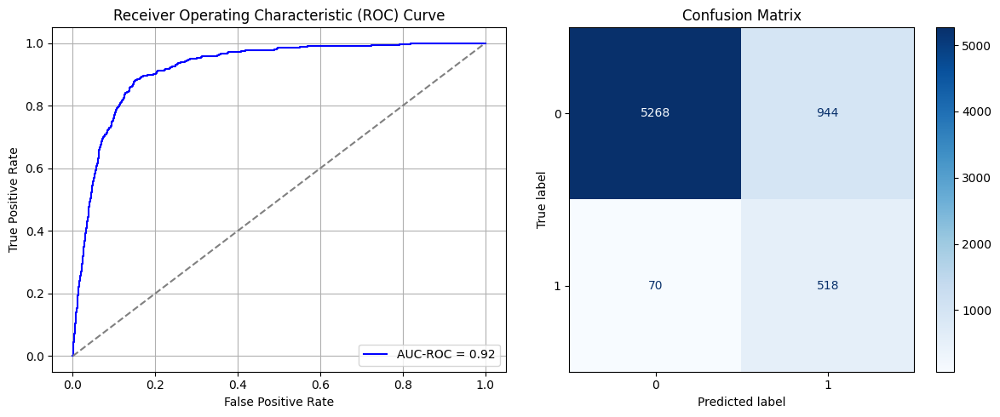

Best threshold based on F1-score: 0.9912158846855164
False Negative Rate: 0.11904761904761904
Time elapsed (performance): 0.7936034279991873
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7992 - loss: 0.5444 - val_AUC: 0.8889 - val_loss: 0.4348
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8852 - loss: 0.4266 - val_AUC: 0.8962 - val_loss: 0.4037
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8916 - loss: 0.4115 - val_AUC: 0.9027 - val_loss: 0.3914
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9007 - loss: 0.3950 - val_AUC: 0.9064 - val_loss: 0.3848
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9069 - loss: 0.3819 - val_AUC: 0.9090 - val_loss: 0.3765
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9083 - loss: 0.3774 - val_AUC: 0.9159 - val_loss: 0.3605
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9146 - loss: 0.3646 - val_AUC: 0.9174 - val_loss: 0.3680
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9169 - loss: 0.3584 - val_AUC: 0.9207 - val_loss: 0.3540
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

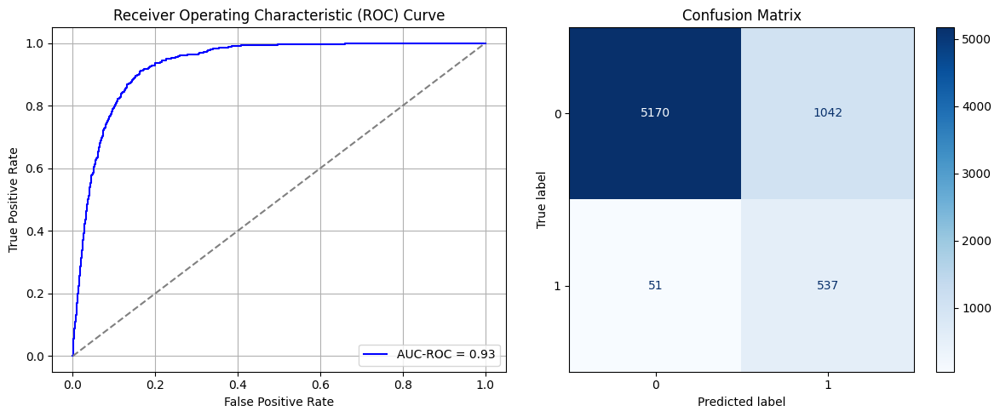

<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Best threshold based on F1-score: 0.9901326894760132
False Negative Rate: 0.08673469387755102
Time elapsed (performance): 1.2157025399992563
Epoch 1/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7826 - loss: 0.5594 - val_AUC: 0.8864 - val_loss: 0.4294
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8817 - loss: 0.4342 - val_AUC: 0.8937 - val_loss: 0.4123
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8906 - loss: 0.4152 - val_AUC: 0.8992 - val_loss: 0.3986
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8963 - loss: 0.4032 - val_AUC: 0.9058 - val_loss: 0.3879
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9003 - loss: 0.3950 - val_AUC: 0.9095 - val_loss: 0.3760
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9045 - loss: 0.3866 - val_AUC: 0.9110 - val_loss: 0.3732
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9051 - loss: 0.3844 - val_AUC: 0.9148 - val_loss: 0.3636
Epoch 8/10
1278/127

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9283488508088361
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.83      0.90      6212
           1       0.34      0.89      0.49       588

    accuracy                           0.84      6800
   macro avg       0.66      0.86      0.70      6800
weighted avg       0.93      0.84      0.87      6800

FPR 0.16564713457823568 TPR: 0.891156462585034 FNR: 0.10884353741496598 TNR: 0.8343528654217643


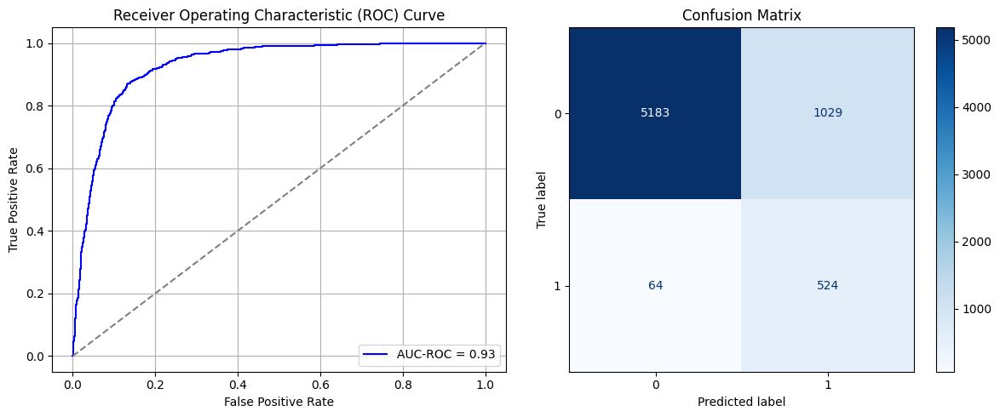

Best threshold based on F1-score: 0.9911885261535645
False Negative Rate: 0.10884353741496598
Time elapsed (performance): 9.590650160000223
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.8024 - loss: 0.5438 - val_AUC: 0.8909 - val_loss: 0.4228
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8818 - loss: 0.4335 - val_AUC: 0.8962 - val_loss: 0.4103
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8911 - loss: 0.4145 - val_AUC: 0.9003 - val_loss: 0.3975
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8946 - loss: 0.4080 - val_AUC: 0.9041 - val_loss: 0.3869
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8983 - loss: 0.3997 - val_AUC: 0.9063 - val_loss: 0.3891
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9039 - loss: 0.3890 - val_AUC: 0.9124 - val_loss: 0.3699
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9084 - loss: 0.3785 - val_AUC: 0.9125 - val_loss: 0.3703
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9115 - loss: 0.3729 - val_AUC: 0.9168 - val_loss: 0.3725
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9282743844479195
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.82      0.90      6212
           1       0.32      0.91      0.48       588

    accuracy                           0.83      6800
   macro avg       0.66      0.86      0.69      6800
weighted avg       0.93      0.83      0.86      6800

FPR 0.180296200901481 TPR: 0.9064625850340136 FNR: 0.0935374149659864 TNR: 0.819703799098519


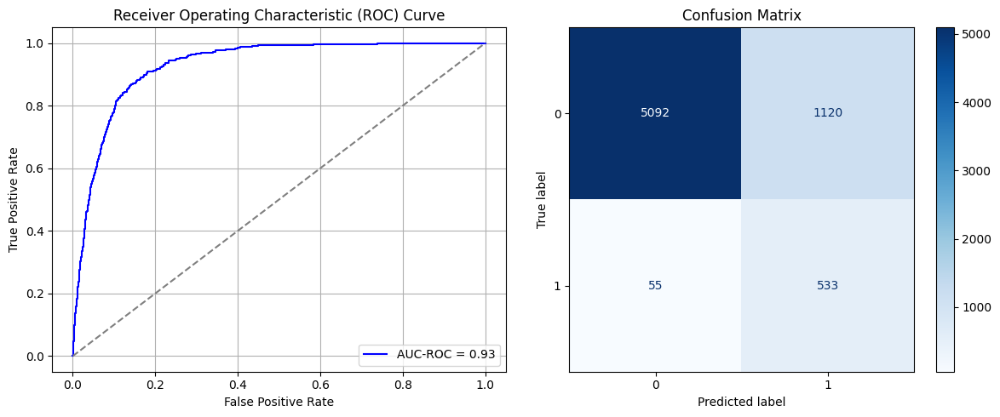

Best threshold based on F1-score: 0.7293378114700317
False Negative Rate: 0.0935374149659864
Time elapsed (performance): 0.9019843749993015
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7853 - loss: 0.5565 - val_AUC: 0.8871 - val_loss: 0.4322
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - AUC: 0.8809 - loss: 0.4367 - val_AUC: 0.8942 - val_loss: 0.4140
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8922 - loss: 0.4136 - val_AUC: 0.9014 - val_loss: 0.4065
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9002 - loss: 0.3983 - val_AUC: 0.9061 - val_loss: 0.3846
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9044 - loss: 0.3881 - val_AUC: 0.9105 - val_loss: 0.3741
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9060 - loss: 0.3831 - val_AUC: 0.9129 - val_loss: 0.3722
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9079 - loss: 0.3788 - val_AUC: 0.9133 - val_loss: 0.3679
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9131 - loss: 0.3670 - val_AUC: 0.9156 - val_loss: 0.3750
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/s

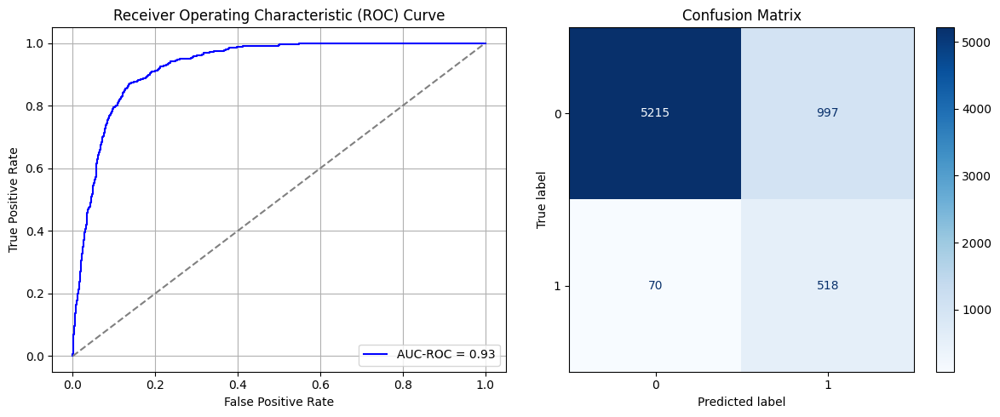

Best threshold based on F1-score: 0.7243005633354187
False Negative Rate: 0.11904761904761904
Time elapsed (performance): 1.0820528679996642
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7946 - loss: 0.5481 - val_AUC: 0.8897 - val_loss: 0.4252
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8836 - loss: 0.4295 - val_AUC: 0.8971 - val_loss: 0.4057
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8932 - loss: 0.4109 - val_AUC: 0.9039 - val_loss: 0.3933
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9025 - loss: 0.3923 - val_AUC: 0.9083 - val_loss: 0.3816
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9067 - loss: 0.3829 - val_AUC: 0.9119 - val_loss: 0.3707
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9097 - loss: 0.3769 - val_AUC: 0.9147 - val_loss: 0.3684
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9141 - loss: 0.3666 - val_AUC: 0.9171 - val_loss: 0.3603
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9158 - loss: 0.3633 - val_AUC: 0.9173 - val_loss: 0.3578
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

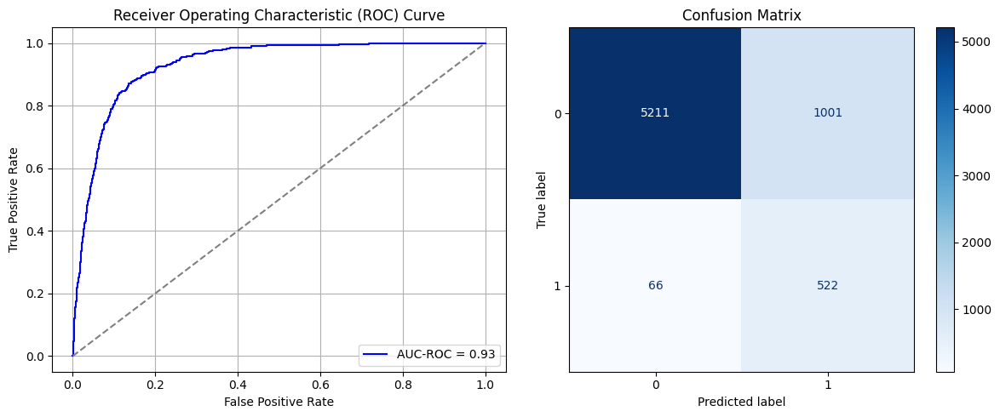

Best threshold based on F1-score: 0.9896668195724487
False Negative Rate: 0.11224489795918367
Time elapsed (performance): 1.0780854189997626
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7749 - loss: 0.5606 - val_AUC: 0.8881 - val_loss: 0.4295
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8830 - loss: 0.4348 - val_AUC: 0.8950 - val_loss: 0.4130
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8921 - loss: 0.4142 - val_AUC: 0.8992 - val_loss: 0.3993
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8953 - loss: 0.4068 - val_AUC: 0.9051 - val_loss: 0.4038
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9038 - loss: 0.3892 - val_AUC: 0.9084 - val_loss: 0.3795
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9068 - loss: 0.3821 - val_AUC: 0.9105 - val_loss: 0.3976
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9108 - loss: 0.3740 - val_AUC: 0.9142 - val_loss: 0.3681
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9133 - loss: 0.3682 - val_AUC: 0.9163 - val_loss: 0.3643
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

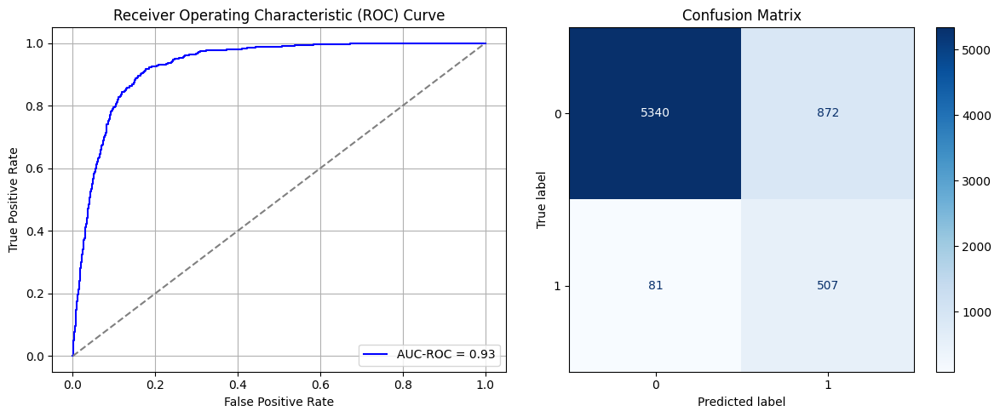

Best threshold based on F1-score: 0.9926697611808777
False Negative Rate: 0.1377551020408163
Time elapsed (performance): 1.071934333000172
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7858 - loss: 0.5562 - val_AUC: 0.8869 - val_loss: 0.4259
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8857 - loss: 0.4264 - val_AUC: 0.8933 - val_loss: 0.4105
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8910 - loss: 0.4147 - val_AUC: 0.8971 - val_loss: 0.4064
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8954 - loss: 0.4050 - val_AUC: 0.9008 - val_loss: 0.3952
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9020 - loss: 0.3919 - val_AUC: 0.9044 - val_loss: 0.3942
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9021 - loss: 0.3915 - val_AUC: 0.9076 - val_loss: 0.3857
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9072 - loss: 0.3817 - val_AUC: 0.9090 - val_loss: 0.3777
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9090 - loss: 0.3771 - val_AUC: 0.9123 - val_loss: 0.3716
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

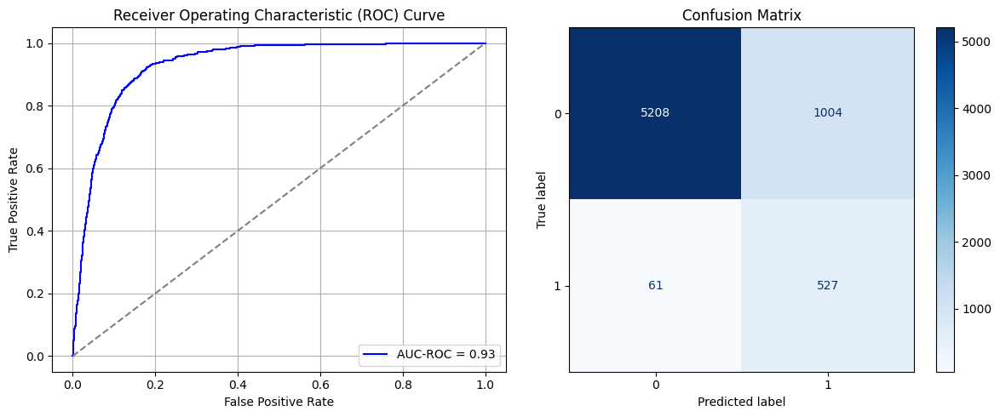

Best threshold based on F1-score: 0.7878033518791199
False Negative Rate: 0.10374149659863946
Time elapsed (performance): 1.0610508789995947
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7896 - loss: 0.5492 - val_AUC: 0.8865 - val_loss: 0.4284
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8830 - loss: 0.4306 - val_AUC: 0.8920 - val_loss: 0.4146
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8885 - loss: 0.4185 - val_AUC: 0.8962 - val_loss: 0.4079
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8938 - loss: 0.4084 - val_AUC: 0.8986 - val_loss: 0.4000
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8980 - loss: 0.4003 - val_AUC: 0.9031 - val_loss: 0.3912
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9032 - loss: 0.3901 - val_AUC: 0.9052 - val_loss: 0.3888
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9056 - loss: 0.3847 - val_AUC: 0.9087 - val_loss: 0.3765
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9103 - loss: 0.3748 - val_AUC: 0.9114 - val_loss: 0.3766
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/st

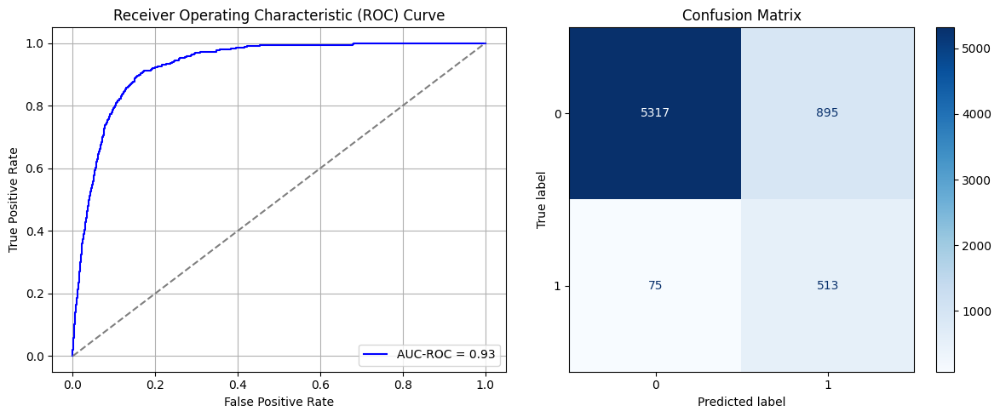

Best threshold based on F1-score: 0.7197740077972412
False Negative Rate: 0.12755102040816327
Time elapsed (performance): 0.8608756859994173
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7811 - loss: 0.5594 - val_AUC: 0.8908 - val_loss: 0.4214
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - AUC: 0.8857 - loss: 0.4278 - val_AUC: 0.8953 - val_loss: 0.4364
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8874 - loss: 0.4211 - val_AUC: 0.9020 - val_loss: 0.3957
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8966 - loss: 0.4039 - val_AUC: 0.9071 - val_loss: 0.3811
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9025 - loss: 0.3917 - val_AUC: 0.9096 - val_loss: 0.3757
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9070 - loss: 0.3804 - val_AUC: 0.9140 - val_loss: 0.3662
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9114 - loss: 0.3725 - val_AUC: 0.9151 - val_loss: 0.3703
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.9142 - loss: 0.3651 - val_AUC: 0.9176 - val_loss: 0.3660
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

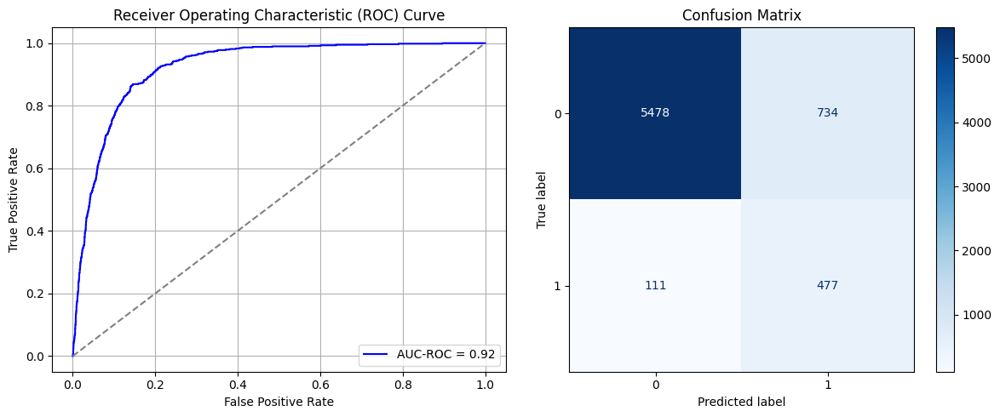

Best threshold based on F1-score: 0.6493707299232483
False Negative Rate: 0.18877551020408162
Time elapsed (performance): 1.0669958380003663
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7814 - loss: 0.5566 - val_AUC: 0.8850 - val_loss: 0.4291
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8838 - loss: 0.4298 - val_AUC: 0.8906 - val_loss: 0.4175
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8847 - loss: 0.4259 - val_AUC: 0.8956 - val_loss: 0.4067
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8949 - loss: 0.4074 - val_AUC: 0.9011 - val_loss: 0.3934
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9003 - loss: 0.3967 - val_AUC: 0.9004 - val_loss: 0.4004
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9074 - loss: 0.3831 - val_AUC: 0.9102 - val_loss: 0.3802
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9107 - loss: 0.3757 - val_AUC: 0.9128 - val_loss: 0.3679
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9132 - loss: 0.3689 - val_AUC: 0.9132 - val_loss: 0.3691
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

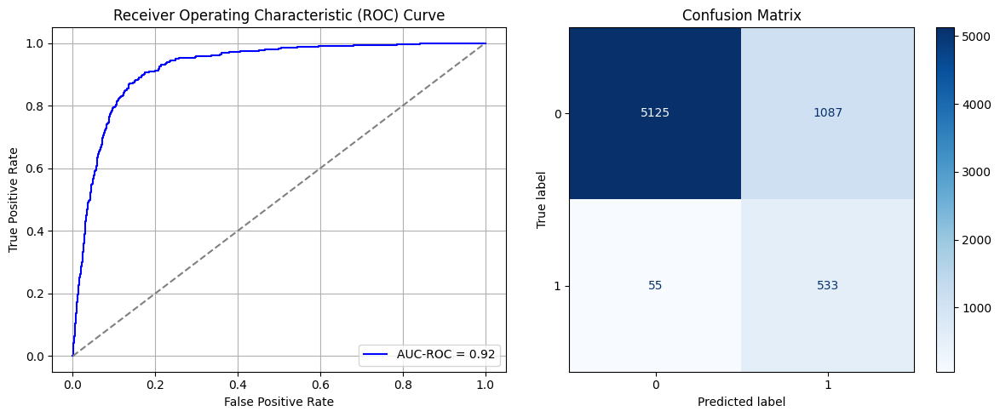

Best threshold based on F1-score: 0.7613370418548584
False Negative Rate: 0.0935374149659864
Time elapsed (performance): 1.2696112630001153
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7809 - loss: 0.5616 - val_AUC: 0.8827 - val_loss: 0.4342
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8842 - loss: 0.4287 - val_AUC: 0.8906 - val_loss: 0.4333
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8908 - loss: 0.4153 - val_AUC: 0.8946 - val_loss: 0.4265
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8949 - loss: 0.4054 - val_AUC: 0.8996 - val_loss: 0.3962
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8992 - loss: 0.3972 - val_AUC: 0.9016 - val_loss: 0.3897
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9019 - loss: 0.3901 - val_AUC: 0.9042 - val_loss: 0.3919
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9056 - loss: 0.3826 - val_AUC: 0.9082 - val_loss: 0.3771
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9071 - loss: 0.3785 - val_AUC: 0.9093 - val_loss: 0.3732
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/s

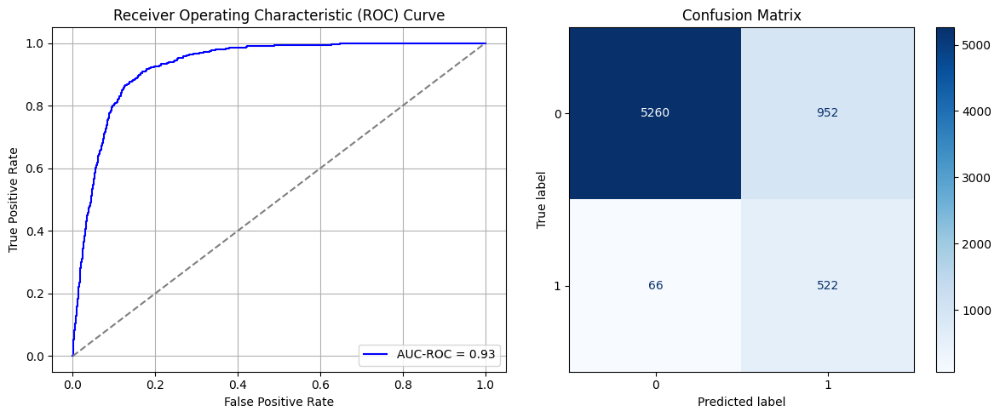

Best threshold based on F1-score: 0.6947705745697021
False Negative Rate: 0.11224489795918367
Time elapsed (performance): 1.2558849140004895
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7794 - loss: 0.5578 - val_AUC: 0.8896 - val_loss: 0.4244
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8864 - loss: 0.4244 - val_AUC: 0.8962 - val_loss: 0.4052
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8914 - loss: 0.4131 - val_AUC: 0.9004 - val_loss: 0.3963
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8938 - loss: 0.4075 - val_AUC: 0.9049 - val_loss: 0.3923
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9009 - loss: 0.3943 - val_AUC: 0.9079 - val_loss: 0.3834
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9060 - loss: 0.3832 - val_AUC: 0.9119 - val_loss: 0.3754
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.9090 - loss: 0.3760 - val_AUC: 0.9137 - val_loss: 0.3699
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9135 - loss: 0.3666 - val_AUC: 0.9147 - val_loss: 0.3643
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

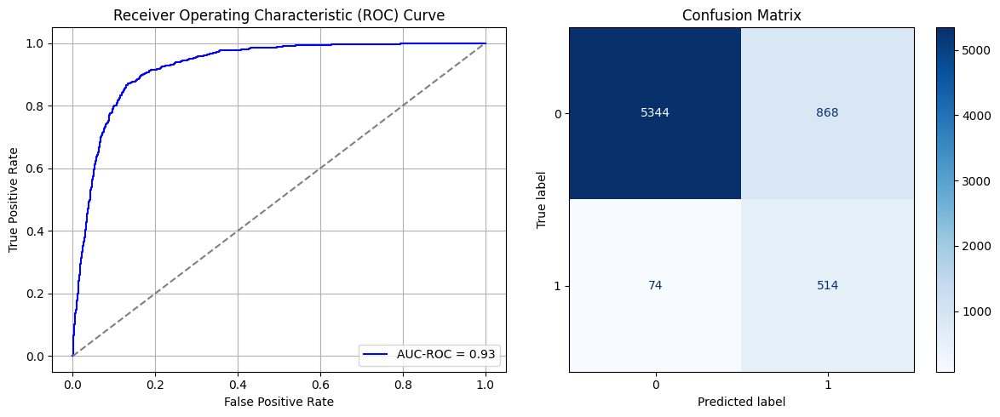

Best threshold based on F1-score: 0.9805068969726562
False Negative Rate: 0.12585034013605442
Time elapsed (performance): 0.8608352449991798
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7746 - loss: 0.5645 - val_AUC: 0.8870 - val_loss: 0.4288
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8825 - loss: 0.4343 - val_AUC: 0.8973 - val_loss: 0.4051
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8922 - loss: 0.4134 - val_AUC: 0.9035 - val_loss: 0.3908
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8975 - loss: 0.4017 - val_AUC: 0.9072 - val_loss: 0.3855
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9021 - loss: 0.3918 - val_AUC: 0.9118 - val_loss: 0.3733
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9078 - loss: 0.3799 - val_AUC: 0.9147 - val_loss: 0.3680
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - AUC: 0.9086 - loss: 0.3779 - val_AUC: 0.9169 - val_loss: 0.3603
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9138 - loss: 0.3674 - val_AUC: 0.9173 - val_loss: 0.3586
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/s

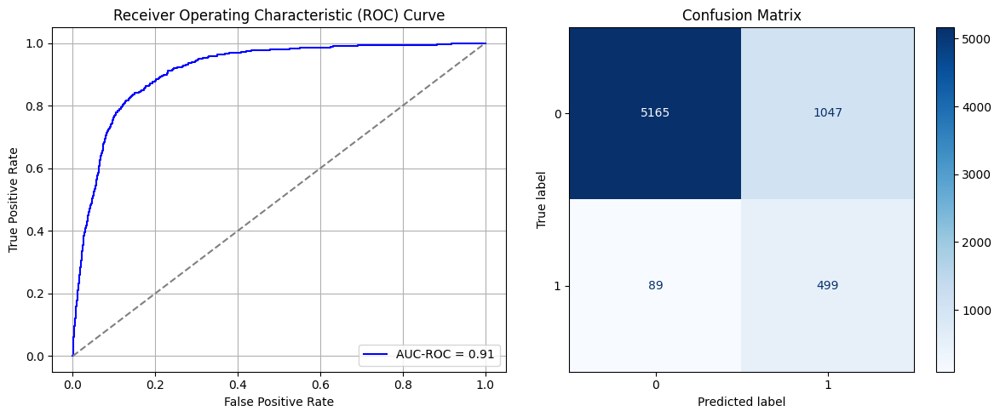

Best threshold based on F1-score: 0.9952154755592346
False Negative Rate: 0.15136054421768708
Time elapsed (performance): 0.8879927460002364
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7933 - loss: 0.5484 - val_AUC: 0.8870 - val_loss: 0.4259
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8843 - loss: 0.4274 - val_AUC: 0.8941 - val_loss: 0.4101
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8910 - loss: 0.4131 - val_AUC: 0.8972 - val_loss: 0.4132
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step - AUC: 0.8910 - loss: 0.4118 - val_AUC: 0.9012 - val_loss: 0.3972
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - AUC: 0.8969 - loss: 0.4014 - val_AUC: 0.9035 - val_loss: 0.3888
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9022 - loss: 0.3891 - val_AUC: 0.9068 - val_loss: 0.3848
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9045 - loss: 0.3851 - val_AUC: 0.9102 - val_loss: 0.3747
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.9100 - loss: 0.3741 - val_AUC: 0.9121 - val_loss: 0.3792
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/s

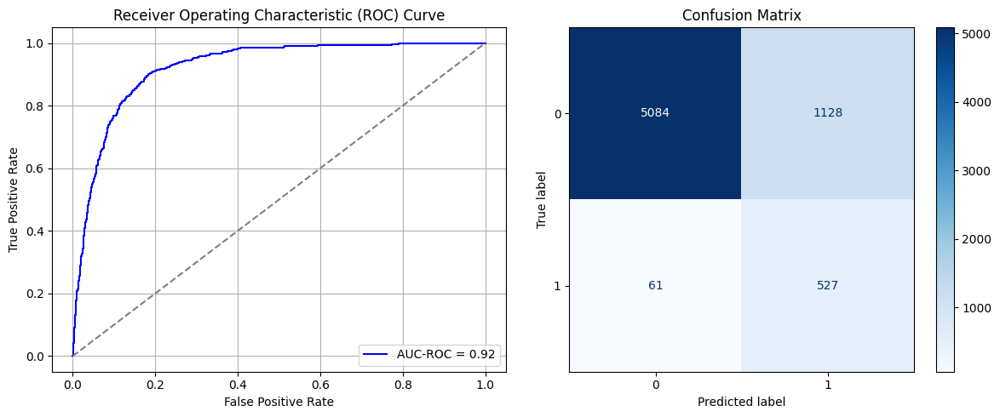

Best threshold based on F1-score: 0.9837782979011536
False Negative Rate: 0.10374149659863946
Time elapsed (performance): 1.0900573640010407
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7799 - loss: 0.5599 - val_AUC: 0.8902 - val_loss: 0.4221
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8793 - loss: 0.4377 - val_AUC: 0.8948 - val_loss: 0.4128
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8872 - loss: 0.4214 - val_AUC: 0.9009 - val_loss: 0.4000
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8958 - loss: 0.4051 - val_AUC: 0.9047 - val_loss: 0.3879
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8984 - loss: 0.3992 - val_AUC: 0.9094 - val_loss: 0.3762
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9041 - loss: 0.3892 - val_AUC: 0.9109 - val_loss: 0.3768
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.9082 - loss: 0.3802 - val_AUC: 0.9151 - val_loss: 0.3651
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9104 - loss: 0.3746 - val_AUC: 0.9181 - val_loss: 0.3595
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/st

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9287836029453636
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.80      0.89      6212
           1       0.31      0.93      0.47       588

    accuracy                           0.82      6800
   macro avg       0.65      0.87      0.68      6800
weighted avg       0.93      0.82      0.85      6800

FPR 0.19542820347714102 TPR: 0.9302721088435374 FNR: 0.06972789115646258 TNR: 0.8045717965228589


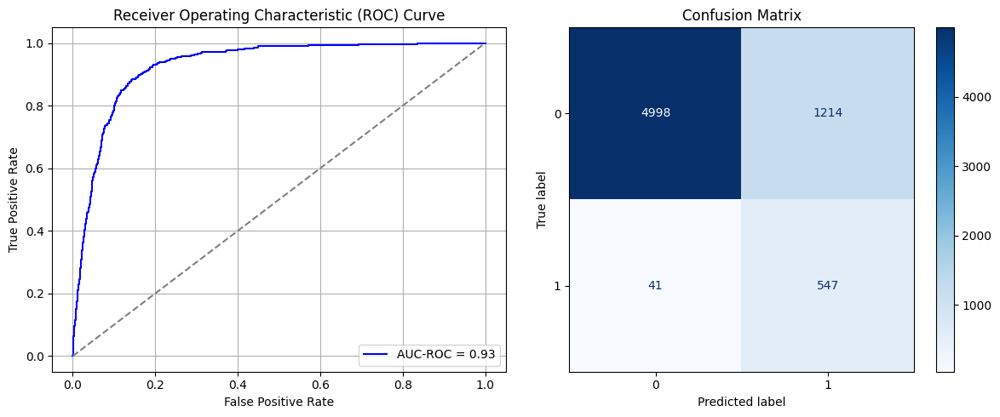

Best threshold based on F1-score: 0.9908038377761841
False Negative Rate: 0.06972789115646258
Time elapsed (performance): 1.0115491550004663
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7870 - loss: 0.5532 - val_AUC: 0.8901 - val_loss: 0.4211
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - AUC: 0.8797 - loss: 0.4366 - val_AUC: 0.8957 - val_loss: 0.4189
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8905 - loss: 0.4154 - val_AUC: 0.9011 - val_loss: 0.3987
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8942 - loss: 0.4065 - val_AUC: 0.9061 - val_loss: 0.3937
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9023 - loss: 0.3903 - val_AUC: 0.9113 - val_loss: 0.3695
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.9096 - loss: 0.3748 - val_AUC: 0.9122 - val_loss: 0.3845
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9107 - loss: 0.3729 - val_AUC: 0.9166 - val_loss: 0.3596
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9122 - loss: 0.3680 - val_AUC: 0.9159 - val_loss: 0.3615
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

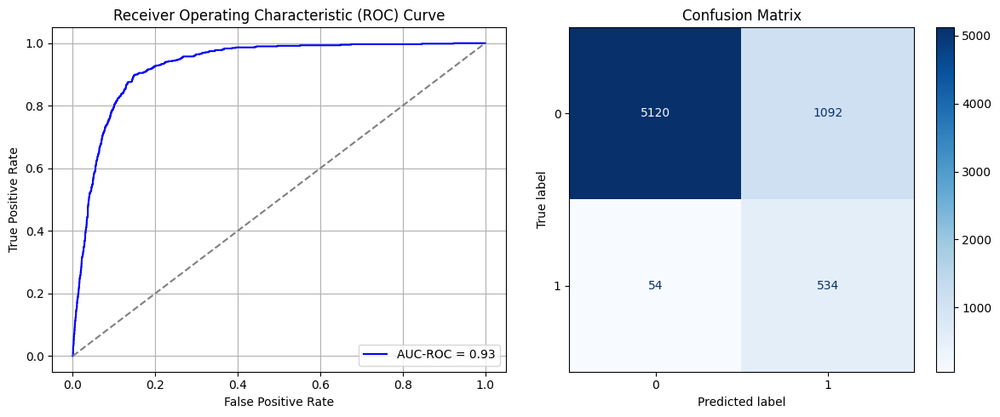

Best threshold based on F1-score: 0.9821730256080627
False Negative Rate: 0.09183673469387756
Time elapsed (performance): 1.0847286810003425
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7829 - loss: 0.5580 - val_AUC: 0.8860 - val_loss: 0.4357
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8883 - loss: 0.4230 - val_AUC: 0.8940 - val_loss: 0.4111
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8944 - loss: 0.4093 - val_AUC: 0.9001 - val_loss: 0.4009
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9001 - loss: 0.3964 - val_AUC: 0.9060 - val_loss: 0.3878
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9065 - loss: 0.3823 - val_AUC: 0.9095 - val_loss: 0.3810
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9121 - loss: 0.3709 - val_AUC: 0.9127 - val_loss: 0.3678
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9112 - loss: 0.3718 - val_AUC: 0.9136 - val_loss: 0.3830
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9120 - loss: 0.3694 - val_AUC: 0.9150 - val_loss: 0.3778
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

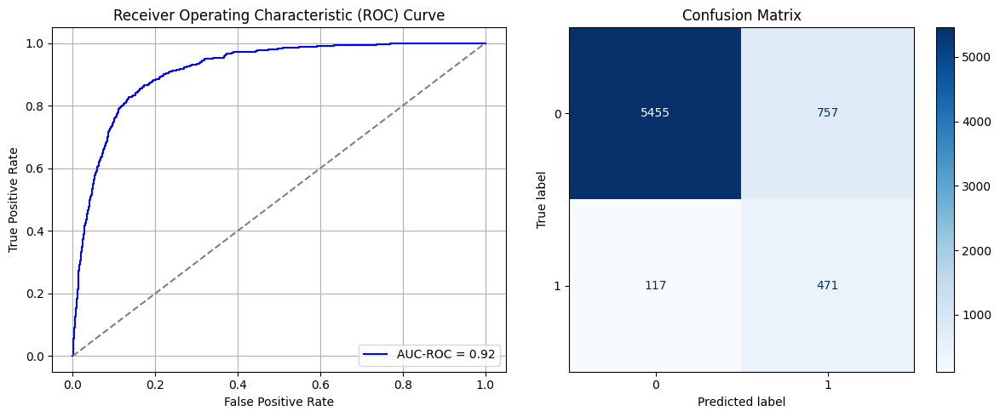

<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Best threshold based on F1-score: 0.9889235496520996
False Negative Rate: 0.1989795918367347
Time elapsed (performance): 1.2734064659998694
Epoch 1/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7803 - loss: 0.5566 - val_AUC: 0.8905 - val_loss: 0.4256
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8855 - loss: 0.4307 - val_AUC: 0.8970 - val_loss: 0.4083
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8964 - loss: 0.4078 - val_AUC: 0.9025 - val_loss: 0.3934
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9004 - loss: 0.3986 - val_AUC: 0.9055 - val_loss: 0.3896
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9037 - loss: 0.3901 - val_AUC: 0.9115 - val_loss: 0.3783
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9104 - loss: 0.3762 - val_AUC: 0.9144 - val_loss: 0.3684
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9127 - loss: 0.3707 - val_AUC: 0.9159 - val_loss: 0.3665
Epoch 8/10
1278/1278

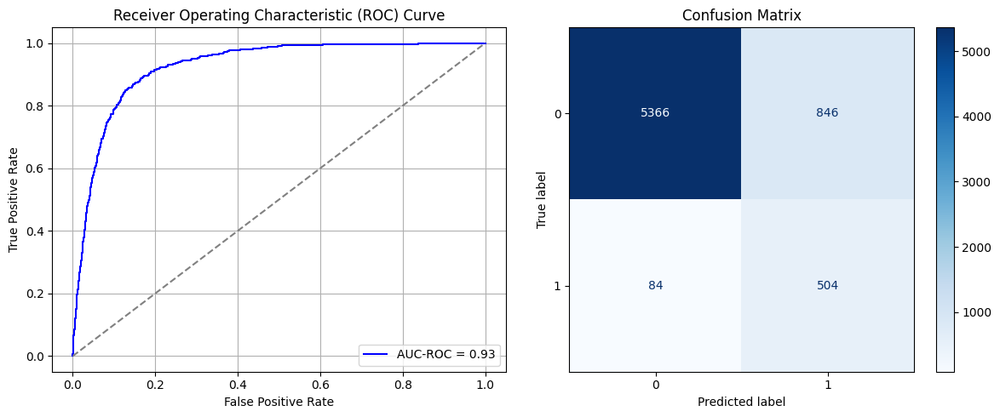

Best threshold based on F1-score: 0.7011747360229492
False Negative Rate: 0.14285714285714285
Time elapsed (performance): 1.2721320609998656
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7809 - loss: 0.5593 - val_AUC: 0.8860 - val_loss: 0.4331
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8793 - loss: 0.4395 - val_AUC: 0.8937 - val_loss: 0.4113
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8916 - loss: 0.4146 - val_AUC: 0.8987 - val_loss: 0.3995
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 11s 4ms/step - AUC: 0.8967 - loss: 0.4036 - val_AUC: 0.9025 - val_loss: 0.3920
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9014 - loss: 0.3930 - val_AUC: 0.9023 - val_loss: 0.3916
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9048 - loss: 0.3864 - val_AUC: 0.9091 - val_loss: 0.3752
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9073 - loss: 0.3800 - val_AUC: 0.9106 - val_loss: 0.3749
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9104 - loss: 0.3733 - val_AUC: 0.9143 - val_loss: 0.3710
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/s

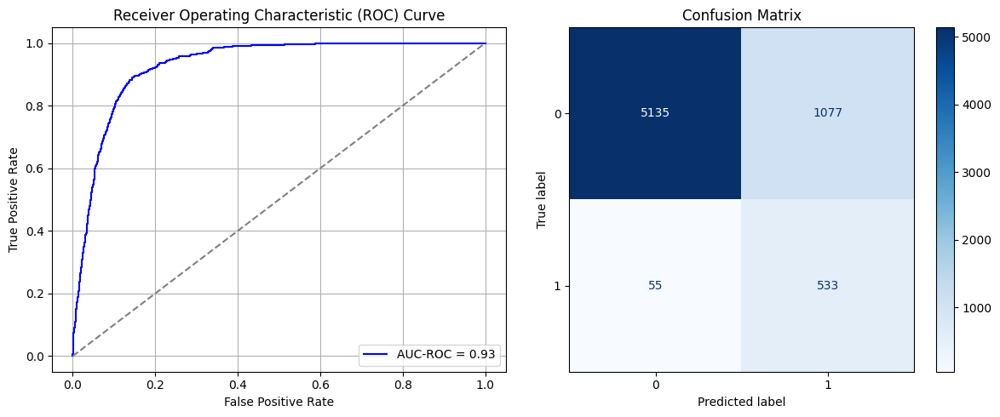

Best threshold based on F1-score: 0.7714677453041077
False Negative Rate: 0.0935374149659864
Time elapsed (performance): 1.8495828869999968
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7848 - loss: 0.5532 - val_AUC: 0.8906 - val_loss: 0.4186
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8832 - loss: 0.4306 - val_AUC: 0.9001 - val_loss: 0.4083
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8915 - loss: 0.4137 - val_AUC: 0.9061 - val_loss: 0.3863
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9009 - loss: 0.3951 - val_AUC: 0.9104 - val_loss: 0.3755
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - AUC: 0.9051 - loss: 0.3865 - val_AUC: 0.9124 - val_loss: 0.3711
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9066 - loss: 0.3823 - val_AUC: 0.9153 - val_loss: 0.3682
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - AUC: 0.9090 - loss: 0.3769 - val_AUC: 0.9172 - val_loss: 0.3609
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9155 - loss: 0.3637 - val_AUC: 0.9191 - val_loss: 0.3550
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

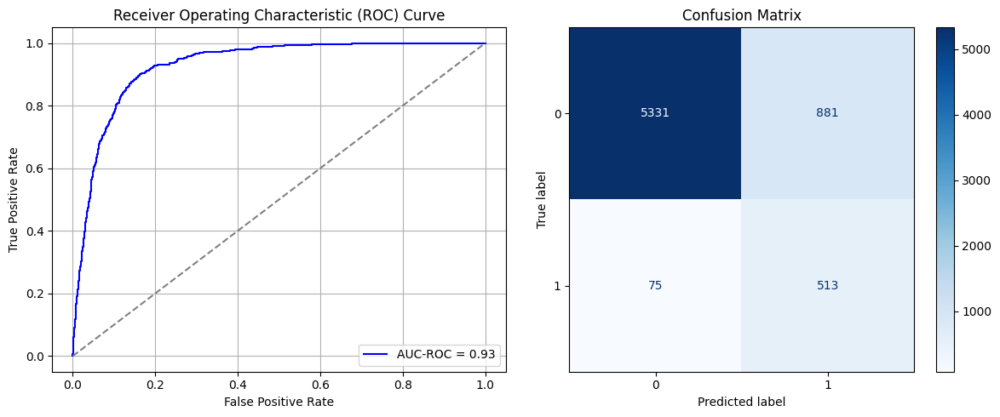

Best threshold based on F1-score: 0.7434273958206177
False Negative Rate: 0.12755102040816327
Time elapsed (performance): 0.8502744329998677
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.7919 - loss: 0.5525 - val_AUC: 0.8857 - val_loss: 0.4358
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8830 - loss: 0.4358 - val_AUC: 0.8918 - val_loss: 0.4225
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8880 - loss: 0.4221 - val_AUC: 0.8972 - val_loss: 0.4020
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8935 - loss: 0.4106 - val_AUC: 0.9013 - val_loss: 0.3935
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8991 - loss: 0.3991 - val_AUC: 0.9051 - val_loss: 0.4035
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9042 - loss: 0.3893 - val_AUC: 0.9085 - val_loss: 0.3832
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9067 - loss: 0.3833 - val_AUC: 0.9116 - val_loss: 0.3721
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - AUC: 0.9115 - loss: 0.3728 - val_AUC: 0.9144 - val_loss: 0.3667
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/st

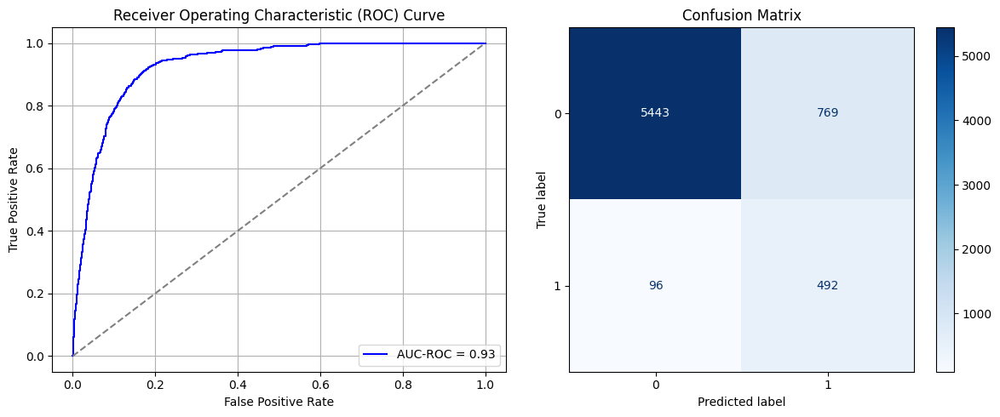

Best threshold based on F1-score: 0.9845755696296692
False Negative Rate: 0.16326530612244897
Time elapsed (performance): 1.0700816009994014
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.7886 - loss: 0.5541 - val_AUC: 0.8875 - val_loss: 0.4355
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8851 - loss: 0.4320 - val_AUC: 0.8954 - val_loss: 0.4140
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8926 - loss: 0.4141 - val_AUC: 0.9001 - val_loss: 0.3985
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8995 - loss: 0.3993 - val_AUC: 0.9045 - val_loss: 0.3877
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9067 - loss: 0.3830 - val_AUC: 0.9085 - val_loss: 0.3791
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9071 - loss: 0.3821 - val_AUC: 0.9097 - val_loss: 0.3765
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9131 - loss: 0.3685 - val_AUC: 0.9125 - val_loss: 0.3685
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9168 - loss: 0.3598 - val_AUC: 0.9156 - val_loss: 0.3618
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/s

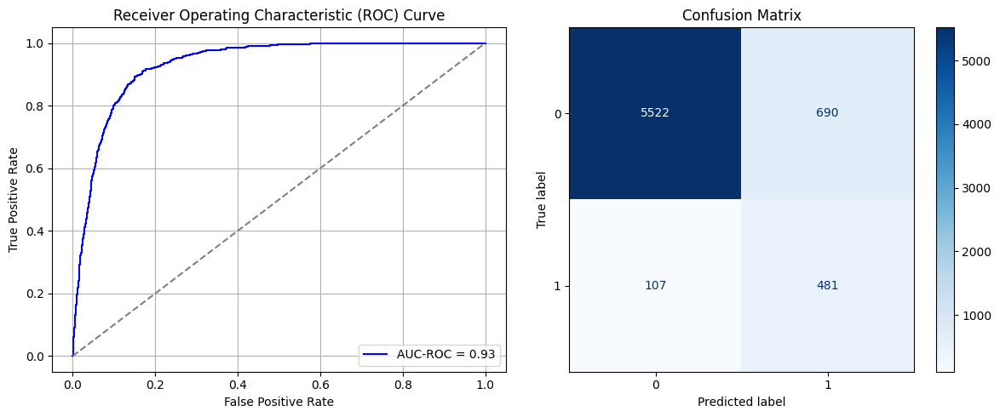

Best threshold based on F1-score: 0.7133527398109436
False Negative Rate: 0.18197278911564627
Time elapsed (performance): 1.8856525459996192
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7841 - loss: 0.5568 - val_AUC: 0.8830 - val_loss: 0.4405
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8809 - loss: 0.4355 - val_AUC: 0.8886 - val_loss: 0.4195
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8902 - loss: 0.4174 - val_AUC: 0.8959 - val_loss: 0.4062
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8940 - loss: 0.4092 - val_AUC: 0.9017 - val_loss: 0.3921
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8998 - loss: 0.3976 - val_AUC: 0.9036 - val_loss: 0.4024
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9035 - loss: 0.3888 - val_AUC: 0.9087 - val_loss: 0.3825
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9094 - loss: 0.3759 - val_AUC: 0.9095 - val_loss: 0.3831
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9097 - loss: 0.3754 - val_AUC: 0.9128 - val_loss: 0.3677
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

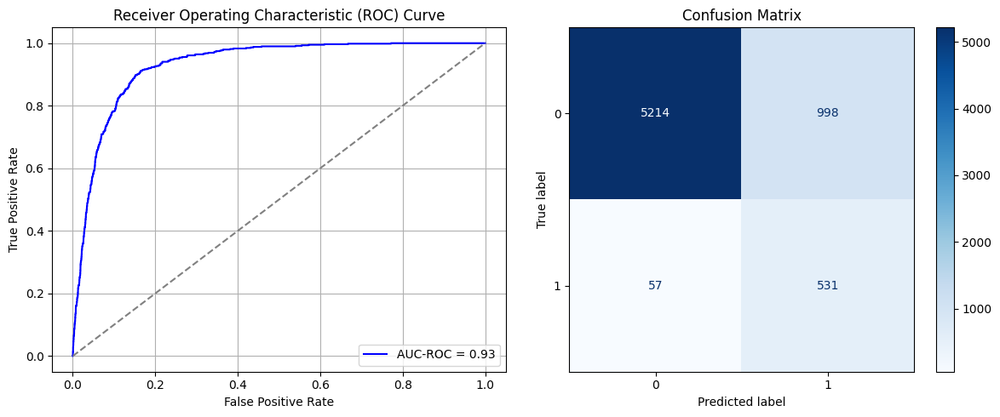

Best threshold based on F1-score: 0.991836428642273
False Negative Rate: 0.09693877551020408
Time elapsed (performance): 1.0475312170001416
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7902 - loss: 0.5502 - val_AUC: 0.8881 - val_loss: 0.4273
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8821 - loss: 0.4353 - val_AUC: 0.8928 - val_loss: 0.4286
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8913 - loss: 0.4150 - val_AUC: 0.9006 - val_loss: 0.3975
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8957 - loss: 0.4056 - val_AUC: 0.9058 - val_loss: 0.3899
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9019 - loss: 0.3925 - val_AUC: 0.9096 - val_loss: 0.3782
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9043 - loss: 0.3871 - val_AUC: 0.9113 - val_loss: 0.3784
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9110 - loss: 0.3742 - val_AUC: 0.9135 - val_loss: 0.3706
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9106 - loss: 0.3741 - val_AUC: 0.9170 - val_loss: 0.3602
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

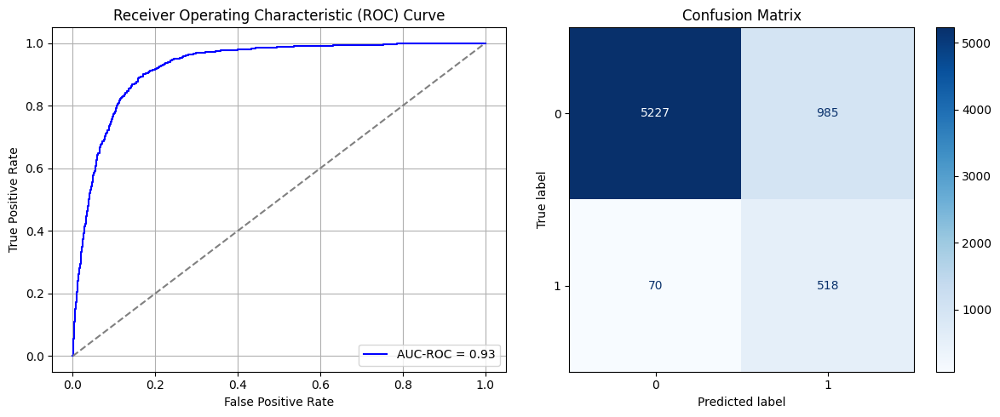

Best threshold based on F1-score: 0.779861569404602
False Negative Rate: 0.11904761904761904
Time elapsed (performance): 1.0579310770008306
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.7917 - loss: 0.5510 - val_AUC: 0.8913 - val_loss: 0.4244
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8866 - loss: 0.4261 - val_AUC: 0.8957 - val_loss: 0.4275
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8880 - loss: 0.4205 - val_AUC: 0.8998 - val_loss: 0.3994
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8962 - loss: 0.4024 - val_AUC: 0.9046 - val_loss: 0.3860
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9017 - loss: 0.3926 - val_AUC: 0.9106 - val_loss: 0.3771
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9053 - loss: 0.3857 - val_AUC: 0.9116 - val_loss: 0.3755
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9090 - loss: 0.3762 - val_AUC: 0.9164 - val_loss: 0.3610
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9122 - loss: 0.3681 - val_AUC: 0.9175 - val_loss: 0.3565
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

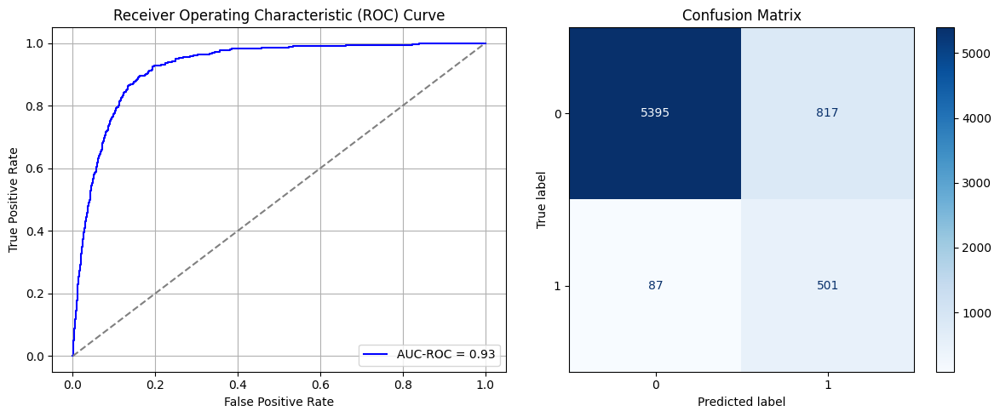

Best threshold based on F1-score: 0.6940181255340576
False Negative Rate: 0.14795918367346939
Time elapsed (performance): 1.1062012429993047
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7948 - loss: 0.5455 - val_AUC: 0.8851 - val_loss: 0.4695
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8849 - loss: 0.4279 - val_AUC: 0.8931 - val_loss: 0.4129
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8931 - loss: 0.4105 - val_AUC: 0.8956 - val_loss: 0.4117
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8947 - loss: 0.4068 - val_AUC: 0.9019 - val_loss: 0.3956
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8993 - loss: 0.3967 - val_AUC: 0.9066 - val_loss: 0.3823
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9084 - loss: 0.3782 - val_AUC: 0.9113 - val_loss: 0.3755
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9126 - loss: 0.3686 - val_AUC: 0.9143 - val_loss: 0.3639
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9159 - loss: 0.3612 - val_AUC: 0.9168 - val_loss: 0.3581
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/st

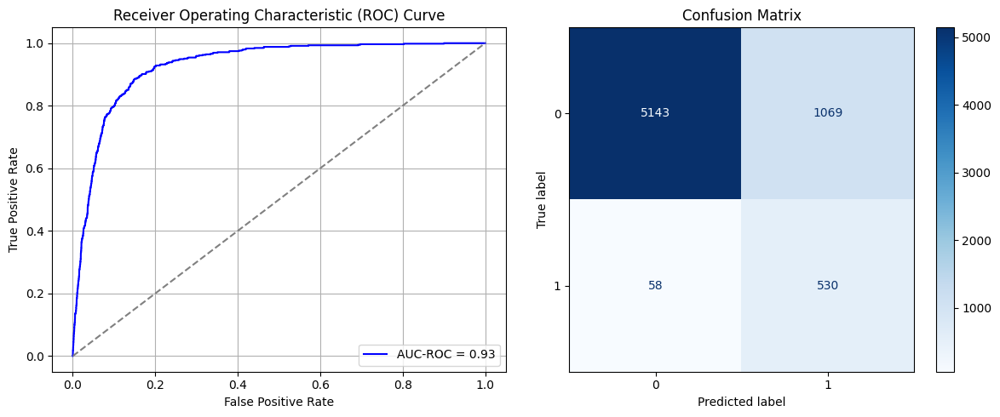

Best threshold based on F1-score: 0.9921815395355225
False Negative Rate: 0.09863945578231292
Time elapsed (performance): 1.049581709999984
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7874 - loss: 0.5546 - val_AUC: 0.8882 - val_loss: 0.4262
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8828 - loss: 0.4308 - val_AUC: 0.8955 - val_loss: 0.4080
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8874 - loss: 0.4212 - val_AUC: 0.9001 - val_loss: 0.4035
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8953 - loss: 0.4058 - val_AUC: 0.9051 - val_loss: 0.3851
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9000 - loss: 0.3960 - val_AUC: 0.9088 - val_loss: 0.3791
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9047 - loss: 0.3863 - val_AUC: 0.9103 - val_loss: 0.3757
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9092 - loss: 0.3775 - val_AUC: 0.9129 - val_loss: 0.3676
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9107 - loss: 0.3733 - val_AUC: 0.9142 - val_loss: 0.3858
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

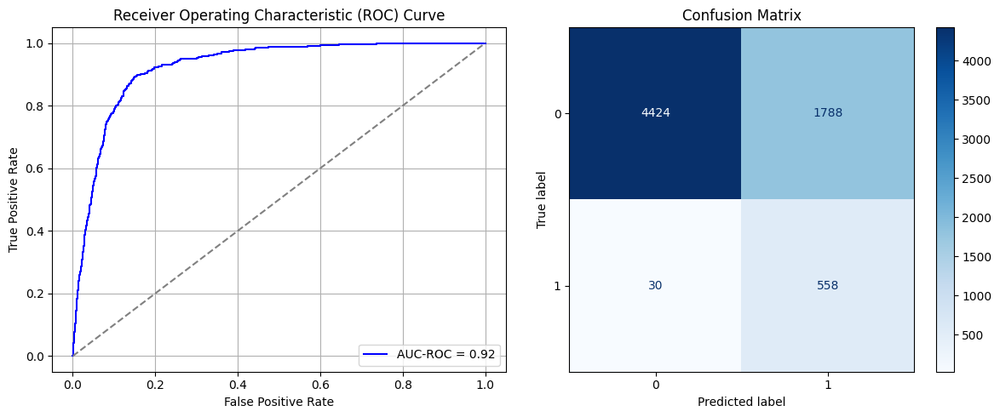

Best threshold based on F1-score: 0.829257607460022
False Negative Rate: 0.05102040816326531
Time elapsed (performance): 1.0821743800006516
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7932 - loss: 0.5516 - val_AUC: 0.8888 - val_loss: 0.4282
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8816 - loss: 0.4354 - val_AUC: 0.8949 - val_loss: 0.4180
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8887 - loss: 0.4196 - val_AUC: 0.8994 - val_loss: 0.3985
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8941 - loss: 0.4083 - val_AUC: 0.9041 - val_loss: 0.3892
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8967 - loss: 0.4023 - val_AUC: 0.9070 - val_loss: 0.3827
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9052 - loss: 0.3845 - val_AUC: 0.9086 - val_loss: 0.3882
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9068 - loss: 0.3815 - val_AUC: 0.9119 - val_loss: 0.3701
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9104 - loss: 0.3731 - val_AUC: 0.9130 - val_loss: 0.3660
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

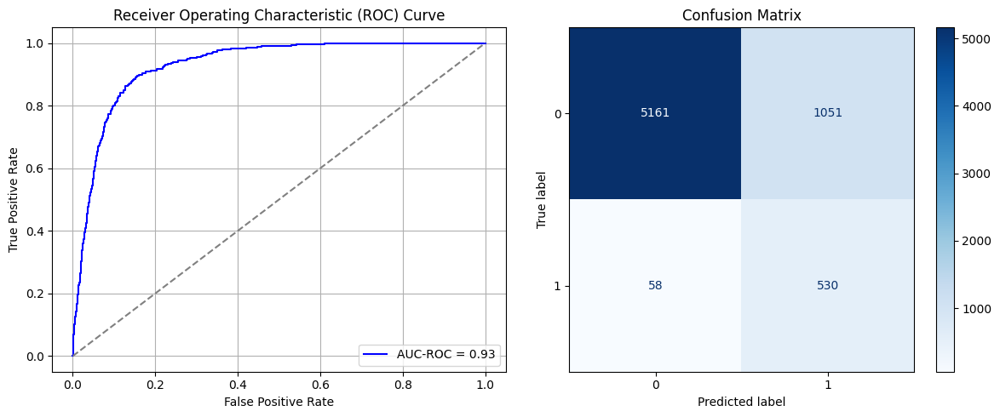

Best threshold based on F1-score: 0.7755730748176575
False Negative Rate: 0.09863945578231292
Time elapsed (performance): 0.9270648540004913
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.7946 - loss: 0.5459 - val_AUC: 0.8924 - val_loss: 0.4203
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8833 - loss: 0.4306 - val_AUC: 0.8974 - val_loss: 0.4027
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8899 - loss: 0.4178 - val_AUC: 0.9015 - val_loss: 0.3954
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8952 - loss: 0.4082 - val_AUC: 0.9048 - val_loss: 0.3931
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8983 - loss: 0.3997 - val_AUC: 0.9062 - val_loss: 0.3860
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9064 - loss: 0.3834 - val_AUC: 0.9101 - val_loss: 0.3735
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9050 - loss: 0.3841 - val_AUC: 0.9105 - val_loss: 0.3724
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9115 - loss: 0.3710 - val_AUC: 0.9144 - val_loss: 0.3645
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

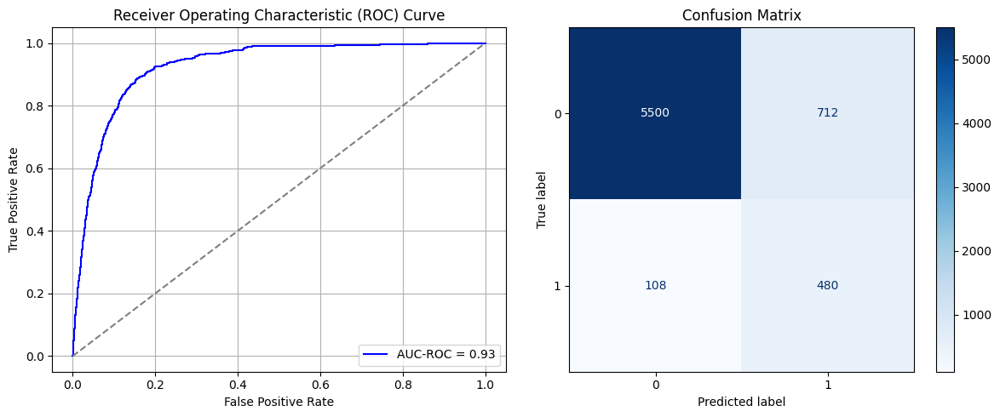

Best threshold based on F1-score: 0.9882540702819824
False Negative Rate: 0.1836734693877551
Time elapsed (performance): 1.1024482320008246
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7887 - loss: 0.5502 - val_AUC: 0.8877 - val_loss: 0.4280
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8859 - loss: 0.4263 - val_AUC: 0.8936 - val_loss: 0.4094
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8918 - loss: 0.4134 - val_AUC: 0.8997 - val_loss: 0.4087
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8995 - loss: 0.3968 - val_AUC: 0.9063 - val_loss: 0.3878
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9079 - loss: 0.3805 - val_AUC: 0.9088 - val_loss: 0.3763
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9081 - loss: 0.3791 - val_AUC: 0.9119 - val_loss: 0.3687
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9139 - loss: 0.3667 - val_AUC: 0.9128 - val_loss: 0.3867
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9177 - loss: 0.3592 - val_AUC: 0.9144 - val_loss: 0.3797
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

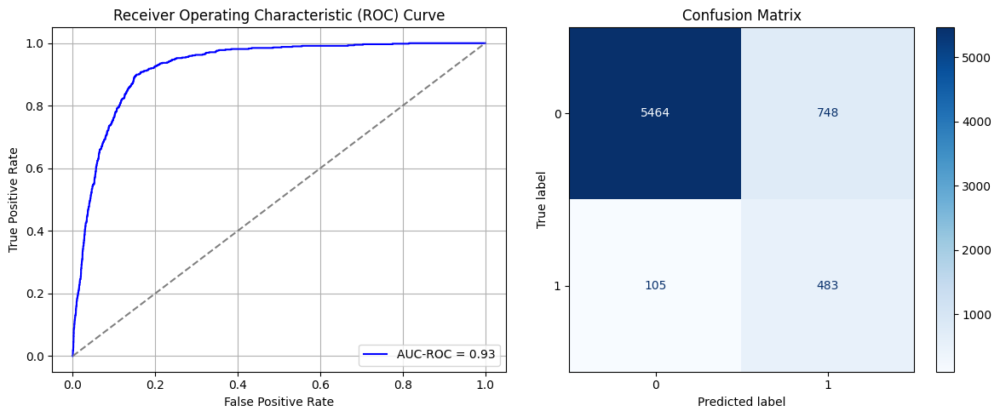

Best threshold based on F1-score: 0.9881107807159424
False Negative Rate: 0.17857142857142858
Time elapsed (performance): 0.882832536000933
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7890 - loss: 0.5505 - val_AUC: 0.8886 - val_loss: 0.4274
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8817 - loss: 0.4326 - val_AUC: 0.8942 - val_loss: 0.4199
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8914 - loss: 0.4125 - val_AUC: 0.8980 - val_loss: 0.4002
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8962 - loss: 0.4034 - val_AUC: 0.9005 - val_loss: 0.3958
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9014 - loss: 0.3936 - val_AUC: 0.9076 - val_loss: 0.3797
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9040 - loss: 0.3866 - val_AUC: 0.9096 - val_loss: 0.3751
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9073 - loss: 0.3806 - val_AUC: 0.9119 - val_loss: 0.3708
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9115 - loss: 0.3718 - val_AUC: 0.9158 - val_loss: 0.3649
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

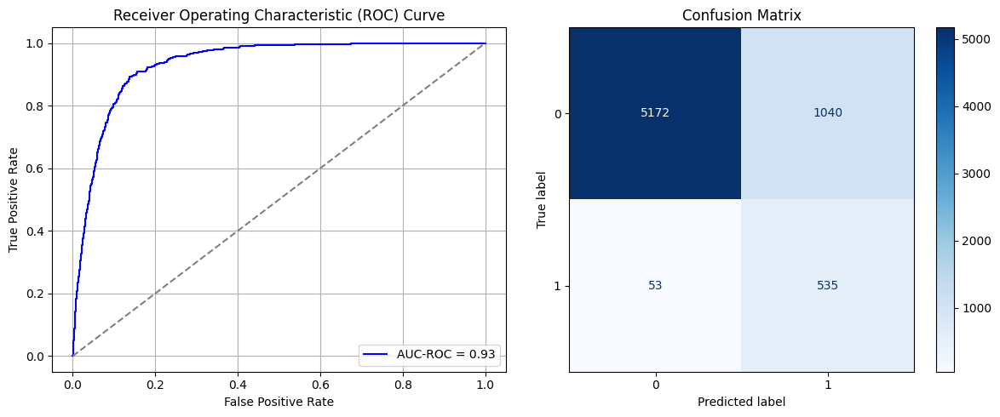

Best threshold based on F1-score: 0.9917424321174622
False Negative Rate: 0.09013605442176871
Time elapsed (performance): 1.0513263289994939
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7894 - loss: 0.5528 - val_AUC: 0.8912 - val_loss: 0.4242
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8848 - loss: 0.4272 - val_AUC: 0.8961 - val_loss: 0.4047
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8921 - loss: 0.4114 - val_AUC: 0.9019 - val_loss: 0.4034
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8989 - loss: 0.3983 - val_AUC: 0.9069 - val_loss: 0.3814
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9002 - loss: 0.3937 - val_AUC: 0.9137 - val_loss: 0.3667
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9040 - loss: 0.3856 - val_AUC: 0.9160 - val_loss: 0.3587
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9071 - loss: 0.3784 - val_AUC: 0.9177 - val_loss: 0.3551
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9104 - loss: 0.3719 - val_AUC: 0.9190 - val_loss: 0.3498
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/

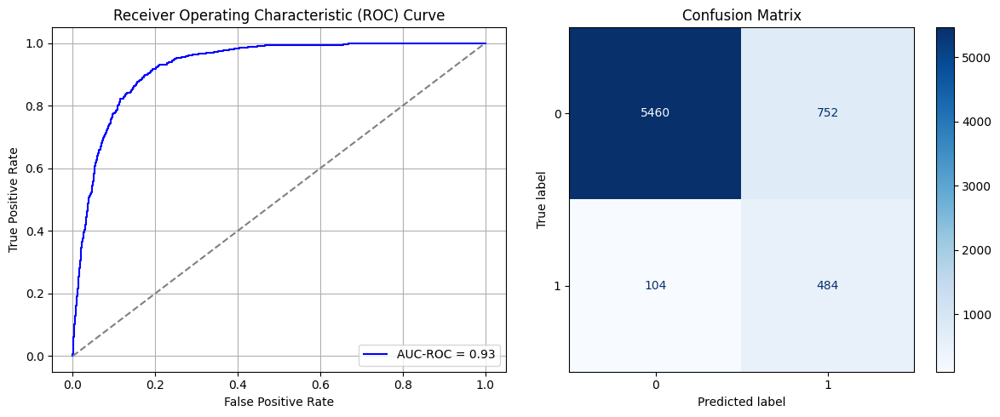

Best threshold based on F1-score: 0.6855946183204651
False Negative Rate: 0.17687074829931973
Time elapsed (performance): 0.9775631459997385
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7757 - loss: 0.5571 - val_AUC: 0.8857 - val_loss: 0.4286
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8844 - loss: 0.4286 - val_AUC: 0.8921 - val_loss: 0.4169
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8887 - loss: 0.4193 - val_AUC: 0.8955 - val_loss: 0.4072
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8926 - loss: 0.4109 - val_AUC: 0.9008 - val_loss: 0.3935
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8991 - loss: 0.3982 - val_AUC: 0.9045 - val_loss: 0.3883
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9038 - loss: 0.3891 - val_AUC: 0.9076 - val_loss: 0.3782
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9065 - loss: 0.3827 - val_AUC: 0.9101 - val_loss: 0.3775
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9091 - loss: 0.3755 - val_AUC: 0.9115 - val_loss: 0.3713
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms

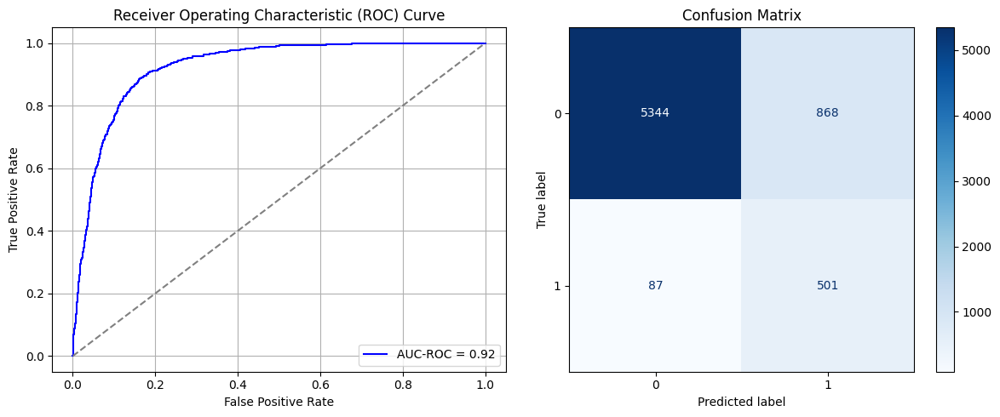

Best threshold based on F1-score: 0.7196522951126099
False Negative Rate: 0.14795918367346939
Time elapsed (performance): 1.8983698680003727
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7814 - loss: 0.5574 - val_AUC: 0.8865 - val_loss: 0.4283
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8800 - loss: 0.4360 - val_AUC: 0.8920 - val_loss: 0.4147
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8880 - loss: 0.4204 - val_AUC: 0.8988 - val_loss: 0.4003
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8986 - loss: 0.3998 - val_AUC: 0.9045 - val_loss: 0.3881
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9015 - loss: 0.3932 - val_AUC: 0.9088 - val_loss: 0.3768
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9072 - loss: 0.3815 - val_AUC: 0.9113 - val_loss: 0.3755
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9093 - loss: 0.3757 - val_AUC: 0.9138 - val_loss: 0.3661
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.9091 - loss: 0.3765 - val_AUC: 0.9155 - val_loss: 0.3630
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/

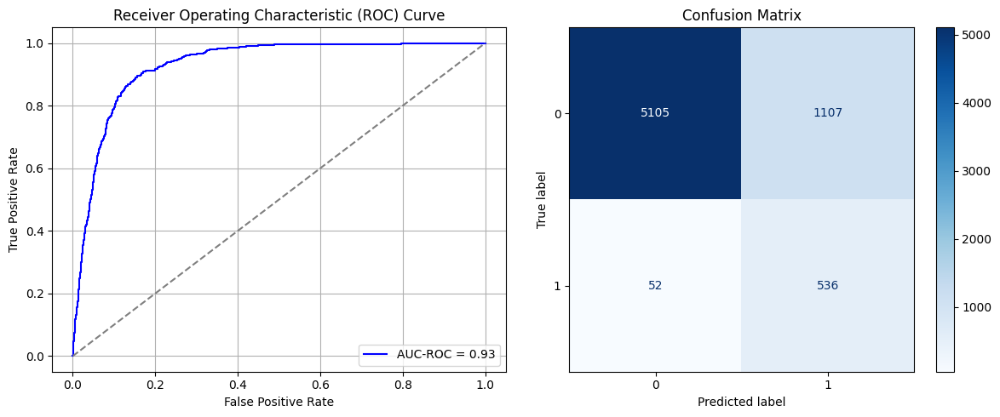

Best threshold based on F1-score: 0.752146303653717
False Negative Rate: 0.08843537414965986
Time elapsed (performance): 0.9085097389997827
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.7924 - loss: 0.5492 - val_AUC: 0.8895 - val_loss: 0.4211
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8837 - loss: 0.4295 - val_AUC: 0.8964 - val_loss: 0.4072
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8939 - loss: 0.4102 - val_AUC: 0.9000 - val_loss: 0.4045
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8954 - loss: 0.4048 - val_AUC: 0.9039 - val_loss: 0.4118
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8997 - loss: 0.3977 - val_AUC: 0.9074 - val_loss: 0.3851
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9013 - loss: 0.3931 - val_AUC: 0.9093 - val_loss: 0.3966
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9050 - loss: 0.3859 - val_AUC: 0.9128 - val_loss: 0.3849
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9127 - loss: 0.3697 - val_AUC: 0.9161 - val_loss: 0.3646
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

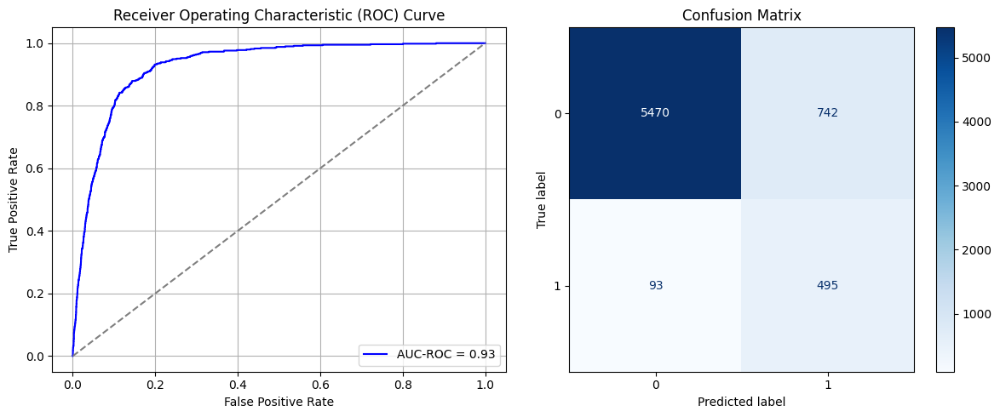

<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Best threshold based on F1-score: 0.9890382885932922
False Negative Rate: 0.15816326530612246
Time elapsed (performance): 1.8797046310010046
Epoch 1/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7969 - loss: 0.5490 - val_AUC: 0.8868 - val_loss: 0.4342
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8825 - loss: 0.4343 - val_AUC: 0.8935 - val_loss: 0.4126
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8898 - loss: 0.4176 - val_AUC: 0.8977 - val_loss: 0.4220
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8972 - loss: 0.4043 - val_AUC: 0.9076 - val_loss: 0.3826
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9098 - loss: 0.3774 - val_AUC: 0.9130 - val_loss: 0.3700
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9109 - loss: 0.3746 - val_AUC: 0.9151 - val_loss: 0.3647
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9148 - loss: 0.3646 - val_AUC: 0.9170 - val_loss: 0.3593
Epoch 8/10
1278/12

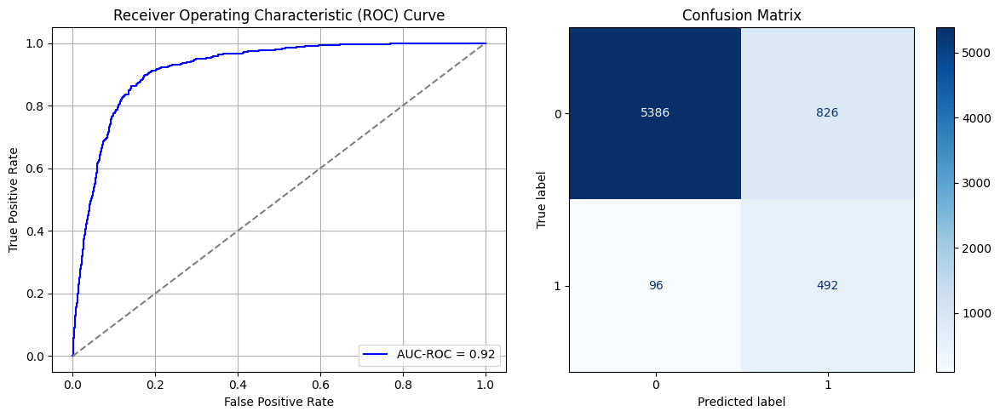

Best threshold based on F1-score: 0.9837647676467896
False Negative Rate: 0.16326530612244897
Time elapsed (performance): 0.9061233700012963
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7799 - loss: 0.5599 - val_AUC: 0.8875 - val_loss: 0.4247
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8806 - loss: 0.4345 - val_AUC: 0.8927 - val_loss: 0.4124
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8864 - loss: 0.4216 - val_AUC: 0.8977 - val_loss: 0.4055
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8932 - loss: 0.4088 - val_AUC: 0.9020 - val_loss: 0.3917
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8964 - loss: 0.4012 - val_AUC: 0.9065 - val_loss: 0.3851
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9023 - loss: 0.3886 - val_AUC: 0.9081 - val_loss: 0.3782
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9097 - loss: 0.3740 - val_AUC: 0.9116 - val_loss: 0.3743
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9105 - loss: 0.3729 - val_AUC: 0.9155 - val_loss: 0.3630
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/s

<ipython-input-27-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9301916194681351
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.88      0.93      6212
           1       0.40      0.85      0.54       588

    accuracy                           0.88      6800
   macro avg       0.69      0.86      0.73      6800
weighted avg       0.93      0.88      0.89      6800

FPR 0.12218287186091437 TPR: 0.8452380952380952 FNR: 0.15476190476190477 TNR: 0.8778171281390856


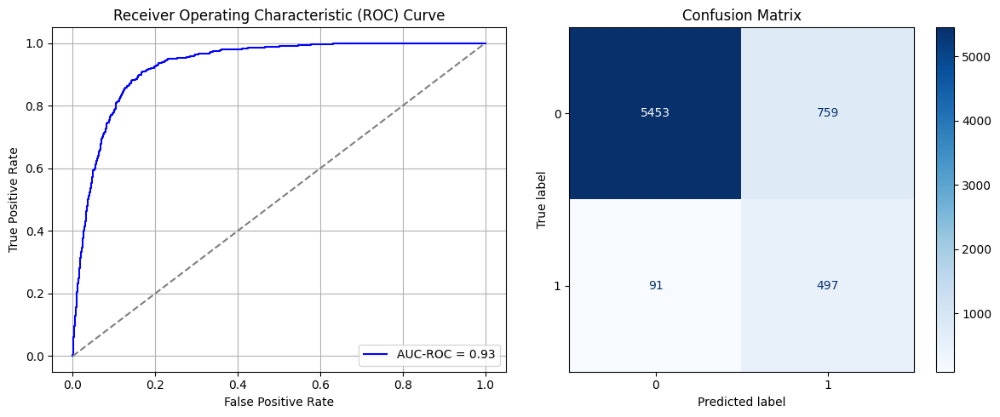

Best threshold based on F1-score: 0.6840963959693909
False Negative Rate: 0.15476190476190477
Time elapsed (performance): 1.0464139239993528
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.7906 - loss: 0.5530 - val_AUC: 0.8928 - val_loss: 0.4166
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8792 - loss: 0.4374 - val_AUC: 0.8976 - val_loss: 0.4030
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8888 - loss: 0.4195 - val_AUC: 0.9034 - val_loss: 0.3998
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8941 - loss: 0.4086 - val_AUC: 0.9059 - val_loss: 0.3895
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9000 - loss: 0.3971 - val_AUC: 0.9107 - val_loss: 0.3750
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9057 - loss: 0.3847 - val_AUC: 0.9137 - val_loss: 0.3674
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9085 - loss: 0.3785 - val_AUC: 0.9153 - val_loss: 0.3665
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9120 - loss: 0.3704 - val_AUC: 0.9171 - val_loss: 0.3574
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms

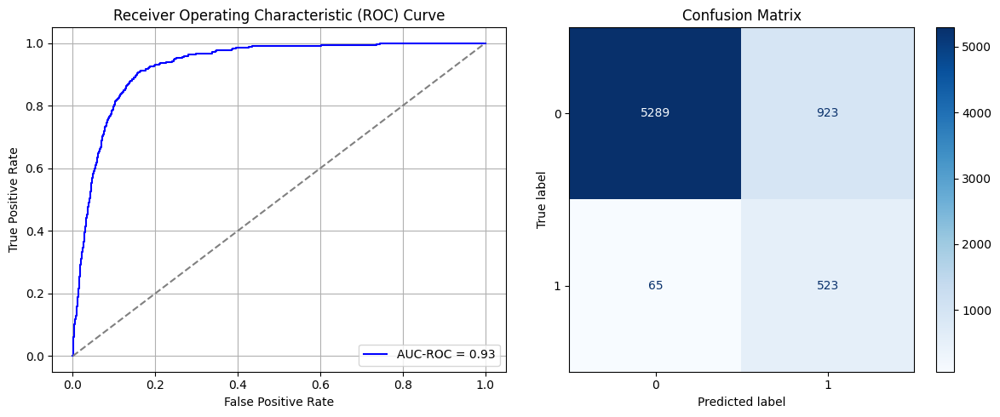

Best threshold based on F1-score: 0.9837122559547424
False Negative Rate: 0.11054421768707483
Time elapsed (performance): 1.084101776999887
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7946 - loss: 0.5483 - val_AUC: 0.8863 - val_loss: 0.4606
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8809 - loss: 0.4351 - val_AUC: 0.8909 - val_loss: 0.4193
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8864 - loss: 0.4226 - val_AUC: 0.8959 - val_loss: 0.4096
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8914 - loss: 0.4114 - val_AUC: 0.9001 - val_loss: 0.3988
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8991 - loss: 0.3984 - val_AUC: 0.9046 - val_loss: 0.3854
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9018 - loss: 0.3913 - val_AUC: 0.9077 - val_loss: 0.3901
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9048 - loss: 0.3841 - val_AUC: 0.9115 - val_loss: 0.3717
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9092 - loss: 0.3753 - val_AUC: 0.9139 - val_loss: 0.3649
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

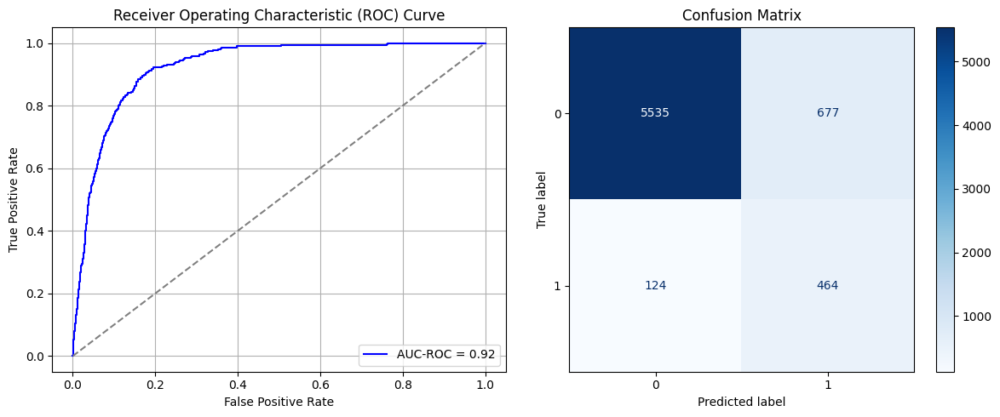

Best threshold based on F1-score: 0.6315597295761108
False Negative Rate: 0.2108843537414966
Time elapsed (performance): 1.3014498550001008
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7907 - loss: 0.5500 - val_AUC: 0.8841 - val_loss: 0.4312
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 11s 4ms/step - AUC: 0.8852 - loss: 0.4280 - val_AUC: 0.8915 - val_loss: 0.4212
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8931 - loss: 0.4116 - val_AUC: 0.8973 - val_loss: 0.4098
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8987 - loss: 0.3991 - val_AUC: 0.9020 - val_loss: 0.3920
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9022 - loss: 0.3913 - val_AUC: 0.9068 - val_loss: 0.3849
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9090 - loss: 0.3782 - val_AUC: 0.9097 - val_loss: 0.3747
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.9105 - loss: 0.3728 - val_AUC: 0.9121 - val_loss: 0.3689
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9112 - loss: 0.3693 - val_AUC: 0.9128 - val_loss: 0.3808
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4m

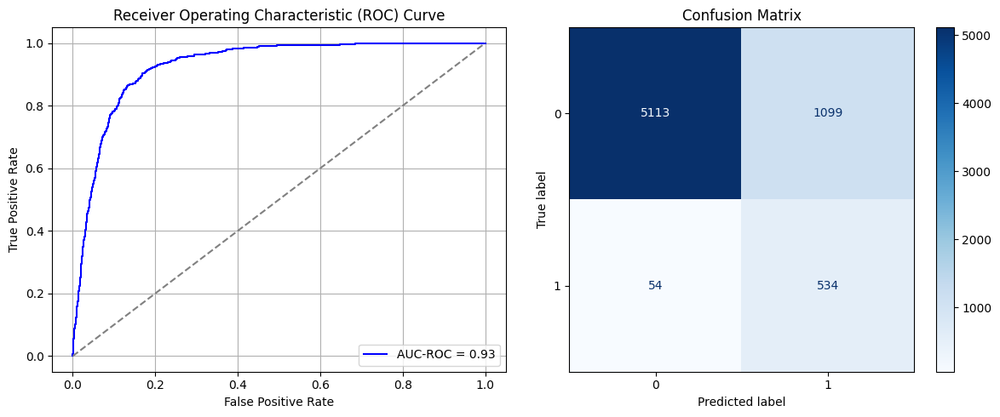

Best threshold based on F1-score: 0.7952936887741089
False Negative Rate: 0.09183673469387756
Time elapsed (performance): 1.0758114410000417
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7841 - loss: 0.5544 - val_AUC: 0.8861 - val_loss: 0.4298
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8844 - loss: 0.4273 - val_AUC: 0.8947 - val_loss: 0.4068
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8953 - loss: 0.4052 - val_AUC: 0.9004 - val_loss: 0.3999
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9005 - loss: 0.3945 - val_AUC: 0.9046 - val_loss: 0.3882
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9047 - loss: 0.3849 - val_AUC: 0.9068 - val_loss: 0.3843
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9092 - loss: 0.3768 - val_AUC: 0.9111 - val_loss: 0.3722
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9121 - loss: 0.3705 - val_AUC: 0.9119 - val_loss: 0.3750
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9166 - loss: 0.3600 - val_AUC: 0.9155 - val_loss: 0.3686
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms

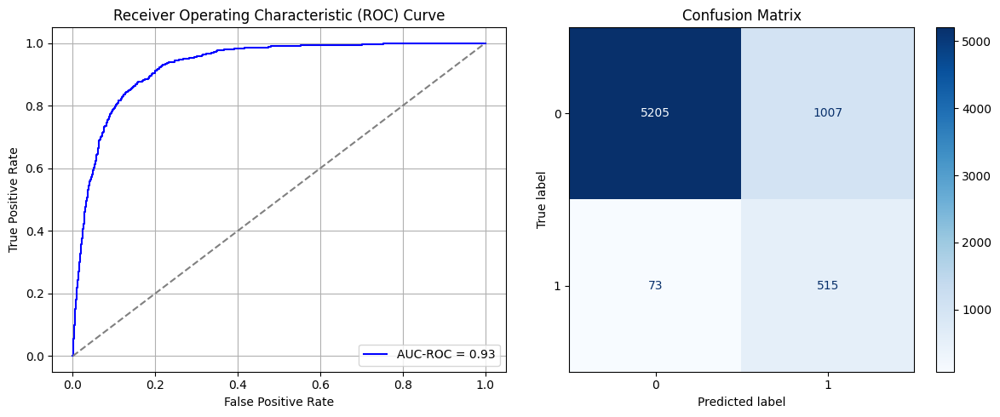

Best threshold based on F1-score: 0.9868919849395752
False Negative Rate: 0.12414965986394558
Time elapsed (performance): 1.3111908430000767
Epoch 1/10


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7950 - loss: 0.5489 - val_AUC: 0.8934 - val_loss: 0.4253
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8853 - loss: 0.4267 - val_AUC: 0.9001 - val_loss: 0.4039
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8945 - loss: 0.4085 - val_AUC: 0.9055 - val_loss: 0.3841
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8980 - loss: 0.3982 - val_AUC: 0.9035 - val_loss: 0.4004
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9057 - loss: 0.3827 - val_AUC: 0.9133 - val_loss: 0.3735
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9098 - loss: 0.3735 - val_AUC: 0.9158 - val_loss: 0.3614
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9140 - loss: 0.3646 - val_AUC: 0.9171 - val_loss: 0.3561
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9153 - loss: 0.3597 - val_AUC: 0.9196 - val_loss: 0.3513
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms

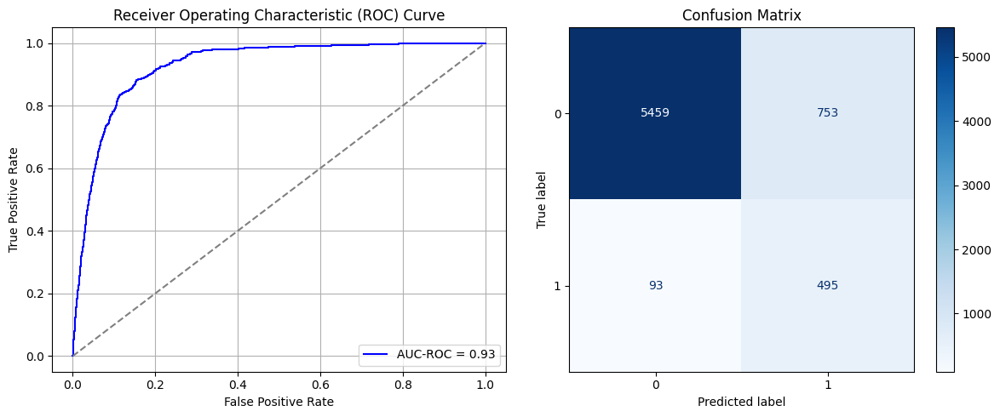

Best threshold based on F1-score: 0.9914143085479736
False Negative Rate: 0.15816326530612246
Time elapsed (performance): 1.1048248679999233


<ipython-input-28-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


In [93]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []

k = 10
Nsamples = k*(oversample_size-undersample_size)/undersample_size



for i in range(times):
    start = np.random.choice(int(k), int(Nsamples), replace=True)
    Row = []
    for j in range(len(start)):
      for i in range(int(undersample_size/k)):
        row = start[j]+int(k*i)-1
        Row.append(row)
    data_S_min_ros = pd.DataFrame()
    data_S_min_ros = data_S_minority.iloc[Row]
    data_S_Sy_ROS = pd.concat([data_S_majority, data_S_min_ros, data_S_minority])
    X_S_Sy_ROS = data_S_Sy_ROS.iloc[:, :-1]
    y_S_Sy_ROS = data_S_Sy_ROS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_Sy_ROS, y_S_Sy_ROS, test_size=0.20, random_state=0)
    model_Sy_ROS = create_dnn_model(X_S_train.shape[1])
    result_Sy_ROS = train_and_evaluate(model_Sy_ROS, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_Sy_ROS = Transductive_TL(model_Sy_ROS, X_T_full, y_T_full, "Target")

    Training_time.append(result_Sy_ROS)
    FPR.append(result_TL_Sy_ROS[0])
    TNR.append(result_TL_Sy_ROS[1])
    FNR.append(result_TL_Sy_ROS[2])
    TPR.append(result_TL_Sy_ROS[3])
    TL_time.append(result_TL_Sy_ROS[4])

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
# print(ParamFit)

In [97]:
print(ParamFit)
ParamFit.to_csv('Sy_ROS2.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0     47.676698  0.137798  0.862202  0.136054  0.863946     0.773901
1     48.232185  0.149549  0.850451  0.127551  0.872449     0.780016
2     45.036972  0.155827  0.844173  0.117347  0.882653     0.783416
3     44.892089  0.181423  0.818577  0.098639  0.901361     1.187272
4     44.763335  0.178847  0.821153  0.120748  0.879252     1.039596
5     48.154826  0.171925  0.828075  0.102041  0.897959     0.791829
6     49.392745  0.138281  0.861719  0.144558  0.855442     1.039329
7     50.220486  0.151964  0.848036  0.119048  0.880952     0.793603
8     45.792006  0.167740  0.832260  0.086735  0.913265     1.215703
9     51.192434  0.165647  0.834353  0.108844  0.891156     9.590650
10    64.688182  0.180296  0.819704  0.093537  0.906463     0.901984
11    64.488392  0.160496  0.839504  0.119048  0.880952     1.082053
12    59.823687  0.161140  0.838860  0.112245  0.887755     1.078085
13    56.385320  0.140373  0.85962

In [95]:
ParamFit['FNR'].mean()

np.float64(0.12700680272108844)

In [96]:
ParamFit['Source time'].mean()

np.float64(62.15911829024004)